# <center>Домашняя работа по занятию 26 
# <center>"Доменная адаптация и условная генерация"
# <center>Условная генерация
- Обучить две версии CAAE — "честную" и "нечестную", 
- преобразовать с их помощью исходные данные в латентное представление
- обучить **3** классификатора — один на **исходных данных** и два на кодах, полученных из **"честного"** и **"нечестного"** CAAE. 
- Сравнить качество классификации.   
### Необязательная часть:   
Сделать перенос стиля с одной цифры на другие с помощью "честного" CAAE

In [1]:
from google.colab import drive
drive.mount('/content/drive')

import os
os.chdir('drive/My Drive/Colab Notebooks/neural_OTUS')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torchvision import datasets, transforms

from utils import mnist, plot_graphs, plot_mnist, to_onehot
import numpy as np
import os 

%matplotlib inline

In [3]:
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
%matplotlib inline

In [4]:
root_folder = 'FC_AAE_C_results_100epoch/'
fixed_folder = root_folder + 'Fixed_results/'
recon_folder = root_folder + 'Recon_results/'

if os.path.isdir(root_folder):
    !rm -r $root_folder
os.mkdir(root_folder)
os.mkdir(fixed_folder)
os.mkdir(recon_folder)

In [5]:
mnist_tanh = transforms.Compose([
                transforms.ToTensor(),
                transforms.Normalize((0.5,), (0.5,)),
                lambda x: x.to(device)
           ])

In [6]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)

lr = 0.0001
prior_size = 10
train_epoch = 100
batch_size = 250

cuda:0


In [7]:
train_loader, valid_loader, test_loader = mnist(batch_size=batch_size, valid=10000, 
                                                transform=mnist_tanh, path='./../MNIST_data')

In [8]:
fixed_z = torch.randn((10, prior_size)).repeat((1,10)).view(-1, prior_size).to(device)
fixed_z_label = to_onehot(torch.tensor(list(range(10))).repeat((10)), 10).to(device)
fixed_data, fixed_label = next(iter(test_loader))
fixed_data = fixed_data[:100].to(device)
fixed_label = to_onehot(fixed_label[:100], 10).to(device)

In [9]:
data, label = next(iter(train_loader))

In [10]:
class FullyConnected(nn.Module):
    def __init__(self, sizes, dropout=False, activation_fn=nn.Tanh(), flatten=False, 
                 last_fn=None, first_fn=None, device='cpu'):
        super(FullyConnected, self).__init__()
        layers = []
        self.flatten = flatten
        if first_fn is not None:
            layers.append(first_fn)
        for i in range(len(sizes) - 2):
            layers.append(nn.Linear(sizes[i], sizes[i+1]))
            if dropout:
                layers.append(nn.Dropout(dropout))
            layers.append(activation_fn) # нам не нужен дропаут и фнкция активации в последнем слое
        else: 
            layers.append(nn.Linear(sizes[-2], sizes[-1]))
        if last_fn is not None:
            layers.append(last_fn)
        self.model = nn.Sequential(*layers)
        self.to(device)
        
    def forward(self, x, y=None):
        if self.flatten:
            x = x.view(x.shape[0], -1)
        if y is not None:
            x = torch.cat([x, y], dim=1)
        return self.model(x)

In [11]:
logs = {}
coders = {}

## <center>1) "Нечестный" вариант

In [12]:
variant = "unfair"

In [13]:
coders[variant] = {}

In [14]:
coders[variant]["Enc"] = FullyConnected([28*28, 1024, 1024, prior_size], activation_fn=nn.LeakyReLU(0.2), flatten=True, device=device)
coders[variant]["Dec"] = FullyConnected([prior_size+10, 1024, 1024, 28*28], activation_fn=nn.LeakyReLU(0.2), last_fn=nn.Tanh(), device=device)
coders[variant]["Disc"] = FullyConnected([prior_size, 1024, 1024, 1], dropout=0.3, activation_fn=nn.LeakyReLU(0.2), device=device)

Enc_optimizer = optim.Adam(coders[variant]["Enc"].parameters(), lr=lr)
Dec_optimizer = optim.Adam(coders[variant]["Dec"].parameters(), lr=lr)
Disc_optimizer = optim.Adam(coders[variant]["Disc"].parameters(), lr=lr)

In [15]:
logs[variant] = {}
logs[variant]["train"] = {'E': [],'AE': [], 'D': []}
logs[variant]["test"] = {'E': [],'AE': [], 'D': []}

In [16]:
batch_zeros = torch.zeros((batch_size, 1)).to(device)
batch_ones = torch.ones((batch_size, 1)).to(device)

#### тренировочные функции

In [17]:
def train(epoch, Enc, Dec, Disc, log=None):
    train_size = len(train_loader.sampler)
    for batch_idx, (data, label) in enumerate(train_loader):
        label = to_onehot(label, 10, device)
        # train D
        Enc.zero_grad()
        Disc.zero_grad()
        
        z = torch.randn((batch_size, prior_size)).to(device)
        z_label = to_onehot(np.random.randint(0, 10, (batch_size)), 10, device)

        fake_pred = Disc(Enc(data))
        true_pred = Disc(z)

        
        fake_loss = F.binary_cross_entropy_with_logits(fake_pred, batch_zeros)
        true_loss = F.binary_cross_entropy_with_logits(true_pred, batch_ones)
        
        Disc_loss = 0.5*(fake_loss + true_loss)
        
        Disc_loss.backward()
        Disc_optimizer.step()
        
        # train AE
        Enc.zero_grad()
        Dec.zero_grad()
        Disc.zero_grad()
        
        z = torch.randn((batch_size, prior_size))
        z_label = to_onehot(np.random.randint(0, 10, (batch_size)), 10)
        
        latent = Enc(data)
        reconstructed = Dec(latent, label).view(-1, 1, 28, 28)
        fake_pred = Disc(latent)
        
        Enc_loss = F.binary_cross_entropy_with_logits(fake_pred, batch_ones)
        AE_loss = F.mse_loss(reconstructed, data)
        G_loss = AE_loss + Enc_loss
        
        G_loss.backward()
        Dec_optimizer.step()
        Enc_optimizer.step()
            
        if batch_idx % 100 == 0:
            line = 'Train Epoch: {} [{}/{} ({:.0f}%)]\tLosses '.format(
                epoch, batch_idx * len(data), train_size, 100. * batch_idx / len(train_loader))
            losses = 'E: {:.4f}, AE: {:.4f}, D: {:.4f}'.format(Enc_loss.item(), AE_loss.item(), Disc_loss.item())
            print(line + losses)
            
    else:
        batch_idx += 1
        line = 'Train Epoch: {} [{}/{} ({:.0f}%)]\tLosses '.format(
            epoch, batch_idx * len(data), train_size, 100. * batch_idx / len(train_loader))
        losses = 'E: {:.4f}, AE: {:.4f}, D: {:.4f}'.format(Enc_loss.item(), AE_loss.item(), Disc_loss.item())
        print(line + losses)
        if log is not None:
            log['E'].append(Enc_loss.item())
            log['AE'].append(AE_loss.item())
            log['D'].append(Disc_loss.item())

In [18]:
def test(Enc, Dec, Disc, loader, epoch, file_prefix='', log=None):
    test_size = len(loader)
    E_loss = 0.
    AE_loss = 0.
    D_loss = 0.
    test_loss = {'E': 0., 'AE': 0., 'D': 0.}
    with torch.no_grad():
        for data, label in loader:
            label = to_onehot(label, 10, device)
            z = torch.randn((batch_size, prior_size)).to(device)
            z_label = to_onehot(np.random.randint(0, 10, (batch_size)), 10, device)
            latent = Enc(data)
            reconstructed = Dec(latent, label).view(-1, 1, 28, 28)
            fake_pred = Disc(latent)
            true_pred = Disc(z)
        
            fake_loss = F.binary_cross_entropy_with_logits(fake_pred, batch_zeros).item()
            true_loss = F.binary_cross_entropy_with_logits(true_pred, batch_ones).item()
            
            D_loss += 0.5*(fake_loss + true_loss)
            E_loss += F.binary_cross_entropy_with_logits(fake_pred, batch_ones).item()
            AE_loss += F.mse_loss(reconstructed, data)
            
        E_loss /= test_size
        D_loss /= test_size
        AE_loss /= test_size

        if epoch % 1 == 0 or epoch == 1:
            fixed_gen = Dec(fixed_z, fixed_z_label).cpu().data.numpy().reshape(100, 1, 28, 28)
            print("\tgeneration")
            plot_mnist(fixed_gen, (10, 10), True, fixed_folder + file_prefix + '%03d.png' % epoch)
            fixed_reconstruction = Dec(Enc(fixed_data), fixed_label).cpu().data.numpy().reshape(100, 1, 28, 28)
            print("\treconstruction")
            plot_mnist(fixed_reconstruction, (10, 10), True, 
                    recon_folder + file_prefix + '%03d.png' % epoch)
            
            report = 'Test losses. E: {:.4f}, AE: {:.4f}, D: {:.4f}'.format(E_loss, AE_loss, D_loss)
            print(report)

        if log is not None:
            log['E'].append(E_loss)
            log['AE'].append(AE_loss)
            log['D'].append(D_loss)

Train Epoch: 1 [0/50000 (0%)]	Losses E: 0.6725, AE: 0.9214, D: 0.6929
Train Epoch: 1 [25000/50000 (50%)]	Losses E: 0.0912, AE: 0.2626, D: 7.0209
Train Epoch: 1 [50000/50000 (100%)]	Losses E: 0.8135, AE: 0.3267, D: 1.5788
	generation


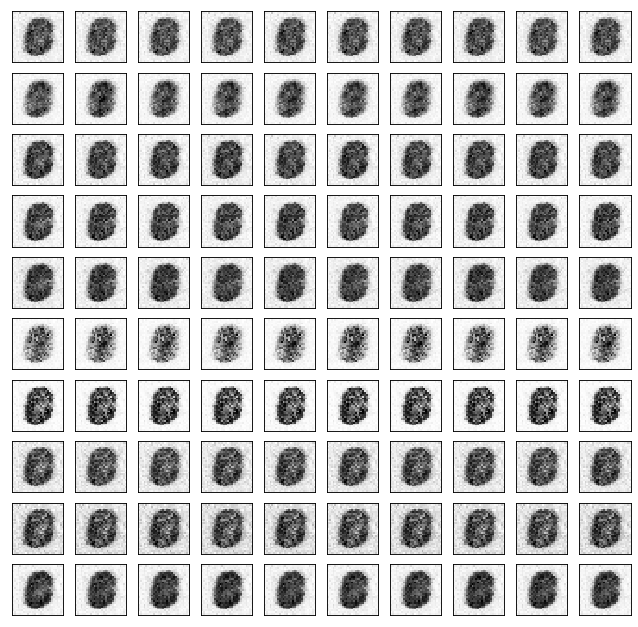

	reconstruction


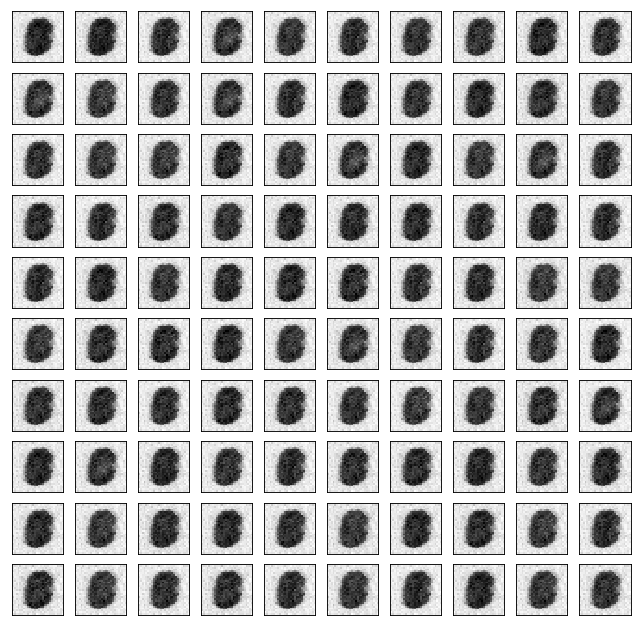

Test losses. E: 0.8087, AE: 0.3188, D: 1.6216
Train Epoch: 2 [0/50000 (0%)]	Losses E: 0.8169, AE: 0.3222, D: 1.6205
Train Epoch: 2 [25000/50000 (50%)]	Losses E: 0.6029, AE: 0.2576, D: 1.0301
Train Epoch: 2 [50000/50000 (100%)]	Losses E: 0.5790, AE: 0.2549, D: 0.9305
	generation


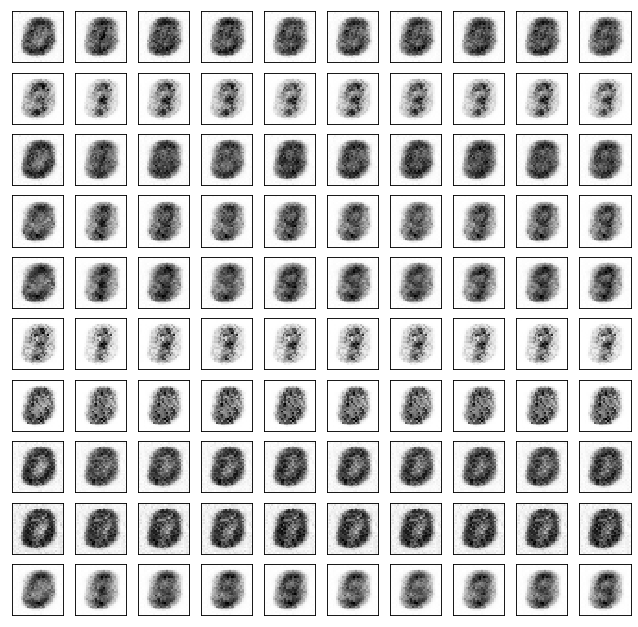

	reconstruction


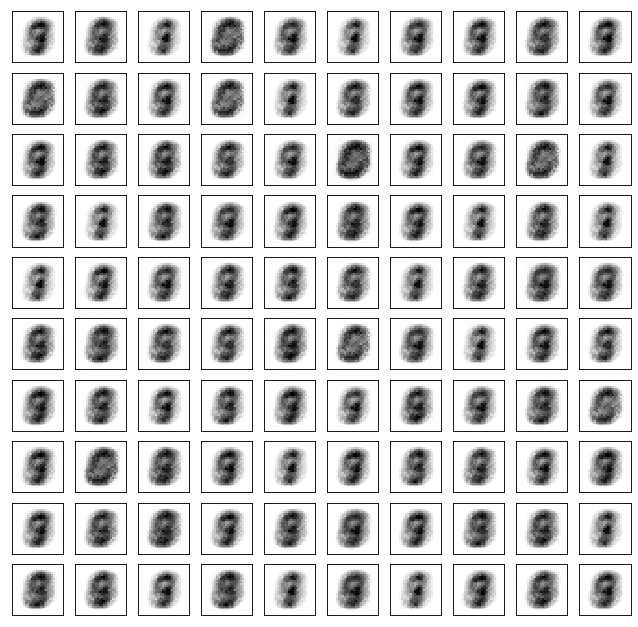

Test losses. E: 0.4548, AE: 0.2518, D: 0.9146
Train Epoch: 3 [0/50000 (0%)]	Losses E: 0.6066, AE: 0.2518, D: 0.8912
Train Epoch: 3 [25000/50000 (50%)]	Losses E: 0.5836, AE: 0.2447, D: 0.9686
Train Epoch: 3 [50000/50000 (100%)]	Losses E: 0.4338, AE: 0.2362, D: 0.8636
	generation


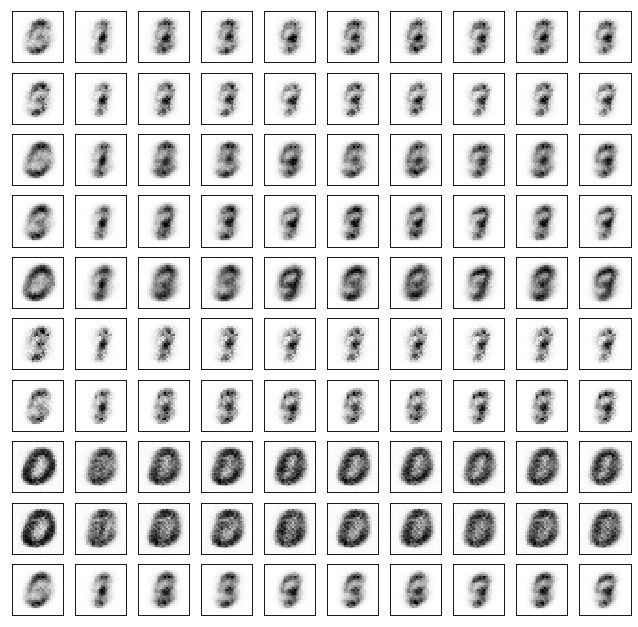

	reconstruction


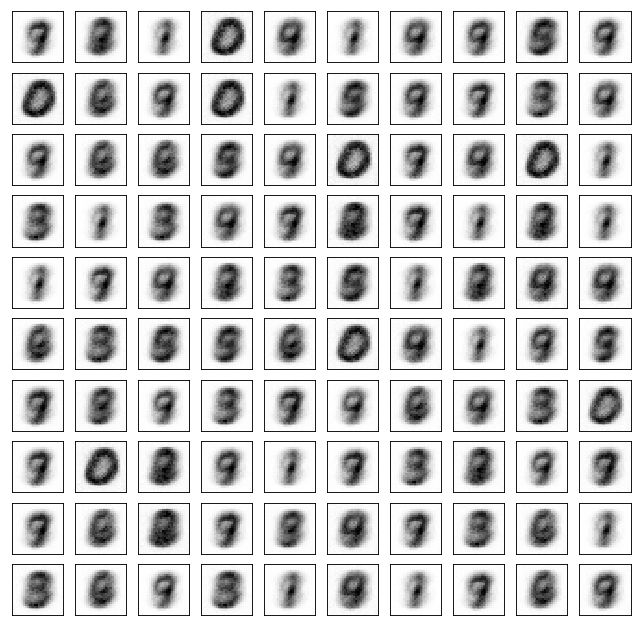

Test losses. E: 0.4145, AE: 0.2343, D: 0.8624
Train Epoch: 4 [0/50000 (0%)]	Losses E: 0.4423, AE: 0.2332, D: 0.8468
Train Epoch: 4 [25000/50000 (50%)]	Losses E: 0.6232, AE: 0.2177, D: 0.7807
Train Epoch: 4 [50000/50000 (100%)]	Losses E: 0.7307, AE: 0.2076, D: 0.8060
	generation


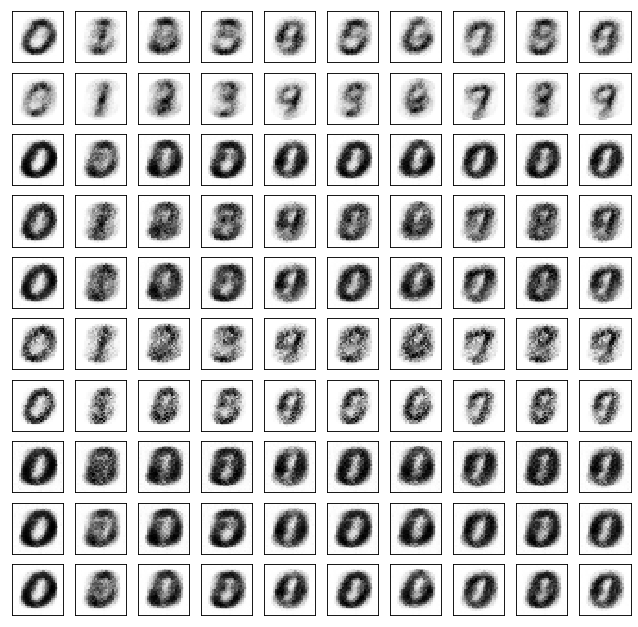

	reconstruction


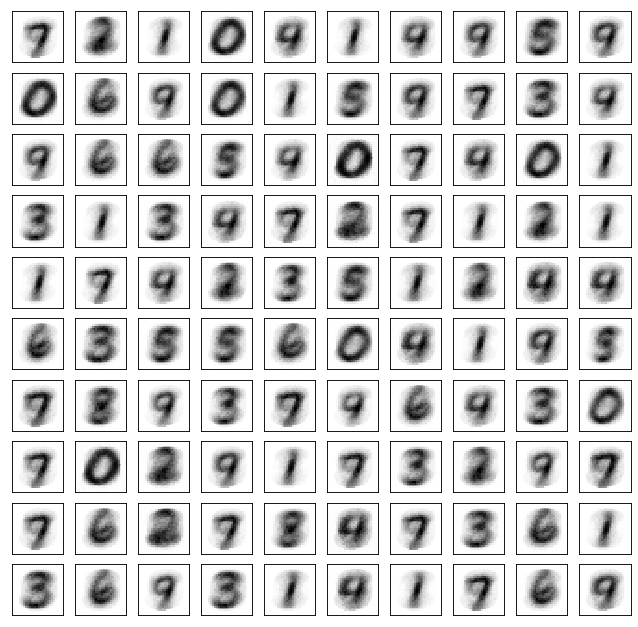

Test losses. E: 0.6793, AE: 0.2150, D: 0.8035
Train Epoch: 5 [0/50000 (0%)]	Losses E: 0.7092, AE: 0.2113, D: 0.8007
Train Epoch: 5 [25000/50000 (50%)]	Losses E: 0.5628, AE: 0.2097, D: 0.7767
Train Epoch: 5 [50000/50000 (100%)]	Losses E: 0.6167, AE: 0.2134, D: 0.7309
	generation


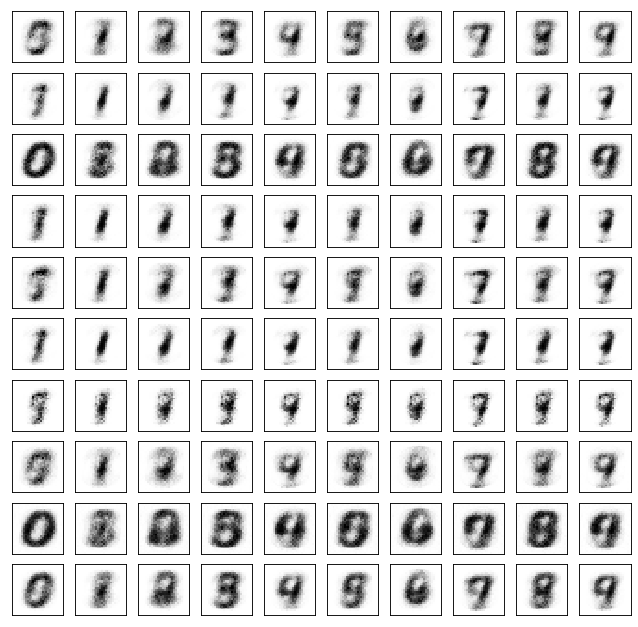

	reconstruction


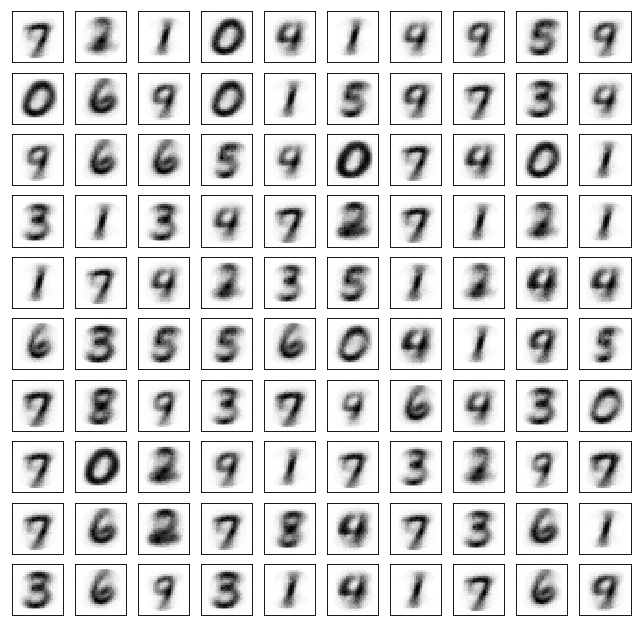

Test losses. E: 0.5871, AE: 0.2060, D: 0.7332
Train Epoch: 6 [0/50000 (0%)]	Losses E: 0.6121, AE: 0.2124, D: 0.7352
Train Epoch: 6 [25000/50000 (50%)]	Losses E: 0.5529, AE: 0.2056, D: 0.7738
Train Epoch: 6 [50000/50000 (100%)]	Losses E: 0.7155, AE: 0.1942, D: 0.7466
	generation


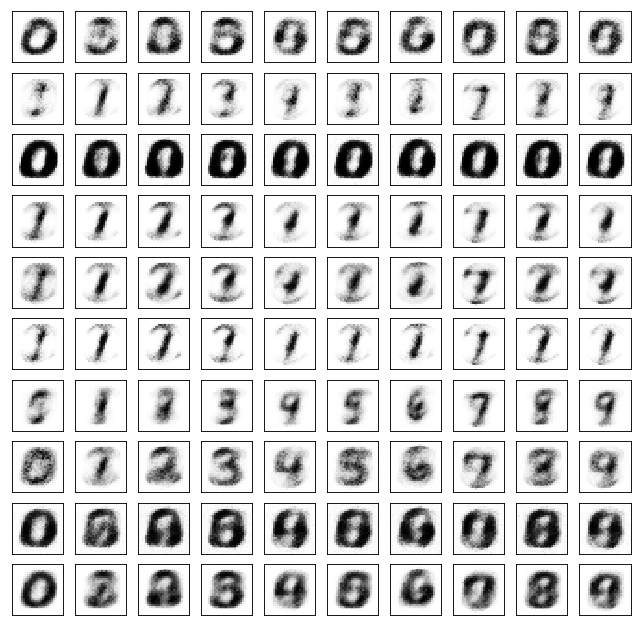

	reconstruction


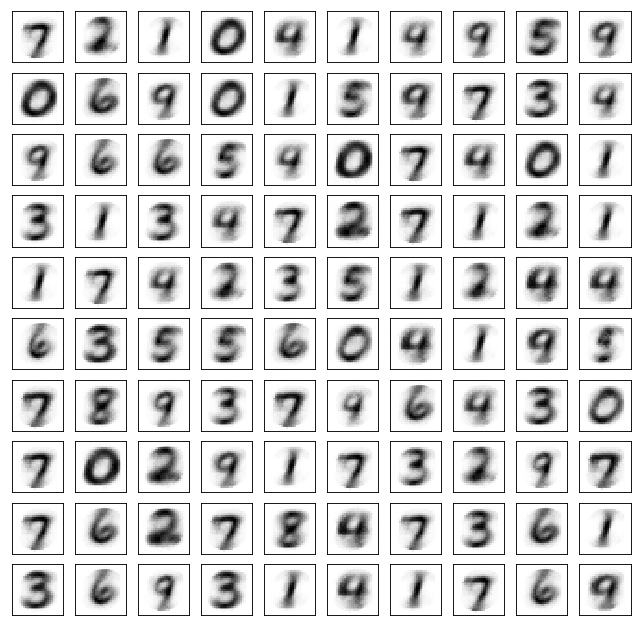

Test losses. E: 0.7031, AE: 0.2015, D: 0.7457
Train Epoch: 7 [0/50000 (0%)]	Losses E: 0.7149, AE: 0.1983, D: 0.7497
Train Epoch: 7 [25000/50000 (50%)]	Losses E: 0.6120, AE: 0.1962, D: 0.7580
Train Epoch: 7 [50000/50000 (100%)]	Losses E: 0.8228, AE: 0.1915, D: 0.6623
	generation


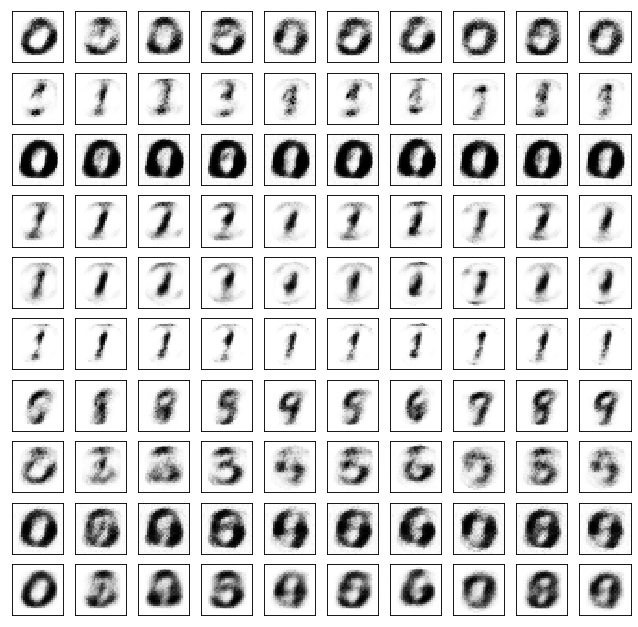

	reconstruction


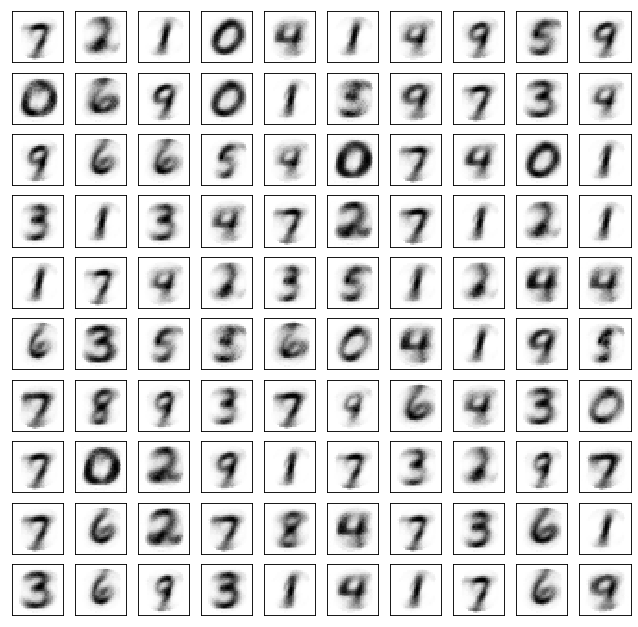

Test losses. E: 0.7828, AE: 0.1971, D: 0.6664
Train Epoch: 8 [0/50000 (0%)]	Losses E: 0.8053, AE: 0.2035, D: 0.6719
Train Epoch: 8 [25000/50000 (50%)]	Losses E: 0.6461, AE: 0.1972, D: 0.8060
Train Epoch: 8 [50000/50000 (100%)]	Losses E: 0.6577, AE: 0.1865, D: 0.7057
	generation


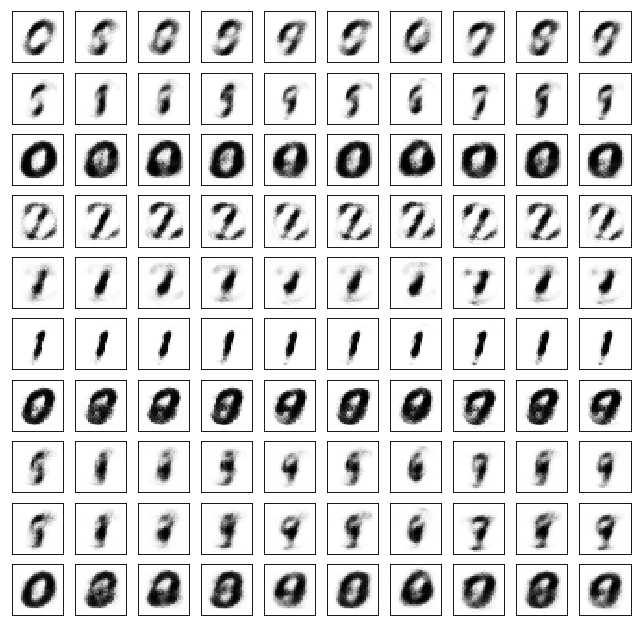

	reconstruction


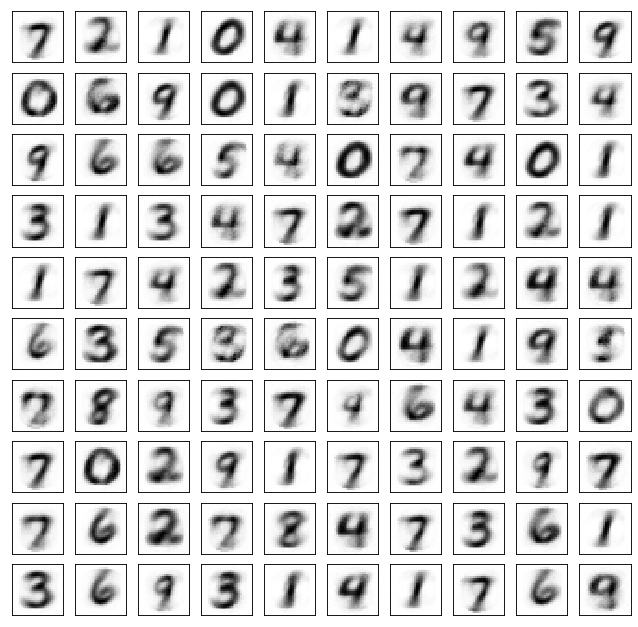

Test losses. E: 0.6524, AE: 0.1846, D: 0.6991
Train Epoch: 9 [0/50000 (0%)]	Losses E: 0.6558, AE: 0.1815, D: 0.7029
Train Epoch: 9 [25000/50000 (50%)]	Losses E: 0.7224, AE: 0.1856, D: 0.6903
Train Epoch: 9 [50000/50000 (100%)]	Losses E: 0.6688, AE: 0.1818, D: 0.7468
	generation


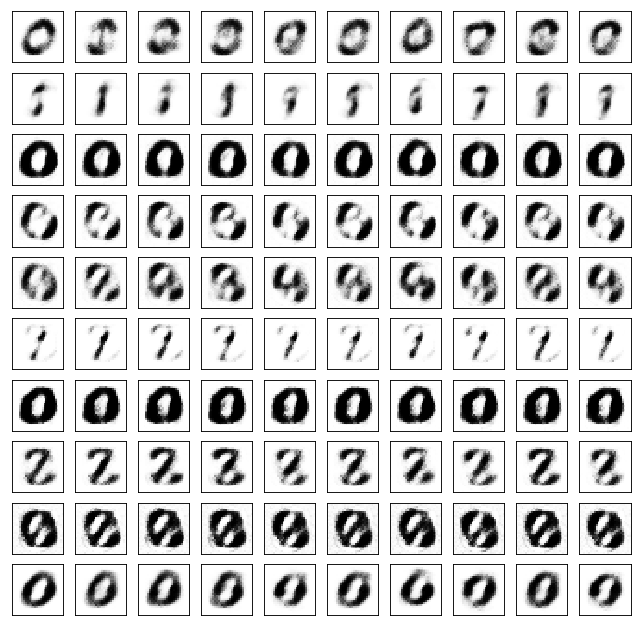

	reconstruction


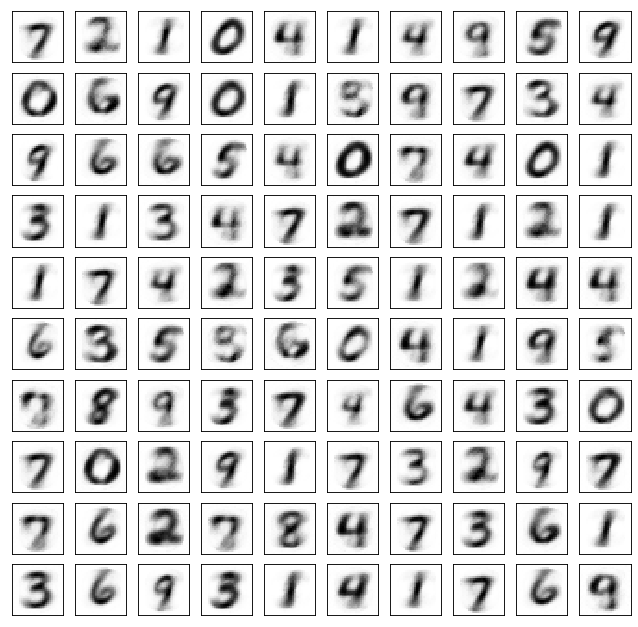

Test losses. E: 0.6638, AE: 0.1793, D: 0.7524
Train Epoch: 10 [0/50000 (0%)]	Losses E: 0.6622, AE: 0.1871, D: 0.7635
Train Epoch: 10 [25000/50000 (50%)]	Losses E: 0.6701, AE: 0.1824, D: 0.7315
Train Epoch: 10 [50000/50000 (100%)]	Losses E: 0.9144, AE: 0.1804, D: 0.6572
	generation


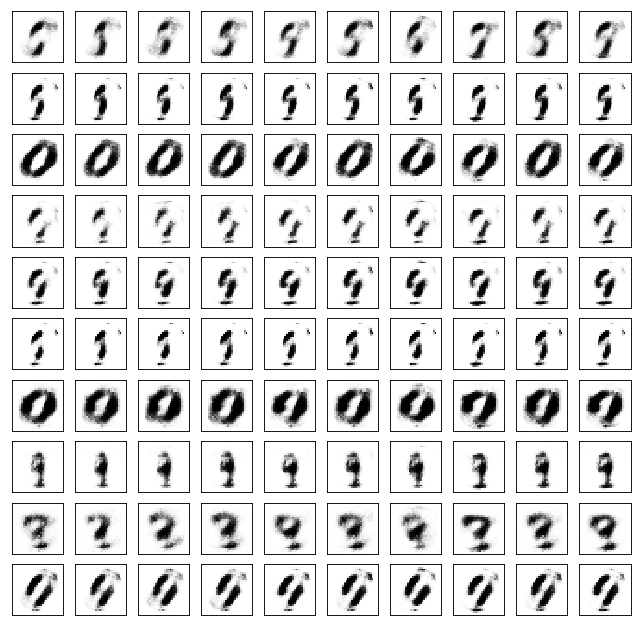

	reconstruction


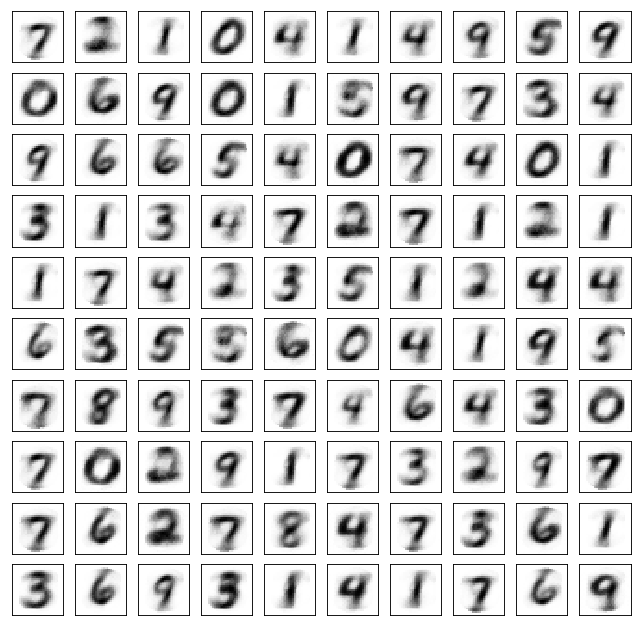

Test losses. E: 0.8774, AE: 0.1796, D: 0.6576
Train Epoch: 11 [0/50000 (0%)]	Losses E: 0.9145, AE: 0.1798, D: 0.6555
Train Epoch: 11 [25000/50000 (50%)]	Losses E: 0.5998, AE: 0.1713, D: 0.7365
Train Epoch: 11 [50000/50000 (100%)]	Losses E: 0.6641, AE: 0.1684, D: 0.7075
	generation


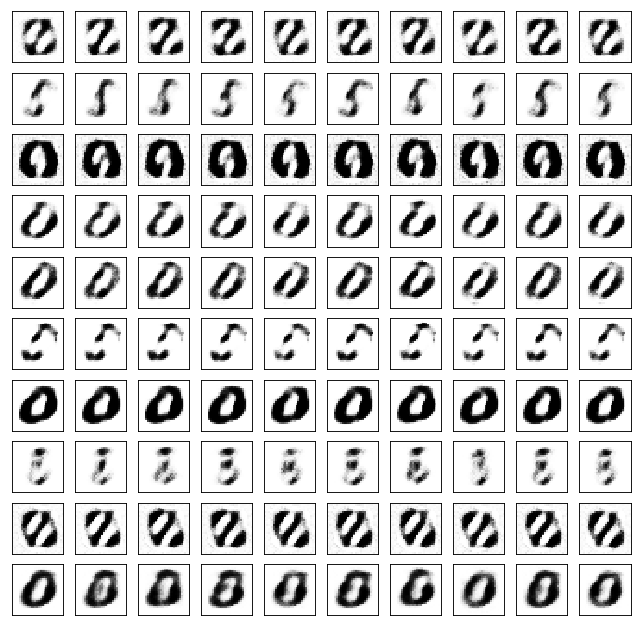

	reconstruction


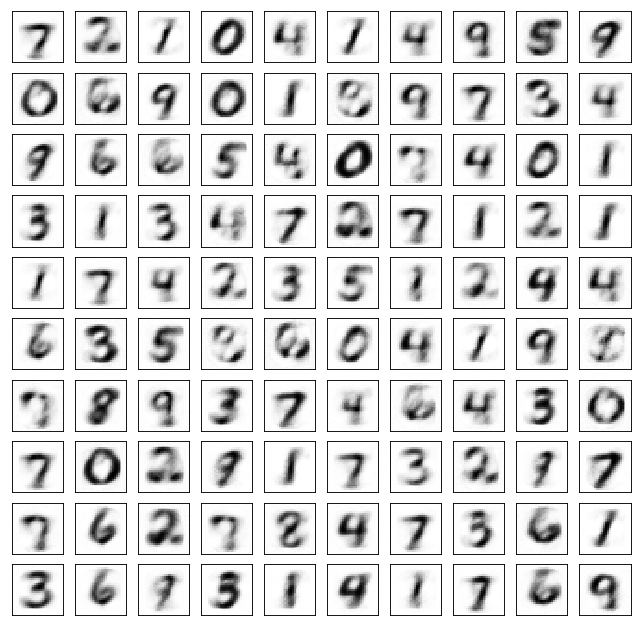

Test losses. E: 0.6549, AE: 0.1629, D: 0.7082
Train Epoch: 12 [0/50000 (0%)]	Losses E: 0.6620, AE: 0.1632, D: 0.7143
Train Epoch: 12 [25000/50000 (50%)]	Losses E: 0.7435, AE: 0.1690, D: 0.7196
Train Epoch: 12 [50000/50000 (100%)]	Losses E: 0.6439, AE: 0.1546, D: 0.6858
	generation


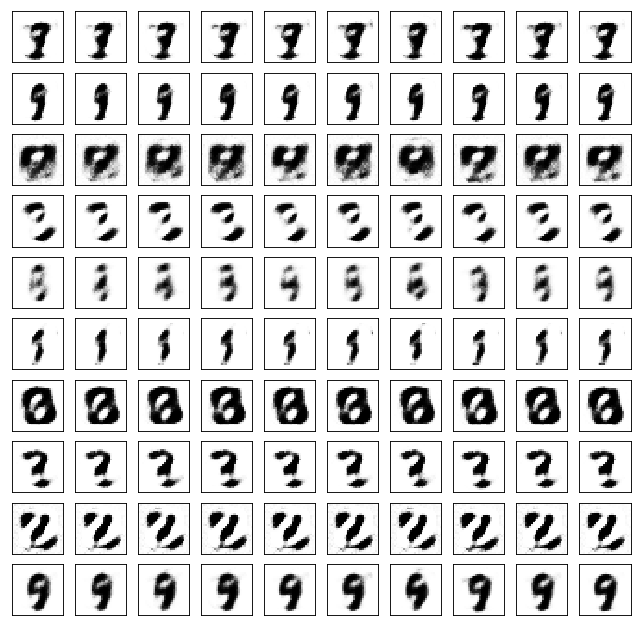

	reconstruction


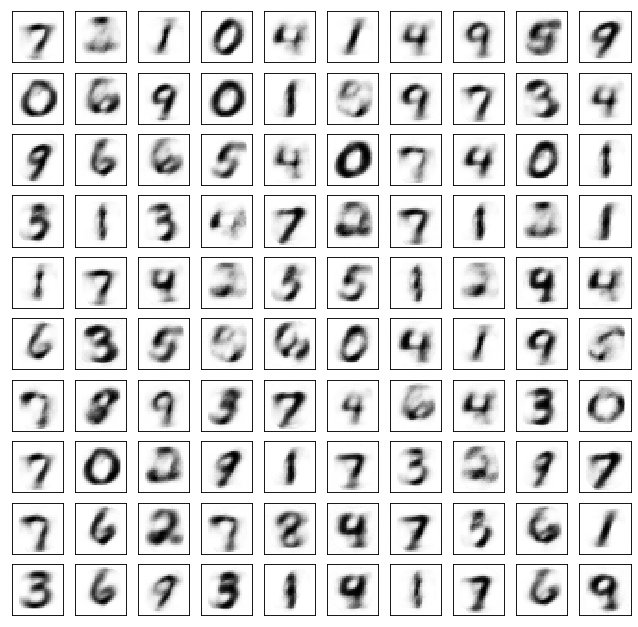

Test losses. E: 0.6417, AE: 0.1552, D: 0.6842
Train Epoch: 13 [0/50000 (0%)]	Losses E: 0.6428, AE: 0.1534, D: 0.6870
Train Epoch: 13 [25000/50000 (50%)]	Losses E: 0.6768, AE: 0.1670, D: 0.7463
Train Epoch: 13 [50000/50000 (100%)]	Losses E: 0.6418, AE: 0.1461, D: 0.7059
	generation


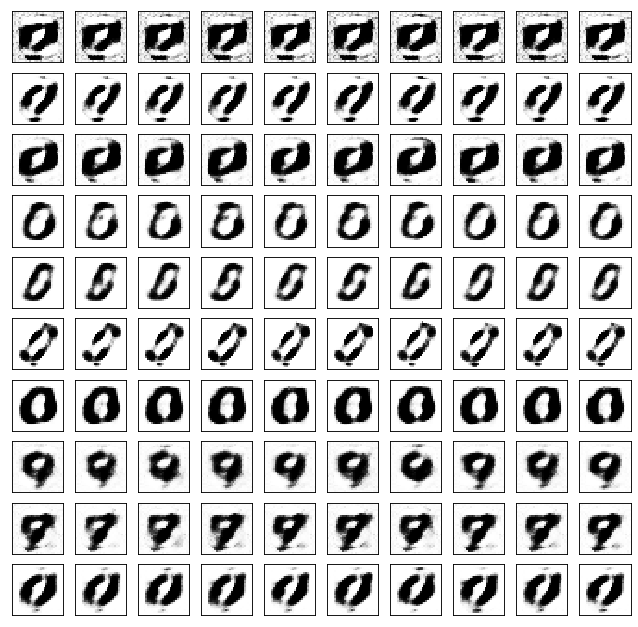

	reconstruction


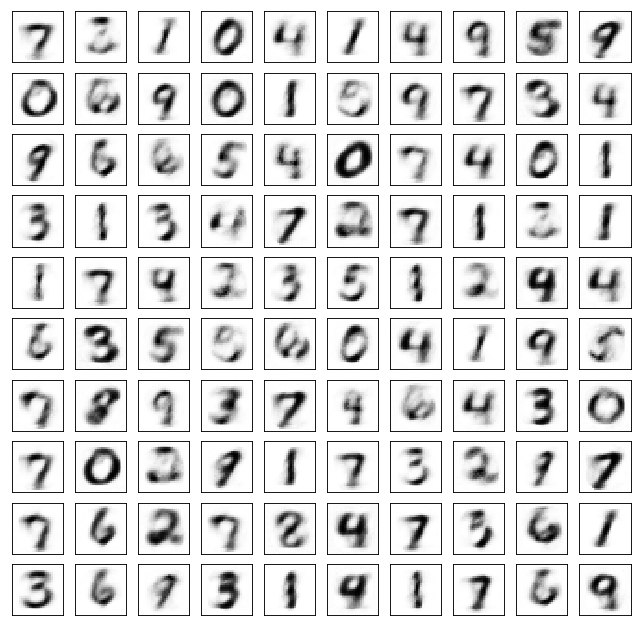

Test losses. E: 0.6386, AE: 0.1499, D: 0.7071
Train Epoch: 14 [0/50000 (0%)]	Losses E: 0.6413, AE: 0.1458, D: 0.7125
Train Epoch: 14 [25000/50000 (50%)]	Losses E: 0.5844, AE: 0.1593, D: 0.7352
Train Epoch: 14 [50000/50000 (100%)]	Losses E: 0.7335, AE: 0.1800, D: 0.8071
	generation


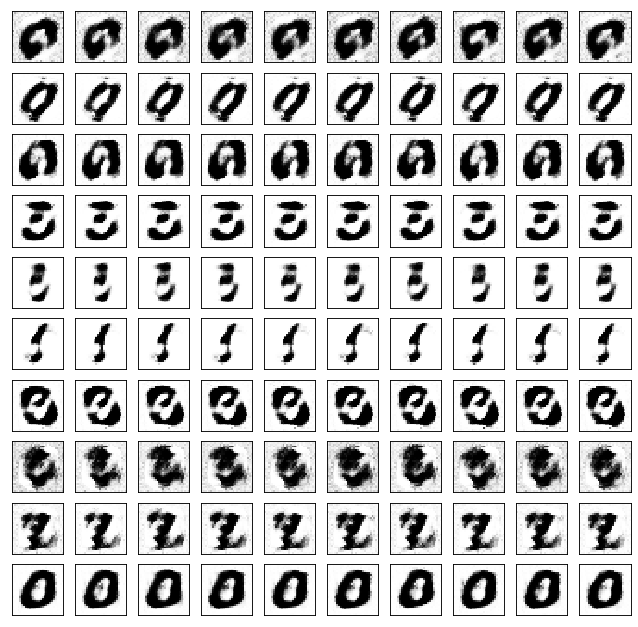

	reconstruction


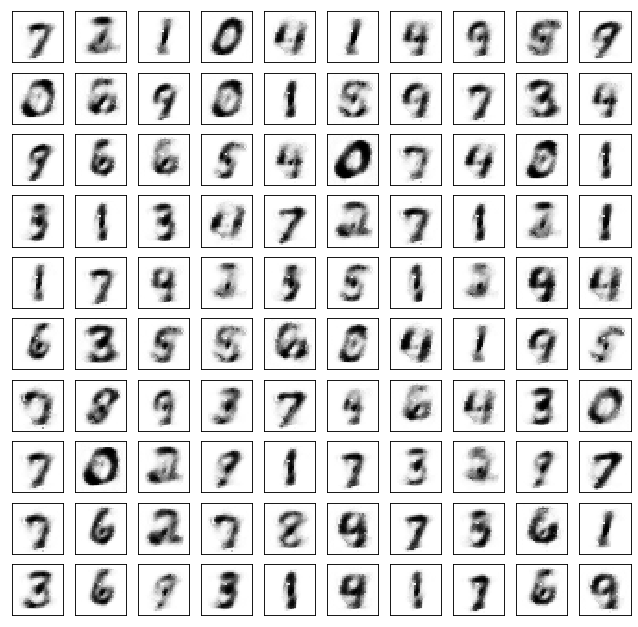

Test losses. E: 0.7260, AE: 0.1736, D: 0.8062
Train Epoch: 15 [0/50000 (0%)]	Losses E: 0.7287, AE: 0.1717, D: 0.8094
Train Epoch: 15 [25000/50000 (50%)]	Losses E: 0.6435, AE: 0.1461, D: 0.7082
Train Epoch: 15 [50000/50000 (100%)]	Losses E: 0.5917, AE: 0.1524, D: 0.7088
	generation


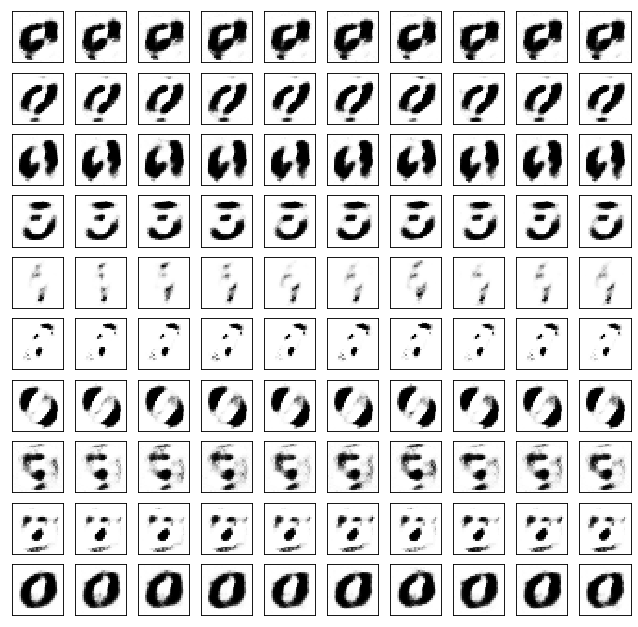

	reconstruction


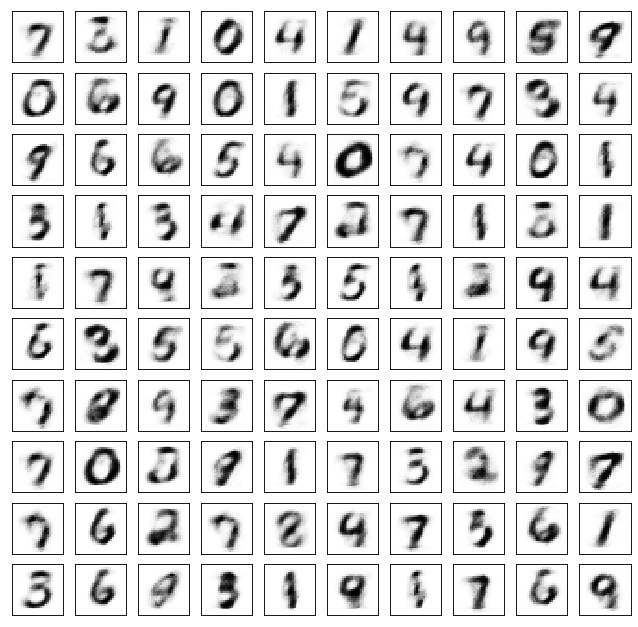

Test losses. E: 0.5744, AE: 0.1493, D: 0.7081
Train Epoch: 16 [0/50000 (0%)]	Losses E: 0.5958, AE: 0.1418, D: 0.7075
Train Epoch: 16 [25000/50000 (50%)]	Losses E: 0.7425, AE: 0.1554, D: 0.8063
Train Epoch: 16 [50000/50000 (100%)]	Losses E: 0.7957, AE: 0.1458, D: 0.6427
	generation


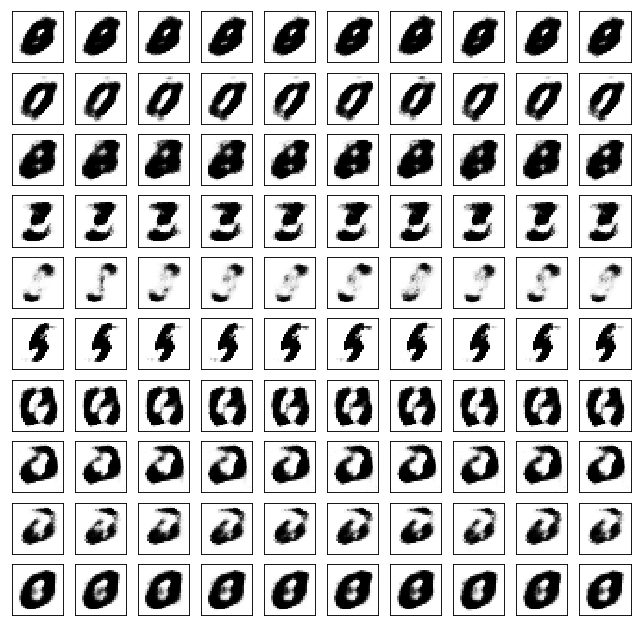

	reconstruction


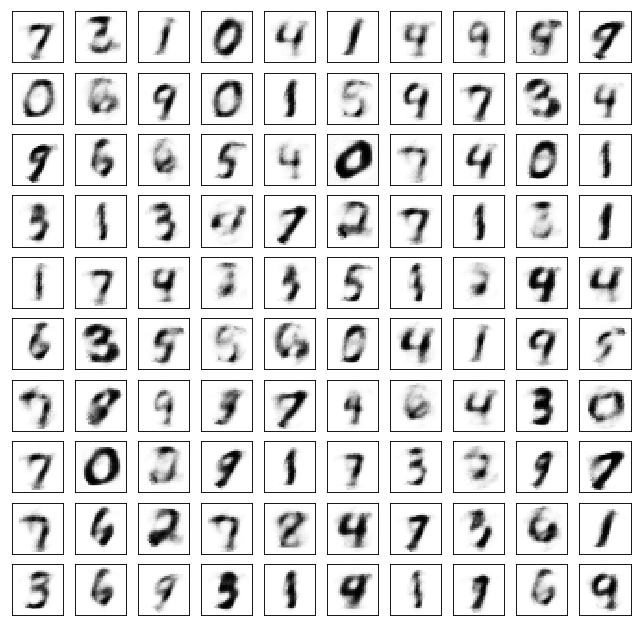

Test losses. E: 0.7700, AE: 0.1511, D: 0.6440
Train Epoch: 17 [0/50000 (0%)]	Losses E: 0.7847, AE: 0.1480, D: 0.6454
Train Epoch: 17 [25000/50000 (50%)]	Losses E: 0.6739, AE: 0.1417, D: 0.7381
Train Epoch: 17 [50000/50000 (100%)]	Losses E: 0.6591, AE: 0.1364, D: 0.6716
	generation


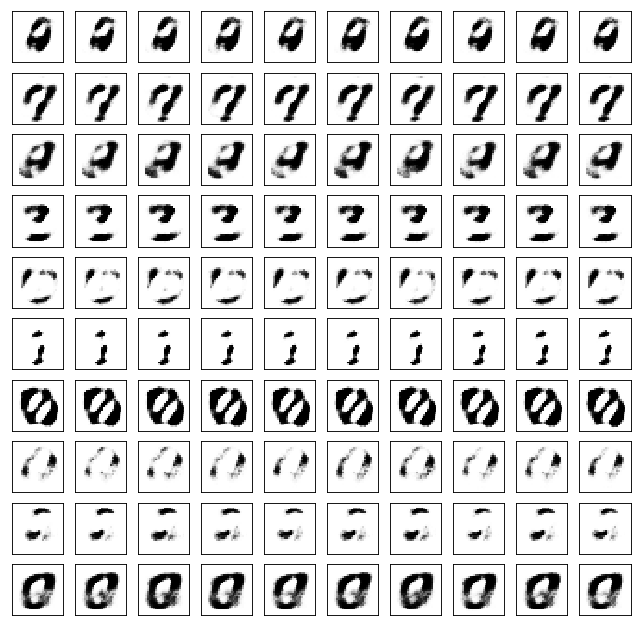

	reconstruction


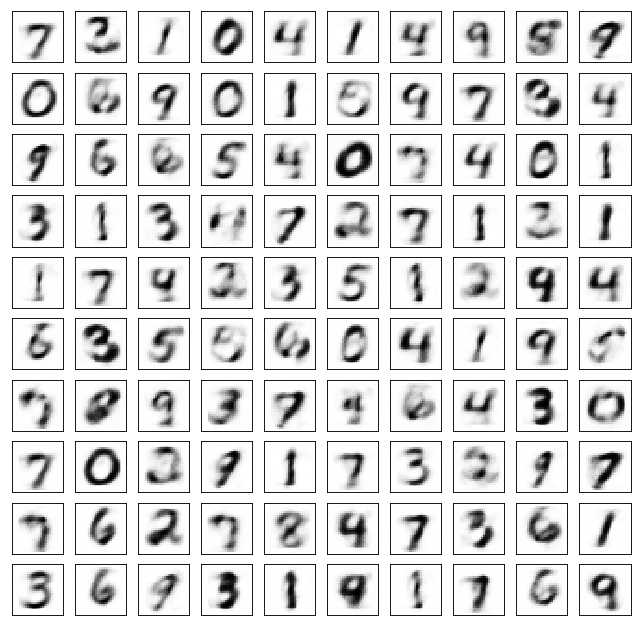

Test losses. E: 0.6574, AE: 0.1355, D: 0.6707
Train Epoch: 18 [0/50000 (0%)]	Losses E: 0.6563, AE: 0.1376, D: 0.6740
Train Epoch: 18 [25000/50000 (50%)]	Losses E: 0.5507, AE: 0.1438, D: 0.8636
Train Epoch: 18 [50000/50000 (100%)]	Losses E: 0.6946, AE: 0.1258, D: 0.7351
	generation


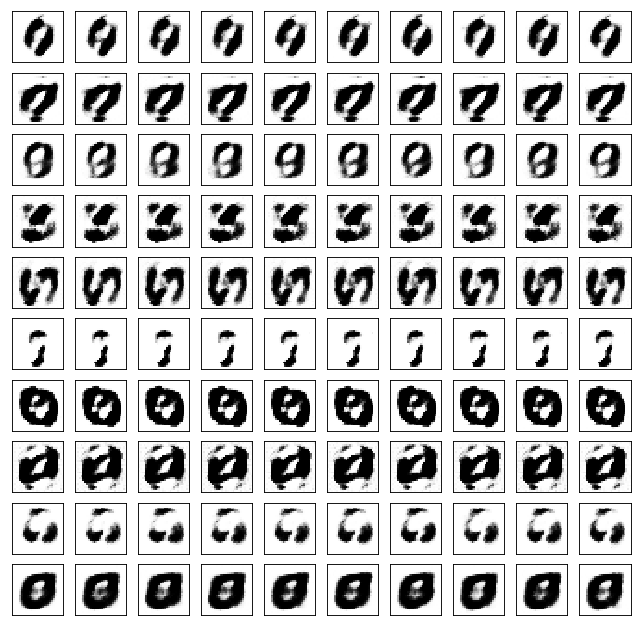

	reconstruction


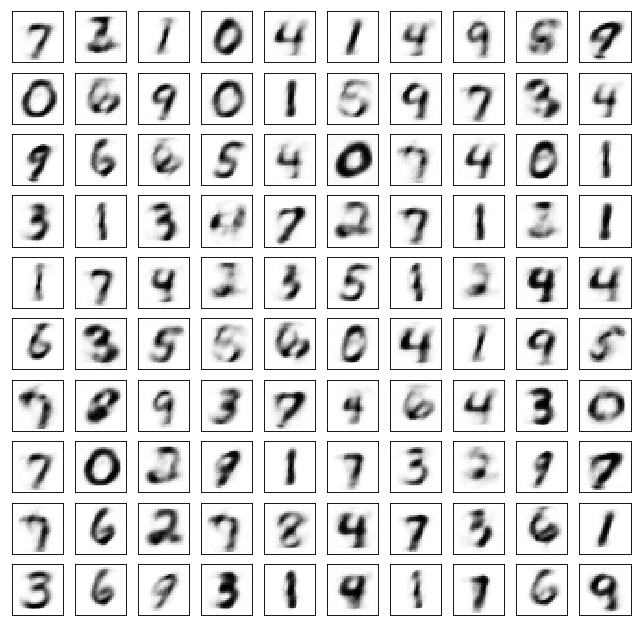

Test losses. E: 0.6952, AE: 0.1336, D: 0.7304
Train Epoch: 19 [0/50000 (0%)]	Losses E: 0.6937, AE: 0.1356, D: 0.7294
Train Epoch: 19 [25000/50000 (50%)]	Losses E: 0.6556, AE: 0.1337, D: 0.6646
Train Epoch: 19 [50000/50000 (100%)]	Losses E: 1.1519, AE: 0.2148, D: 0.7596
	generation


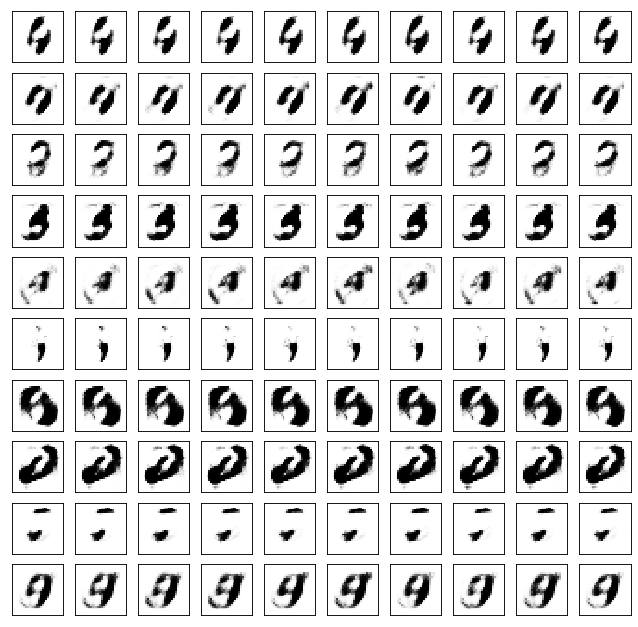

	reconstruction


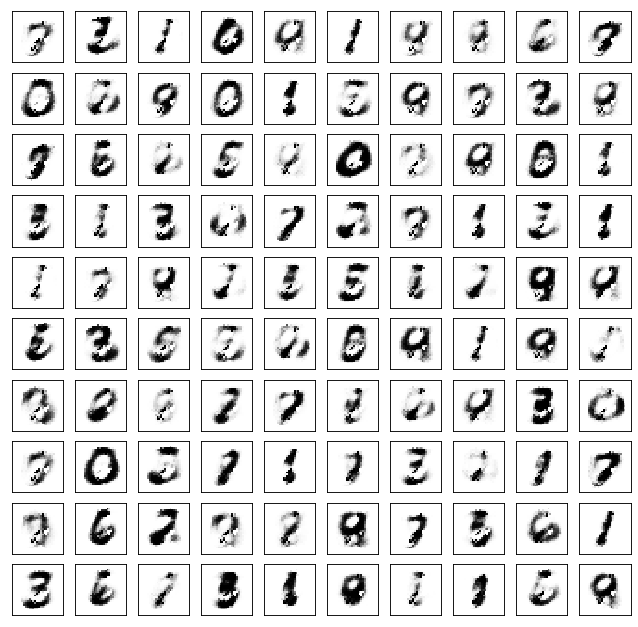

Test losses. E: 0.8486, AE: 0.2142, D: 0.7043
Train Epoch: 20 [0/50000 (0%)]	Losses E: 1.3193, AE: 0.2148, D: 0.7138
Train Epoch: 20 [25000/50000 (50%)]	Losses E: 0.7005, AE: 0.1358, D: 0.7536
Train Epoch: 20 [50000/50000 (100%)]	Losses E: 0.6137, AE: 0.1412, D: 0.6650
	generation


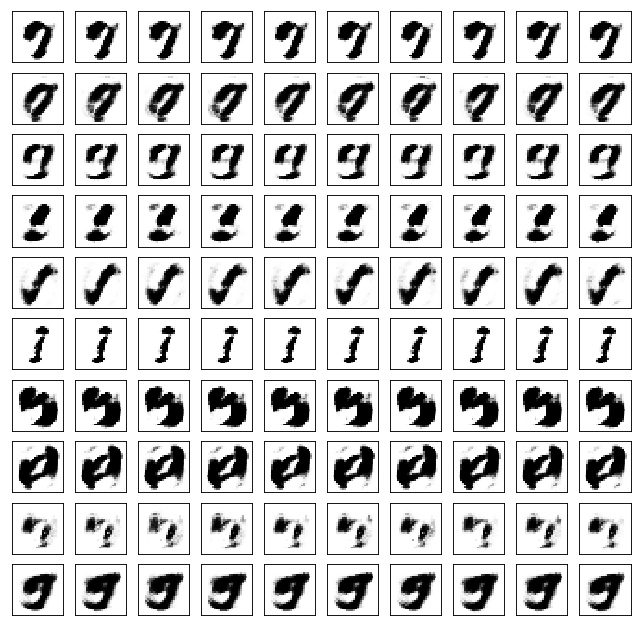

	reconstruction


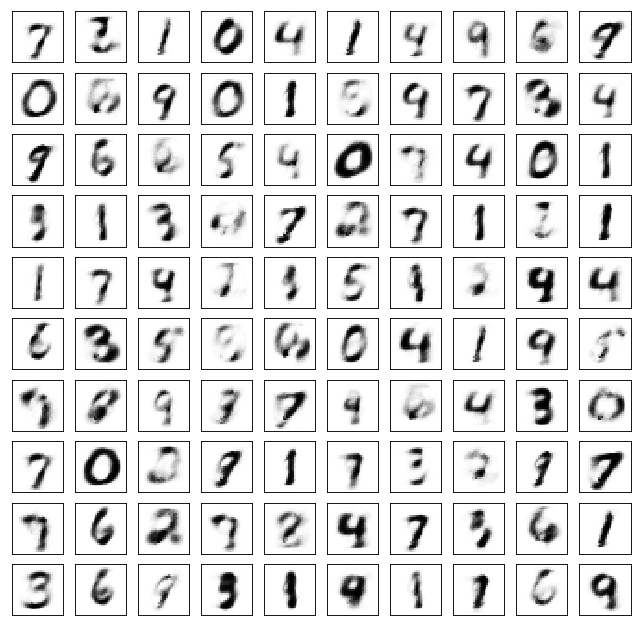

Test losses. E: 0.6111, AE: 0.1427, D: 0.6556
Train Epoch: 21 [0/50000 (0%)]	Losses E: 0.6146, AE: 0.1414, D: 0.6558
Train Epoch: 21 [25000/50000 (50%)]	Losses E: 3.2970, AE: 0.4202, D: 0.6239
Train Epoch: 21 [50000/50000 (100%)]	Losses E: 0.6557, AE: 0.1336, D: 0.7368
	generation


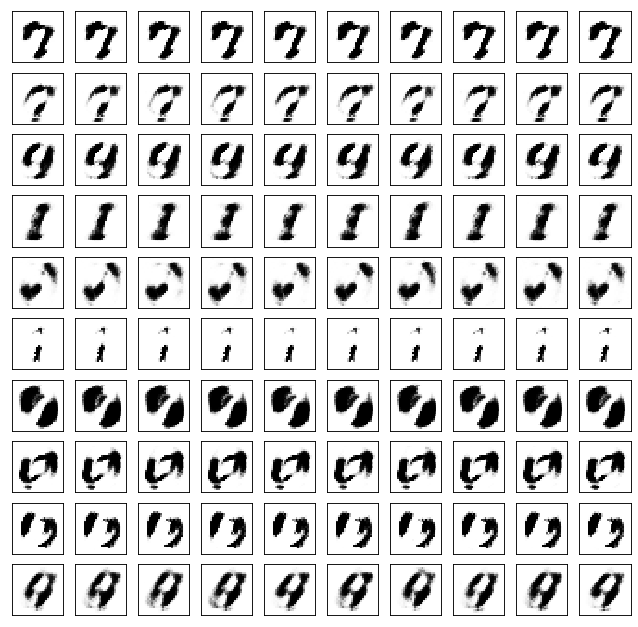

	reconstruction


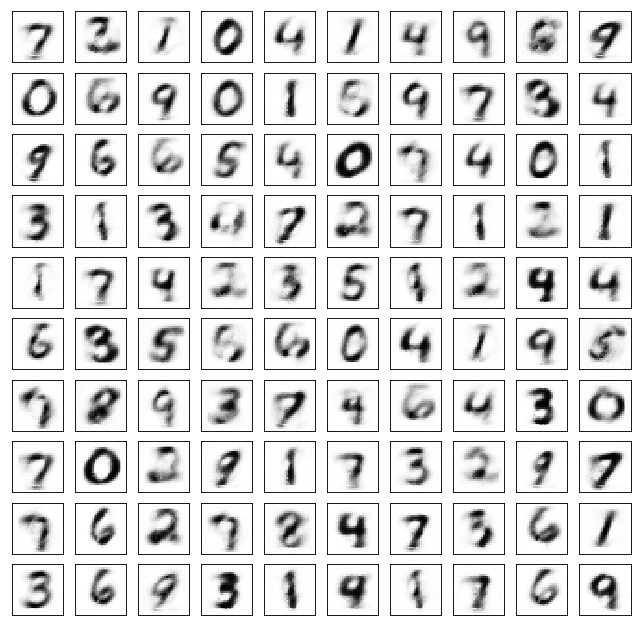

Test losses. E: 0.6555, AE: 0.1372, D: 0.7332
Train Epoch: 22 [0/50000 (0%)]	Losses E: 0.6536, AE: 0.1375, D: 0.7322
Train Epoch: 22 [25000/50000 (50%)]	Losses E: 0.5064, AE: 0.1676, D: 0.7333
Train Epoch: 22 [50000/50000 (100%)]	Losses E: 0.8945, AE: 0.2203, D: 0.7981
	generation


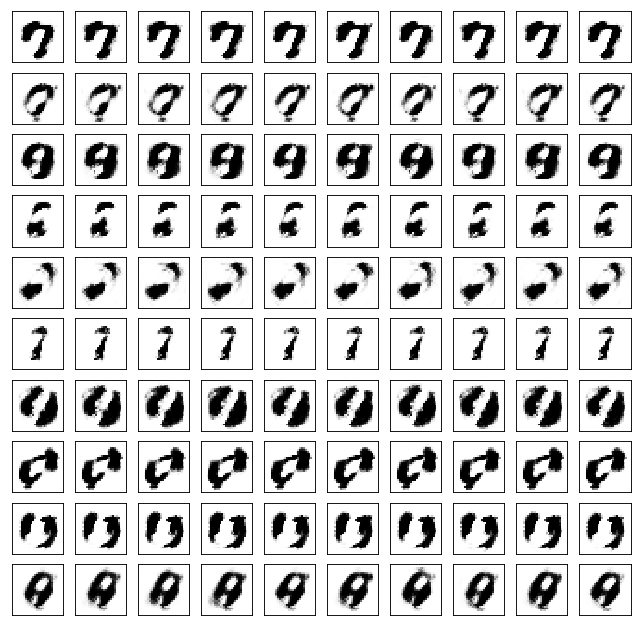

	reconstruction


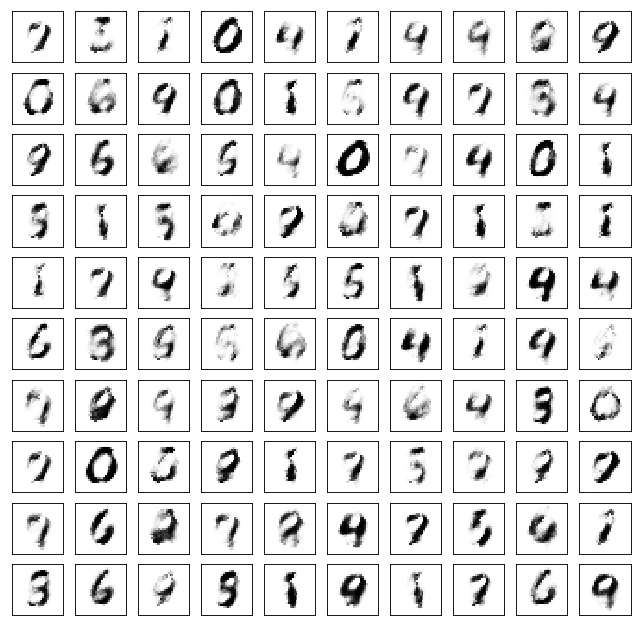

Test losses. E: 0.8575, AE: 0.2233, D: 0.7915
Train Epoch: 23 [0/50000 (0%)]	Losses E: 0.8887, AE: 0.2270, D: 0.7955
Train Epoch: 23 [25000/50000 (50%)]	Losses E: 0.6700, AE: 0.1346, D: 0.7009
Train Epoch: 23 [50000/50000 (100%)]	Losses E: 0.6480, AE: 0.1307, D: 0.6472
	generation


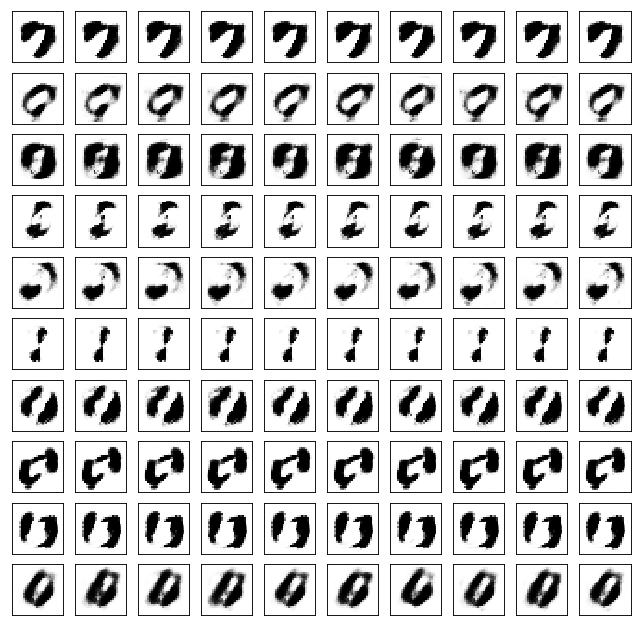

	reconstruction


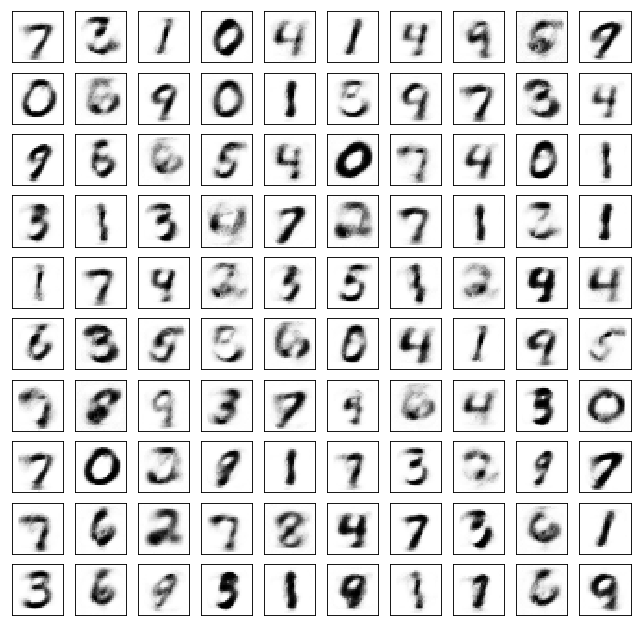

Test losses. E: 0.6432, AE: 0.1372, D: 0.6476
Train Epoch: 24 [0/50000 (0%)]	Losses E: 0.6472, AE: 0.1404, D: 0.6536
Train Epoch: 24 [25000/50000 (50%)]	Losses E: 0.8782, AE: 0.2626, D: 0.7950
Train Epoch: 24 [50000/50000 (100%)]	Losses E: 0.6608, AE: 0.1357, D: 0.6966
	generation


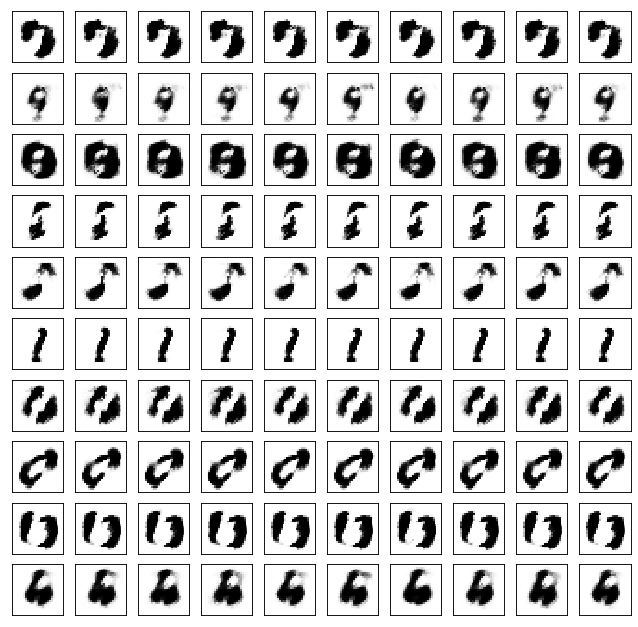

	reconstruction


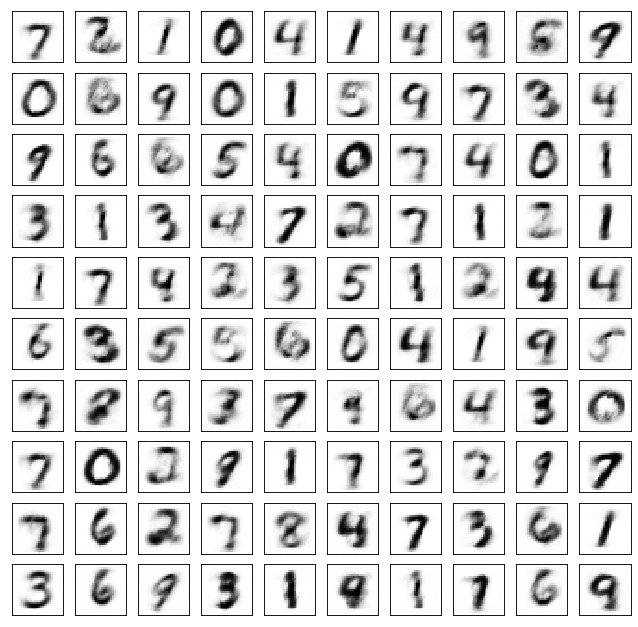

Test losses. E: 0.6612, AE: 0.1335, D: 0.6969
Train Epoch: 25 [0/50000 (0%)]	Losses E: 0.6620, AE: 0.1333, D: 0.6976
Train Epoch: 25 [25000/50000 (50%)]	Losses E: 0.5977, AE: 0.1358, D: 0.6760
Train Epoch: 25 [50000/50000 (100%)]	Losses E: 0.9770, AE: 0.2743, D: 0.7500
	generation


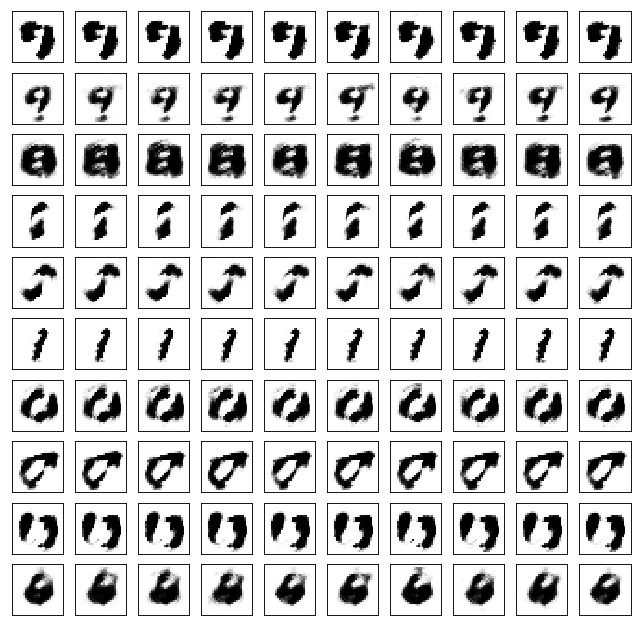

	reconstruction


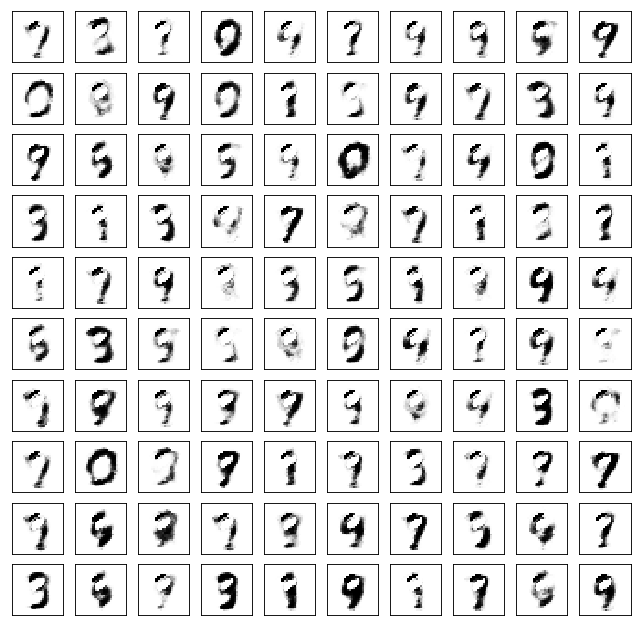

Test losses. E: 0.9396, AE: 0.2687, D: 0.7442
Train Epoch: 26 [0/50000 (0%)]	Losses E: 0.9969, AE: 0.2747, D: 0.7412
Train Epoch: 26 [25000/50000 (50%)]	Losses E: 0.6855, AE: 0.1331, D: 0.7083
Train Epoch: 26 [50000/50000 (100%)]	Losses E: 0.5940, AE: 0.1388, D: 0.6981
	generation


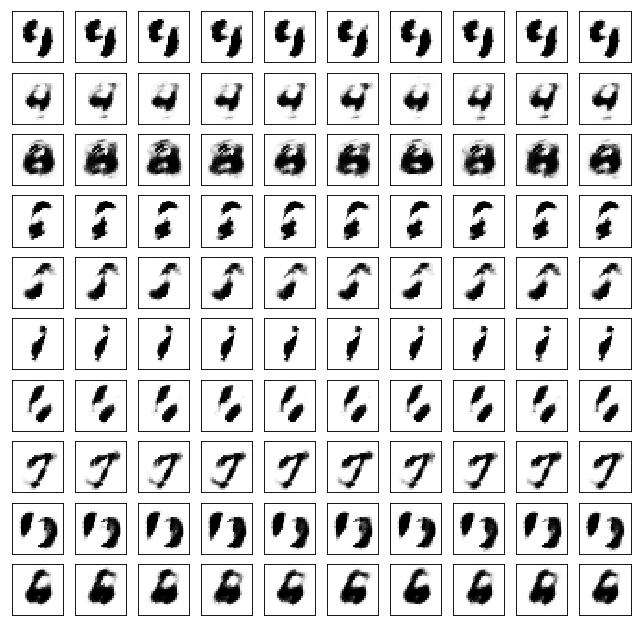

	reconstruction


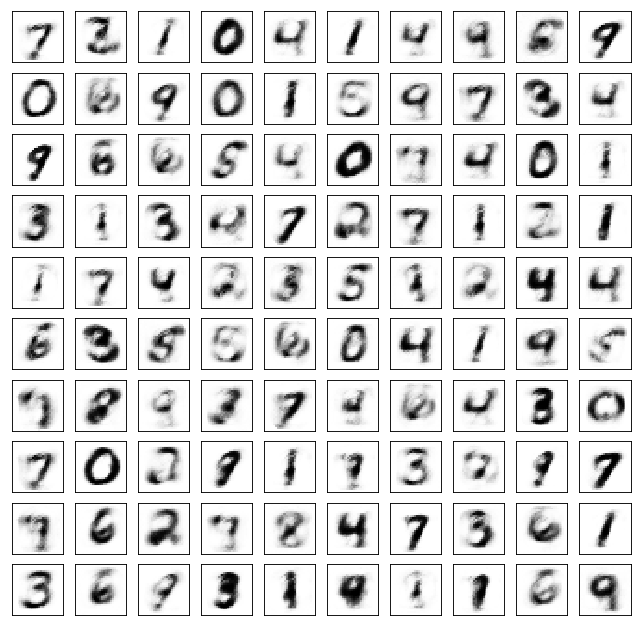

Test losses. E: 0.5900, AE: 0.1436, D: 0.6977
Train Epoch: 27 [0/50000 (0%)]	Losses E: 0.5892, AE: 0.1428, D: 0.7023
Train Epoch: 27 [25000/50000 (50%)]	Losses E: 0.7802, AE: 0.2399, D: 0.7755
Train Epoch: 27 [50000/50000 (100%)]	Losses E: 0.6753, AE: 0.1189, D: 0.6862
	generation


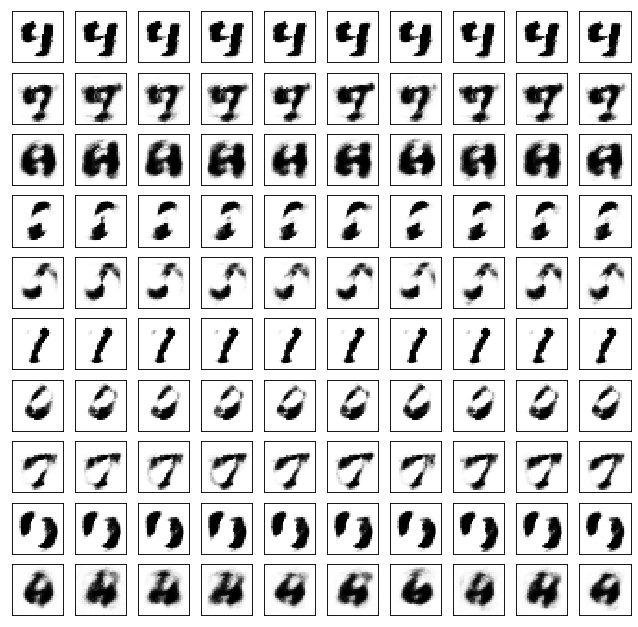

	reconstruction


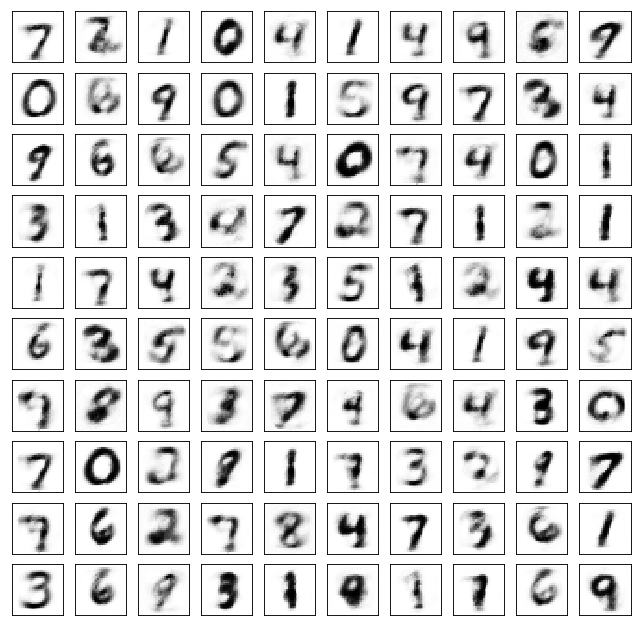

Test losses. E: 0.6779, AE: 0.1305, D: 0.6845
Train Epoch: 28 [0/50000 (0%)]	Losses E: 0.6775, AE: 0.1243, D: 0.6880
Train Epoch: 28 [25000/50000 (50%)]	Losses E: 0.4270, AE: 0.1871, D: 0.8763
Train Epoch: 28 [50000/50000 (100%)]	Losses E: 0.6992, AE: 0.1333, D: 0.7208
	generation


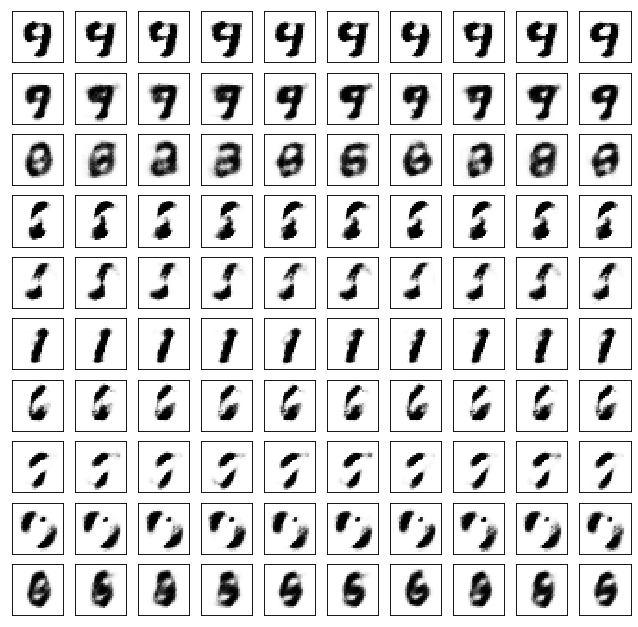

	reconstruction


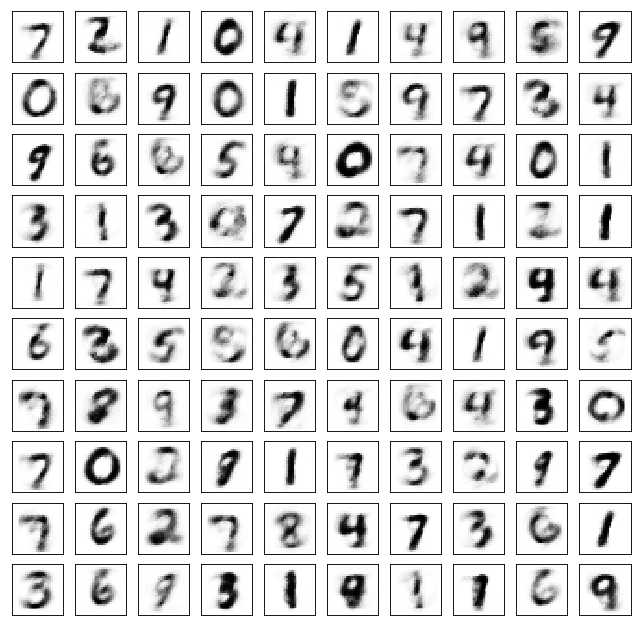

Test losses. E: 0.7015, AE: 0.1370, D: 0.7170
Train Epoch: 29 [0/50000 (0%)]	Losses E: 0.7035, AE: 0.1330, D: 0.7152
Train Epoch: 29 [25000/50000 (50%)]	Losses E: 0.6440, AE: 0.1376, D: 0.7153
Train Epoch: 29 [50000/50000 (100%)]	Losses E: 0.7924, AE: 0.1668, D: 0.6860
	generation


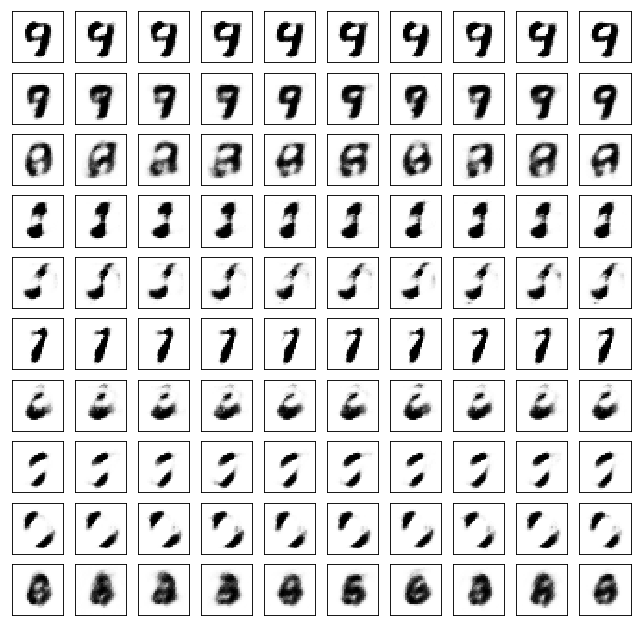

	reconstruction


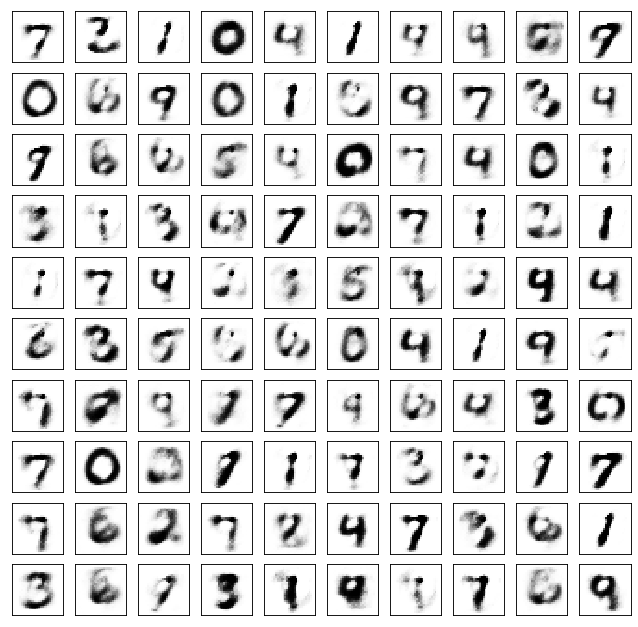

Test losses. E: 0.7621, AE: 0.1707, D: 0.6790
Train Epoch: 30 [0/50000 (0%)]	Losses E: 0.8160, AE: 0.1685, D: 0.6808
Train Epoch: 30 [25000/50000 (50%)]	Losses E: 0.7058, AE: 0.1309, D: 0.6871
Train Epoch: 30 [50000/50000 (100%)]	Losses E: 0.6948, AE: 0.1314, D: 0.7140
	generation


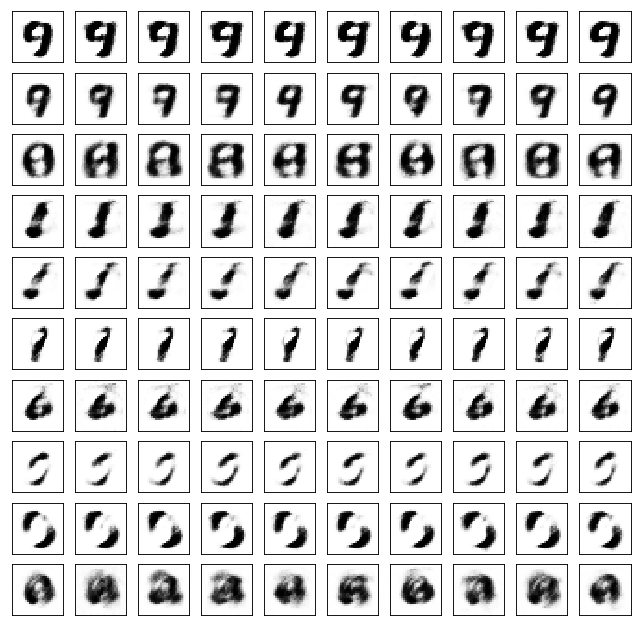

	reconstruction


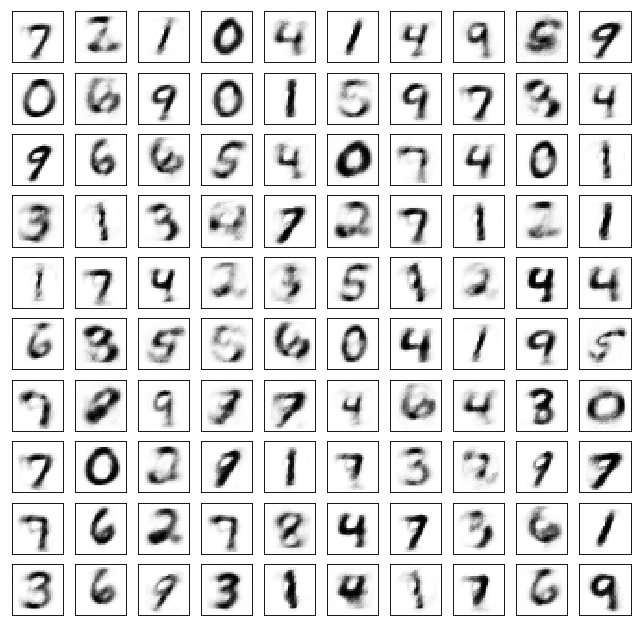

Test losses. E: 0.6916, AE: 0.1356, D: 0.7116
Train Epoch: 31 [0/50000 (0%)]	Losses E: 0.6934, AE: 0.1346, D: 0.7161
Train Epoch: 31 [25000/50000 (50%)]	Losses E: 0.6054, AE: 0.1256, D: 0.7430
Train Epoch: 31 [50000/50000 (100%)]	Losses E: 0.7235, AE: 0.1311, D: 0.6958
	generation


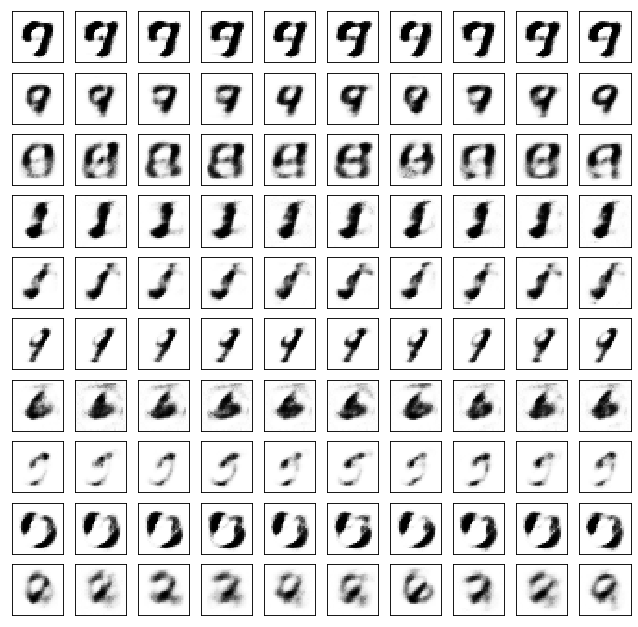

	reconstruction


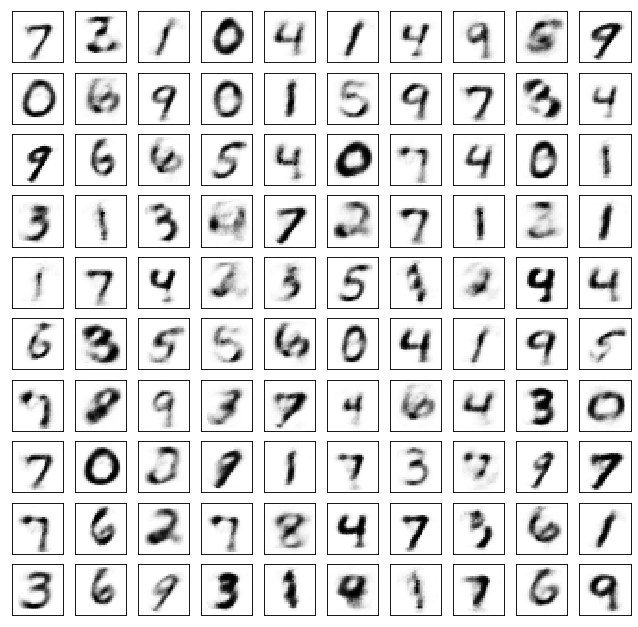

Test losses. E: 0.7198, AE: 0.1278, D: 0.6941
Train Epoch: 32 [0/50000 (0%)]	Losses E: 0.7295, AE: 0.1295, D: 0.6959
Train Epoch: 32 [25000/50000 (50%)]	Losses E: 0.6451, AE: 0.1215, D: 0.7071
Train Epoch: 32 [50000/50000 (100%)]	Losses E: 0.7307, AE: 0.1223, D: 0.7025
	generation


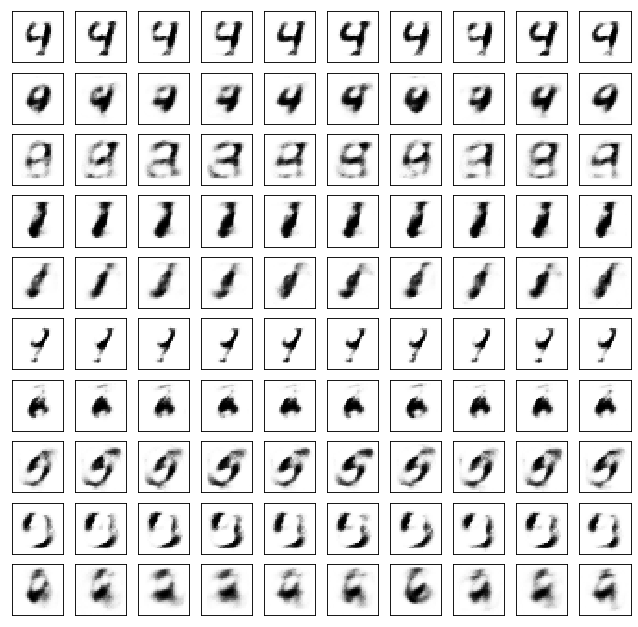

	reconstruction


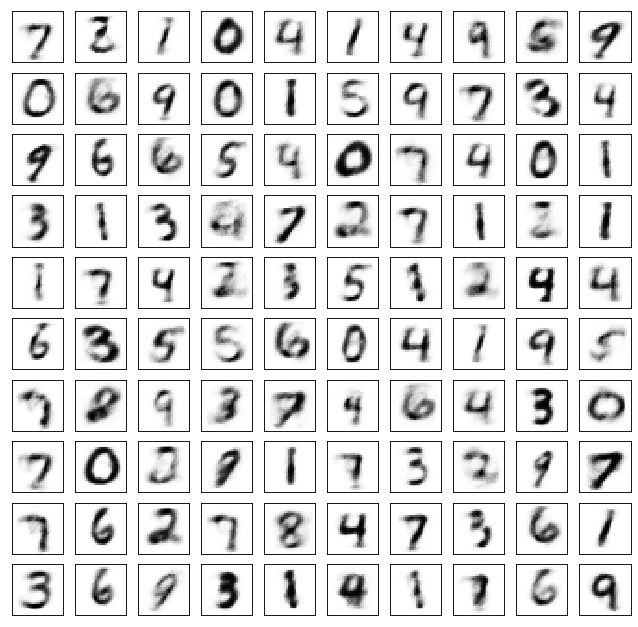

Test losses. E: 0.7275, AE: 0.1203, D: 0.6978
Train Epoch: 33 [0/50000 (0%)]	Losses E: 0.7276, AE: 0.1239, D: 0.7015
Train Epoch: 33 [25000/50000 (50%)]	Losses E: 0.7113, AE: 0.1222, D: 0.7029
Train Epoch: 33 [50000/50000 (100%)]	Losses E: 0.7326, AE: 0.1208, D: 0.6748
	generation


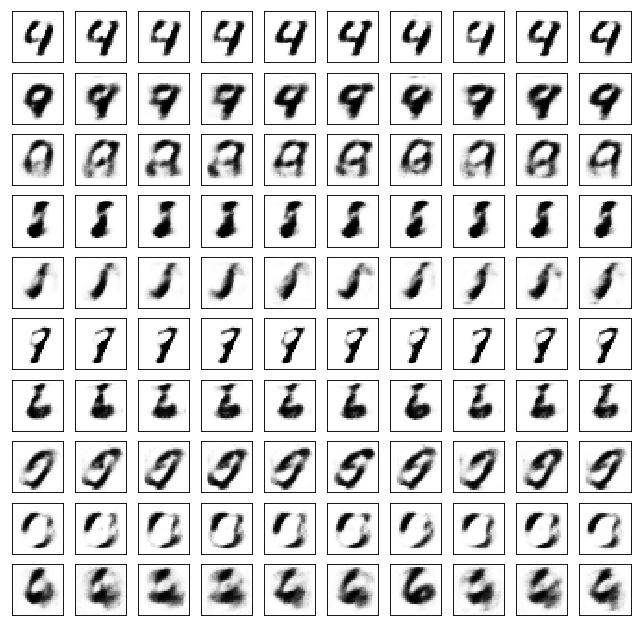

	reconstruction


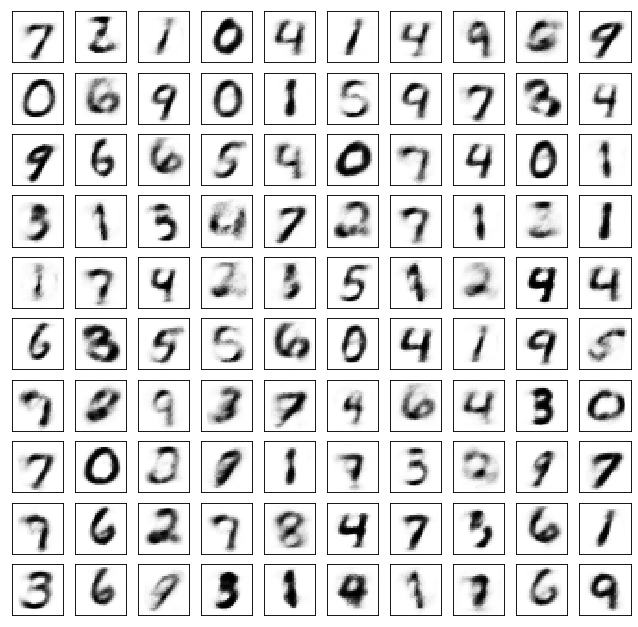

Test losses. E: 0.7239, AE: 0.1188, D: 0.6735
Train Epoch: 34 [0/50000 (0%)]	Losses E: 0.7388, AE: 0.1156, D: 0.6714
Train Epoch: 34 [25000/50000 (50%)]	Losses E: 0.7036, AE: 0.1175, D: 0.7022
Train Epoch: 34 [50000/50000 (100%)]	Losses E: 0.6786, AE: 0.1390, D: 0.7142
	generation


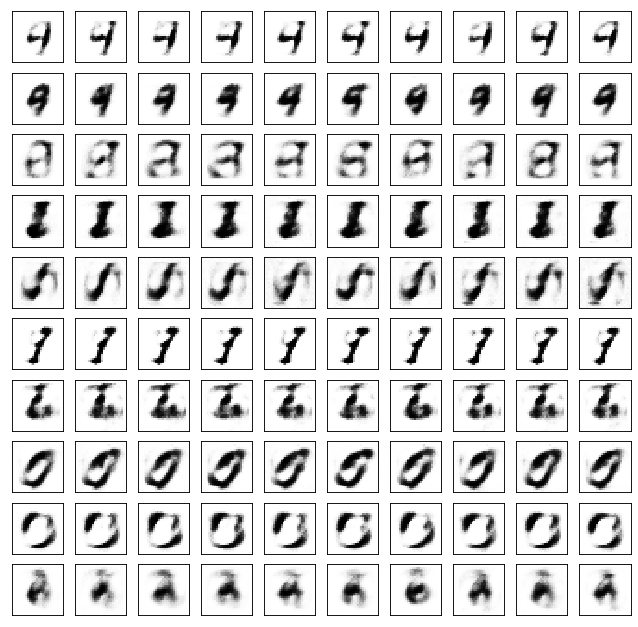

	reconstruction


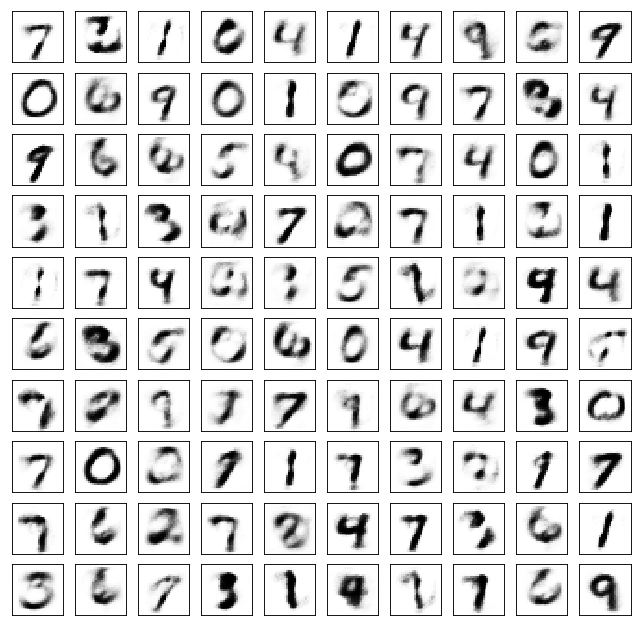

Test losses. E: 0.6628, AE: 0.1468, D: 0.7163
Train Epoch: 35 [0/50000 (0%)]	Losses E: 0.6755, AE: 0.1419, D: 0.7201
Train Epoch: 35 [25000/50000 (50%)]	Losses E: 0.6882, AE: 0.1142, D: 0.6907
Train Epoch: 35 [50000/50000 (100%)]	Losses E: 0.6751, AE: 0.1136, D: 0.7283
	generation


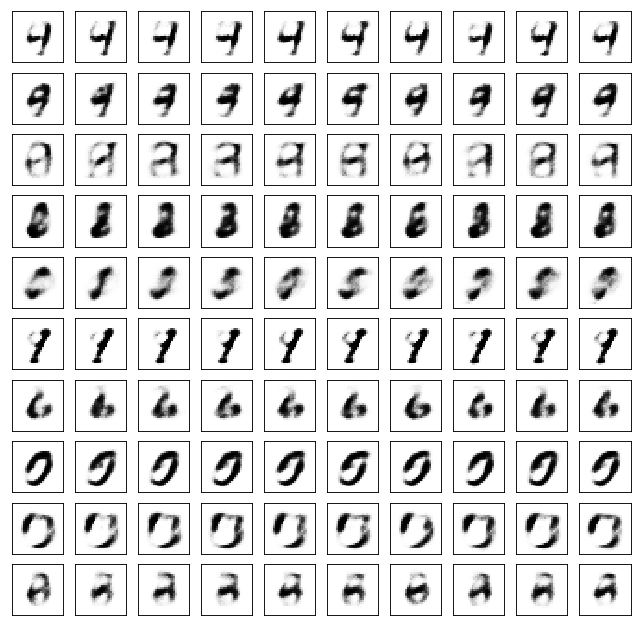

	reconstruction


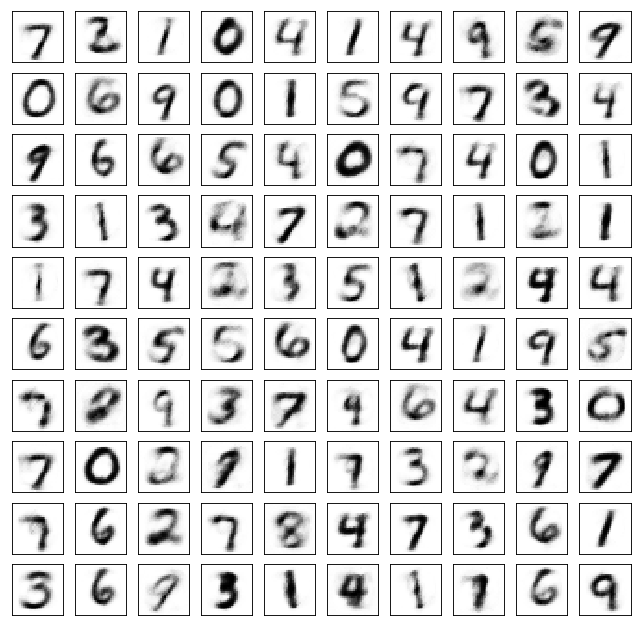

Test losses. E: 0.6767, AE: 0.1155, D: 0.7270
Train Epoch: 36 [0/50000 (0%)]	Losses E: 0.6769, AE: 0.1125, D: 0.7266
Train Epoch: 36 [25000/50000 (50%)]	Losses E: 0.6476, AE: 0.1154, D: 0.7059
Train Epoch: 36 [50000/50000 (100%)]	Losses E: 0.6731, AE: 0.1193, D: 0.6982
	generation


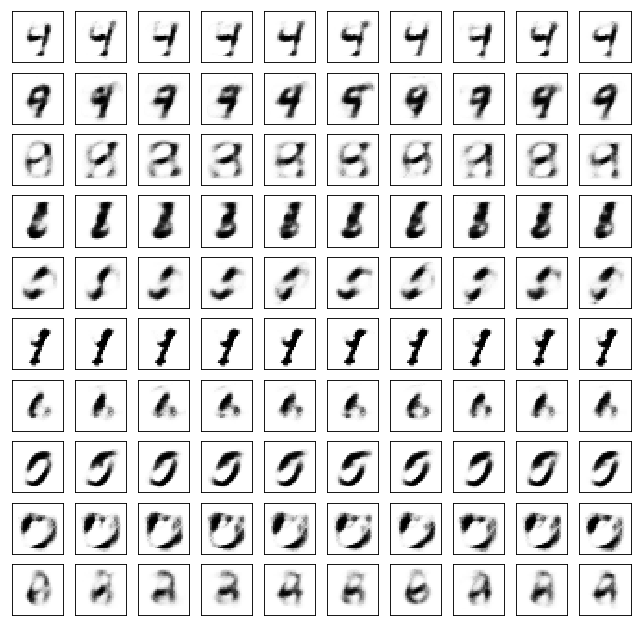

	reconstruction


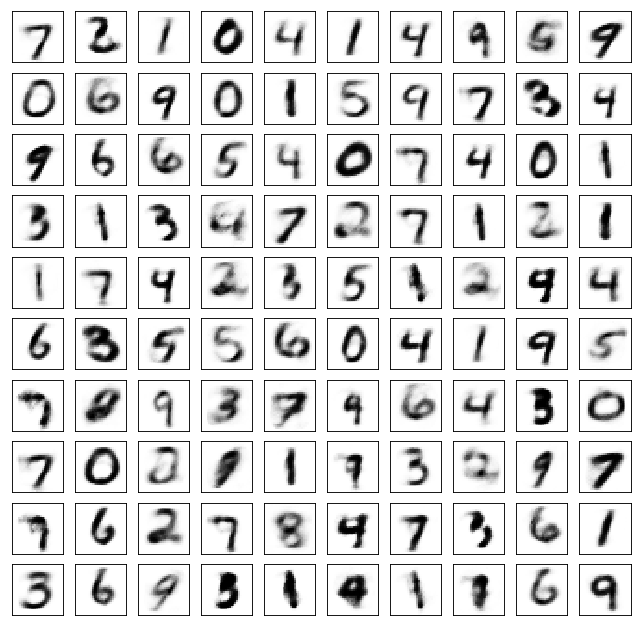

Test losses. E: 0.6692, AE: 0.1204, D: 0.7006
Train Epoch: 37 [0/50000 (0%)]	Losses E: 0.6731, AE: 0.1241, D: 0.7016
Train Epoch: 37 [25000/50000 (50%)]	Losses E: 0.7185, AE: 0.1121, D: 0.6996
Train Epoch: 37 [50000/50000 (100%)]	Losses E: 0.6370, AE: 0.1113, D: 0.7048
	generation


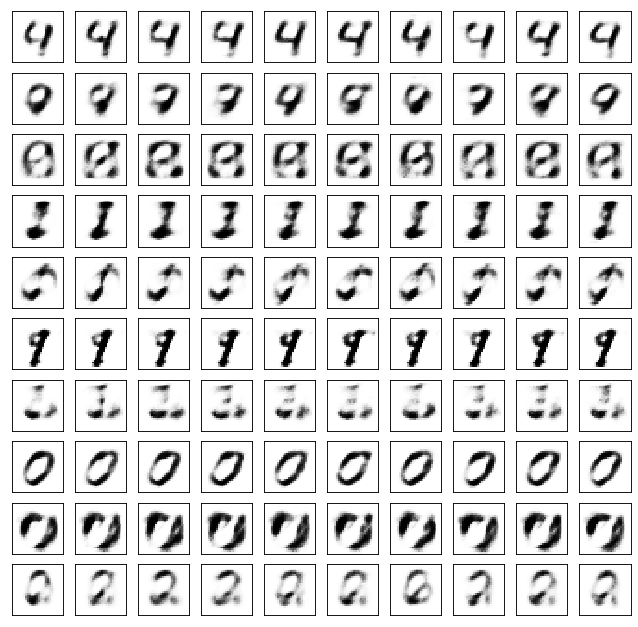

	reconstruction


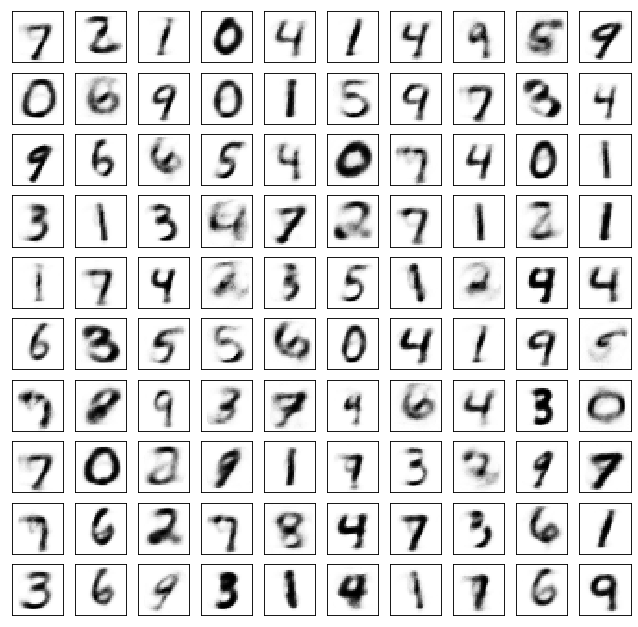

Test losses. E: 0.6340, AE: 0.1104, D: 0.7046
Train Epoch: 38 [0/50000 (0%)]	Losses E: 0.6412, AE: 0.1104, D: 0.7032
Train Epoch: 38 [25000/50000 (50%)]	Losses E: 0.6787, AE: 0.1114, D: 0.7058
Train Epoch: 38 [50000/50000 (100%)]	Losses E: 0.6390, AE: 0.1211, D: 0.7378
	generation


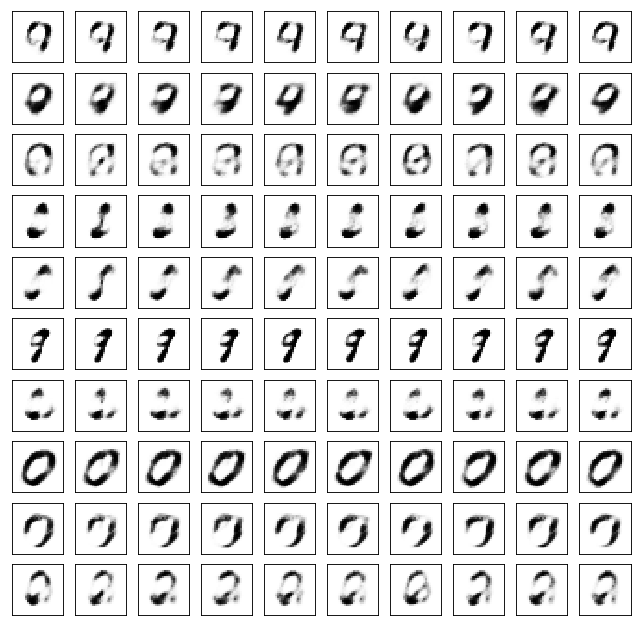

	reconstruction


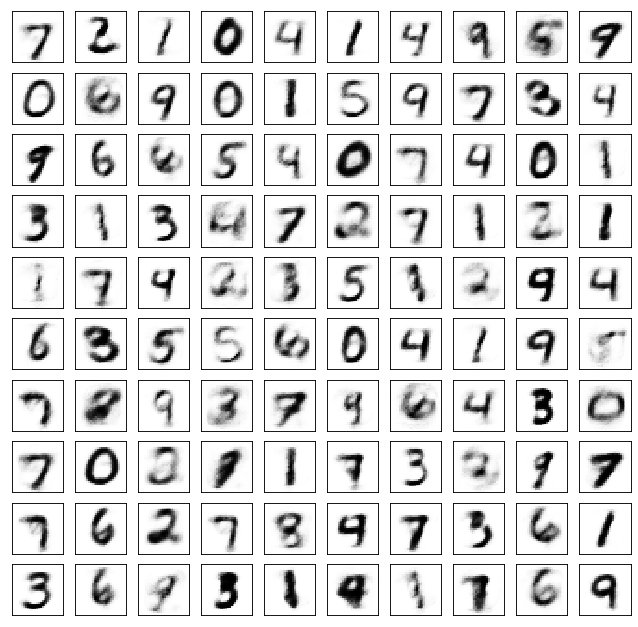

Test losses. E: 0.6304, AE: 0.1191, D: 0.7365
Train Epoch: 39 [0/50000 (0%)]	Losses E: 0.6462, AE: 0.1160, D: 0.7400
Train Epoch: 39 [25000/50000 (50%)]	Losses E: 0.6748, AE: 0.1106, D: 0.6980
Train Epoch: 39 [50000/50000 (100%)]	Losses E: 0.7019, AE: 0.1099, D: 0.7038
	generation


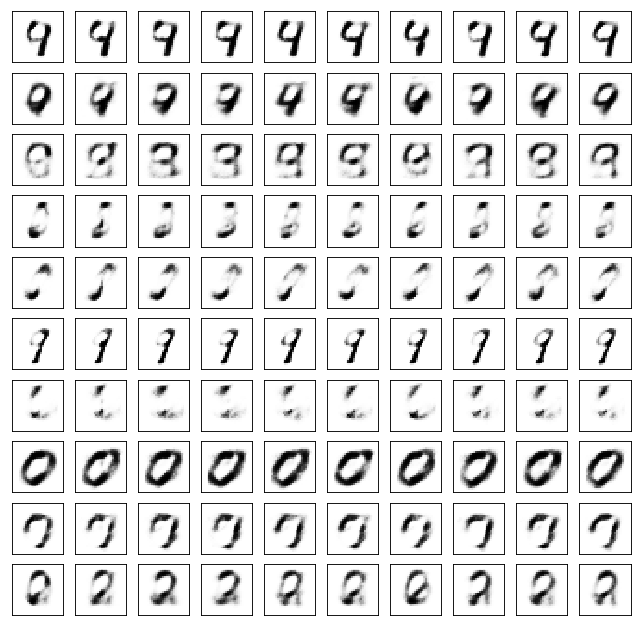

	reconstruction


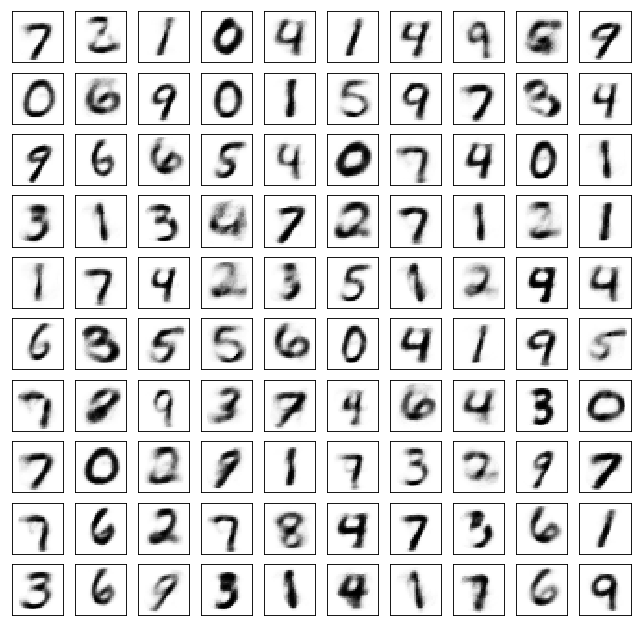

Test losses. E: 0.6996, AE: 0.1118, D: 0.7006
Train Epoch: 40 [0/50000 (0%)]	Losses E: 0.7040, AE: 0.1138, D: 0.7000
Train Epoch: 40 [25000/50000 (50%)]	Losses E: 0.7167, AE: 0.1170, D: 0.7124
Train Epoch: 40 [50000/50000 (100%)]	Losses E: 0.6192, AE: 0.1080, D: 0.7191
	generation


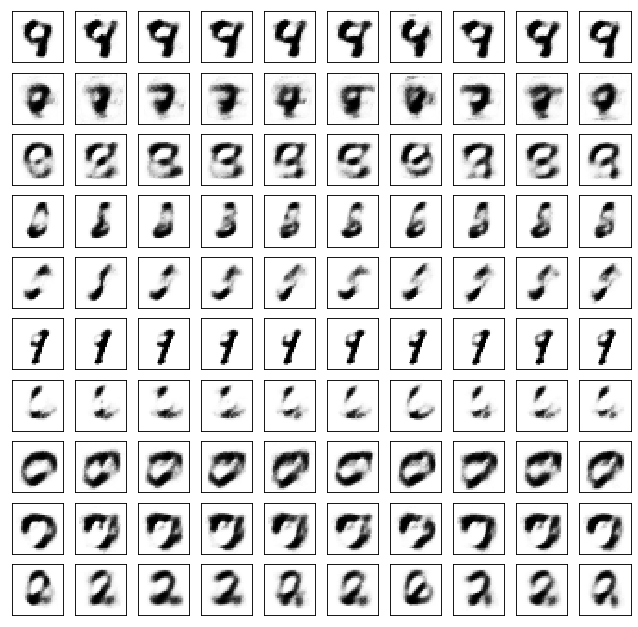

	reconstruction


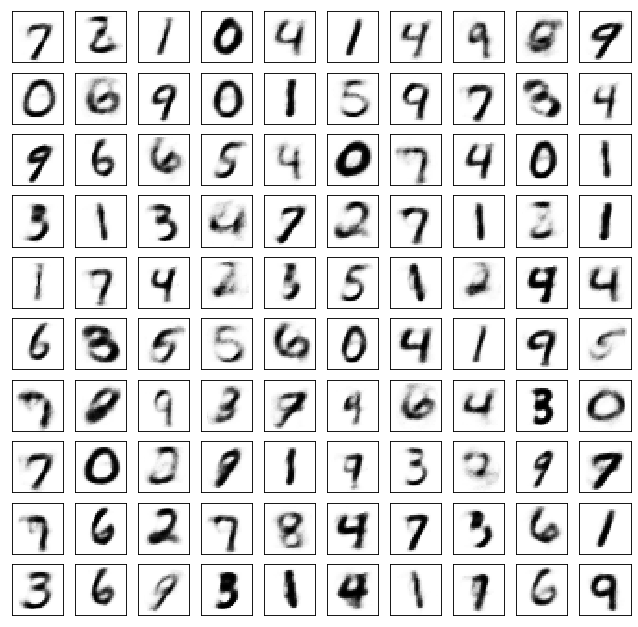

Test losses. E: 0.6162, AE: 0.1074, D: 0.7158
Train Epoch: 41 [0/50000 (0%)]	Losses E: 0.6256, AE: 0.1104, D: 0.7148
Train Epoch: 41 [25000/50000 (50%)]	Losses E: 0.7265, AE: 0.1068, D: 0.7049
Train Epoch: 41 [50000/50000 (100%)]	Losses E: 0.6309, AE: 0.1099, D: 0.7399
	generation


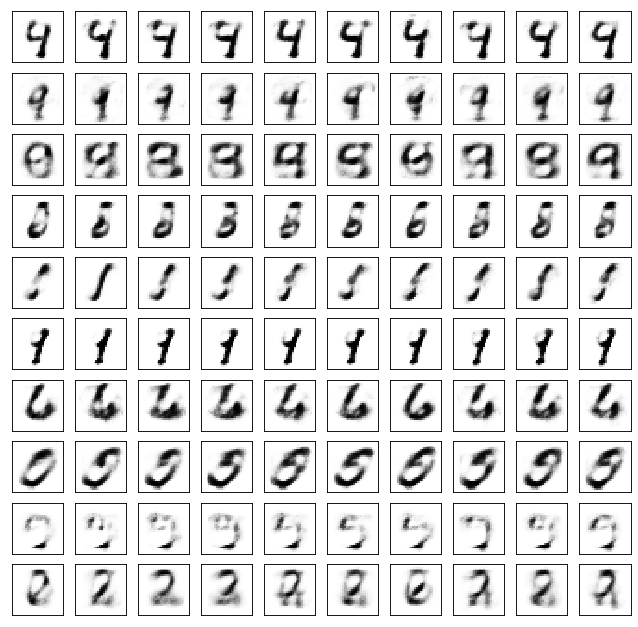

	reconstruction


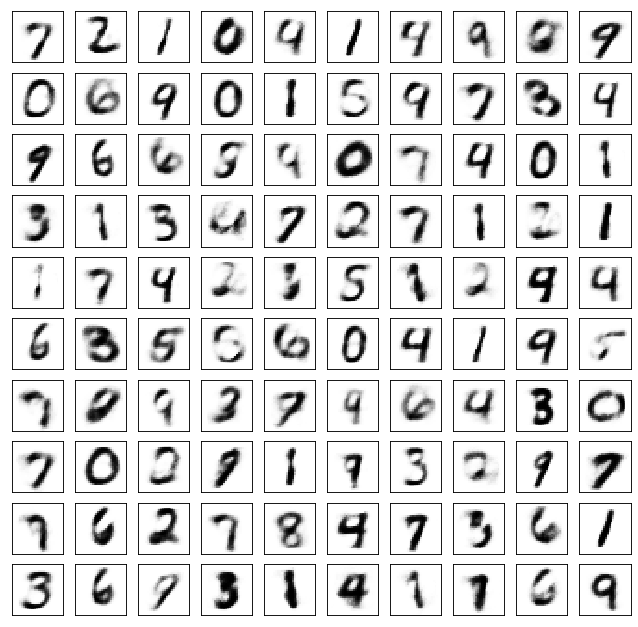

Test losses. E: 0.6185, AE: 0.1132, D: 0.7441
Train Epoch: 42 [0/50000 (0%)]	Losses E: 0.6260, AE: 0.1194, D: 0.7449
Train Epoch: 42 [25000/50000 (50%)]	Losses E: 0.6778, AE: 0.1080, D: 0.6961
Train Epoch: 42 [50000/50000 (100%)]	Losses E: 0.6701, AE: 0.1105, D: 0.7112
	generation


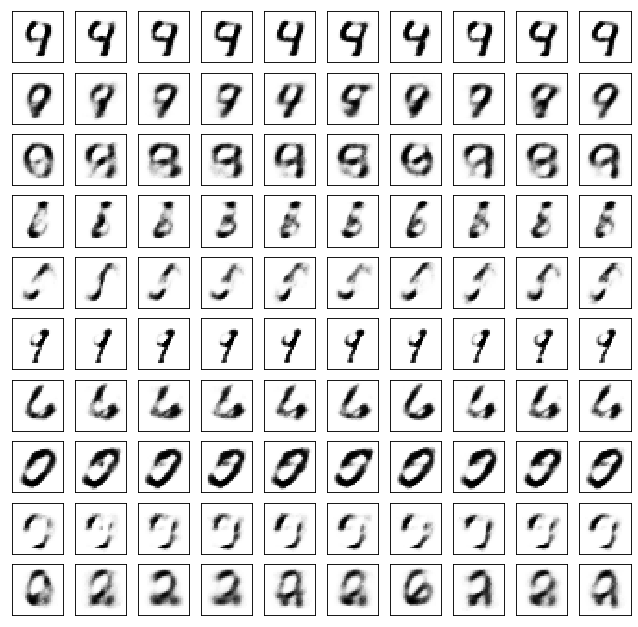

	reconstruction


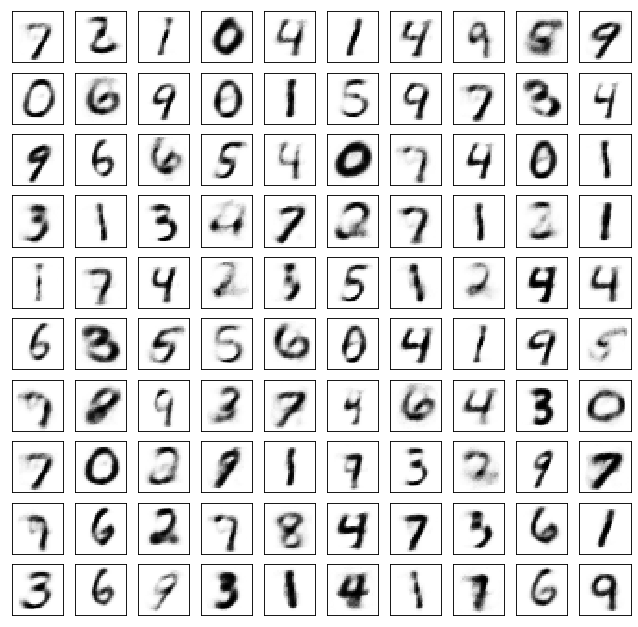

Test losses. E: 0.6654, AE: 0.1075, D: 0.7089
Train Epoch: 43 [0/50000 (0%)]	Losses E: 0.6689, AE: 0.1023, D: 0.7099
Train Epoch: 43 [25000/50000 (50%)]	Losses E: 0.6666, AE: 0.0971, D: 0.6942
Train Epoch: 43 [50000/50000 (100%)]	Losses E: 0.7942, AE: 0.1023, D: 0.7015
	generation


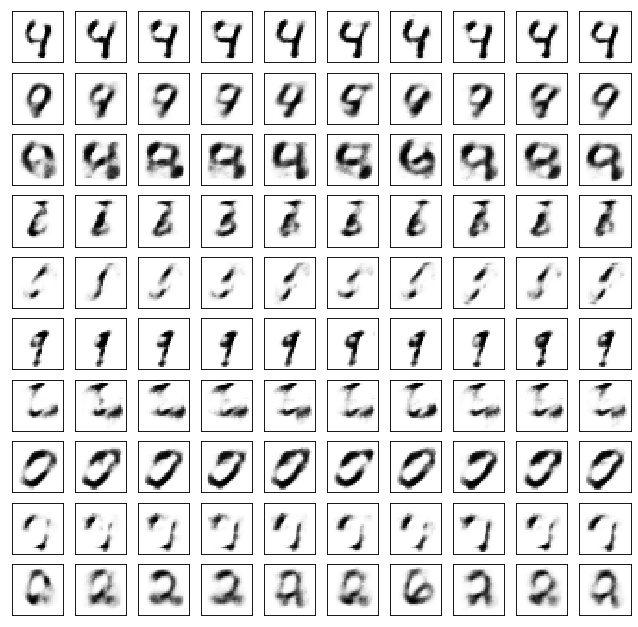

	reconstruction


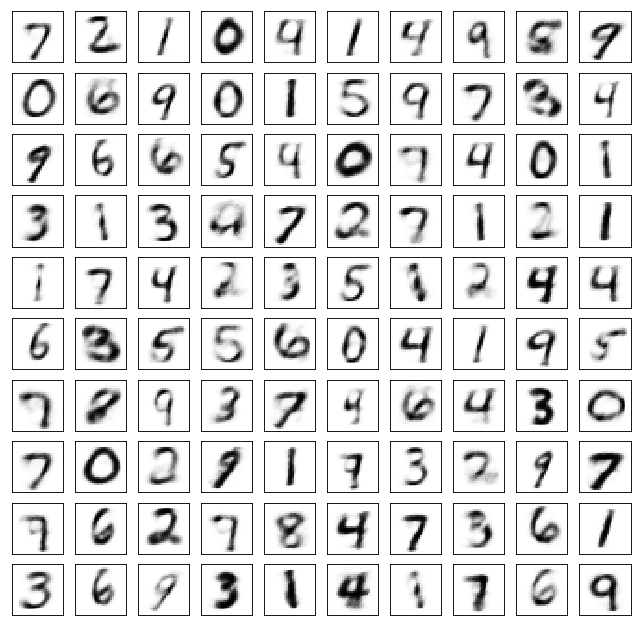

Test losses. E: 0.7939, AE: 0.1056, D: 0.6980
Train Epoch: 44 [0/50000 (0%)]	Losses E: 0.7993, AE: 0.1054, D: 0.6976
Train Epoch: 44 [25000/50000 (50%)]	Losses E: 0.6430, AE: 0.1069, D: 0.6958
Train Epoch: 44 [50000/50000 (100%)]	Losses E: 0.6937, AE: 0.0929, D: 0.6847
	generation


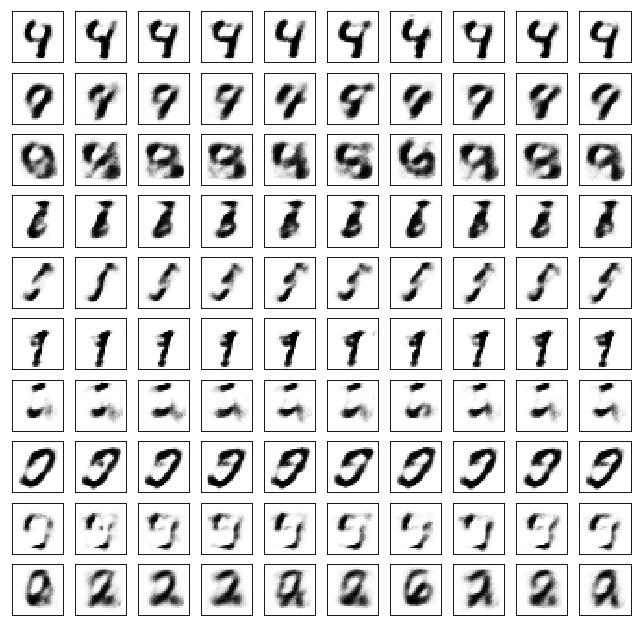

	reconstruction


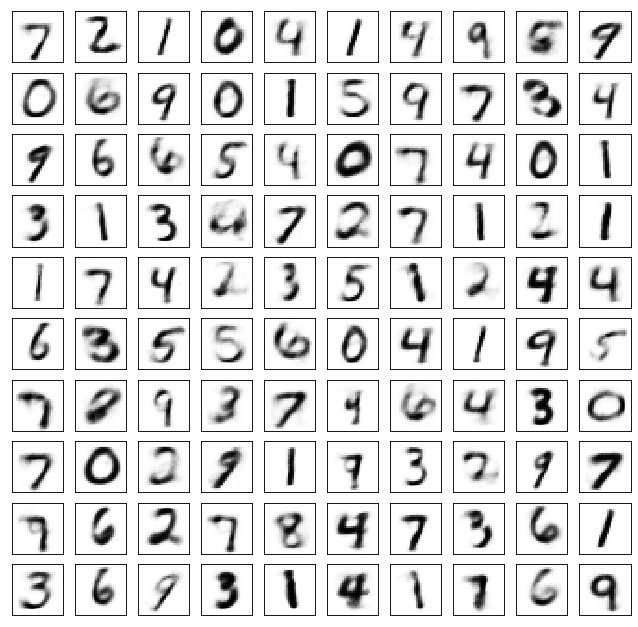

Test losses. E: 0.6911, AE: 0.0978, D: 0.6841
Train Epoch: 45 [0/50000 (0%)]	Losses E: 0.6955, AE: 0.1018, D: 0.6837
Train Epoch: 45 [25000/50000 (50%)]	Losses E: 0.7114, AE: 0.1070, D: 0.7019
Train Epoch: 45 [50000/50000 (100%)]	Losses E: 0.7290, AE: 0.1366, D: 0.7214
	generation


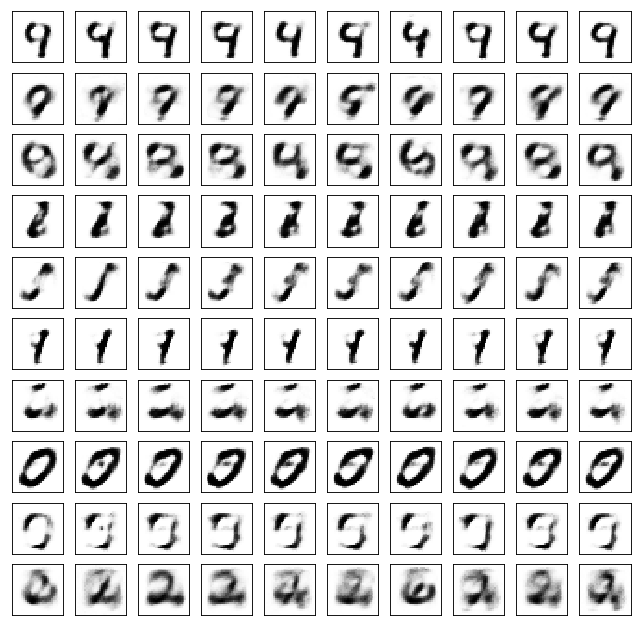

	reconstruction


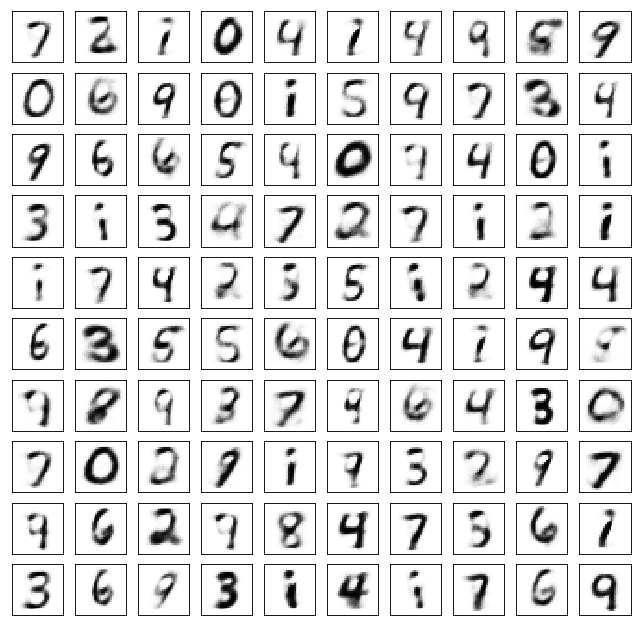

Test losses. E: 0.7171, AE: 0.1438, D: 0.7198
Train Epoch: 46 [0/50000 (0%)]	Losses E: 0.7276, AE: 0.1392, D: 0.7214
Train Epoch: 46 [25000/50000 (50%)]	Losses E: 0.6931, AE: 0.1084, D: 0.6949
Train Epoch: 46 [50000/50000 (100%)]	Losses E: 0.6925, AE: 0.0980, D: 0.6968
	generation


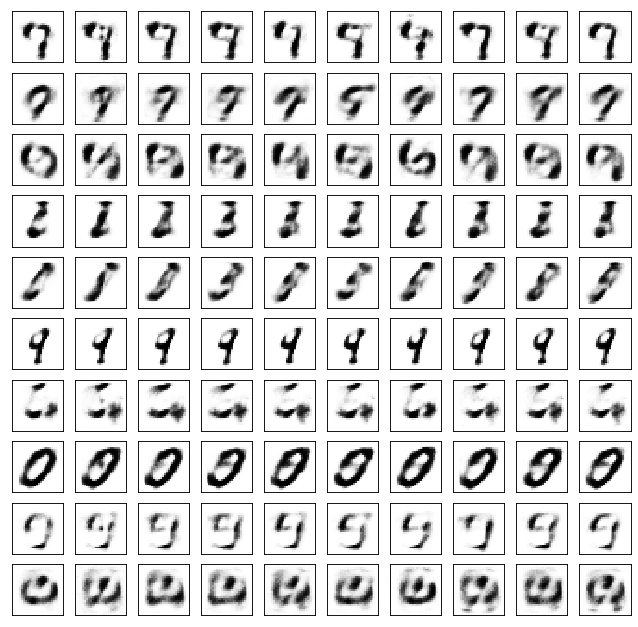

	reconstruction


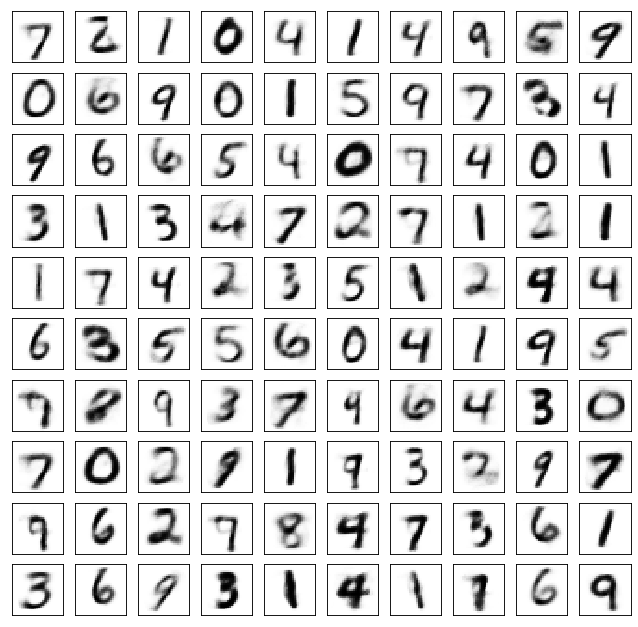

Test losses. E: 0.6926, AE: 0.0979, D: 0.6969
Train Epoch: 47 [0/50000 (0%)]	Losses E: 0.6920, AE: 0.0945, D: 0.6951
Train Epoch: 47 [25000/50000 (50%)]	Losses E: 0.8596, AE: 0.1340, D: 0.6887
Train Epoch: 47 [50000/50000 (100%)]	Losses E: 0.6360, AE: 0.1047, D: 0.7024
	generation


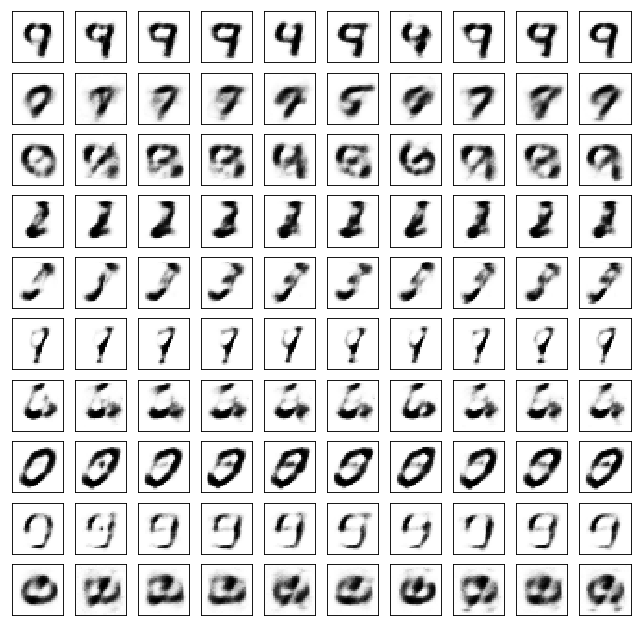

	reconstruction


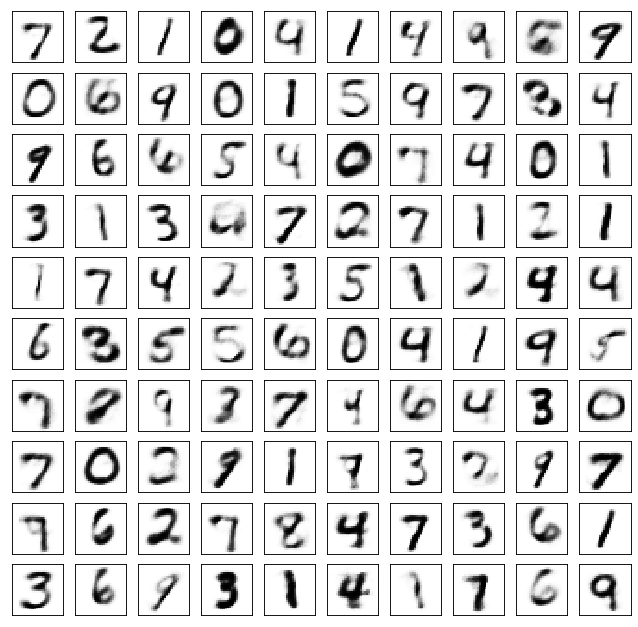

Test losses. E: 0.6290, AE: 0.1116, D: 0.7022
Train Epoch: 48 [0/50000 (0%)]	Losses E: 0.6357, AE: 0.1074, D: 0.7023
Train Epoch: 48 [25000/50000 (50%)]	Losses E: 0.7648, AE: 0.1111, D: 0.6677
Train Epoch: 48 [50000/50000 (100%)]	Losses E: 0.6481, AE: 0.0947, D: 0.6971
	generation


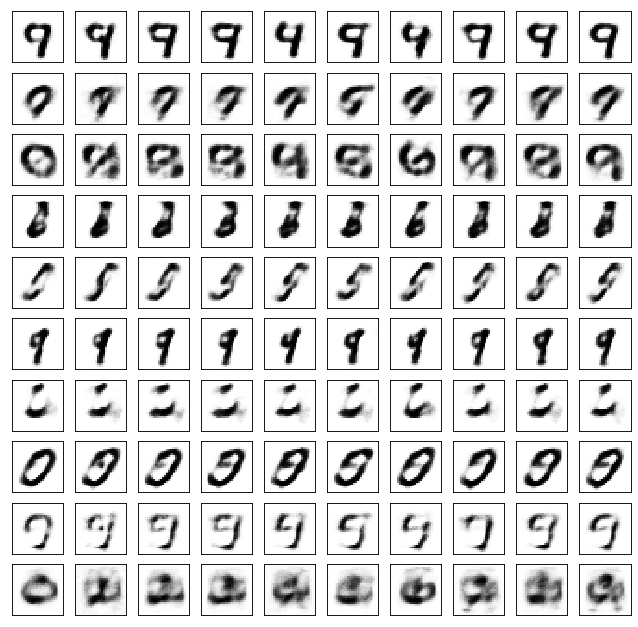

	reconstruction


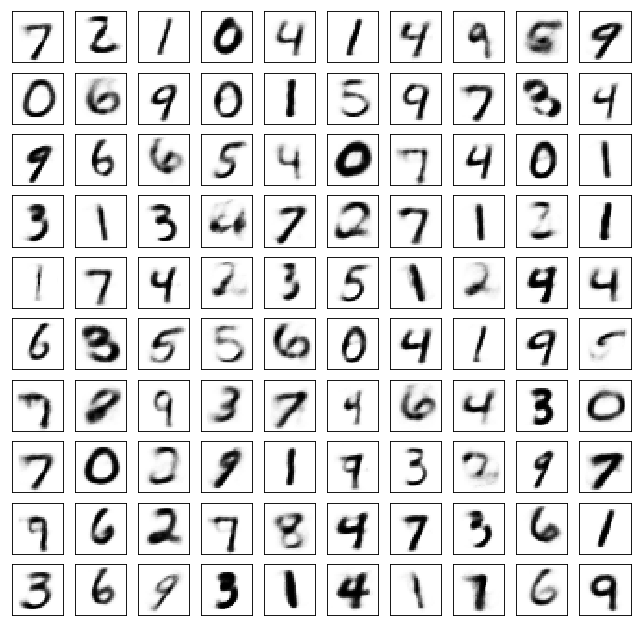

Test losses. E: 0.6476, AE: 0.0951, D: 0.6974
Train Epoch: 49 [0/50000 (0%)]	Losses E: 0.6493, AE: 0.0903, D: 0.6966
Train Epoch: 49 [25000/50000 (50%)]	Losses E: 0.6501, AE: 0.0980, D: 0.7038
Train Epoch: 49 [50000/50000 (100%)]	Losses E: 0.6434, AE: 0.1089, D: 0.7529
	generation


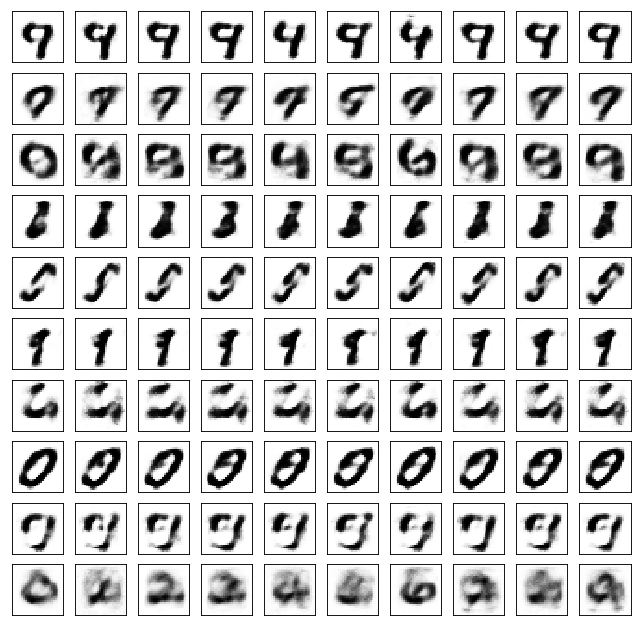

	reconstruction


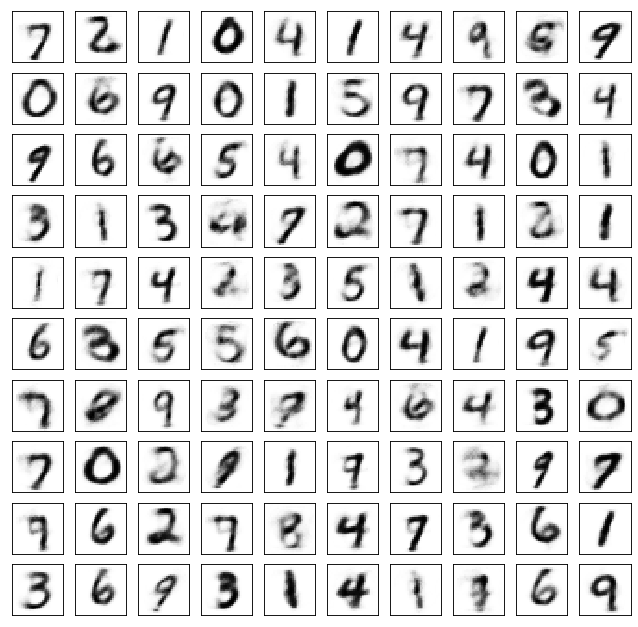

Test losses. E: 0.6477, AE: 0.1098, D: 0.7420
Train Epoch: 50 [0/50000 (0%)]	Losses E: 0.6531, AE: 0.1053, D: 0.7444
Train Epoch: 50 [25000/50000 (50%)]	Losses E: 0.6530, AE: 0.0924, D: 0.7107
Train Epoch: 50 [50000/50000 (100%)]	Losses E: 0.6696, AE: 0.0931, D: 0.7090
	generation


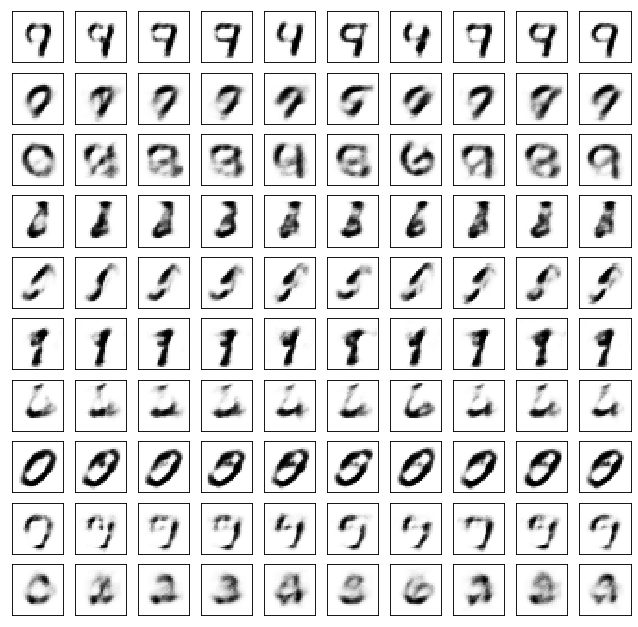

	reconstruction


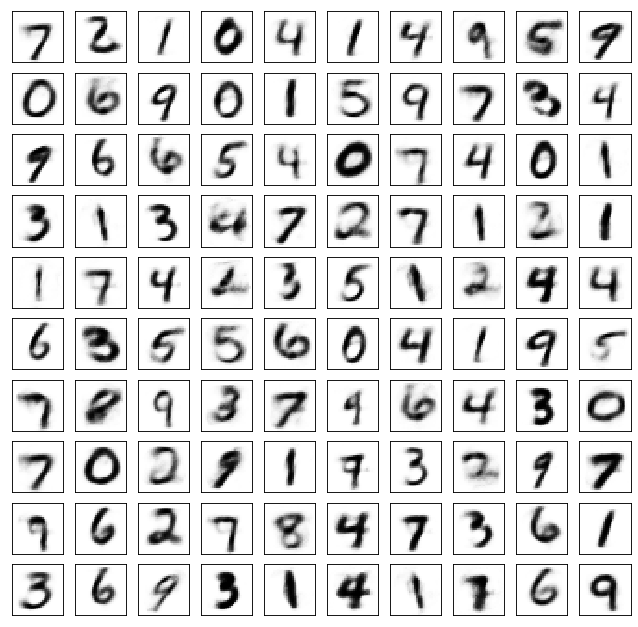

Test losses. E: 0.6624, AE: 0.0976, D: 0.7089
Train Epoch: 51 [0/50000 (0%)]	Losses E: 0.6670, AE: 0.0946, D: 0.7164
Train Epoch: 51 [25000/50000 (50%)]	Losses E: 0.6601, AE: 0.0962, D: 0.7061
Train Epoch: 51 [50000/50000 (100%)]	Losses E: 0.6812, AE: 0.0886, D: 0.7046
	generation


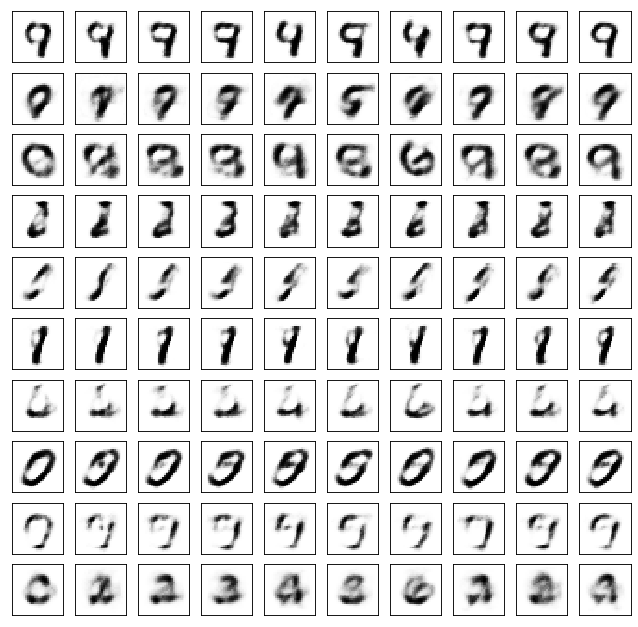

	reconstruction


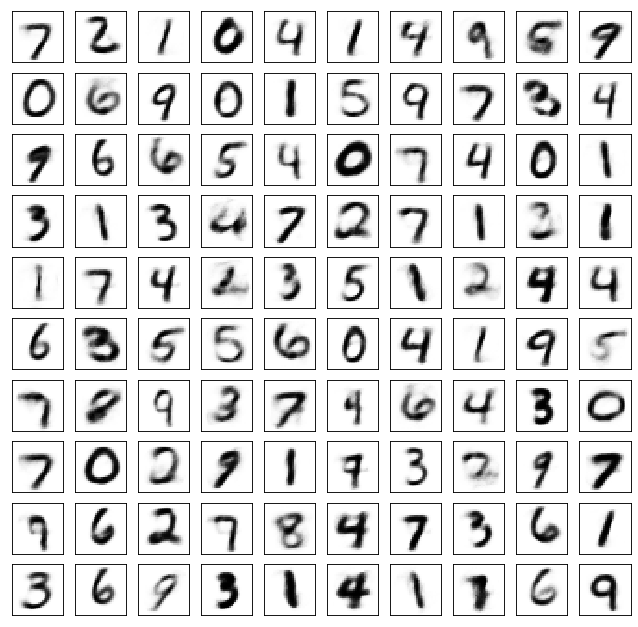

Test losses. E: 0.6801, AE: 0.0905, D: 0.7021
Train Epoch: 52 [0/50000 (0%)]	Losses E: 0.6818, AE: 0.0898, D: 0.7044
Train Epoch: 52 [25000/50000 (50%)]	Losses E: 0.7462, AE: 0.0965, D: 0.6993
Train Epoch: 52 [50000/50000 (100%)]	Losses E: 0.7876, AE: 0.1016, D: 0.6941
	generation


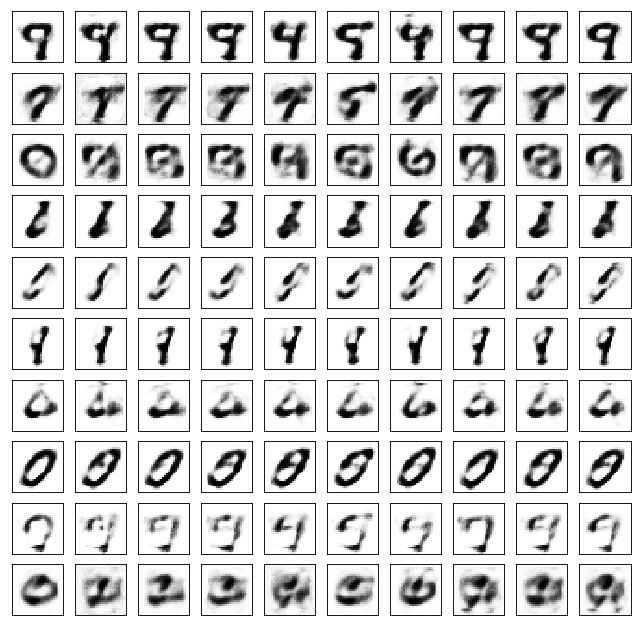

	reconstruction


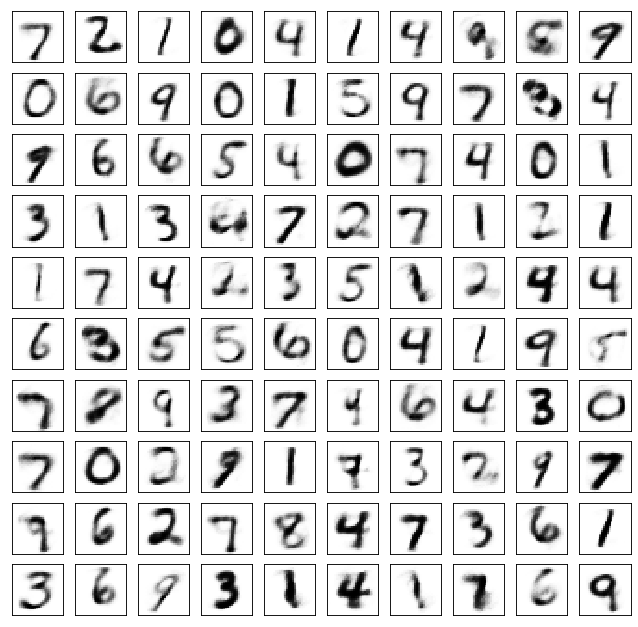

Test losses. E: 0.7519, AE: 0.1010, D: 0.7002
Train Epoch: 53 [0/50000 (0%)]	Losses E: 0.7756, AE: 0.1041, D: 0.7028
Train Epoch: 53 [25000/50000 (50%)]	Losses E: 0.7112, AE: 0.0943, D: 0.6900
Train Epoch: 53 [50000/50000 (100%)]	Losses E: 0.7439, AE: 0.0999, D: 0.6922
	generation


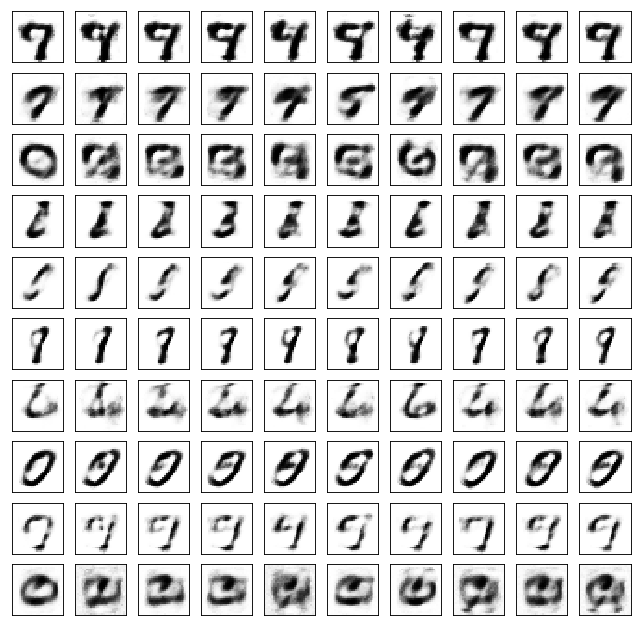

	reconstruction


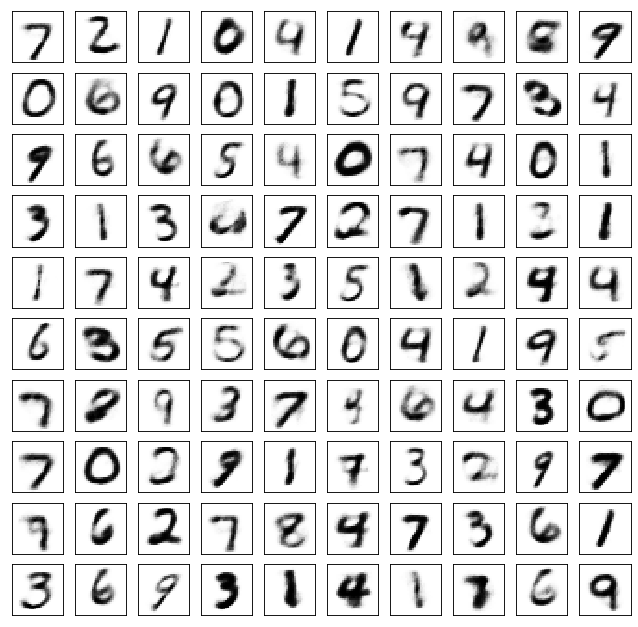

Test losses. E: 0.7341, AE: 0.0988, D: 0.6854
Train Epoch: 54 [0/50000 (0%)]	Losses E: 0.7687, AE: 0.0951, D: 0.6845
Train Epoch: 54 [25000/50000 (50%)]	Losses E: 0.6572, AE: 0.0878, D: 0.7006
Train Epoch: 54 [50000/50000 (100%)]	Losses E: 0.7706, AE: 0.0968, D: 0.6955
	generation


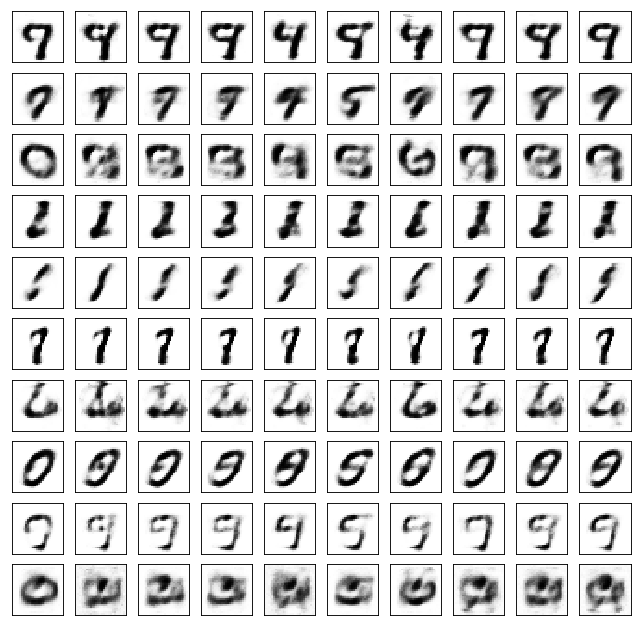

	reconstruction


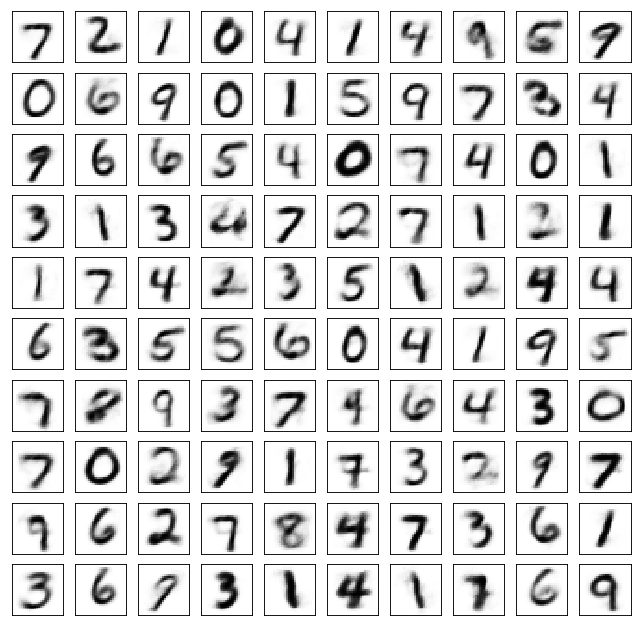

Test losses. E: 0.7684, AE: 0.0951, D: 0.6955
Train Epoch: 55 [0/50000 (0%)]	Losses E: 0.7689, AE: 0.0946, D: 0.6951
Train Epoch: 55 [25000/50000 (50%)]	Losses E: 0.8690, AE: 0.1414, D: 0.7056
Train Epoch: 55 [50000/50000 (100%)]	Losses E: 0.6328, AE: 0.0967, D: 0.7166
	generation


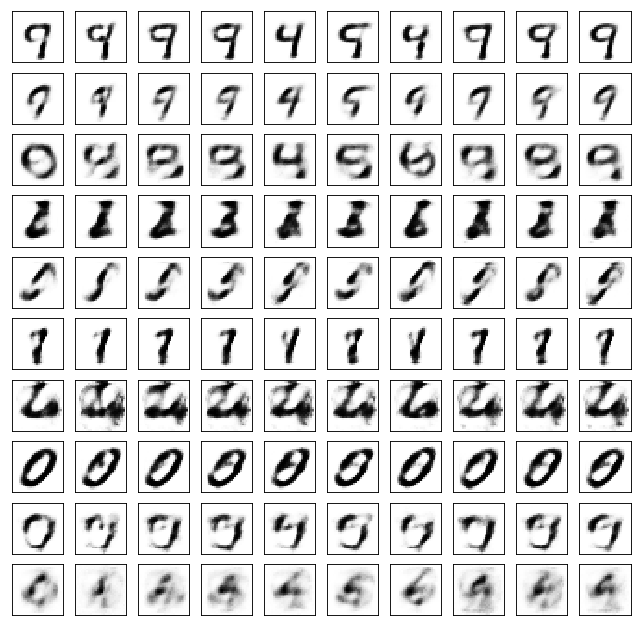

	reconstruction


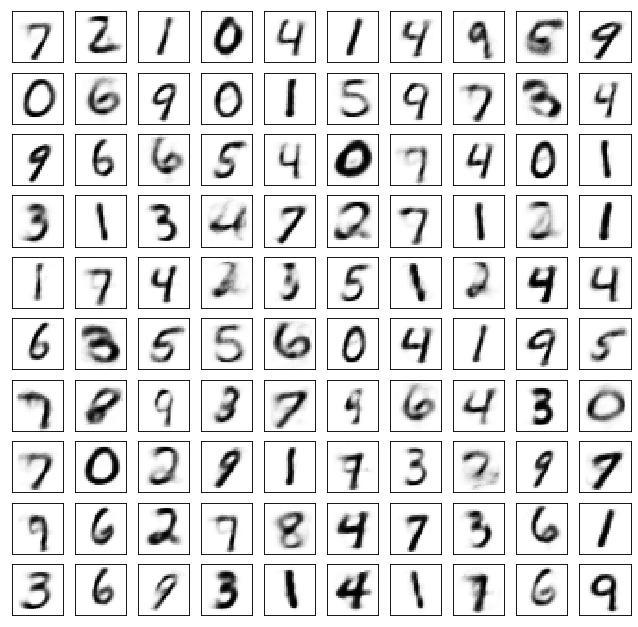

Test losses. E: 0.6265, AE: 0.0980, D: 0.7192
Train Epoch: 56 [0/50000 (0%)]	Losses E: 0.6286, AE: 0.0977, D: 0.7171
Train Epoch: 56 [25000/50000 (50%)]	Losses E: 0.6610, AE: 0.0966, D: 0.7051
Train Epoch: 56 [50000/50000 (100%)]	Losses E: 0.7027, AE: 0.0993, D: 0.7075
	generation


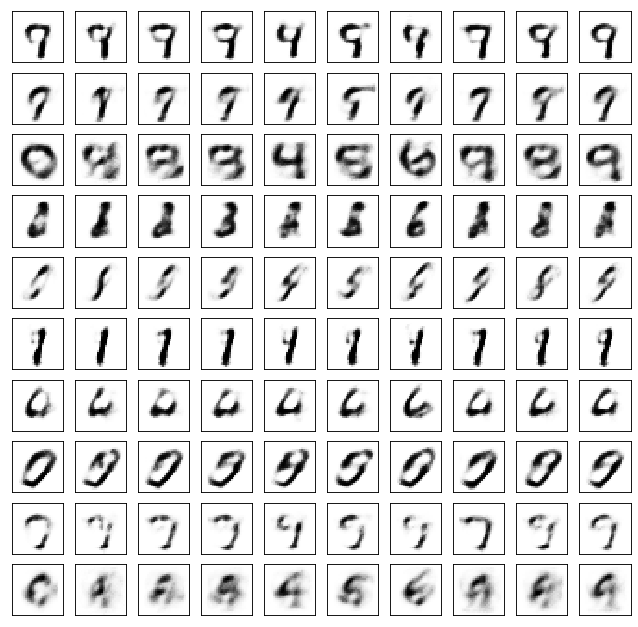

	reconstruction


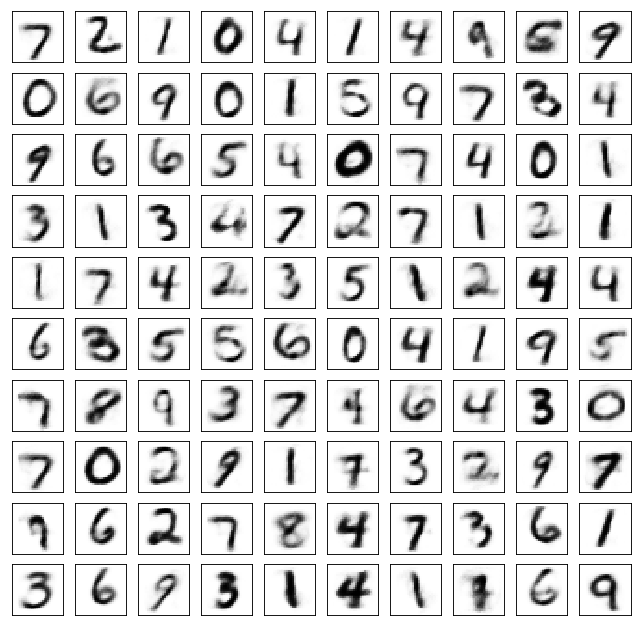

Test losses. E: 0.7004, AE: 0.0982, D: 0.7099
Train Epoch: 57 [0/50000 (0%)]	Losses E: 0.7004, AE: 0.0924, D: 0.7069
Train Epoch: 57 [25000/50000 (50%)]	Losses E: 0.6725, AE: 0.0939, D: 0.7016
Train Epoch: 57 [50000/50000 (100%)]	Losses E: 0.6700, AE: 0.0845, D: 0.6987
	generation


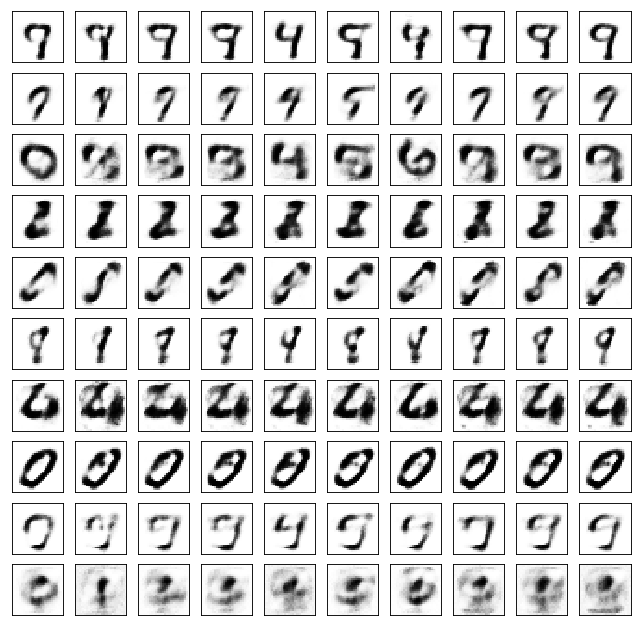

	reconstruction


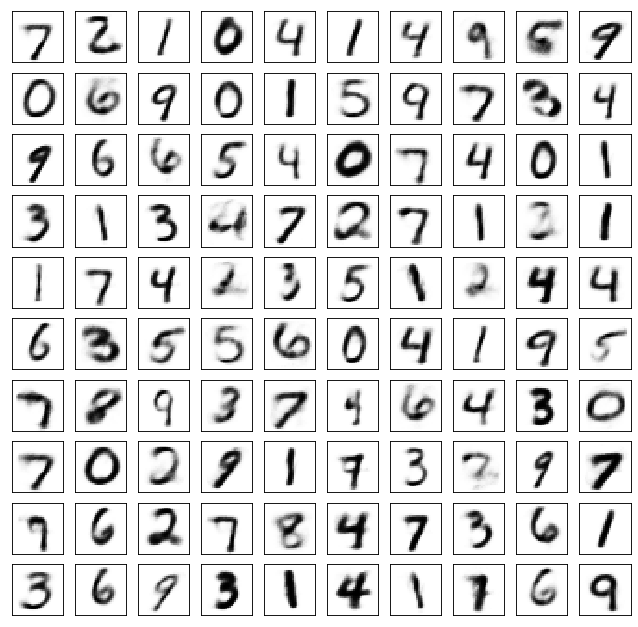

Test losses. E: 0.6667, AE: 0.0879, D: 0.6985
Train Epoch: 58 [0/50000 (0%)]	Losses E: 0.6704, AE: 0.0846, D: 0.6968
Train Epoch: 58 [25000/50000 (50%)]	Losses E: 0.7056, AE: 0.0897, D: 0.6959
Train Epoch: 58 [50000/50000 (100%)]	Losses E: 0.6996, AE: 0.0864, D: 0.6954
	generation


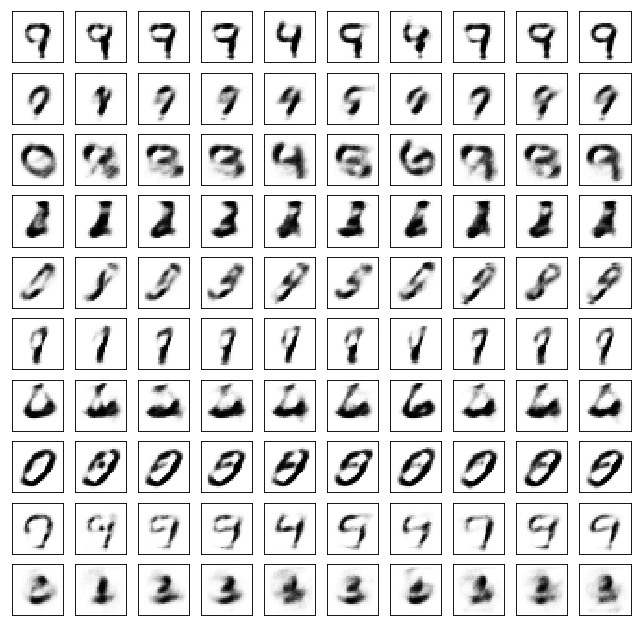

	reconstruction


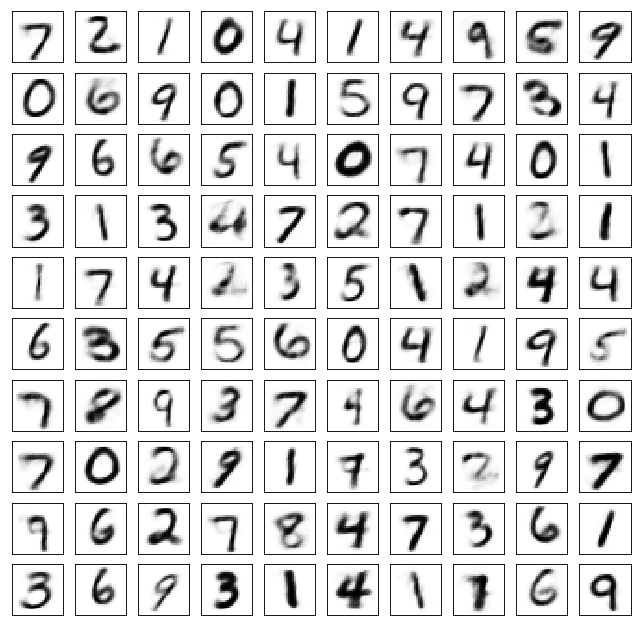

Test losses. E: 0.6964, AE: 0.0859, D: 0.6955
Train Epoch: 59 [0/50000 (0%)]	Losses E: 0.6997, AE: 0.0809, D: 0.6950
Train Epoch: 59 [25000/50000 (50%)]	Losses E: 0.6820, AE: 0.0880, D: 0.6982
Train Epoch: 59 [50000/50000 (100%)]	Losses E: 0.7386, AE: 0.0836, D: 0.6898
	generation


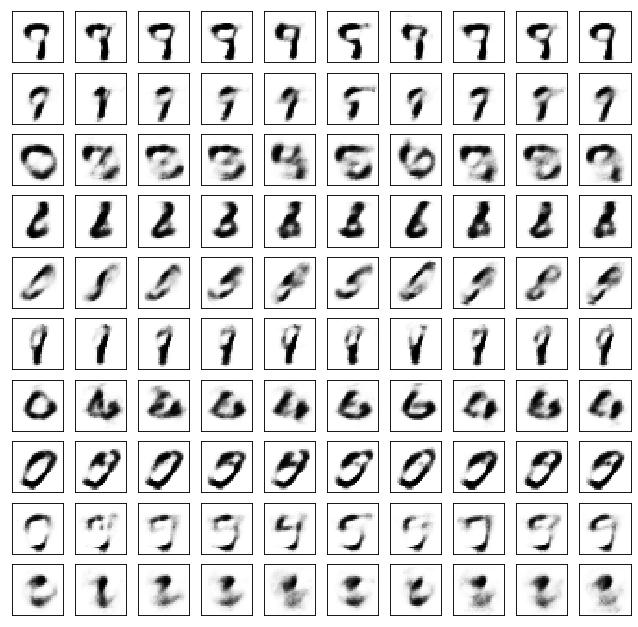

	reconstruction


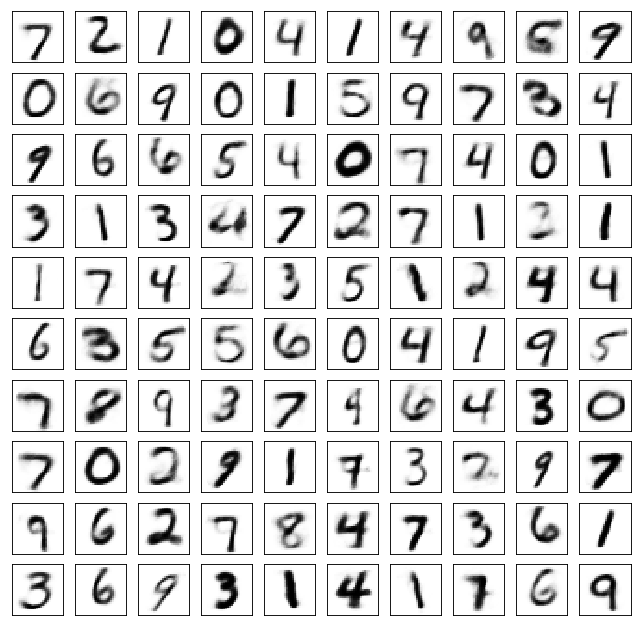

Test losses. E: 0.7376, AE: 0.0822, D: 0.6891
Train Epoch: 60 [0/50000 (0%)]	Losses E: 0.7383, AE: 0.0800, D: 0.6893
Train Epoch: 60 [25000/50000 (50%)]	Losses E: 0.6362, AE: 0.0796, D: 0.7092
Train Epoch: 60 [50000/50000 (100%)]	Losses E: 0.8685, AE: 0.1489, D: 0.7101
	generation


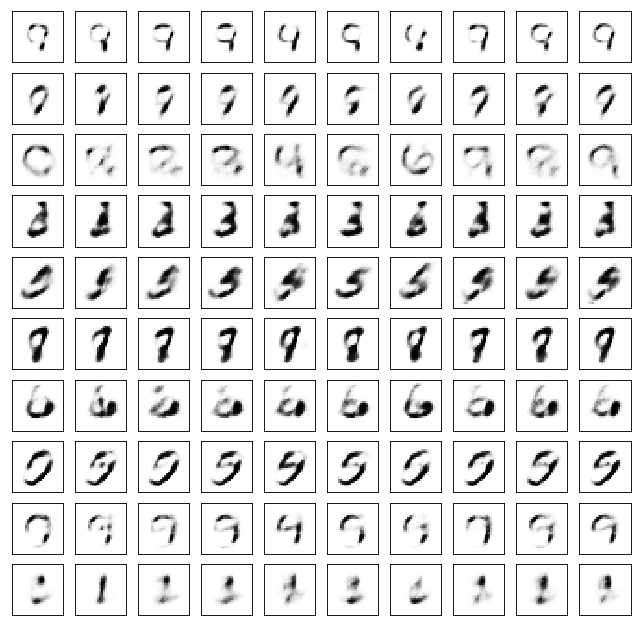

	reconstruction


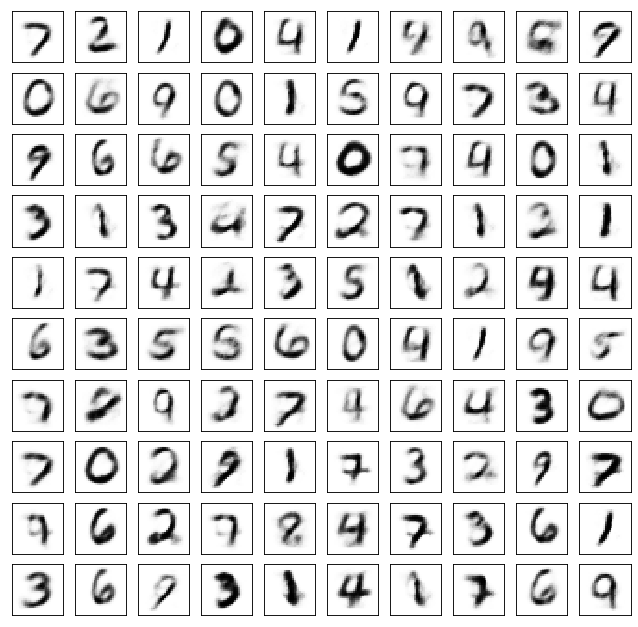

Test losses. E: 0.8393, AE: 0.1473, D: 0.7178
Train Epoch: 61 [0/50000 (0%)]	Losses E: 0.8484, AE: 0.1480, D: 0.7186
Train Epoch: 61 [25000/50000 (50%)]	Losses E: 0.6784, AE: 0.0966, D: 0.7011
Train Epoch: 61 [50000/50000 (100%)]	Losses E: 0.7133, AE: 0.0914, D: 0.7025
	generation


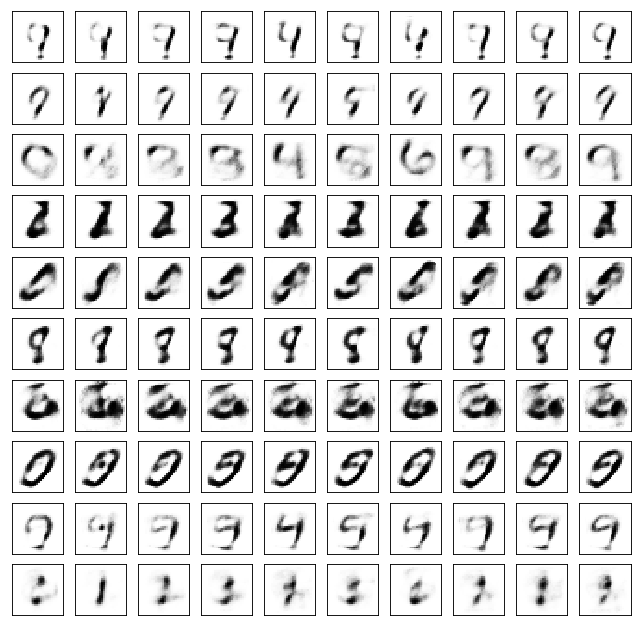

	reconstruction


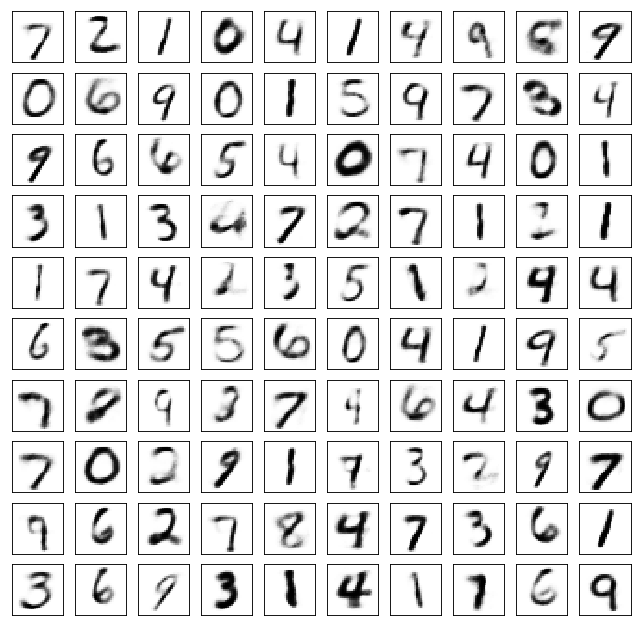

Test losses. E: 0.7070, AE: 0.0980, D: 0.7043
Train Epoch: 62 [0/50000 (0%)]	Losses E: 0.7146, AE: 0.0911, D: 0.7080
Train Epoch: 62 [25000/50000 (50%)]	Losses E: 0.6827, AE: 0.0830, D: 0.6982
Train Epoch: 62 [50000/50000 (100%)]	Losses E: 0.7116, AE: 0.0924, D: 0.6958
	generation


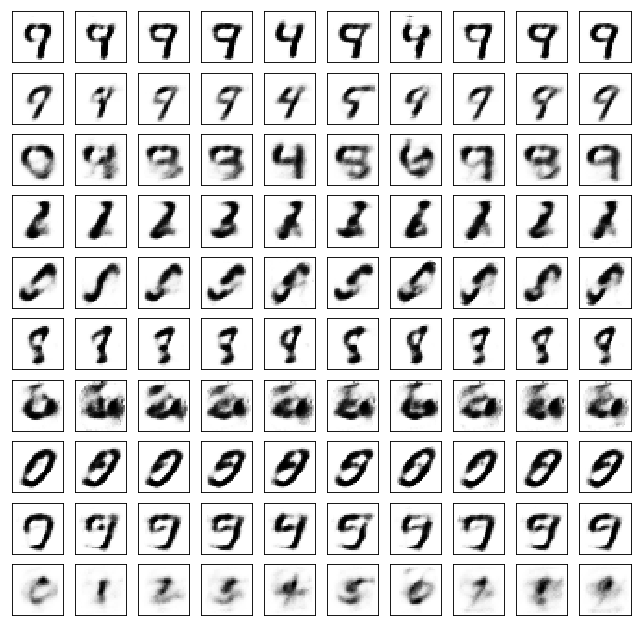

	reconstruction


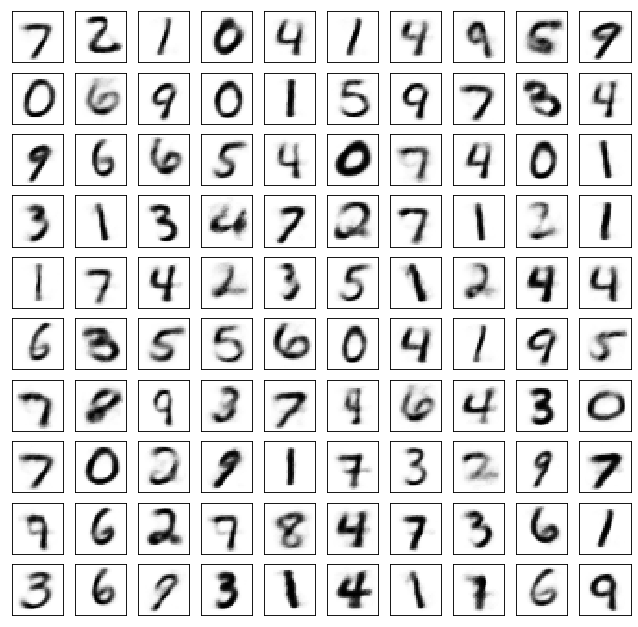

Test losses. E: 0.7059, AE: 0.0924, D: 0.6984
Train Epoch: 63 [0/50000 (0%)]	Losses E: 0.7071, AE: 0.0921, D: 0.6994
Train Epoch: 63 [25000/50000 (50%)]	Losses E: 0.6266, AE: 0.0965, D: 0.7154
Train Epoch: 63 [50000/50000 (100%)]	Losses E: 0.6753, AE: 0.0873, D: 0.7089
	generation


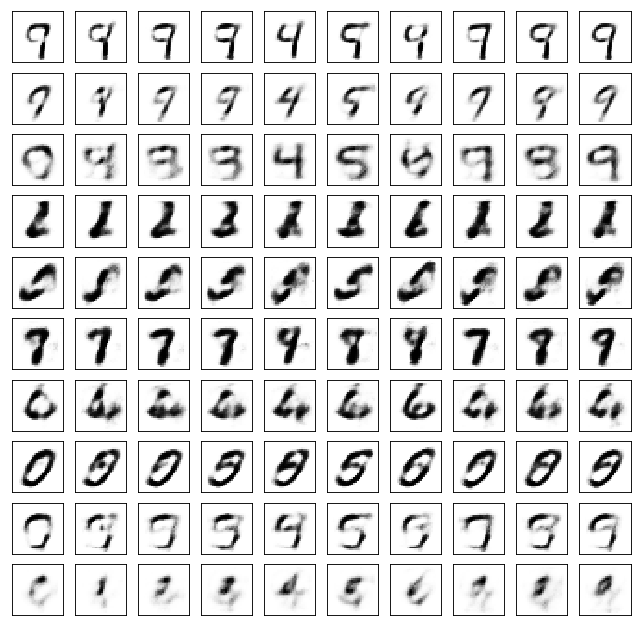

	reconstruction


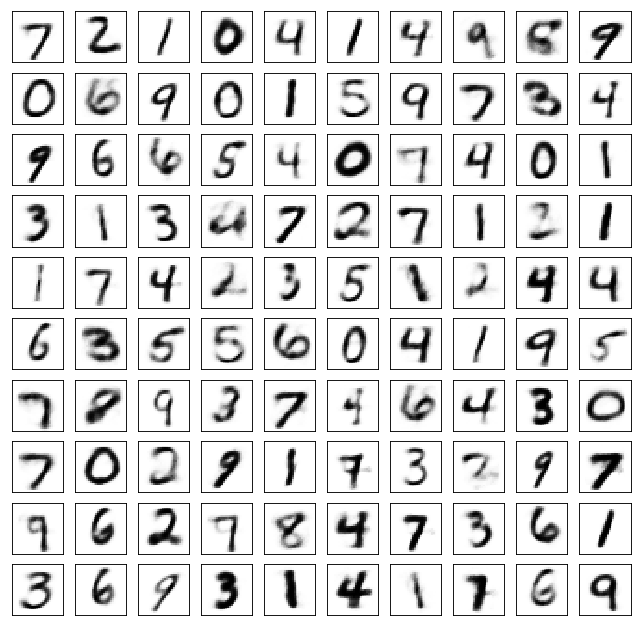

Test losses. E: 0.6712, AE: 0.0879, D: 0.7074
Train Epoch: 64 [0/50000 (0%)]	Losses E: 0.6799, AE: 0.0891, D: 0.7057
Train Epoch: 64 [25000/50000 (50%)]	Losses E: 0.6538, AE: 0.0779, D: 0.6948
Train Epoch: 64 [50000/50000 (100%)]	Losses E: 0.5370, AE: 0.1047, D: 0.7605
	generation


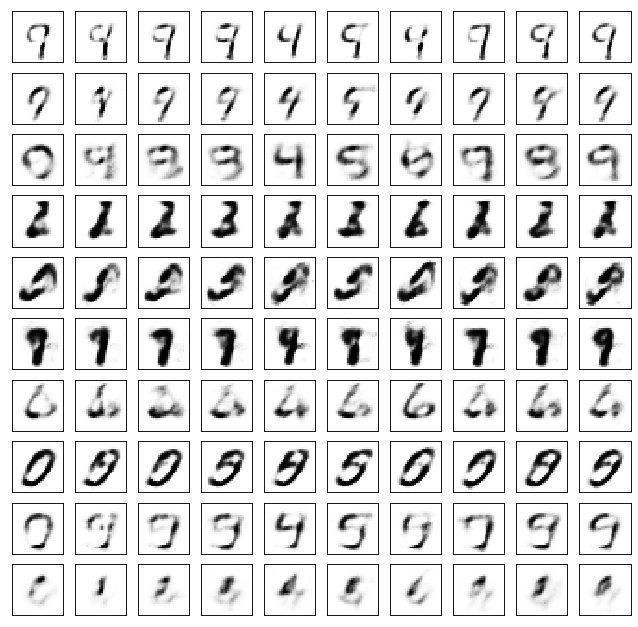

	reconstruction


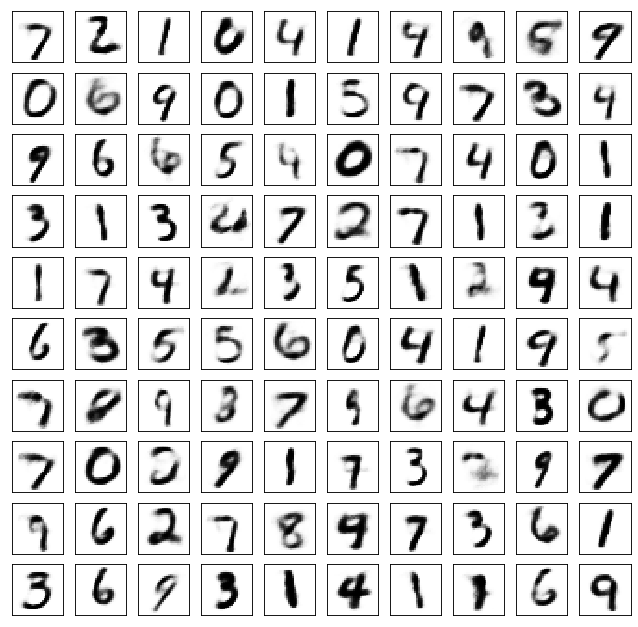

Test losses. E: 0.5175, AE: 0.1055, D: 0.7705
Train Epoch: 65 [0/50000 (0%)]	Losses E: 0.5277, AE: 0.1033, D: 0.7781
Train Epoch: 65 [25000/50000 (50%)]	Losses E: 0.7183, AE: 0.1045, D: 0.6929
Train Epoch: 65 [50000/50000 (100%)]	Losses E: 0.6225, AE: 0.0895, D: 0.6962
	generation


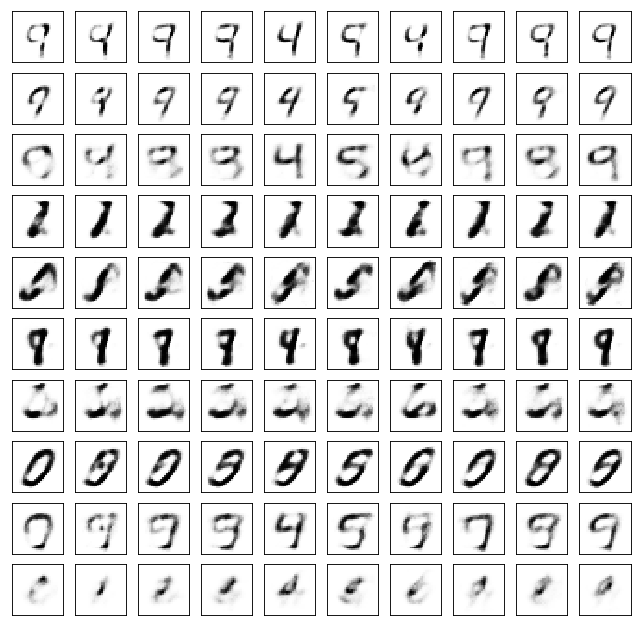

	reconstruction


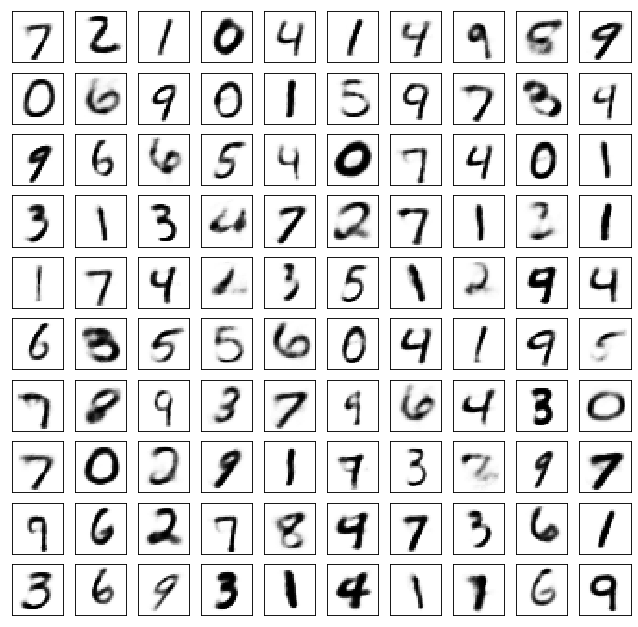

Test losses. E: 0.6177, AE: 0.0900, D: 0.6974
Train Epoch: 66 [0/50000 (0%)]	Losses E: 0.6186, AE: 0.0898, D: 0.6986
Train Epoch: 66 [25000/50000 (50%)]	Losses E: 0.6805, AE: 0.0832, D: 0.6933
Train Epoch: 66 [50000/50000 (100%)]	Losses E: 0.6573, AE: 0.1240, D: 0.7111
	generation


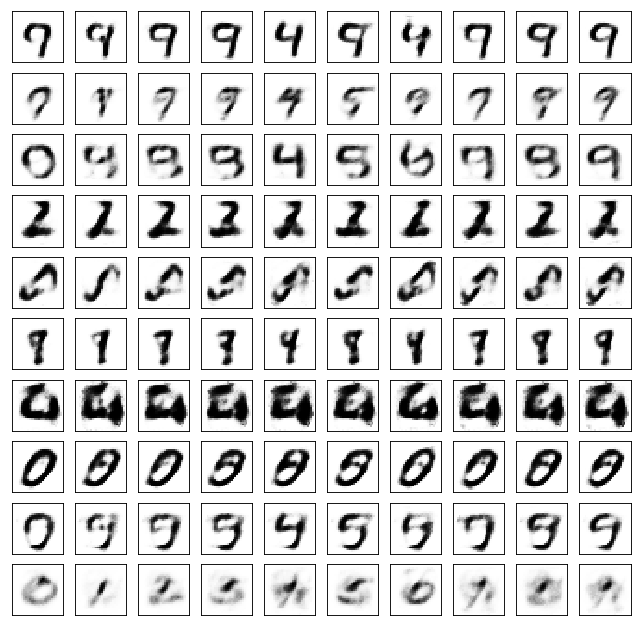

	reconstruction


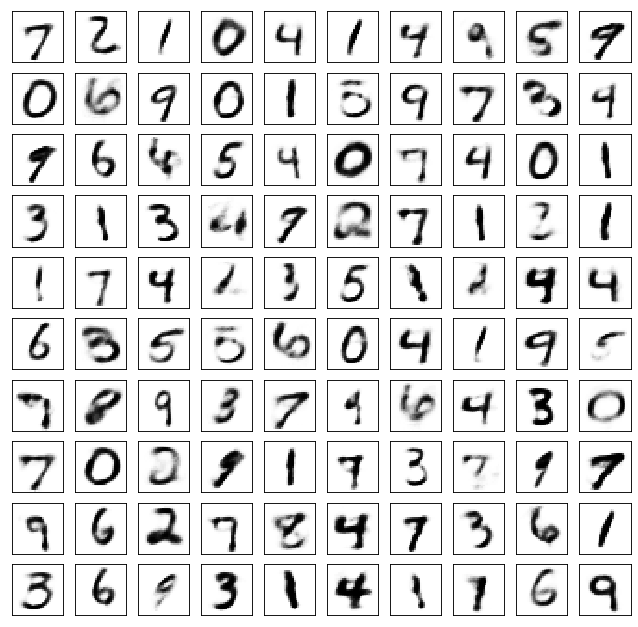

Test losses. E: 0.6432, AE: 0.1209, D: 0.7138
Train Epoch: 67 [0/50000 (0%)]	Losses E: 0.6507, AE: 0.1159, D: 0.7155
Train Epoch: 67 [25000/50000 (50%)]	Losses E: 0.7019, AE: 0.1058, D: 0.7116
Train Epoch: 67 [50000/50000 (100%)]	Losses E: 0.6050, AE: 0.1005, D: 0.7367
	generation


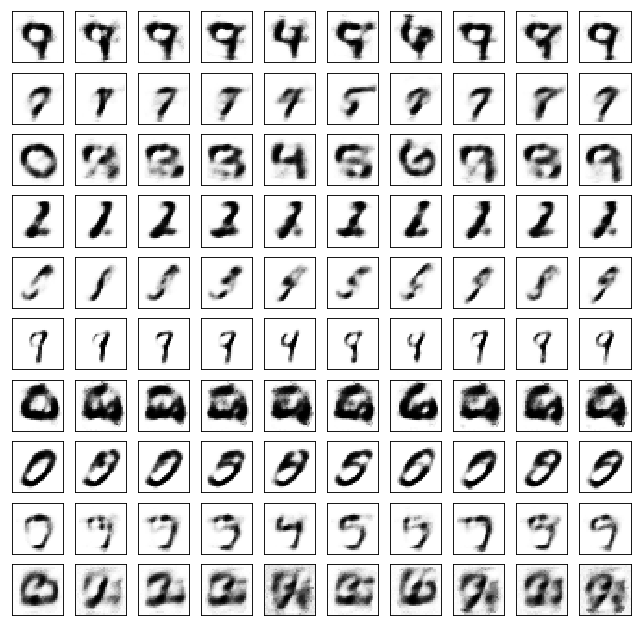

	reconstruction


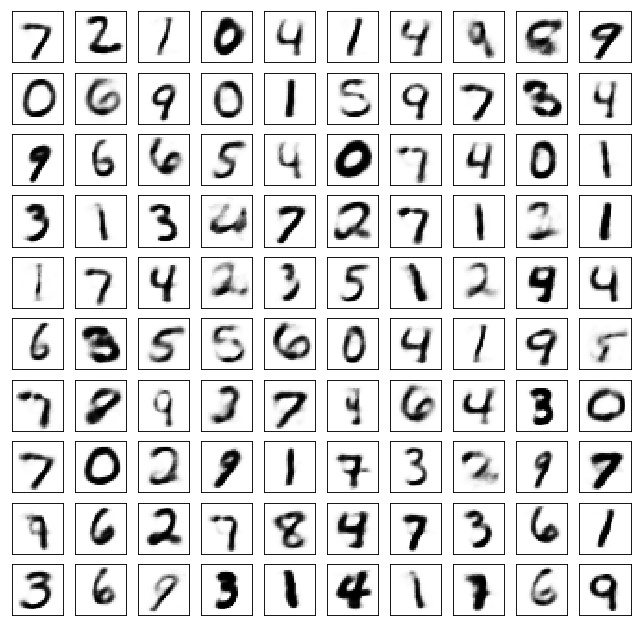

Test losses. E: 0.5963, AE: 0.1017, D: 0.7344
Train Epoch: 68 [0/50000 (0%)]	Losses E: 0.6067, AE: 0.0991, D: 0.7336
Train Epoch: 68 [25000/50000 (50%)]	Losses E: 0.5518, AE: 0.1057, D: 0.7444
Train Epoch: 68 [50000/50000 (100%)]	Losses E: 0.7007, AE: 0.1116, D: 0.7392
	generation


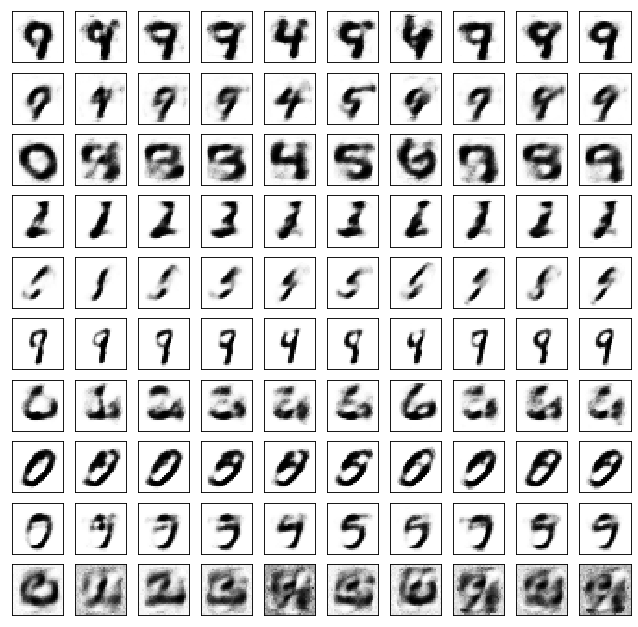

	reconstruction


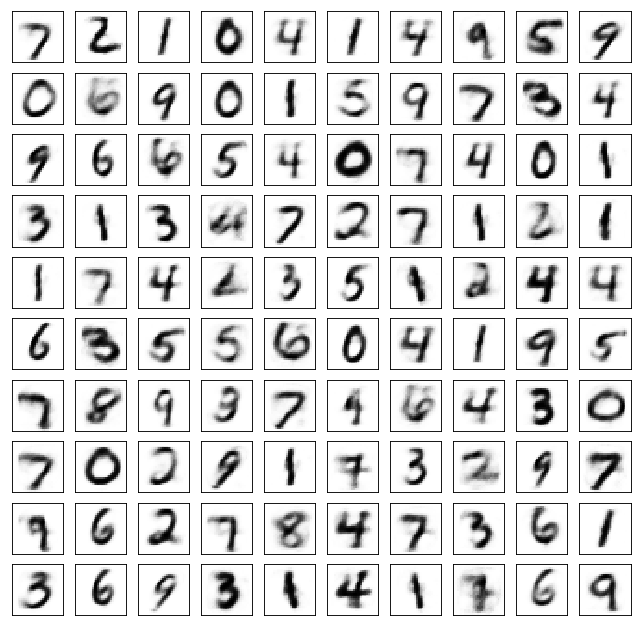

Test losses. E: 0.6884, AE: 0.1106, D: 0.7408
Train Epoch: 69 [0/50000 (0%)]	Losses E: 0.6872, AE: 0.1068, D: 0.7387
Train Epoch: 69 [25000/50000 (50%)]	Losses E: 0.7199, AE: 0.0914, D: 0.7030
Train Epoch: 69 [50000/50000 (100%)]	Losses E: 0.7123, AE: 0.0770, D: 0.6915
	generation


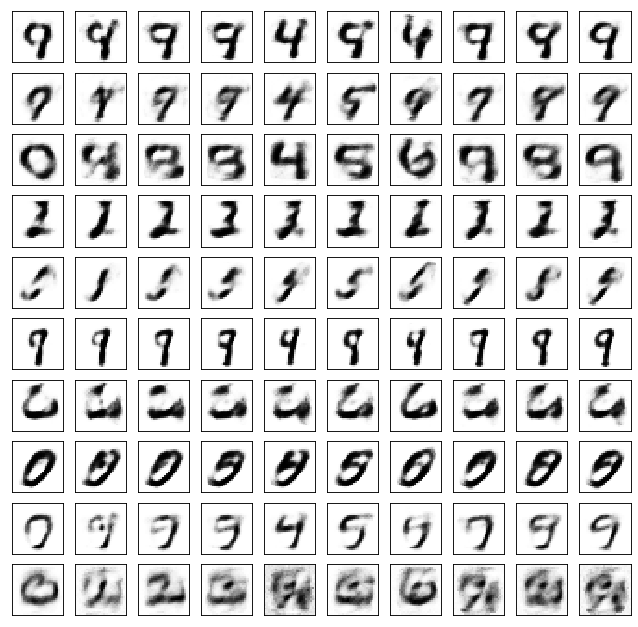

	reconstruction


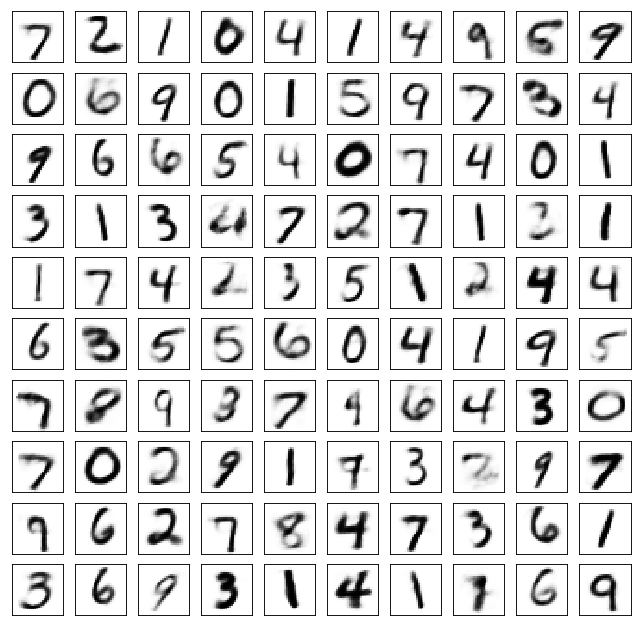

Test losses. E: 0.7099, AE: 0.0812, D: 0.6917
Train Epoch: 70 [0/50000 (0%)]	Losses E: 0.7102, AE: 0.0801, D: 0.6904
Train Epoch: 70 [25000/50000 (50%)]	Losses E: 0.7137, AE: 0.0800, D: 0.6950
Train Epoch: 70 [50000/50000 (100%)]	Losses E: 0.6707, AE: 0.0817, D: 0.6990
	generation


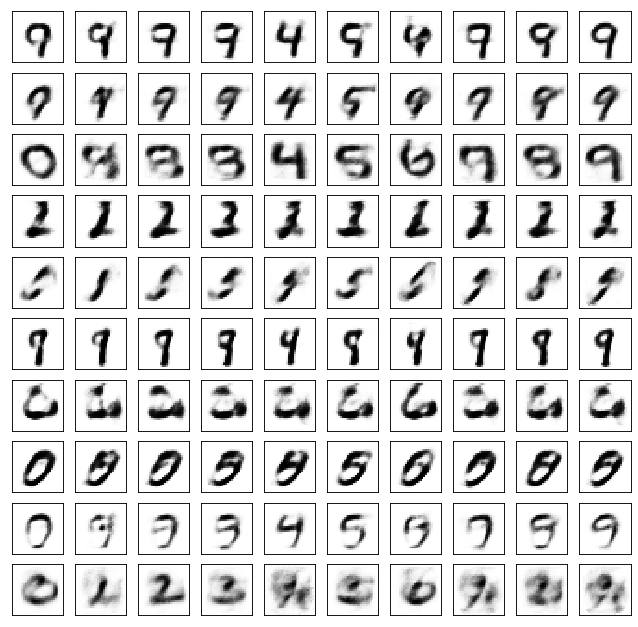

	reconstruction


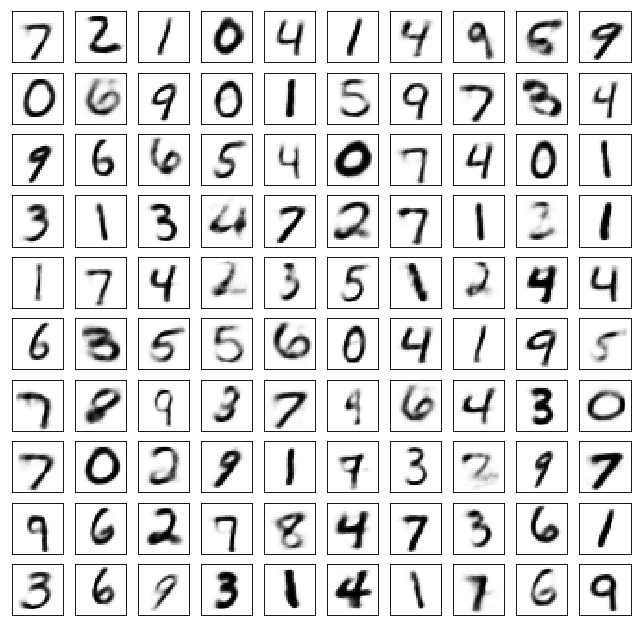

Test losses. E: 0.6697, AE: 0.0813, D: 0.6961
Train Epoch: 71 [0/50000 (0%)]	Losses E: 0.6736, AE: 0.0820, D: 0.6960
Train Epoch: 71 [25000/50000 (50%)]	Losses E: 0.6401, AE: 0.0753, D: 0.7060
Train Epoch: 71 [50000/50000 (100%)]	Losses E: 0.7488, AE: 0.0821, D: 0.7039
	generation


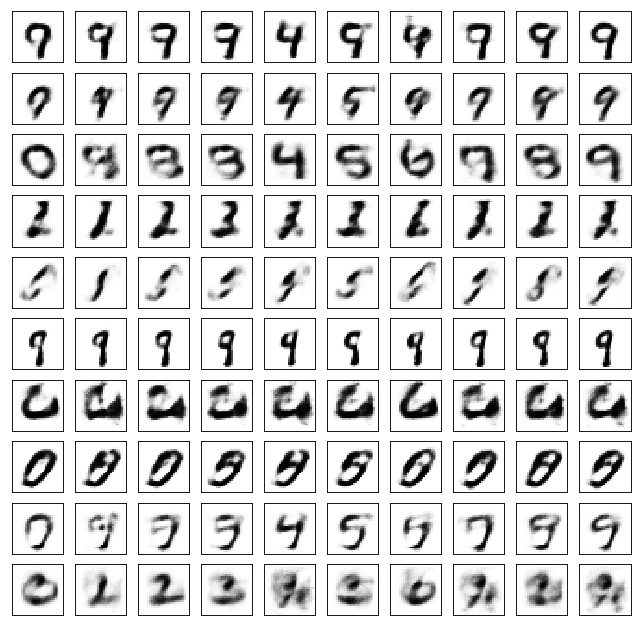

	reconstruction


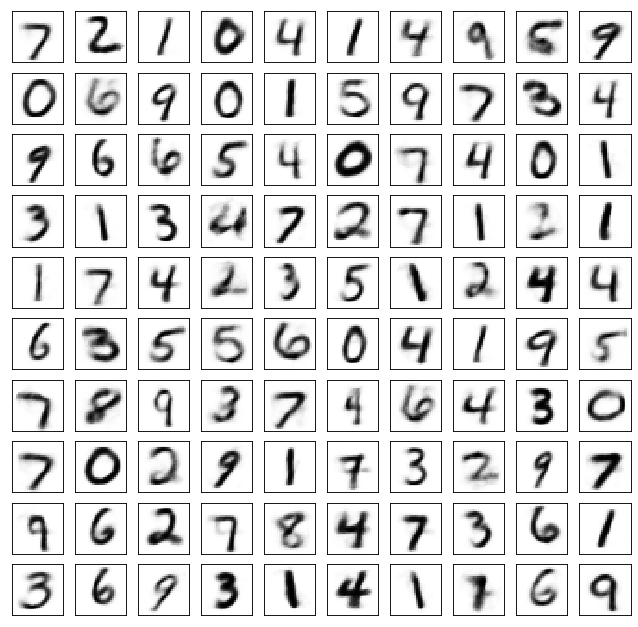

Test losses. E: 0.7477, AE: 0.0833, D: 0.7029
Train Epoch: 72 [0/50000 (0%)]	Losses E: 0.7442, AE: 0.0838, D: 0.7013
Train Epoch: 72 [25000/50000 (50%)]	Losses E: 0.7325, AE: 0.0810, D: 0.7000
Train Epoch: 72 [50000/50000 (100%)]	Losses E: 0.6463, AE: 0.0928, D: 0.7329
	generation


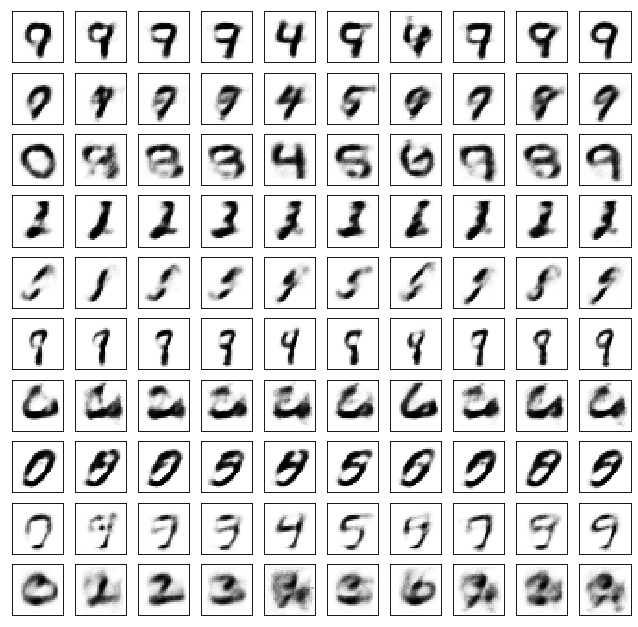

	reconstruction


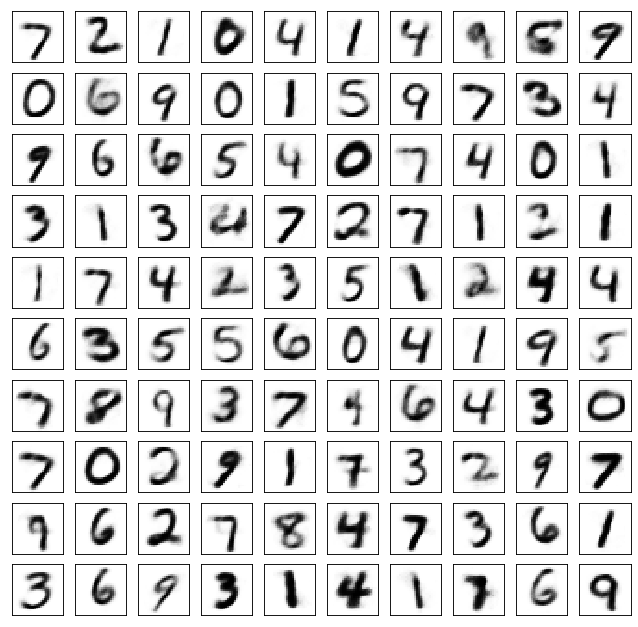

Test losses. E: 0.6345, AE: 0.0901, D: 0.7349
Train Epoch: 73 [0/50000 (0%)]	Losses E: 0.6450, AE: 0.0847, D: 0.7376
Train Epoch: 73 [25000/50000 (50%)]	Losses E: 0.6155, AE: 0.0905, D: 0.7108
Train Epoch: 73 [50000/50000 (100%)]	Losses E: 0.6785, AE: 0.0829, D: 0.7118
	generation


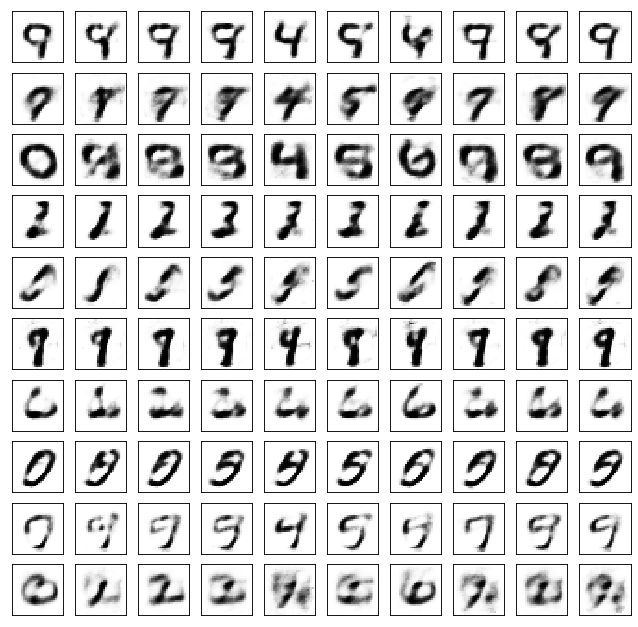

	reconstruction


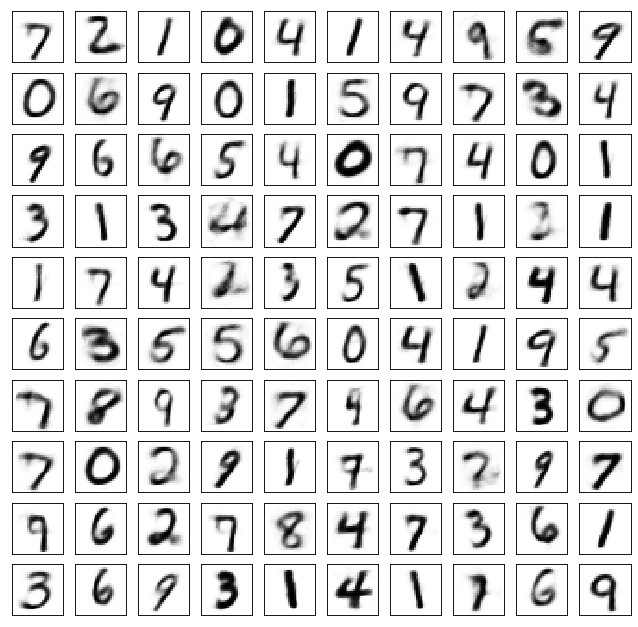

Test losses. E: 0.6786, AE: 0.0864, D: 0.7120
Train Epoch: 74 [0/50000 (0%)]	Losses E: 0.6810, AE: 0.0847, D: 0.7097
Train Epoch: 74 [25000/50000 (50%)]	Losses E: 0.7186, AE: 0.0878, D: 0.7010
Train Epoch: 74 [50000/50000 (100%)]	Losses E: 0.7480, AE: 0.0803, D: 0.6914
	generation


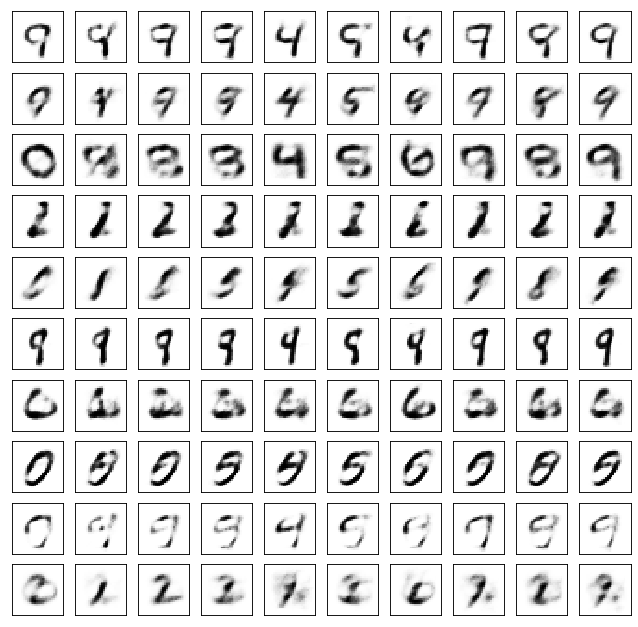

	reconstruction


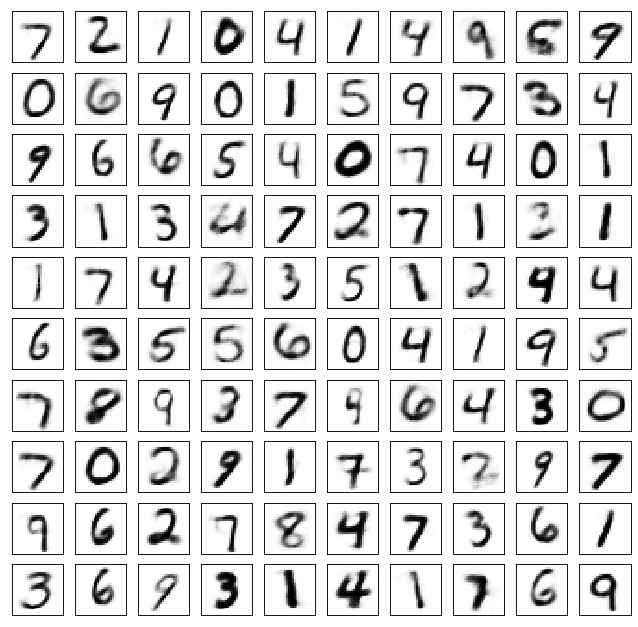

Test losses. E: 0.7452, AE: 0.0851, D: 0.6901
Train Epoch: 75 [0/50000 (0%)]	Losses E: 0.7552, AE: 0.0861, D: 0.6893
Train Epoch: 75 [25000/50000 (50%)]	Losses E: 0.7605, AE: 0.0965, D: 0.6901
Train Epoch: 75 [50000/50000 (100%)]	Losses E: 0.7251, AE: 0.0773, D: 0.6894
	generation


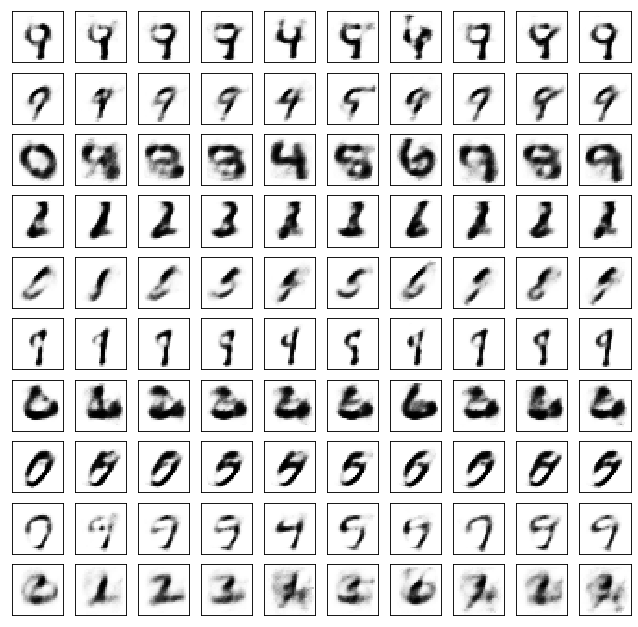

	reconstruction


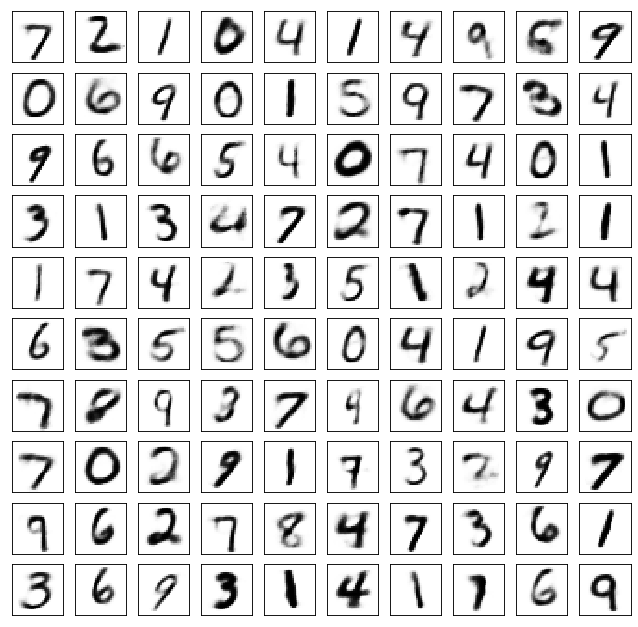

Test losses. E: 0.7228, AE: 0.0841, D: 0.6848
Train Epoch: 76 [0/50000 (0%)]	Losses E: 0.7334, AE: 0.0791, D: 0.6845
Train Epoch: 76 [25000/50000 (50%)]	Losses E: 0.6706, AE: 0.0742, D: 0.6792
Train Epoch: 76 [50000/50000 (100%)]	Losses E: 0.6946, AE: 0.0830, D: 0.7023
	generation


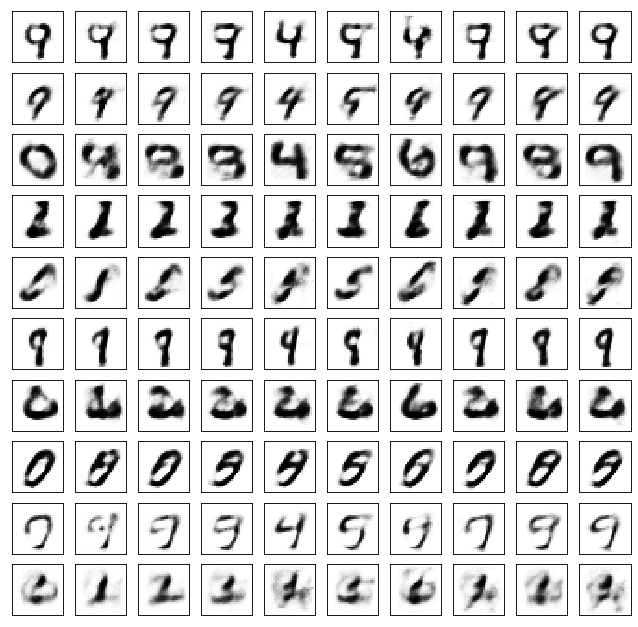

	reconstruction


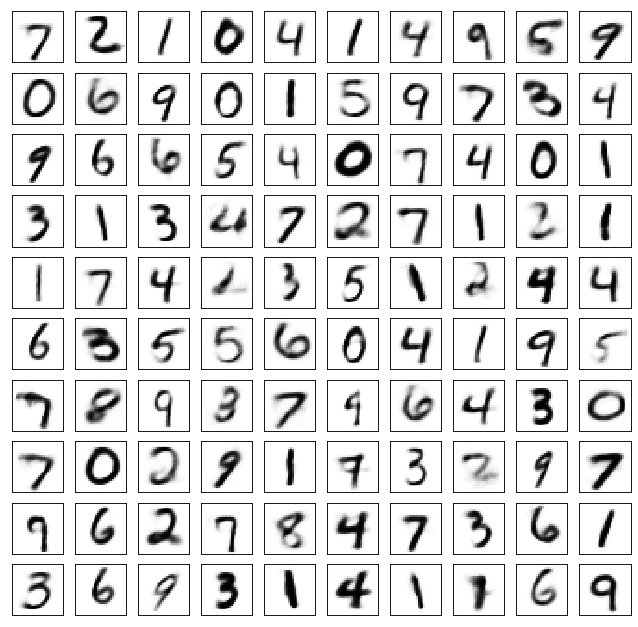

Test losses. E: 0.6932, AE: 0.0805, D: 0.7014
Train Epoch: 77 [0/50000 (0%)]	Losses E: 0.6917, AE: 0.0783, D: 0.7001
Train Epoch: 77 [25000/50000 (50%)]	Losses E: 0.7384, AE: 0.0793, D: 0.6998
Train Epoch: 77 [50000/50000 (100%)]	Losses E: 0.6705, AE: 0.1063, D: 0.7132
	generation


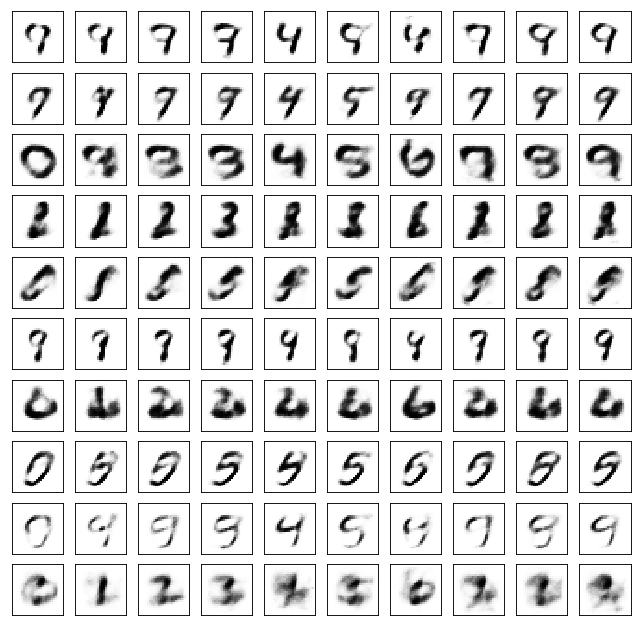

	reconstruction


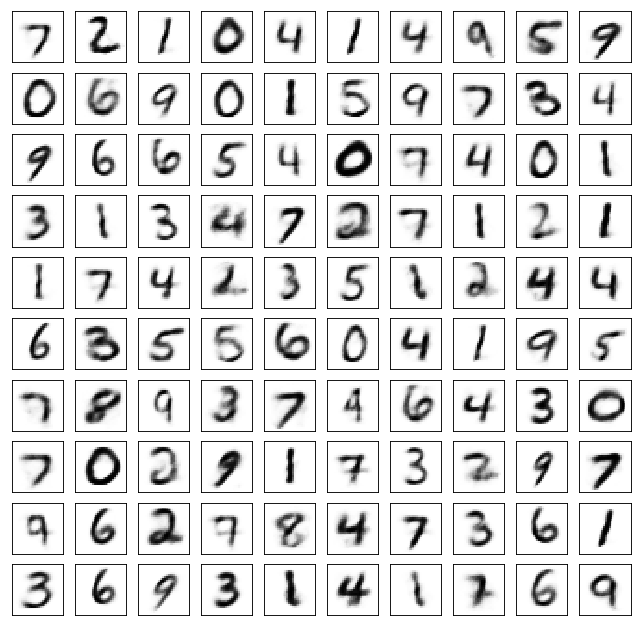

Test losses. E: 0.6694, AE: 0.1075, D: 0.7132
Train Epoch: 78 [0/50000 (0%)]	Losses E: 0.6681, AE: 0.1109, D: 0.7161
Train Epoch: 78 [25000/50000 (50%)]	Losses E: 0.7425, AE: 0.1022, D: 0.6966
Train Epoch: 78 [50000/50000 (100%)]	Losses E: 0.6867, AE: 0.0737, D: 0.6965
	generation


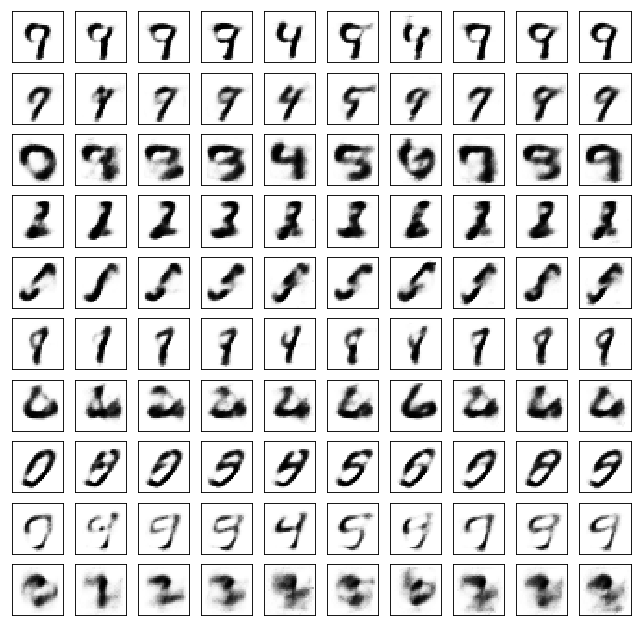

	reconstruction


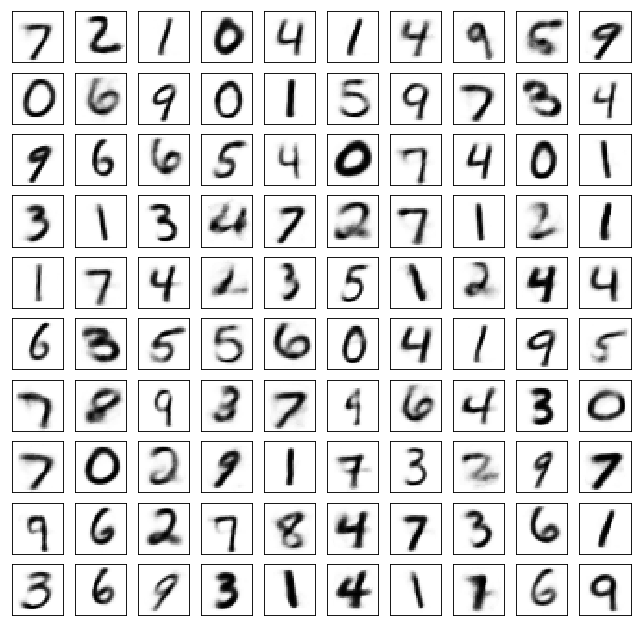

Test losses. E: 0.6877, AE: 0.0776, D: 0.6968
Train Epoch: 79 [0/50000 (0%)]	Losses E: 0.6867, AE: 0.0749, D: 0.6957
Train Epoch: 79 [25000/50000 (50%)]	Losses E: 0.7096, AE: 0.0763, D: 0.7013
Train Epoch: 79 [50000/50000 (100%)]	Losses E: 0.7933, AE: 0.1097, D: 0.7069
	generation


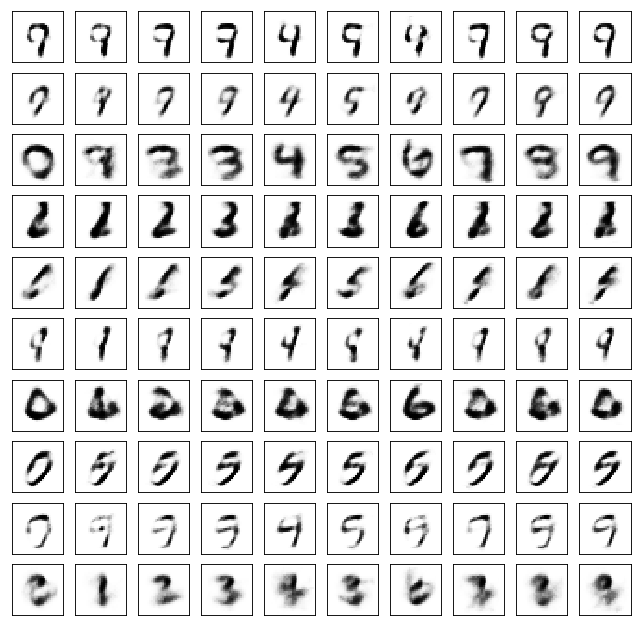

	reconstruction


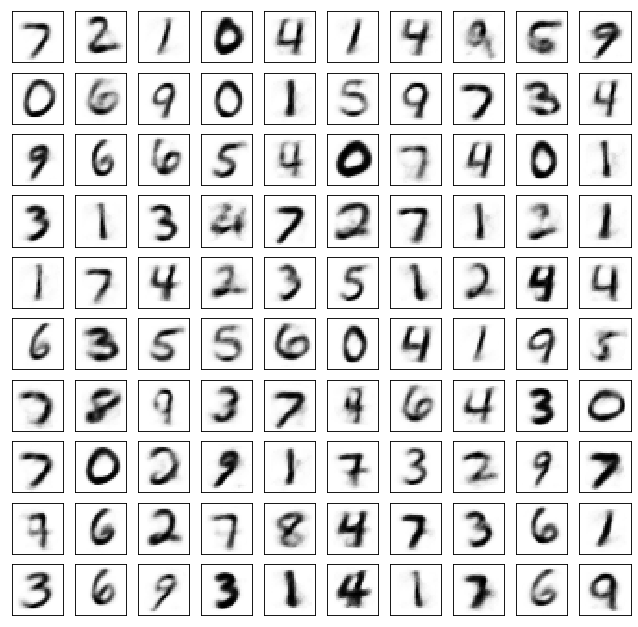

Test losses. E: 0.7880, AE: 0.1117, D: 0.7104
Train Epoch: 80 [0/50000 (0%)]	Losses E: 0.7928, AE: 0.1119, D: 0.7104
Train Epoch: 80 [25000/50000 (50%)]	Losses E: 0.7116, AE: 0.0864, D: 0.6942
Train Epoch: 80 [50000/50000 (100%)]	Losses E: 0.5609, AE: 0.1145, D: 0.7746
	generation


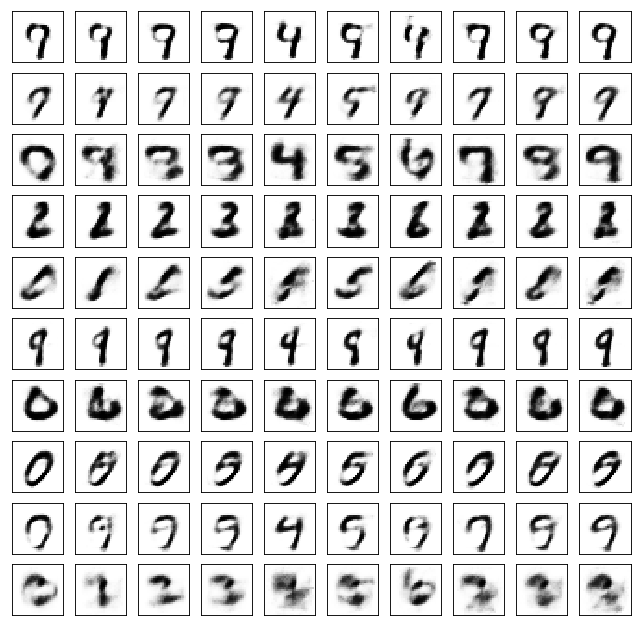

	reconstruction


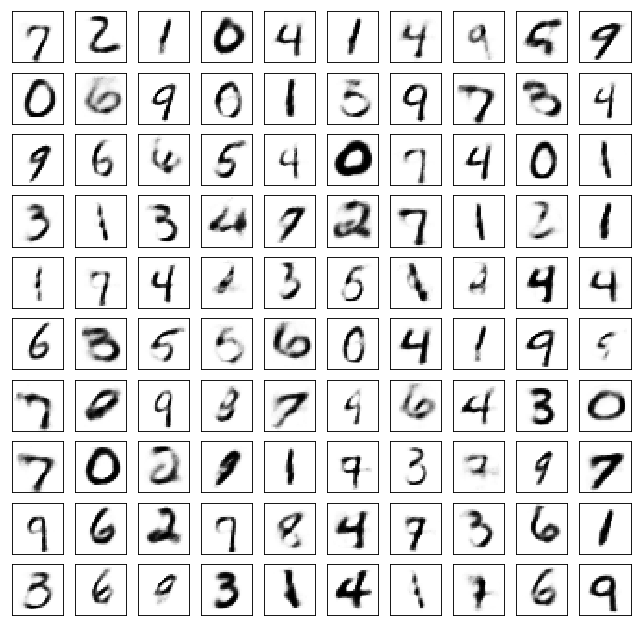

Test losses. E: 0.5089, AE: 0.1230, D: 0.7945
Train Epoch: 81 [0/50000 (0%)]	Losses E: 0.5270, AE: 0.1188, D: 0.7978
Train Epoch: 81 [25000/50000 (50%)]	Losses E: 0.7026, AE: 0.0945, D: 0.7050
Train Epoch: 81 [50000/50000 (100%)]	Losses E: 0.7347, AE: 0.0746, D: 0.6938
	generation


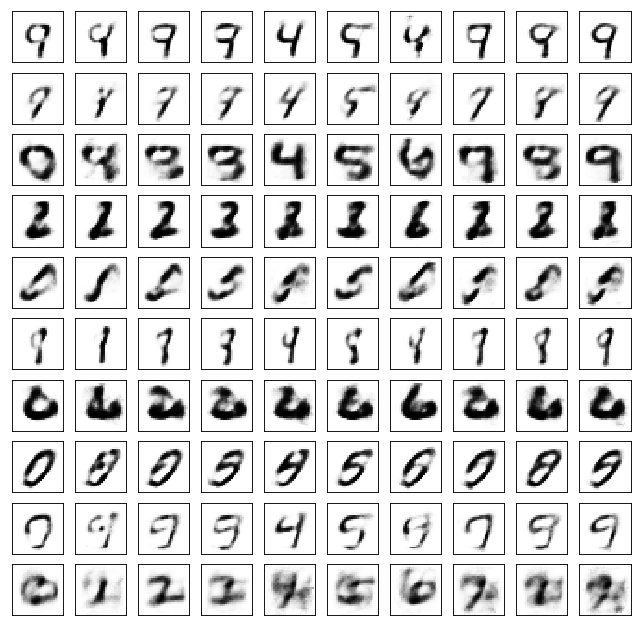

	reconstruction


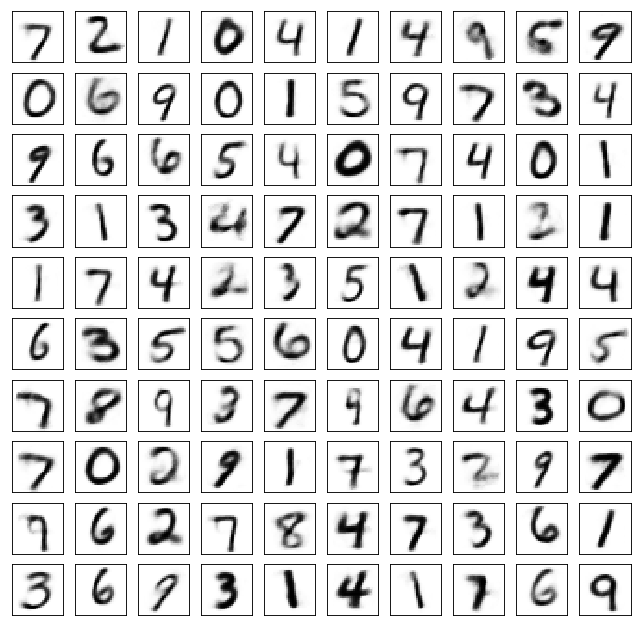

Test losses. E: 0.7321, AE: 0.0802, D: 0.6954
Train Epoch: 82 [0/50000 (0%)]	Losses E: 0.7340, AE: 0.0770, D: 0.6978
Train Epoch: 82 [25000/50000 (50%)]	Losses E: 0.6947, AE: 0.0694, D: 0.6938
Train Epoch: 82 [50000/50000 (100%)]	Losses E: 0.6998, AE: 0.0872, D: 0.6950
	generation


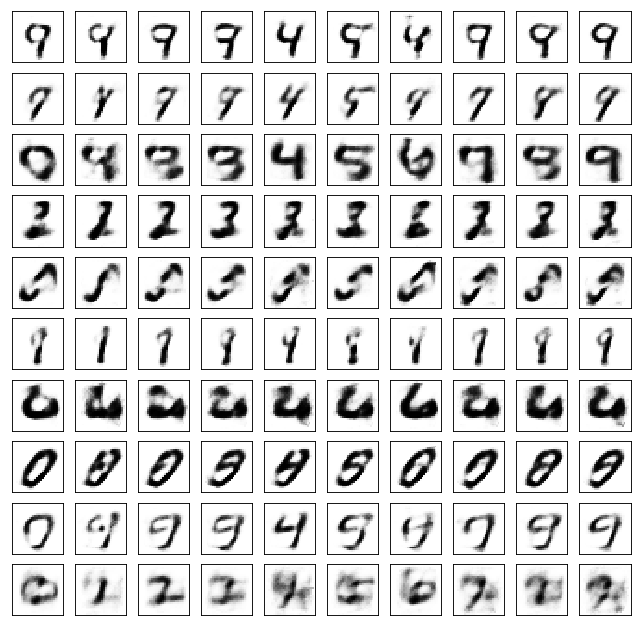

	reconstruction


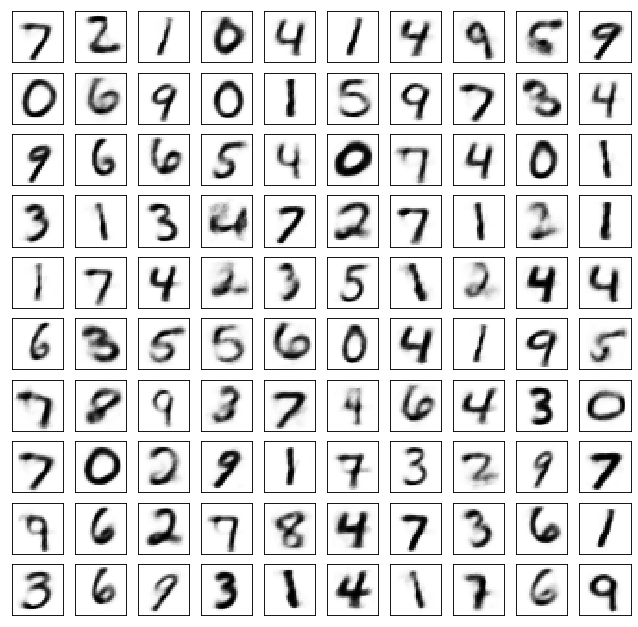

Test losses. E: 0.6943, AE: 0.0903, D: 0.6960
Train Epoch: 83 [0/50000 (0%)]	Losses E: 0.6943, AE: 0.0893, D: 0.6954
Train Epoch: 83 [25000/50000 (50%)]	Losses E: 0.7031, AE: 0.0805, D: 0.6935
Train Epoch: 83 [50000/50000 (100%)]	Losses E: 0.7547, AE: 0.0823, D: 0.6998
	generation


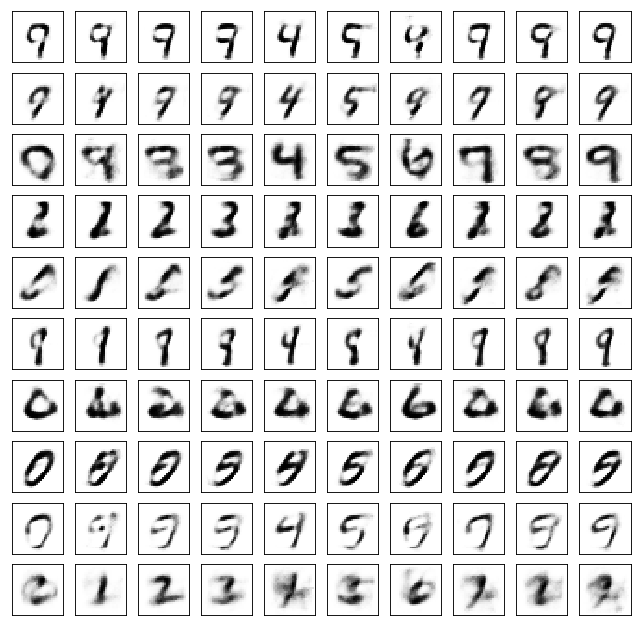

	reconstruction


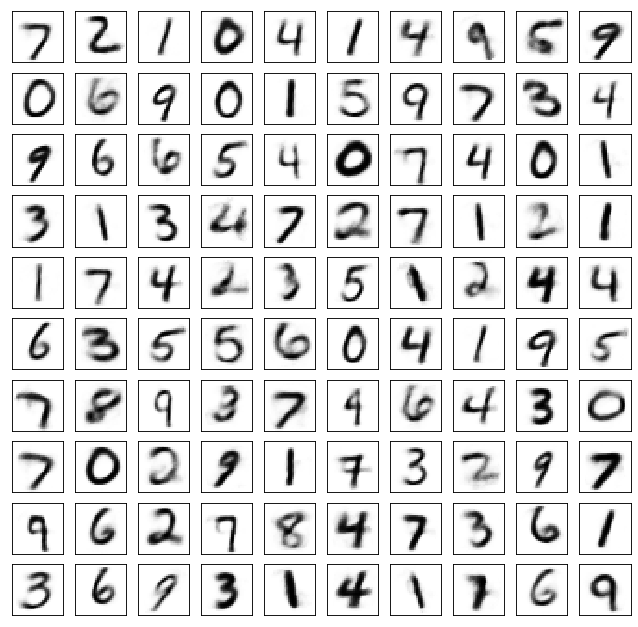

Test losses. E: 0.7520, AE: 0.0807, D: 0.7013
Train Epoch: 84 [0/50000 (0%)]	Losses E: 0.7513, AE: 0.0804, D: 0.7035
Train Epoch: 84 [25000/50000 (50%)]	Losses E: 0.6568, AE: 0.1090, D: 0.7401
Train Epoch: 84 [50000/50000 (100%)]	Losses E: 0.7337, AE: 0.0792, D: 0.6920
	generation


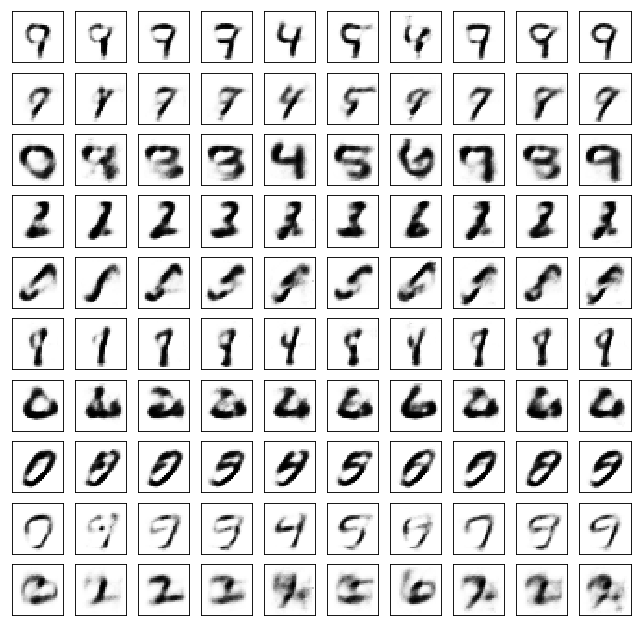

	reconstruction


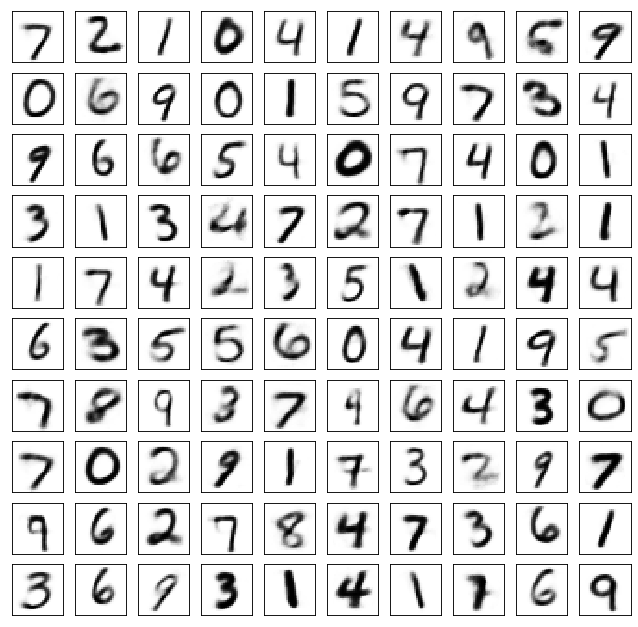

Test losses. E: 0.7345, AE: 0.0737, D: 0.6920
Train Epoch: 85 [0/50000 (0%)]	Losses E: 0.7324, AE: 0.0706, D: 0.6910
Train Epoch: 85 [25000/50000 (50%)]	Losses E: 0.7741, AE: 0.0815, D: 0.7019
Train Epoch: 85 [50000/50000 (100%)]	Losses E: 0.7242, AE: 0.0709, D: 0.6909
	generation


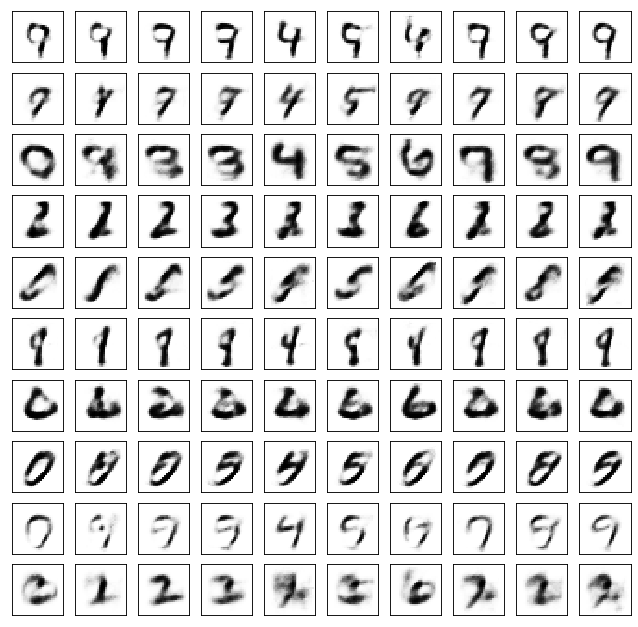

	reconstruction


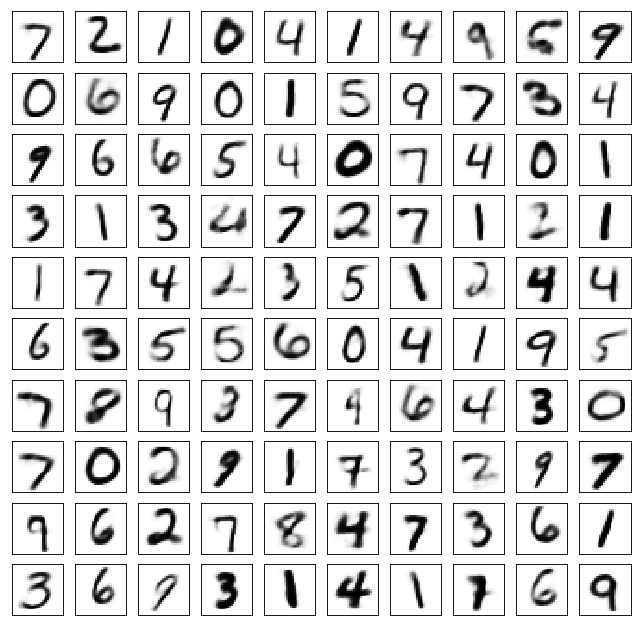

Test losses. E: 0.7218, AE: 0.0737, D: 0.6915
Train Epoch: 86 [0/50000 (0%)]	Losses E: 0.7243, AE: 0.0703, D: 0.6923
Train Epoch: 86 [25000/50000 (50%)]	Losses E: 0.5689, AE: 0.1147, D: 0.8259
Train Epoch: 86 [50000/50000 (100%)]	Losses E: 0.6840, AE: 0.0947, D: 0.6944
	generation


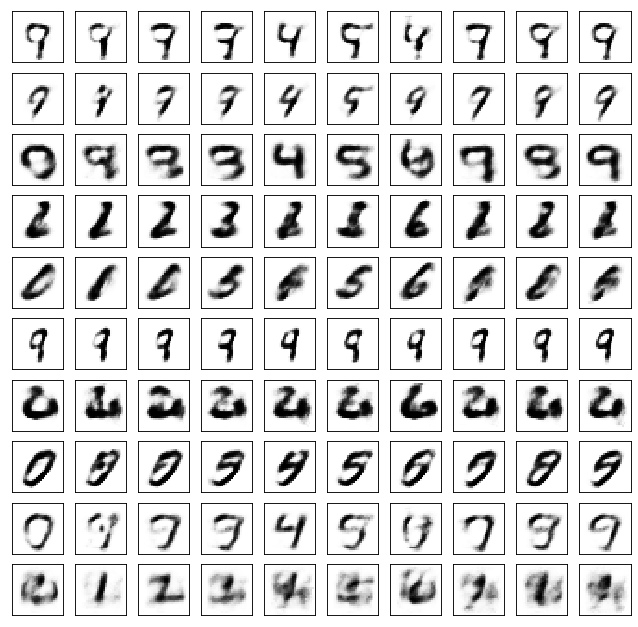

	reconstruction


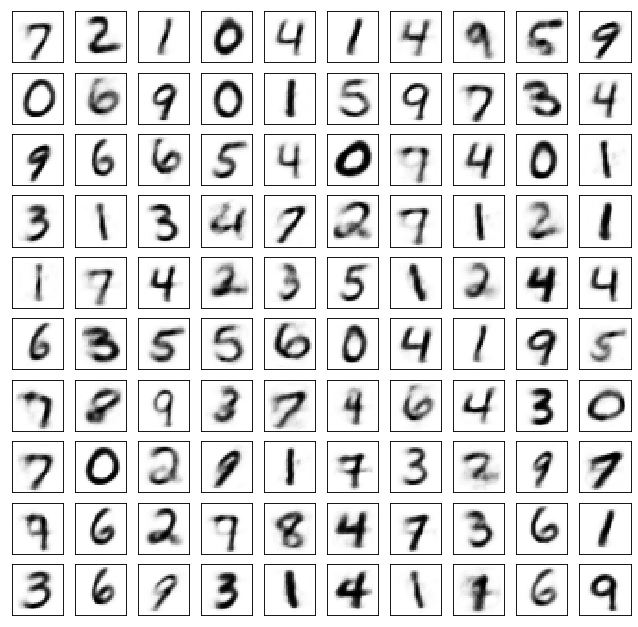

Test losses. E: 0.6820, AE: 0.0950, D: 0.6952
Train Epoch: 87 [0/50000 (0%)]	Losses E: 0.6836, AE: 0.0904, D: 0.6981
Train Epoch: 87 [25000/50000 (50%)]	Losses E: 0.7093, AE: 0.0862, D: 0.6963
Train Epoch: 87 [50000/50000 (100%)]	Losses E: 0.7016, AE: 0.0731, D: 0.6970
	generation


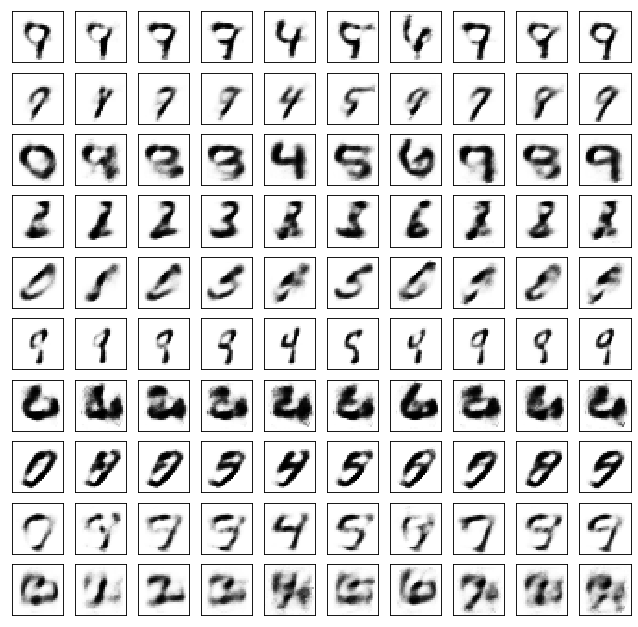

	reconstruction


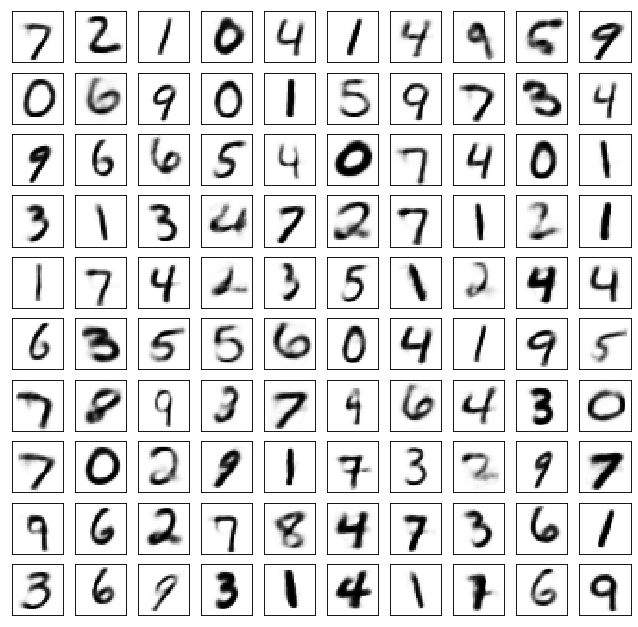

Test losses. E: 0.7006, AE: 0.0750, D: 0.6969
Train Epoch: 88 [0/50000 (0%)]	Losses E: 0.7021, AE: 0.0760, D: 0.6971
Train Epoch: 88 [25000/50000 (50%)]	Losses E: 0.6605, AE: 0.0723, D: 0.7001
Train Epoch: 88 [50000/50000 (100%)]	Losses E: 0.6841, AE: 0.0698, D: 0.6938
	generation


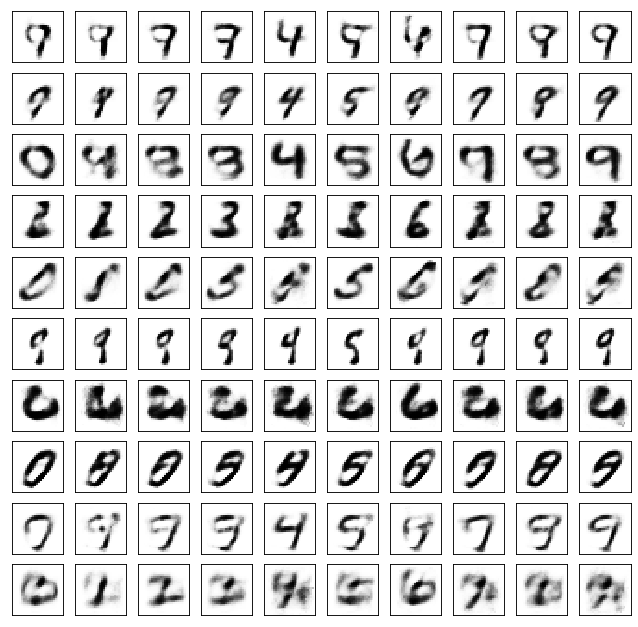

	reconstruction


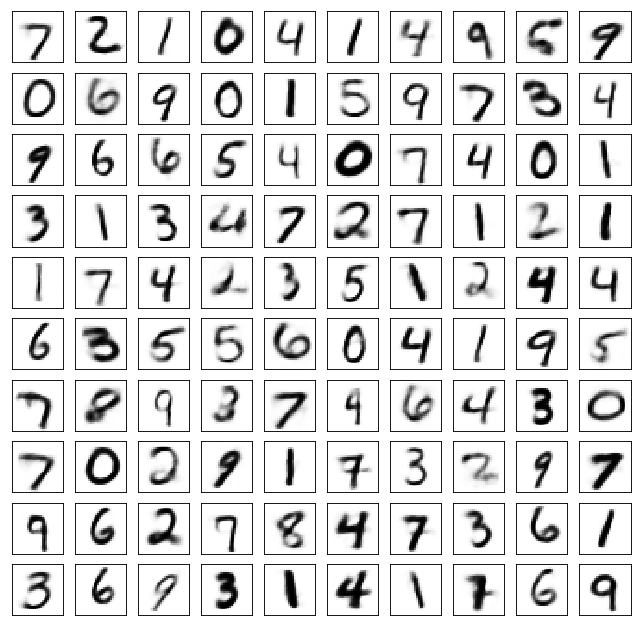

Test losses. E: 0.6818, AE: 0.0740, D: 0.6960
Train Epoch: 89 [0/50000 (0%)]	Losses E: 0.6811, AE: 0.0680, D: 0.6968
Train Epoch: 89 [25000/50000 (50%)]	Losses E: 0.6815, AE: 0.0664, D: 0.6993
Train Epoch: 89 [50000/50000 (100%)]	Losses E: 0.6607, AE: 0.0771, D: 0.7091
	generation


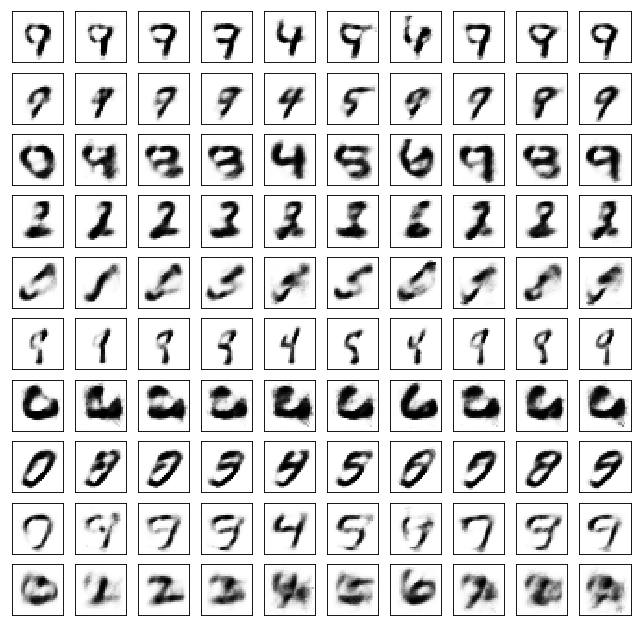

	reconstruction


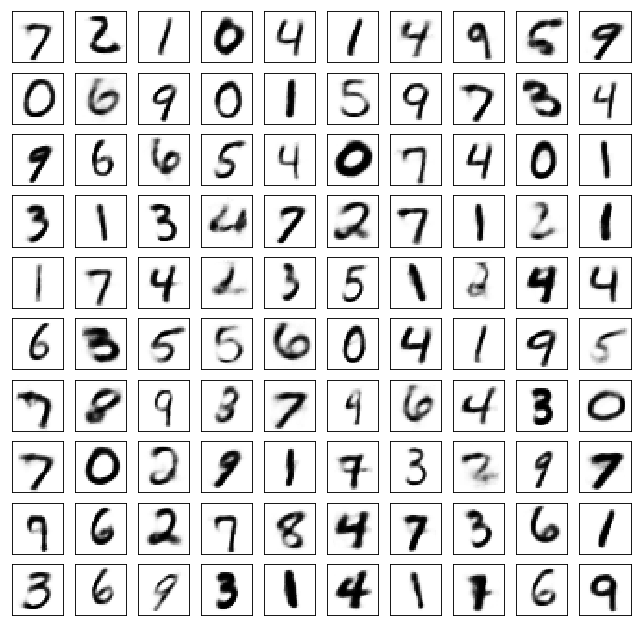

Test losses. E: 0.6581, AE: 0.0777, D: 0.7097
Train Epoch: 90 [0/50000 (0%)]	Losses E: 0.6593, AE: 0.0739, D: 0.7073
Train Epoch: 90 [25000/50000 (50%)]	Losses E: 0.7430, AE: 0.0786, D: 0.6976
Train Epoch: 90 [50000/50000 (100%)]	Losses E: 0.6692, AE: 0.0700, D: 0.6893
	generation


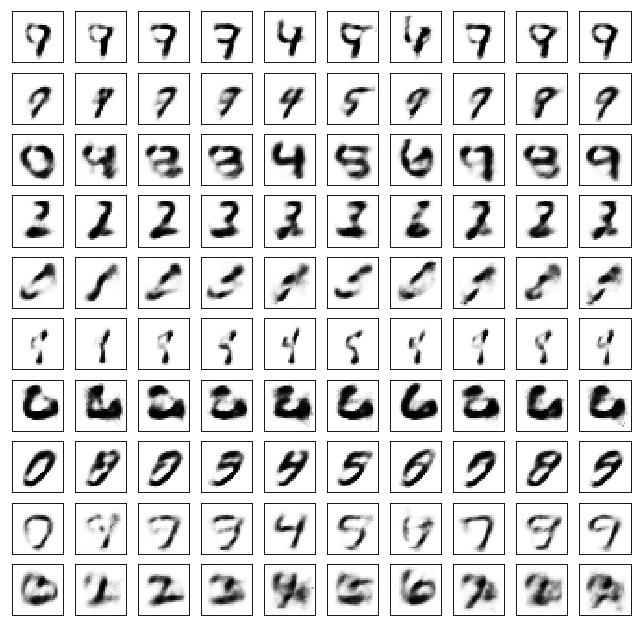

	reconstruction


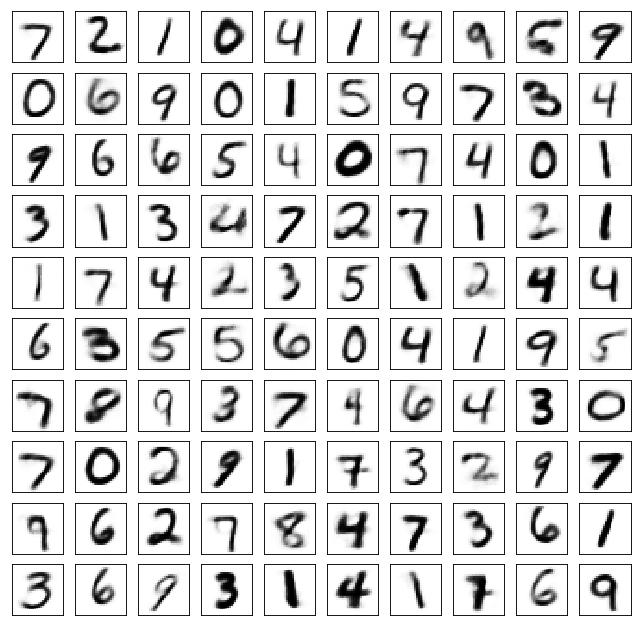

Test losses. E: 0.6672, AE: 0.0736, D: 0.6895
Train Epoch: 91 [0/50000 (0%)]	Losses E: 0.6687, AE: 0.0685, D: 0.6882
Train Epoch: 91 [25000/50000 (50%)]	Losses E: 0.7072, AE: 0.0733, D: 0.6920
Train Epoch: 91 [50000/50000 (100%)]	Losses E: 0.7012, AE: 0.0779, D: 0.7110
	generation


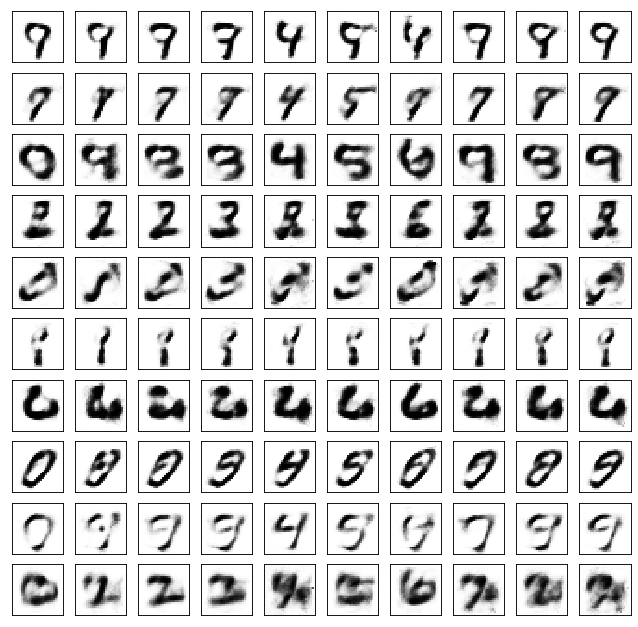

	reconstruction


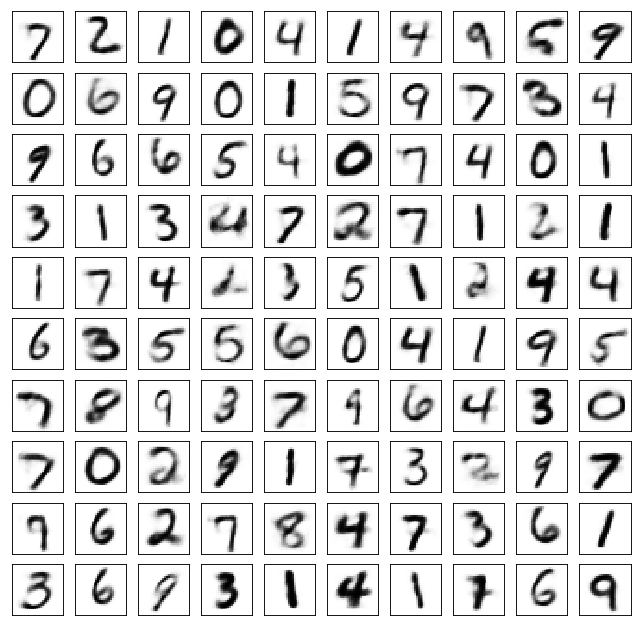

Test losses. E: 0.6970, AE: 0.0789, D: 0.7103
Train Epoch: 92 [0/50000 (0%)]	Losses E: 0.7066, AE: 0.0806, D: 0.7115
Train Epoch: 92 [25000/50000 (50%)]	Losses E: 0.7146, AE: 0.0874, D: 0.7054
Train Epoch: 92 [50000/50000 (100%)]	Losses E: 0.7125, AE: 0.0753, D: 0.7025
	generation


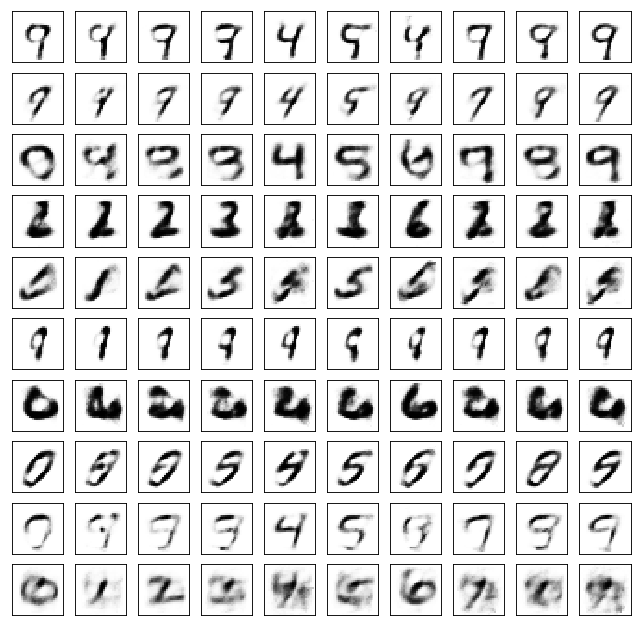

	reconstruction


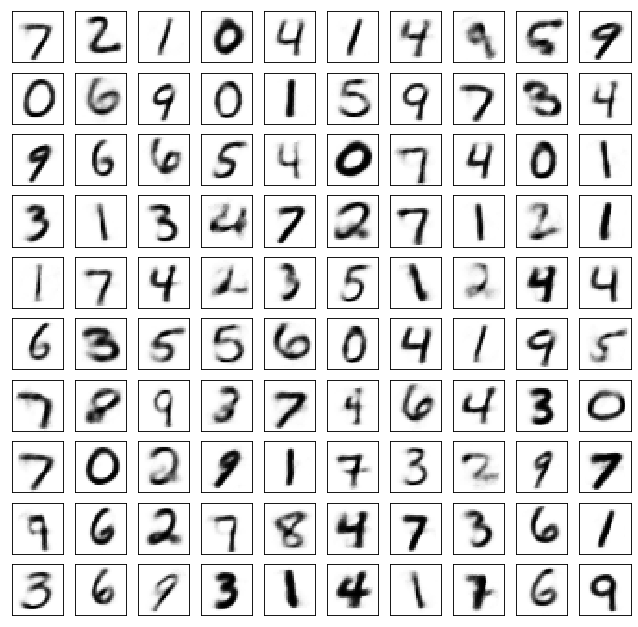

Test losses. E: 0.7104, AE: 0.0787, D: 0.7011
Train Epoch: 93 [0/50000 (0%)]	Losses E: 0.7170, AE: 0.0721, D: 0.6997
Train Epoch: 93 [25000/50000 (50%)]	Losses E: 0.7096, AE: 0.0705, D: 0.6941
Train Epoch: 93 [50000/50000 (100%)]	Losses E: 0.6683, AE: 0.0697, D: 0.6899
	generation


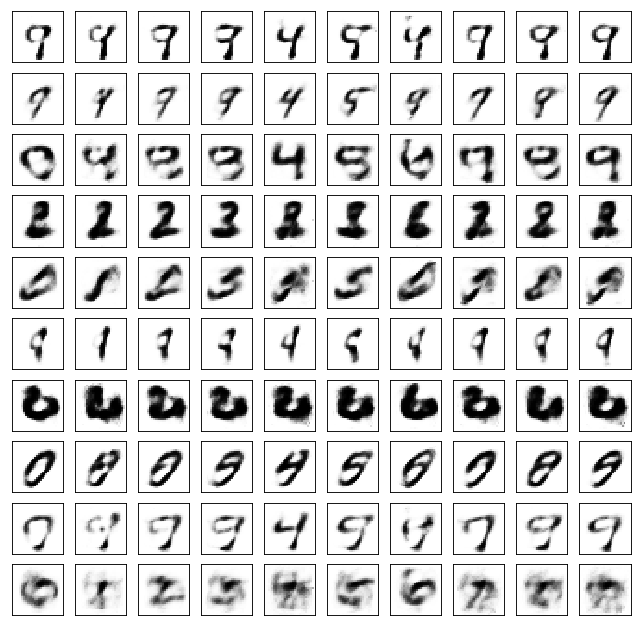

	reconstruction


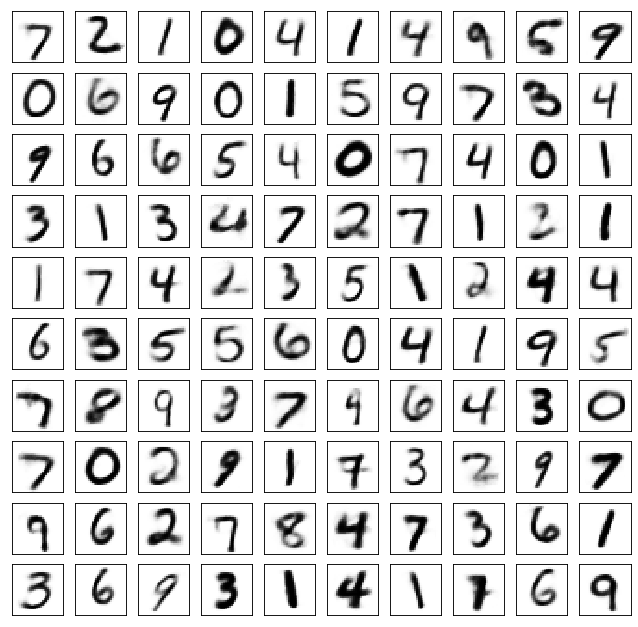

Test losses. E: 0.6675, AE: 0.0725, D: 0.6896
Train Epoch: 94 [0/50000 (0%)]	Losses E: 0.6671, AE: 0.0714, D: 0.6928
Train Epoch: 94 [25000/50000 (50%)]	Losses E: 0.6645, AE: 0.0726, D: 0.7093
Train Epoch: 94 [50000/50000 (100%)]	Losses E: 0.7356, AE: 0.0806, D: 0.6918
	generation


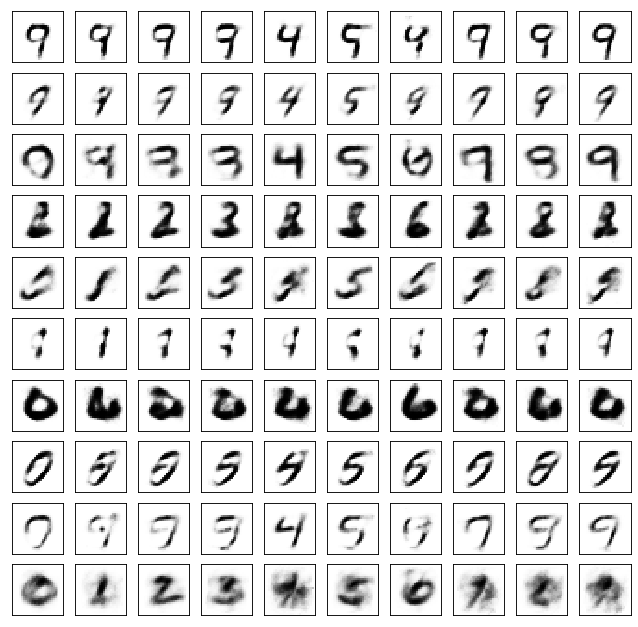

	reconstruction


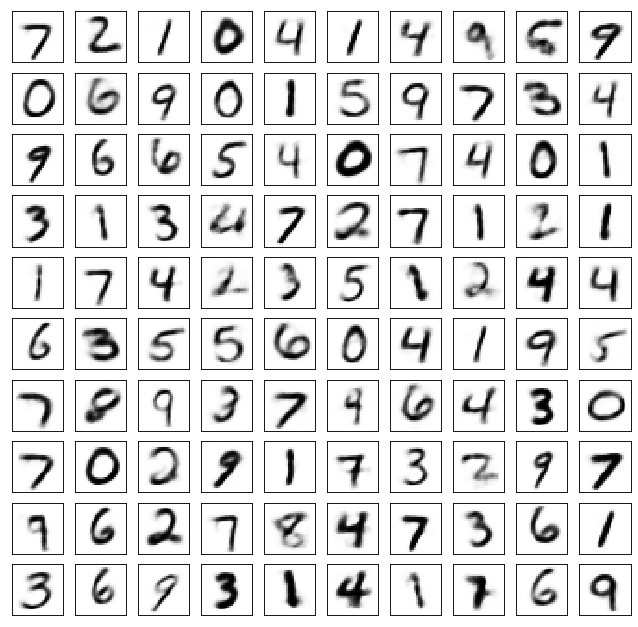

Test losses. E: 0.7320, AE: 0.0804, D: 0.6918
Train Epoch: 95 [0/50000 (0%)]	Losses E: 0.7393, AE: 0.0752, D: 0.6925
Train Epoch: 95 [25000/50000 (50%)]	Losses E: 0.6421, AE: 0.0711, D: 0.6998
Train Epoch: 95 [50000/50000 (100%)]	Losses E: 0.6869, AE: 0.0944, D: 0.7138
	generation


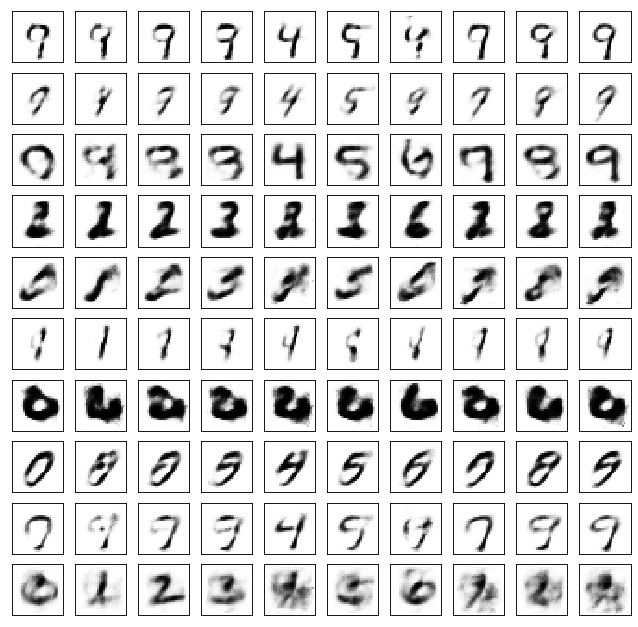

	reconstruction


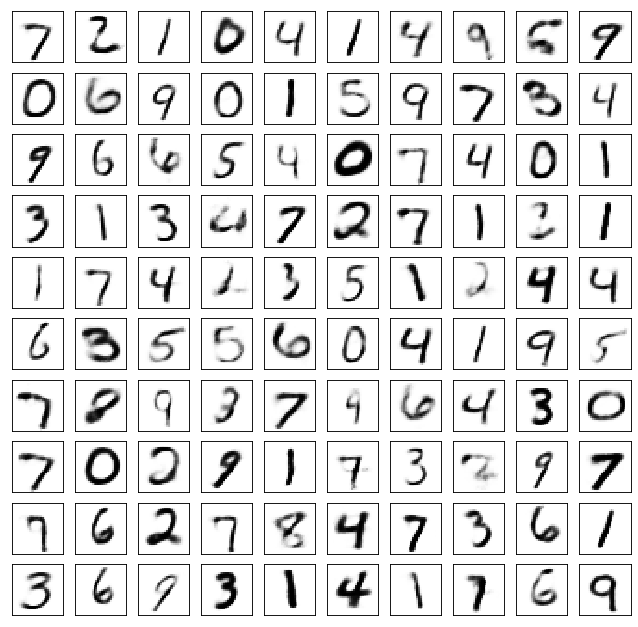

Test losses. E: 0.6864, AE: 0.0944, D: 0.7050
Train Epoch: 96 [0/50000 (0%)]	Losses E: 0.6957, AE: 0.0923, D: 0.7059
Train Epoch: 96 [25000/50000 (50%)]	Losses E: 0.7027, AE: 0.0705, D: 0.7071
Train Epoch: 96 [50000/50000 (100%)]	Losses E: 0.6361, AE: 0.0729, D: 0.6886
	generation


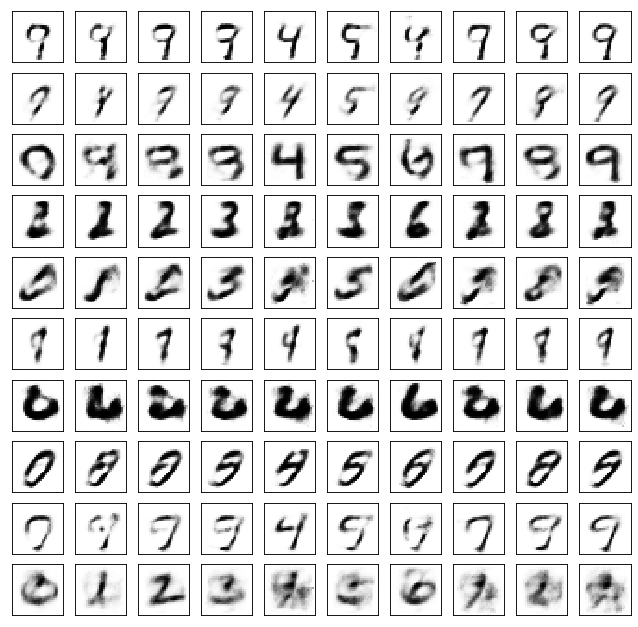

	reconstruction


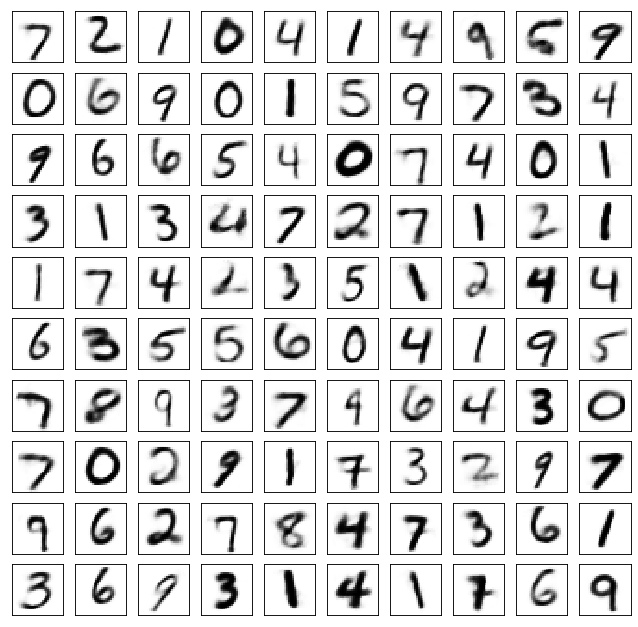

Test losses. E: 0.6348, AE: 0.0705, D: 0.6880
Train Epoch: 97 [0/50000 (0%)]	Losses E: 0.6342, AE: 0.0676, D: 0.6880
Train Epoch: 97 [25000/50000 (50%)]	Losses E: 0.7162, AE: 0.0694, D: 0.6908
Train Epoch: 97 [50000/50000 (100%)]	Losses E: 0.6933, AE: 0.0714, D: 0.7027
	generation


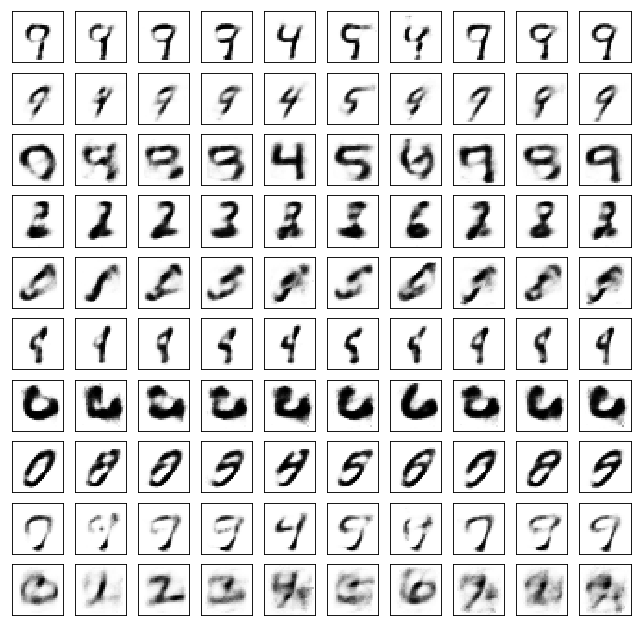

	reconstruction


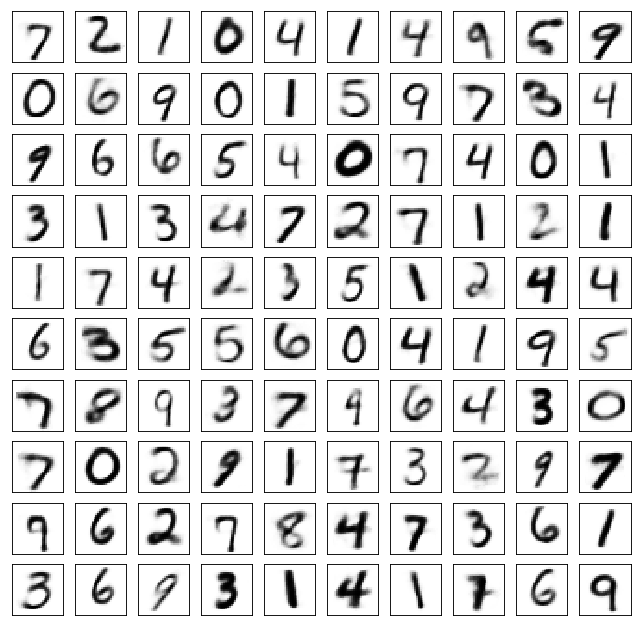

Test losses. E: 0.6926, AE: 0.0737, D: 0.7005
Train Epoch: 98 [0/50000 (0%)]	Losses E: 0.6973, AE: 0.0735, D: 0.7004
Train Epoch: 98 [25000/50000 (50%)]	Losses E: 0.6044, AE: 0.0728, D: 0.7075
Train Epoch: 98 [50000/50000 (100%)]	Losses E: 0.6142, AE: 0.0684, D: 0.6988
	generation


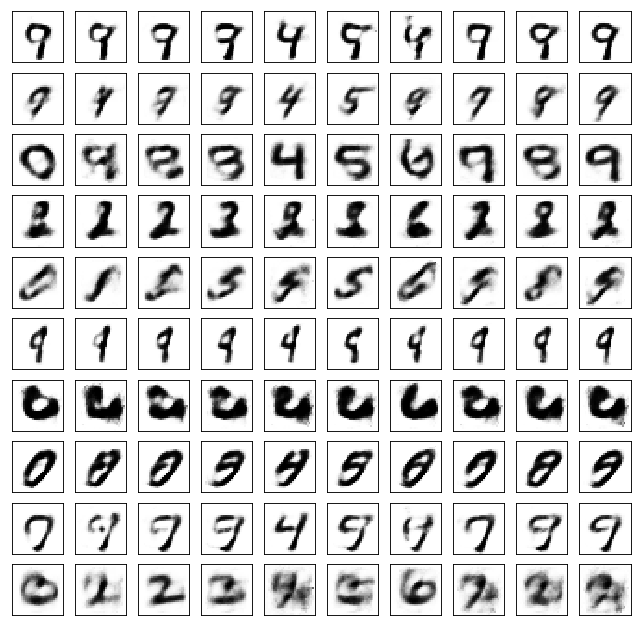

	reconstruction


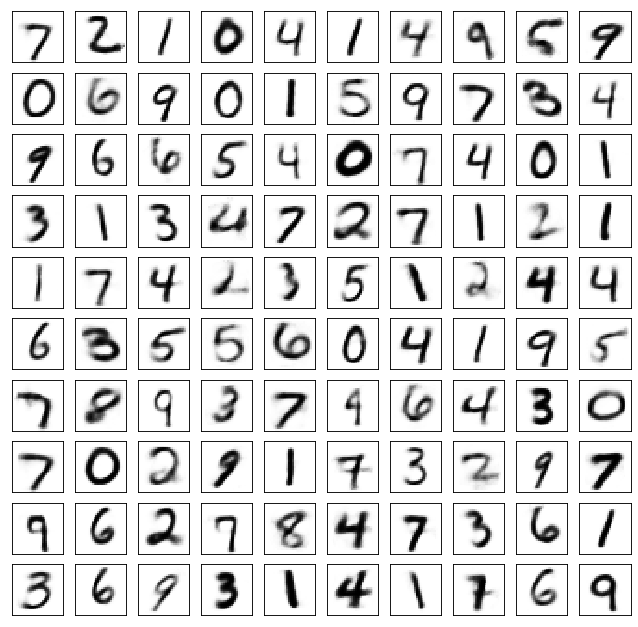

Test losses. E: 0.6129, AE: 0.0707, D: 0.6989
Train Epoch: 99 [0/50000 (0%)]	Losses E: 0.6140, AE: 0.0656, D: 0.6985
Train Epoch: 99 [25000/50000 (50%)]	Losses E: 0.7012, AE: 0.0868, D: 0.6968
Train Epoch: 99 [50000/50000 (100%)]	Losses E: 0.6982, AE: 0.0717, D: 0.6949
	generation


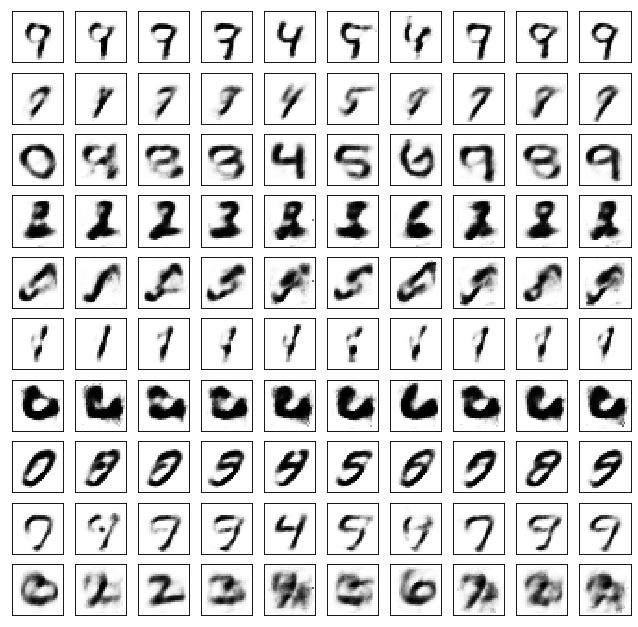

	reconstruction


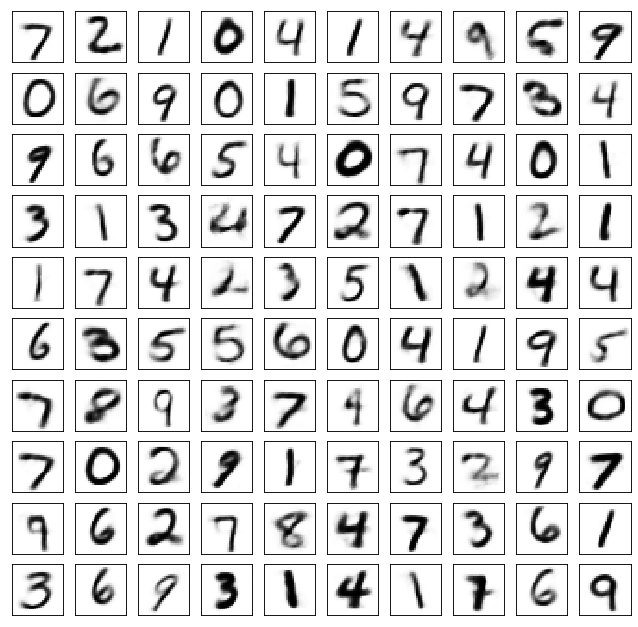

Test losses. E: 0.6990, AE: 0.0726, D: 0.6929
Train Epoch: 100 [0/50000 (0%)]	Losses E: 0.6999, AE: 0.0713, D: 0.6930
Train Epoch: 100 [25000/50000 (50%)]	Losses E: 0.6930, AE: 0.0660, D: 0.6946
Train Epoch: 100 [50000/50000 (100%)]	Losses E: 0.6551, AE: 0.0969, D: 0.7470
	generation


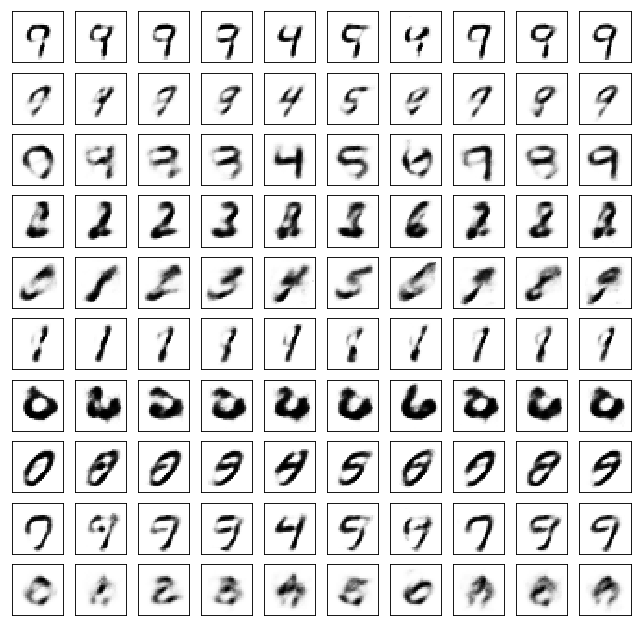

	reconstruction


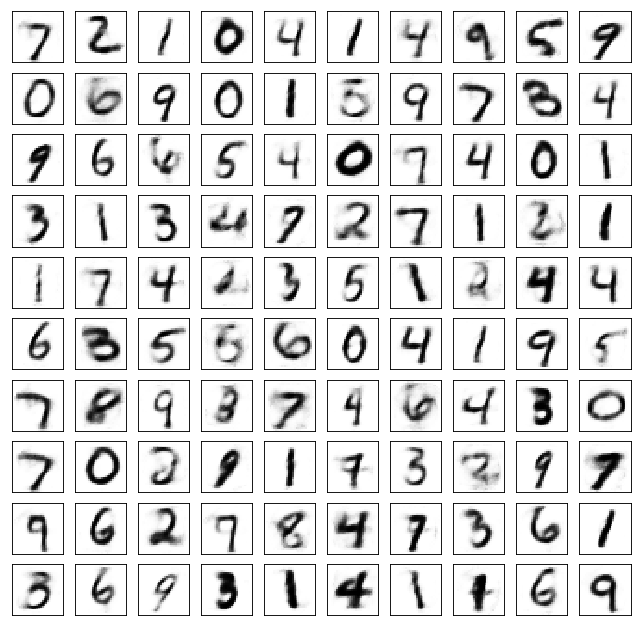

Test losses. E: 0.6495, AE: 0.0916, D: 0.7309
CPU times: user 48min 35s, sys: 2min 10s, total: 50min 46s
Wall time: 50min 52s


In [19]:
%%time

for epoch in range(1, train_epoch + 1):
    coders[variant]["Enc"].train()
    coders[variant]["Dec"].train()
    coders[variant]["Disc"].train()
    train(epoch, 
          coders[variant]["Enc"],
          coders[variant]["Dec"],
          coders[variant]["Disc"], 
          logs[variant]["train"])
    coders[variant]["Enc"].eval()
    coders[variant]["Dec"].eval()
    coders[variant]["Disc"].eval()
    test(coders[variant]["Enc"],
         coders[variant]["Dec"],
         coders[variant]["Disc"], 
         valid_loader, epoch, variant, logs[variant]["test"])

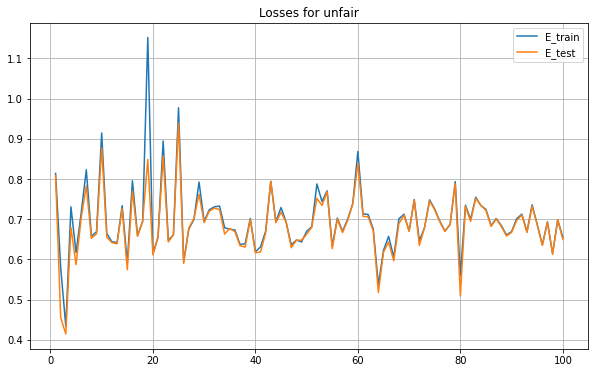

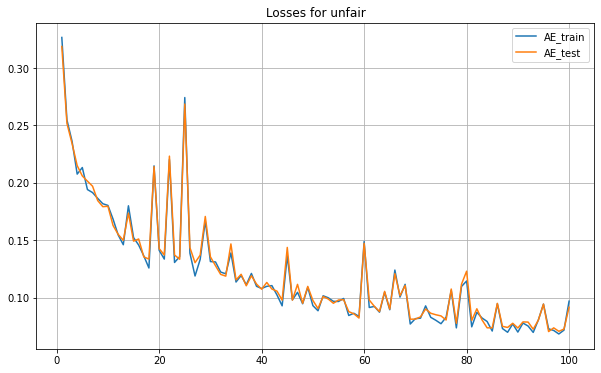

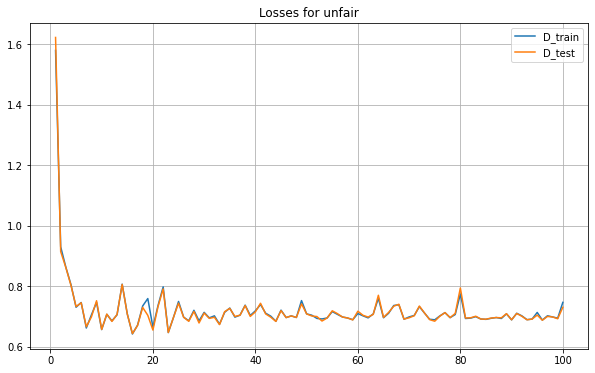

In [20]:
for item in logs[variant]["train"]:
    plt.figure(figsize=(10, 6))
    for mode in logs[variant]:
        plt.plot(range(1, len(logs[variant][mode][item]) + 1), logs[variant][mode][item], 
                 label=f"{item}_{mode}")
    plt.title(f"Losses for {variant}")
    plt.legend()
    plt.grid()
    plt.show()

## <center>2) "Честный" вариант

In [21]:
variant = "fair"

In [22]:
coders[variant] = {}

In [23]:
coders[variant]["Enc"] = FullyConnected([28*28, 1024, 1024, prior_size], activation_fn=nn.LeakyReLU(0.2), flatten=True, device=device)
coders[variant]["Dec"] = FullyConnected([prior_size+10, 1024, 1024, 28*28], activation_fn=nn.LeakyReLU(0.2), last_fn=nn.Tanh(), device=device)
coders[variant]["Disc"] = FullyConnected([prior_size+10, 1024, 1024, 1], dropout=0.3, activation_fn=nn.LeakyReLU(0.2), device=device)

Enc_optimizer = optim.Adam(coders[variant]["Enc"].parameters(), lr=lr)
Dec_optimizer = optim.Adam(coders[variant]["Dec"].parameters(), lr=lr)
Disc_optimizer = optim.Adam(coders[variant]["Disc"].parameters(), lr=lr)

In [24]:
logs[variant] = {}
logs[variant]["train"] = {'E': [],'AE': [], 'D': []}
logs[variant]["test"] = {'E': [],'AE': [], 'D': []}

In [25]:
batch_zeros = torch.zeros((batch_size, 1)).to(device)
batch_ones = torch.ones((batch_size, 1)).to(device)

#### тренировочные функции

In [26]:
def train(epoch, Enc, Dec, Disc, log=None):
    train_size = len(train_loader.sampler)
    for batch_idx, (data, label) in enumerate(train_loader):
        label = to_onehot(label, 10, device)
        # train D
        Enc.zero_grad()
        Disc.zero_grad()
        
        z = torch.randn((batch_size, prior_size)).to(device)
        z_label = to_onehot(np.random.randint(0, 10, (batch_size)), 10, device)

        fake_pred = Disc(Enc(data), label)
        true_pred = Disc(z, z_label)

        
        fake_loss = F.binary_cross_entropy_with_logits(fake_pred, batch_zeros)
        true_loss = F.binary_cross_entropy_with_logits(true_pred, batch_ones)
        
        Disc_loss = 0.5*(fake_loss + true_loss)
        
        Disc_loss.backward()
        Disc_optimizer.step()
        
        # train AE
        Enc.zero_grad()
        Dec.zero_grad()
        Disc.zero_grad()
        
        z = torch.randn((batch_size, prior_size))
        z_label = to_onehot(np.random.randint(0, 10, (batch_size)), 10)
        
        latent = Enc(data)
        reconstructed = Dec(latent, label).view(-1, 1, 28, 28)
        fake_pred = Disc(latent, label)
        
        Enc_loss = F.binary_cross_entropy_with_logits(fake_pred, batch_ones)
        AE_loss = F.mse_loss(reconstructed, data)
        G_loss = AE_loss + Enc_loss
        
        G_loss.backward()
        Dec_optimizer.step()
        Enc_optimizer.step()
            
        if batch_idx % 100 == 0:
            line = 'Train Epoch: {} [{}/{} ({:.0f}%)]\tLosses '.format(
                epoch, batch_idx * len(data), train_size, 100. * batch_idx / len(train_loader))
            losses = 'E: {:.4f}, AE: {:.4f}, D: {:.4f}'.format(Enc_loss.item(), AE_loss.item(), Disc_loss.item())
            print(line + losses)
            
    else:
        batch_idx += 1
        line = 'Train Epoch: {} [{}/{} ({:.0f}%)]\tLosses '.format(
            epoch, batch_idx * len(data), train_size, 100. * batch_idx / len(train_loader))
        losses = 'E: {:.4f}, AE: {:.4f}, D: {:.4f}'.format(Enc_loss.item(), AE_loss.item(), Disc_loss.item())
        print(line + losses)
        if log is not None:
            log['E'].append(Enc_loss.item())
            log['AE'].append(AE_loss.item())
            log['D'].append(Disc_loss.item())

In [27]:
def test(Enc, Dec, Disc, loader, epoch, file_prefix='', log=None):
    test_size = len(loader)
    E_loss = 0.
    AE_loss = 0.
    D_loss = 0.
    test_loss = {'E': 0., 'AE': 0., 'D': 0.}
    with torch.no_grad():
        for data, label in loader:
            label = to_onehot(label, 10, device)
            z = torch.randn((batch_size, prior_size)).to(device)
            z_label = to_onehot(np.random.randint(0, 10, (batch_size)), 10, device)
            latent = Enc(data)
            reconstructed = Dec(latent, label).view(-1, 1, 28, 28)
            fake_pred = Disc(latent, label)
            true_pred = Disc(z, z_label)
        
            fake_loss = F.binary_cross_entropy_with_logits(fake_pred, batch_zeros).item()
            true_loss = F.binary_cross_entropy_with_logits(true_pred, batch_ones).item()
            
            D_loss += 0.5*(fake_loss + true_loss)
            E_loss += F.binary_cross_entropy_with_logits(fake_pred, batch_ones).item()
            AE_loss += F.mse_loss(reconstructed, data)
            
        E_loss /= test_size
        D_loss /= test_size
        AE_loss /= test_size

        if epoch % 1 == 0 or epoch == 1:
            fixed_gen = Dec(fixed_z, fixed_z_label).cpu().data.numpy().reshape(100, 1, 28, 28)
            print("\tgeneration")
            plot_mnist(fixed_gen, (10, 10), True, fixed_folder + file_prefix + '%03d.png' % epoch)
            fixed_reconstruction = Dec(Enc(fixed_data), fixed_label).cpu().data.numpy().reshape(100, 1, 28, 28)
            print("\treconstruction")
            plot_mnist(fixed_reconstruction, (10, 10), True, 
                    recon_folder + file_prefix + '%03d.png' % epoch)
            
            report = 'Test losses. E: {:.4f}, AE: {:.4f}, D: {:.4f}'.format(E_loss, AE_loss, D_loss)
            print(report)

        if log is not None:
            log['E'].append(E_loss)
            log['AE'].append(AE_loss)
            log['D'].append(D_loss)

Train Epoch: 1 [0/50000 (0%)]	Losses E: 0.6789, AE: 0.9259, D: 0.6920
Train Epoch: 1 [25000/50000 (50%)]	Losses E: 0.3129, AE: 0.2779, D: 4.7392
Train Epoch: 1 [50000/50000 (100%)]	Losses E: 0.8667, AE: 0.3494, D: 1.3460
	generation


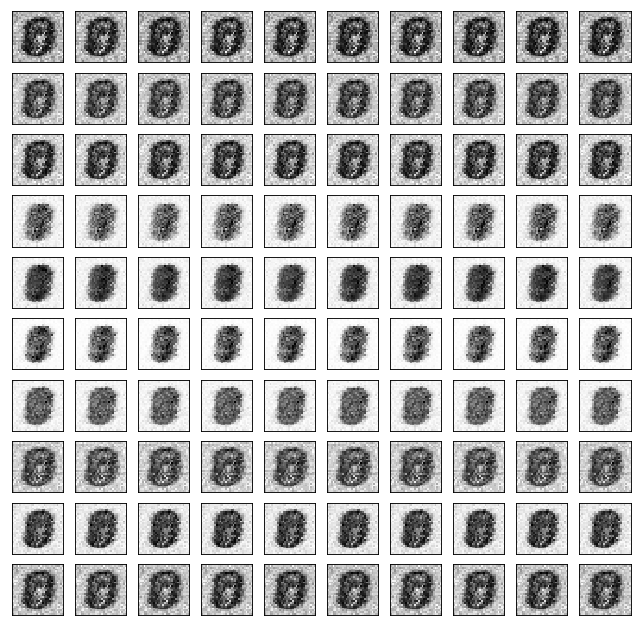

	reconstruction


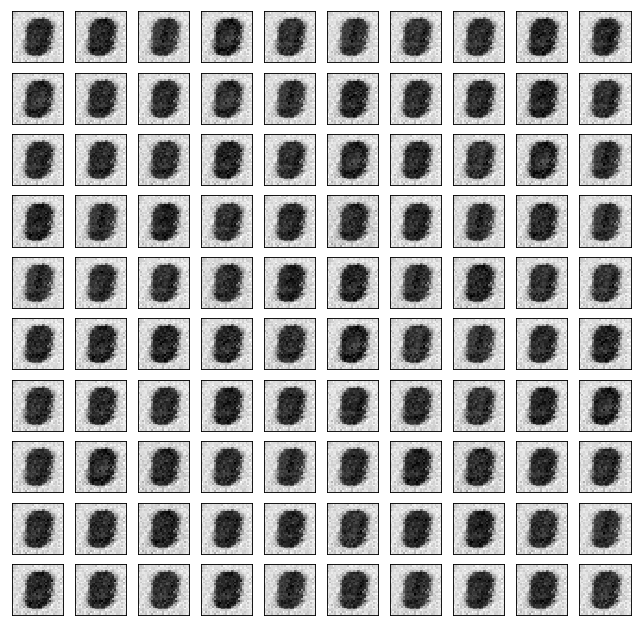

Test losses. E: 0.8712, AE: 0.3612, D: 1.3012
Train Epoch: 2 [0/50000 (0%)]	Losses E: 0.8804, AE: 0.3619, D: 1.3323
Train Epoch: 2 [25000/50000 (50%)]	Losses E: 0.6322, AE: 0.2757, D: 0.9318
Train Epoch: 2 [50000/50000 (100%)]	Losses E: 0.6138, AE: 0.2461, D: 0.7163
	generation


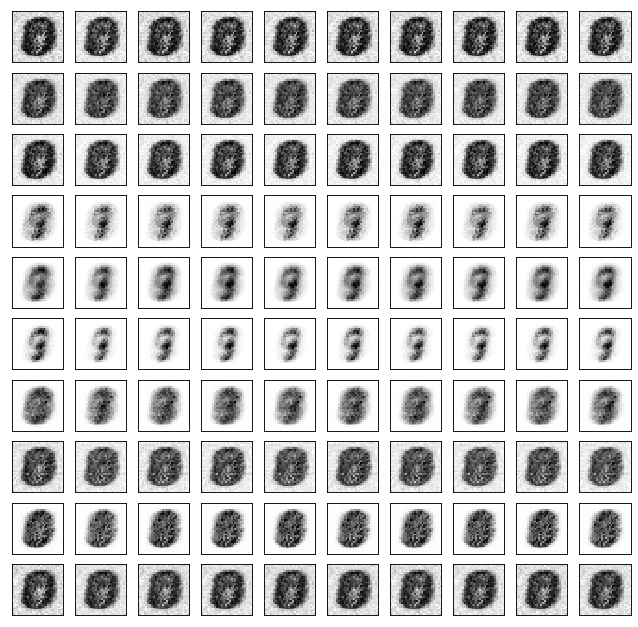

	reconstruction


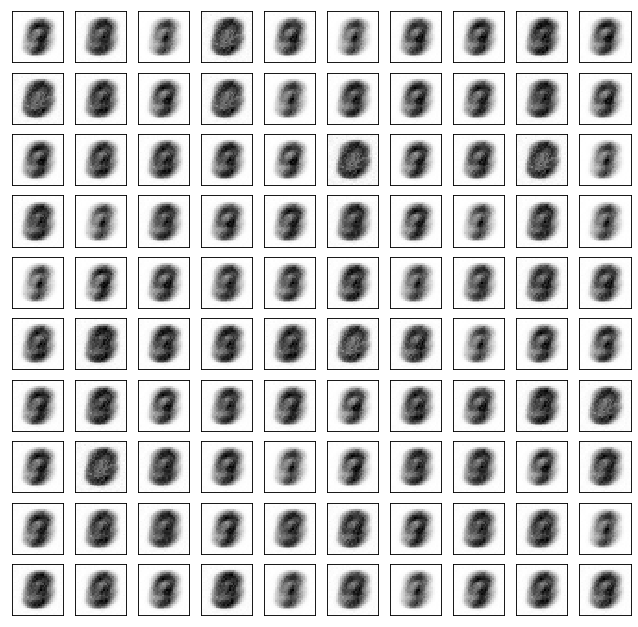

Test losses. E: 0.5787, AE: 0.2512, D: 0.7106
Train Epoch: 3 [0/50000 (0%)]	Losses E: 0.6034, AE: 0.2536, D: 0.6968
Train Epoch: 3 [25000/50000 (50%)]	Losses E: 1.3307, AE: 0.2360, D: 0.8765
Train Epoch: 3 [50000/50000 (100%)]	Losses E: 0.6029, AE: 0.2387, D: 0.7914
	generation


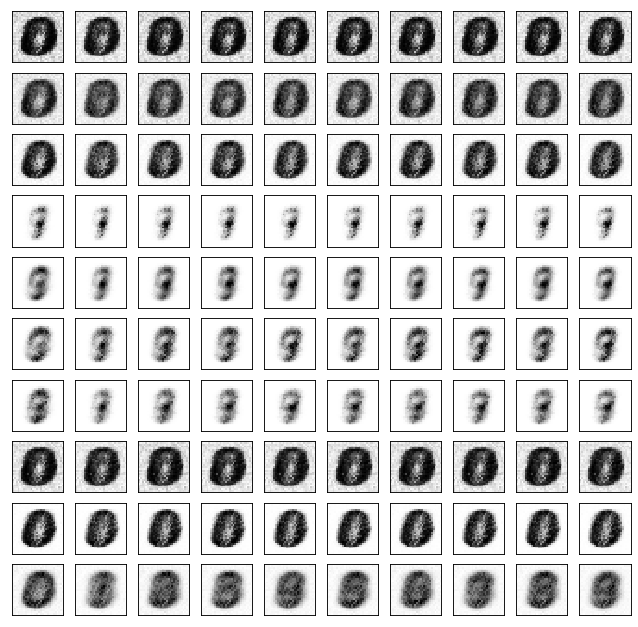

	reconstruction


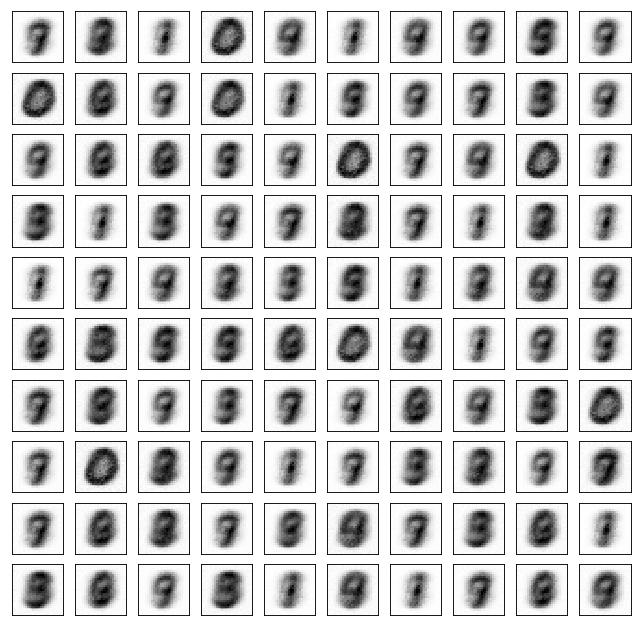

Test losses. E: 0.5970, AE: 0.2380, D: 0.7909
Train Epoch: 4 [0/50000 (0%)]	Losses E: 0.6014, AE: 0.2385, D: 0.7926
Train Epoch: 4 [25000/50000 (50%)]	Losses E: 0.5199, AE: 0.2236, D: 0.7492
Train Epoch: 4 [50000/50000 (100%)]	Losses E: 0.7716, AE: 0.2280, D: 0.6890
	generation


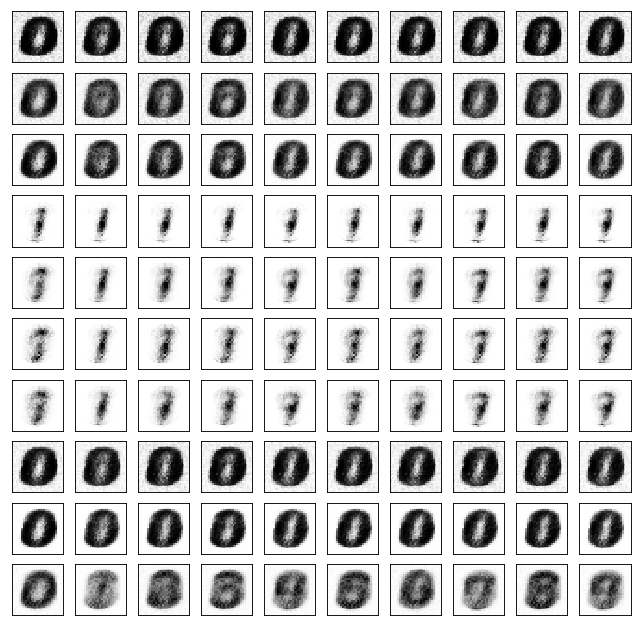

	reconstruction


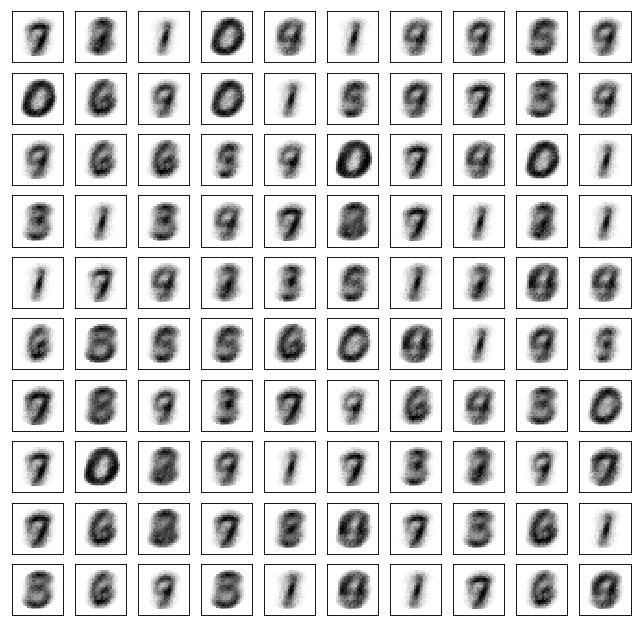

Test losses. E: 0.7087, AE: 0.2223, D: 0.6828
Train Epoch: 5 [0/50000 (0%)]	Losses E: 0.8194, AE: 0.2136, D: 0.6767
Train Epoch: 5 [25000/50000 (50%)]	Losses E: 0.6656, AE: 0.2114, D: 0.7645
Train Epoch: 5 [50000/50000 (100%)]	Losses E: 0.5705, AE: 0.2129, D: 0.7464
	generation


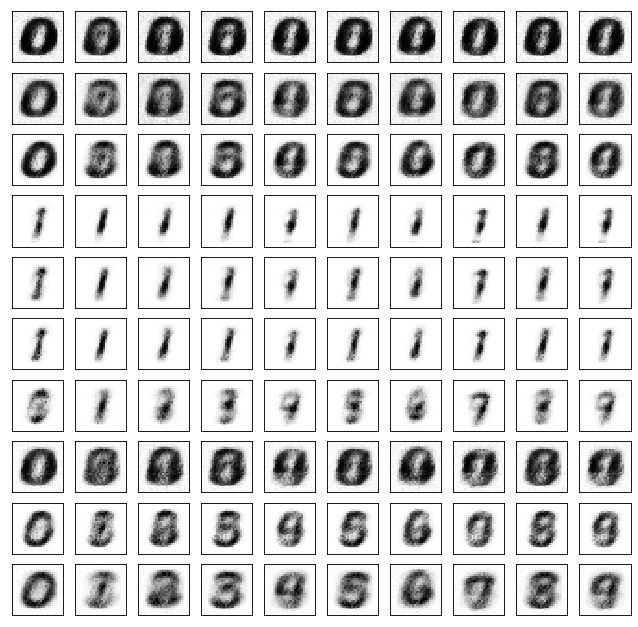

	reconstruction


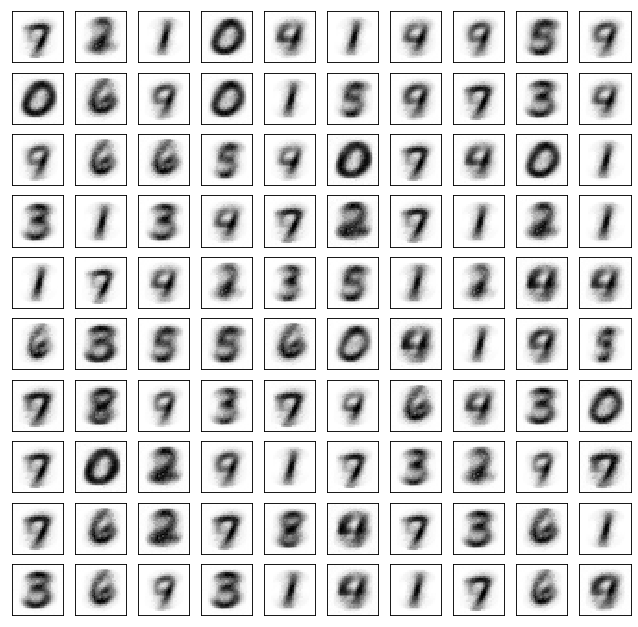

Test losses. E: 0.5627, AE: 0.2079, D: 0.7467
Train Epoch: 6 [0/50000 (0%)]	Losses E: 0.5665, AE: 0.2034, D: 0.7566
Train Epoch: 6 [25000/50000 (50%)]	Losses E: 0.4818, AE: 0.2062, D: 0.7763
Train Epoch: 6 [50000/50000 (100%)]	Losses E: 0.8412, AE: 0.2063, D: 0.6894
	generation


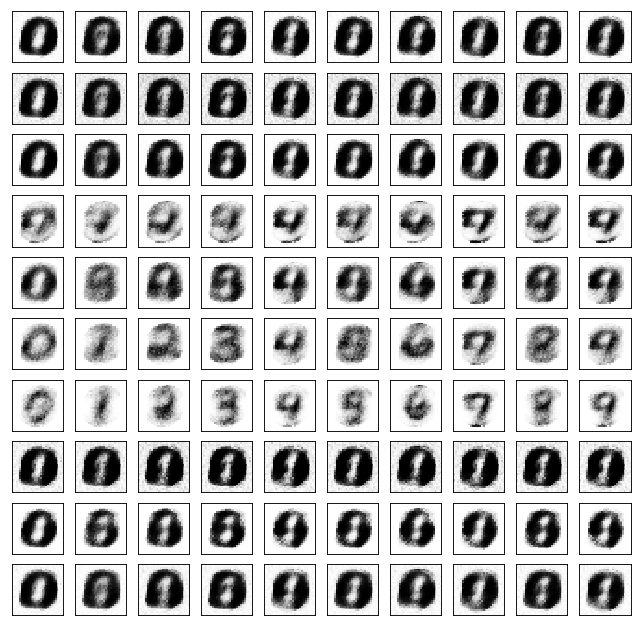

	reconstruction


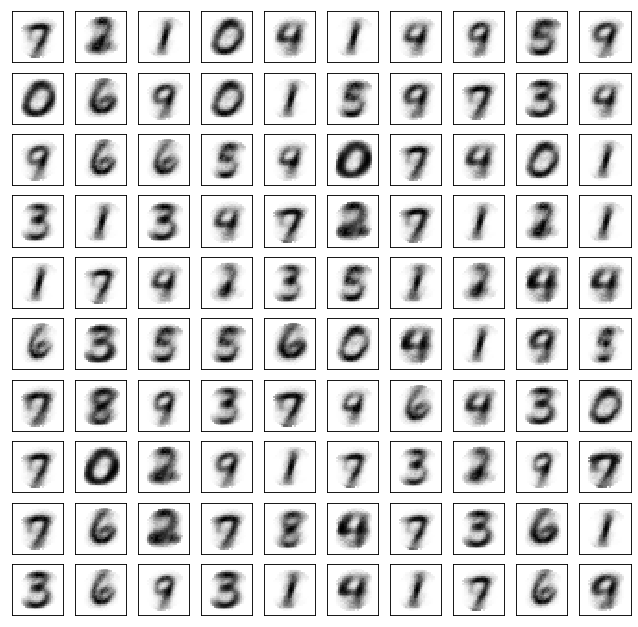

Test losses. E: 0.7870, AE: 0.2016, D: 0.6888
Train Epoch: 7 [0/50000 (0%)]	Losses E: 0.8702, AE: 0.2002, D: 0.6849
Train Epoch: 7 [25000/50000 (50%)]	Losses E: 0.6493, AE: 0.2076, D: 0.7483
Train Epoch: 7 [50000/50000 (100%)]	Losses E: 0.6035, AE: 0.1927, D: 0.6981
	generation


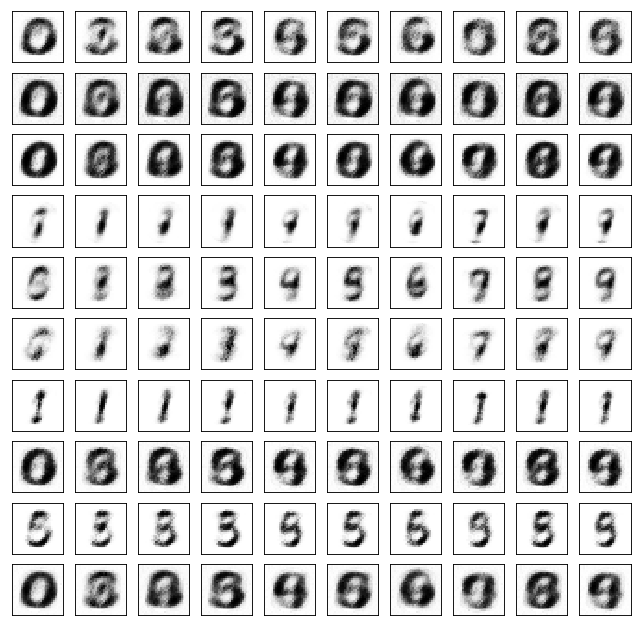

	reconstruction


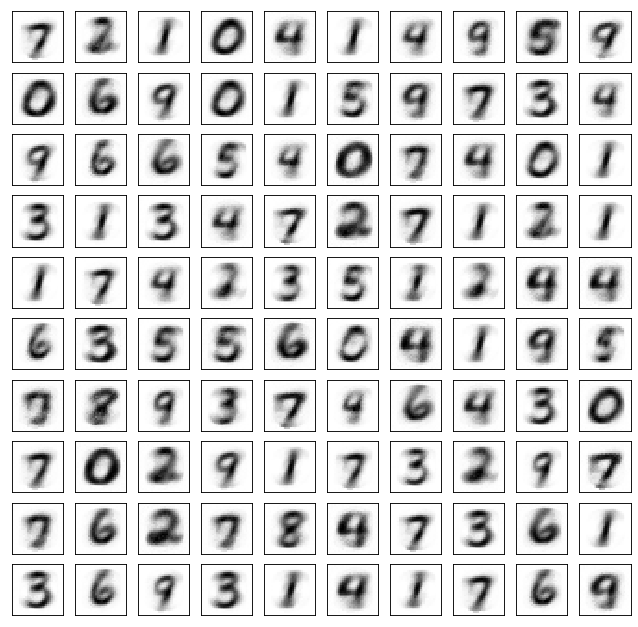

Test losses. E: 0.6030, AE: 0.1899, D: 0.6959
Train Epoch: 8 [0/50000 (0%)]	Losses E: 0.6034, AE: 0.1902, D: 0.7029
Train Epoch: 8 [25000/50000 (50%)]	Losses E: 0.4851, AE: 0.1839, D: 0.8406
Train Epoch: 8 [50000/50000 (100%)]	Losses E: 0.6953, AE: 0.1808, D: 0.7514
	generation


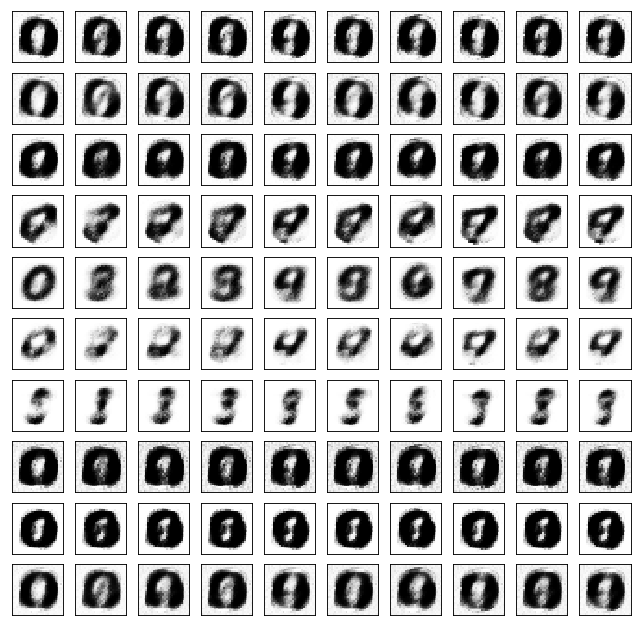

	reconstruction


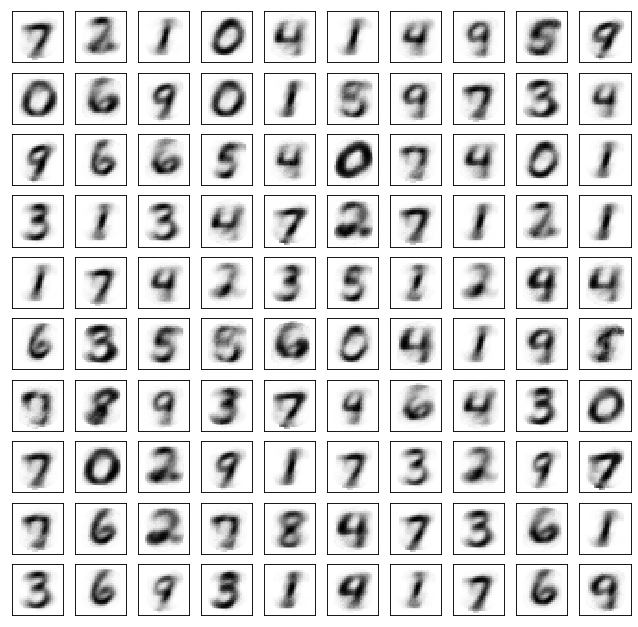

Test losses. E: 0.6920, AE: 0.1764, D: 0.7460
Train Epoch: 9 [0/50000 (0%)]	Losses E: 0.6926, AE: 0.1817, D: 0.7518
Train Epoch: 9 [25000/50000 (50%)]	Losses E: 0.5717, AE: 0.1685, D: 0.7260
Train Epoch: 9 [50000/50000 (100%)]	Losses E: 0.6200, AE: 0.1693, D: 0.6939
	generation


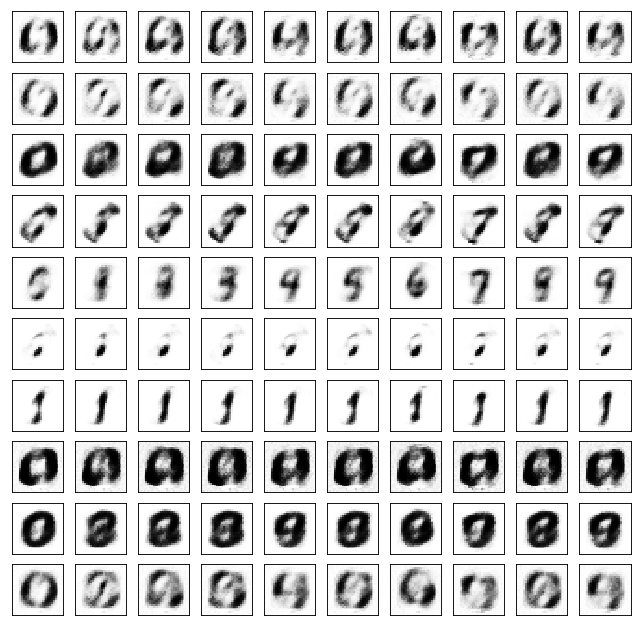

	reconstruction


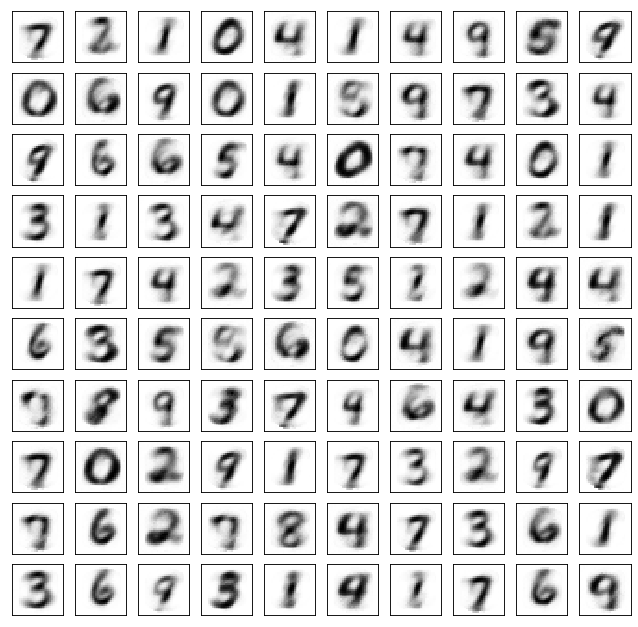

Test losses. E: 0.6182, AE: 0.1680, D: 0.6915
Train Epoch: 10 [0/50000 (0%)]	Losses E: 0.6182, AE: 0.1681, D: 0.6933
Train Epoch: 10 [25000/50000 (50%)]	Losses E: 0.4673, AE: 0.1722, D: 0.8664
Train Epoch: 10 [50000/50000 (100%)]	Losses E: 0.6645, AE: 0.1650, D: 0.7539
	generation


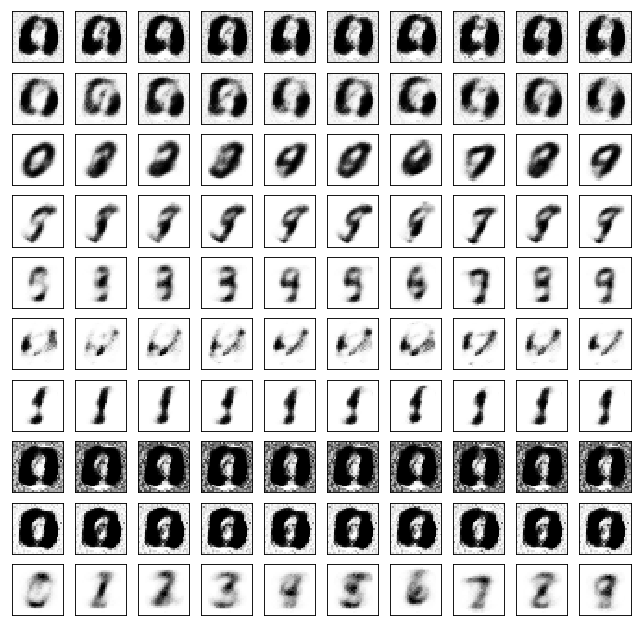

	reconstruction


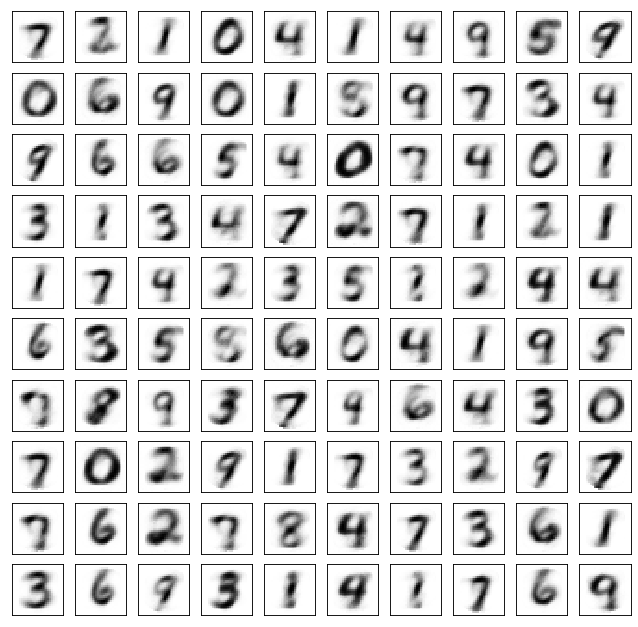

Test losses. E: 0.6646, AE: 0.1623, D: 0.7521
Train Epoch: 11 [0/50000 (0%)]	Losses E: 0.6642, AE: 0.1620, D: 0.7551
Train Epoch: 11 [25000/50000 (50%)]	Losses E: 0.6741, AE: 0.1529, D: 0.6915
Train Epoch: 11 [50000/50000 (100%)]	Losses E: 0.6960, AE: 0.1580, D: 0.6861
	generation


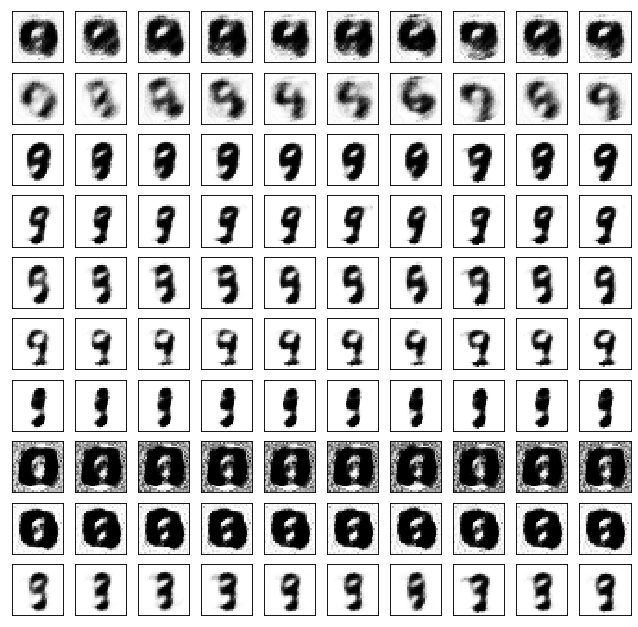

	reconstruction


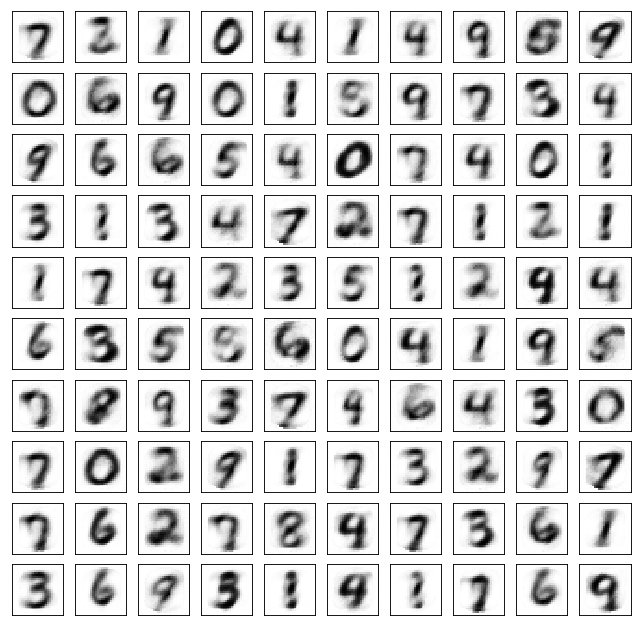

Test losses. E: 0.6834, AE: 0.1623, D: 0.6847
Train Epoch: 12 [0/50000 (0%)]	Losses E: 0.6910, AE: 0.1622, D: 0.6831
Train Epoch: 12 [25000/50000 (50%)]	Losses E: 0.7050, AE: 0.1597, D: 0.7161
Train Epoch: 12 [50000/50000 (100%)]	Losses E: 0.6727, AE: 0.1552, D: 0.7147
	generation


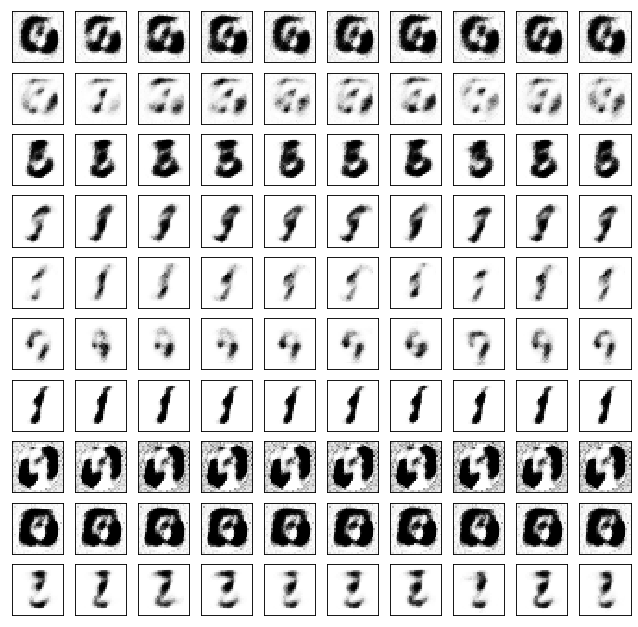

	reconstruction


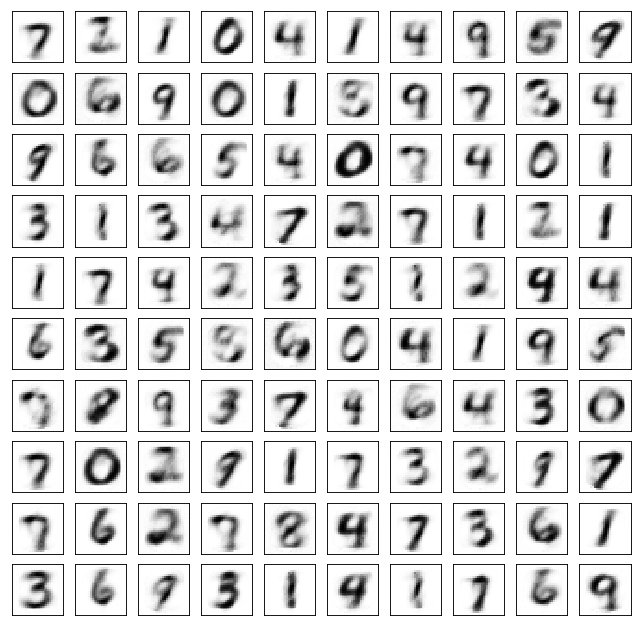

Test losses. E: 0.6717, AE: 0.1507, D: 0.7122
Train Epoch: 13 [0/50000 (0%)]	Losses E: 0.6704, AE: 0.1490, D: 0.7137
Train Epoch: 13 [25000/50000 (50%)]	Losses E: 0.6507, AE: 0.1364, D: 0.6840
Train Epoch: 13 [50000/50000 (100%)]	Losses E: 0.6256, AE: 0.1640, D: 0.7720
	generation


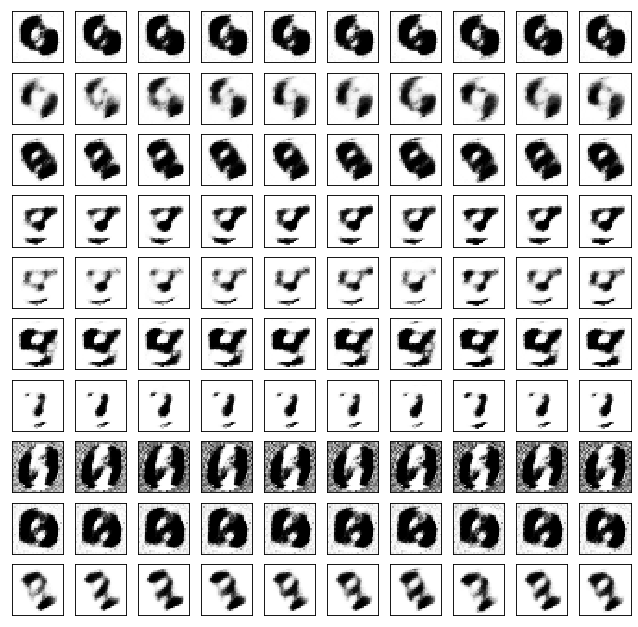

	reconstruction


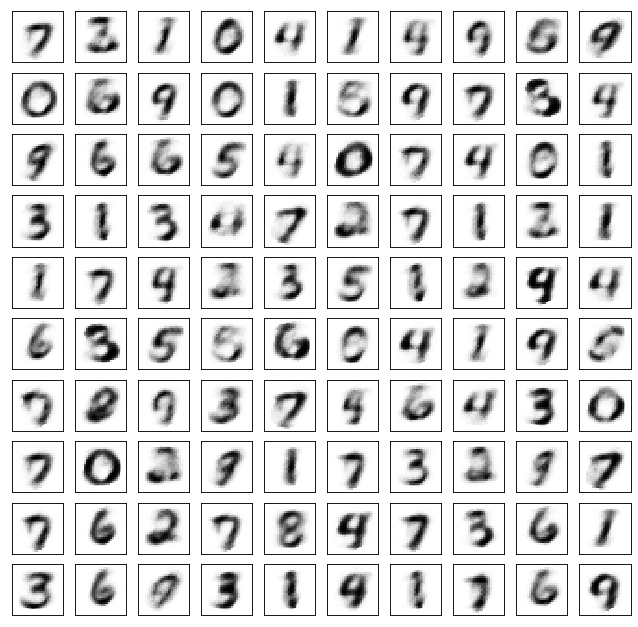

Test losses. E: 0.6204, AE: 0.1588, D: 0.7722
Train Epoch: 14 [0/50000 (0%)]	Losses E: 0.6258, AE: 0.1573, D: 0.7722
Train Epoch: 14 [25000/50000 (50%)]	Losses E: 0.6719, AE: 0.1456, D: 0.7236
Train Epoch: 14 [50000/50000 (100%)]	Losses E: 0.6735, AE: 0.1385, D: 0.6823
	generation


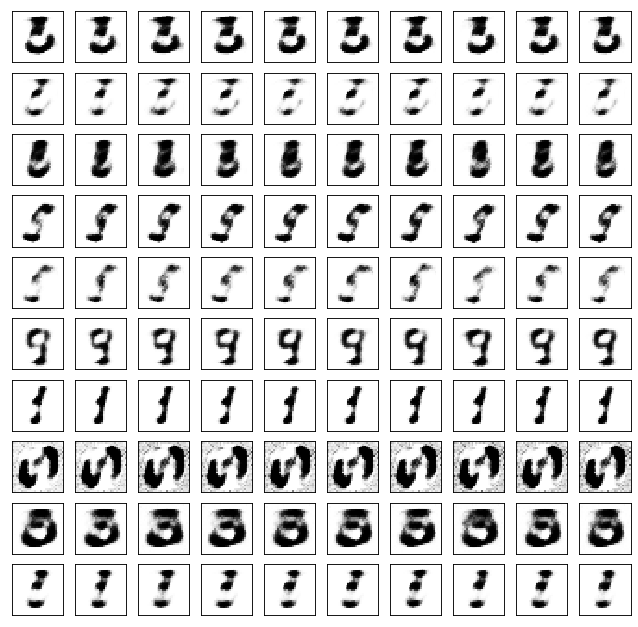

	reconstruction


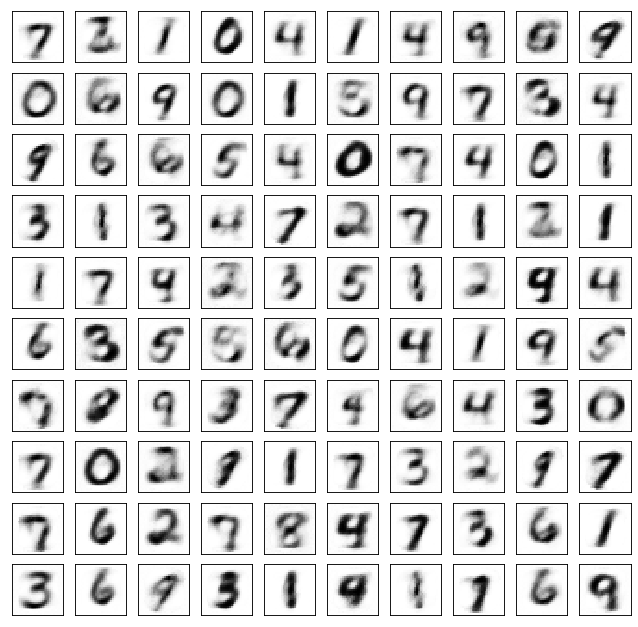

Test losses. E: 0.6711, AE: 0.1395, D: 0.6812
Train Epoch: 15 [0/50000 (0%)]	Losses E: 0.6719, AE: 0.1391, D: 0.6824
Train Epoch: 15 [25000/50000 (50%)]	Losses E: 0.6958, AE: 0.1581, D: 0.7124
Train Epoch: 15 [50000/50000 (100%)]	Losses E: 0.7005, AE: 0.1370, D: 0.7309
	generation


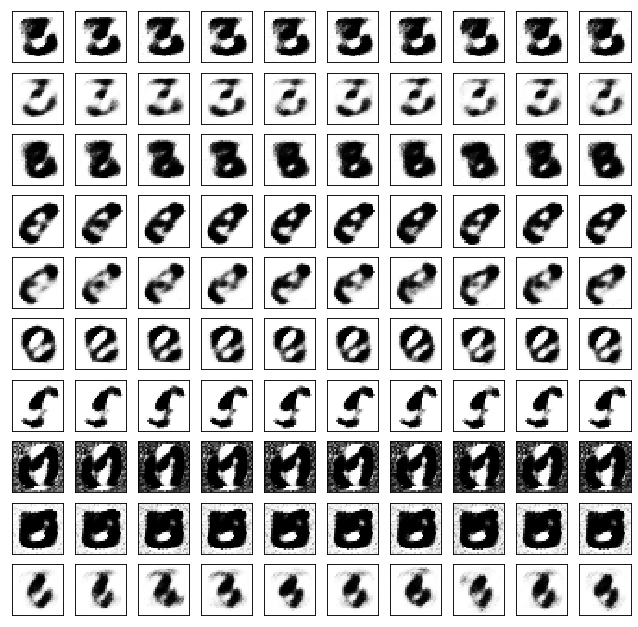

	reconstruction


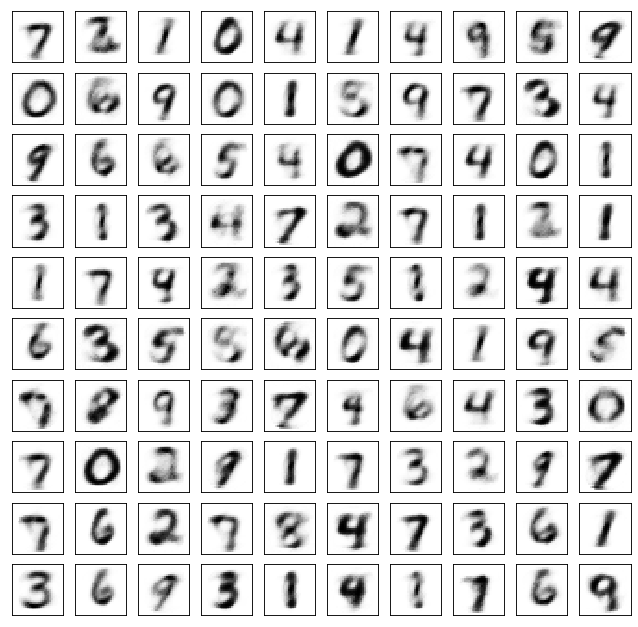

Test losses. E: 0.7010, AE: 0.1387, D: 0.7291
Train Epoch: 16 [0/50000 (0%)]	Losses E: 0.7008, AE: 0.1304, D: 0.7329
Train Epoch: 16 [25000/50000 (50%)]	Losses E: 0.7152, AE: 0.1374, D: 0.6744
Train Epoch: 16 [50000/50000 (100%)]	Losses E: 0.5475, AE: 0.1483, D: 0.7992
	generation


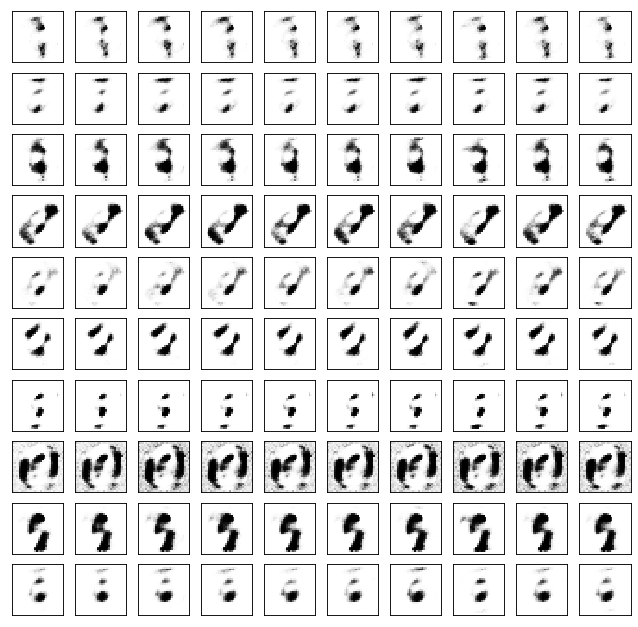

	reconstruction


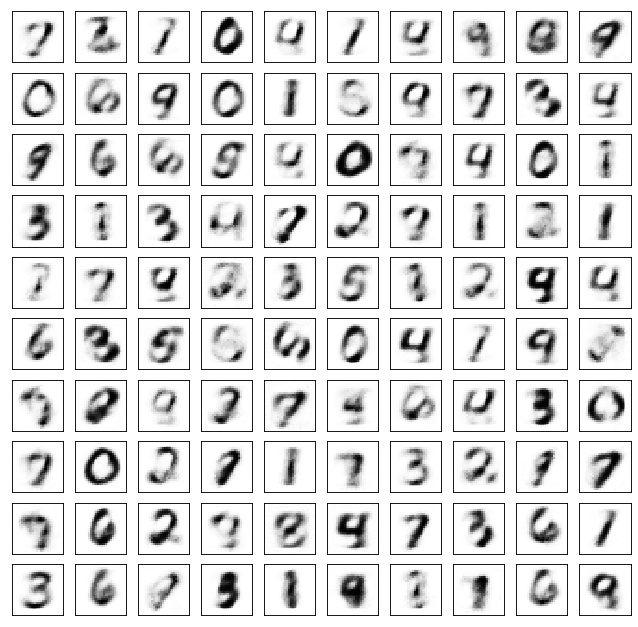

Test losses. E: 0.5250, AE: 0.1475, D: 0.7954
Train Epoch: 17 [0/50000 (0%)]	Losses E: 0.5340, AE: 0.1492, D: 0.7962
Train Epoch: 17 [25000/50000 (50%)]	Losses E: 0.6929, AE: 0.1318, D: 0.7150
Train Epoch: 17 [50000/50000 (100%)]	Losses E: 0.6849, AE: 0.1329, D: 0.6922
	generation


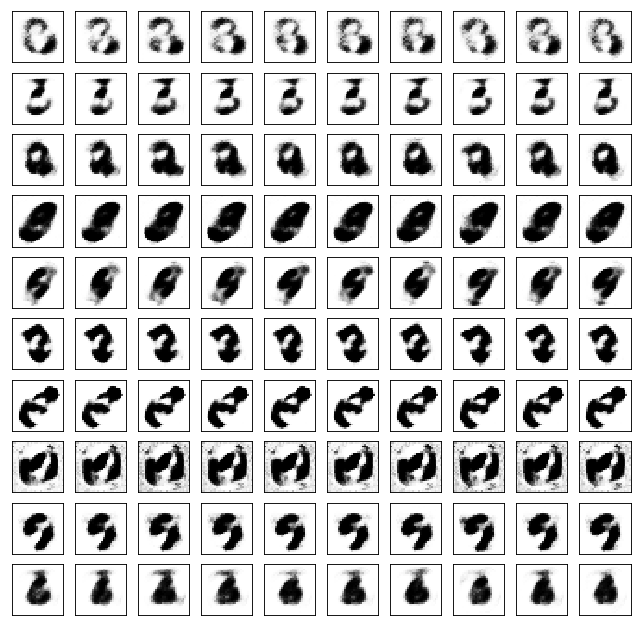

	reconstruction


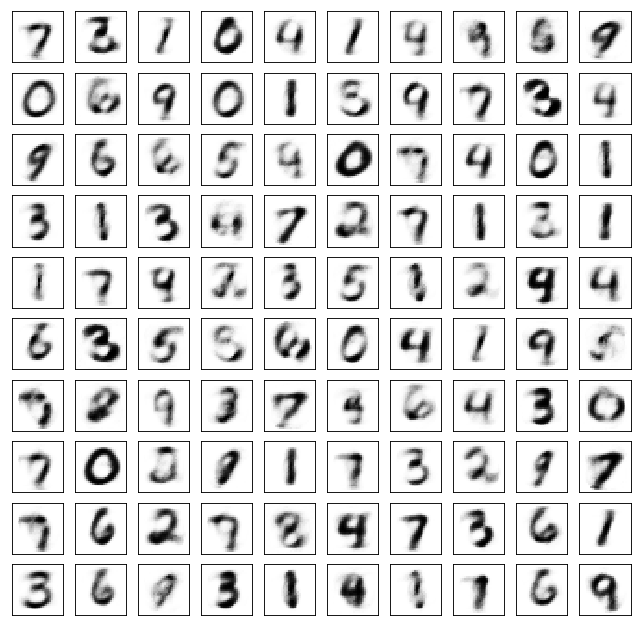

Test losses. E: 0.6830, AE: 0.1329, D: 0.6883
Train Epoch: 18 [0/50000 (0%)]	Losses E: 0.6870, AE: 0.1295, D: 0.6891
Train Epoch: 18 [25000/50000 (50%)]	Losses E: 0.6528, AE: 0.1349, D: 0.7272
Train Epoch: 18 [50000/50000 (100%)]	Losses E: 0.7112, AE: 0.1362, D: 0.7120
	generation


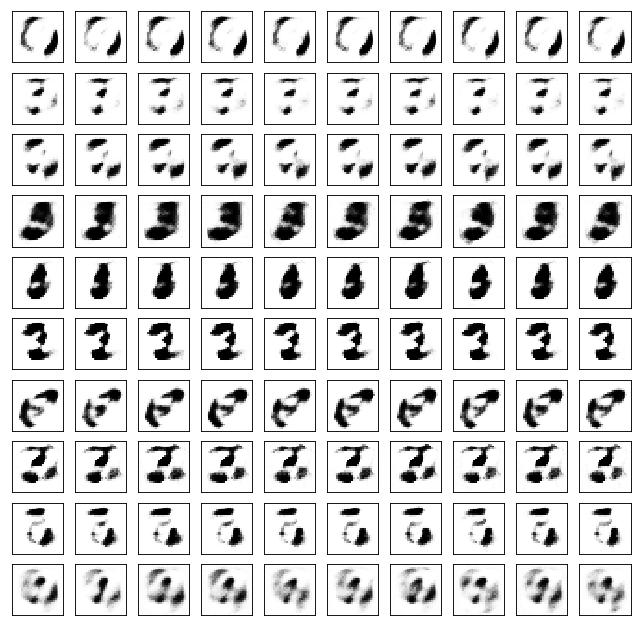

	reconstruction


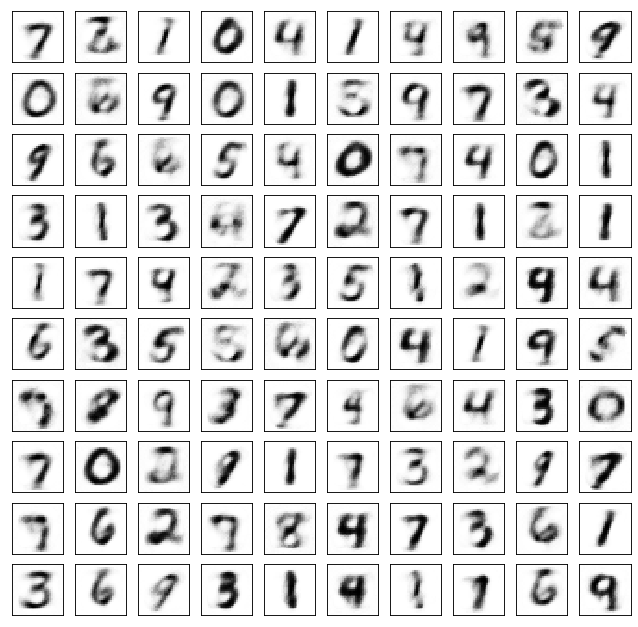

Test losses. E: 0.7095, AE: 0.1306, D: 0.7081
Train Epoch: 19 [0/50000 (0%)]	Losses E: 0.7121, AE: 0.1301, D: 0.7102
Train Epoch: 19 [25000/50000 (50%)]	Losses E: 0.7796, AE: 0.1296, D: 0.6647
Train Epoch: 19 [50000/50000 (100%)]	Losses E: 0.6859, AE: 0.1316, D: 0.6986
	generation


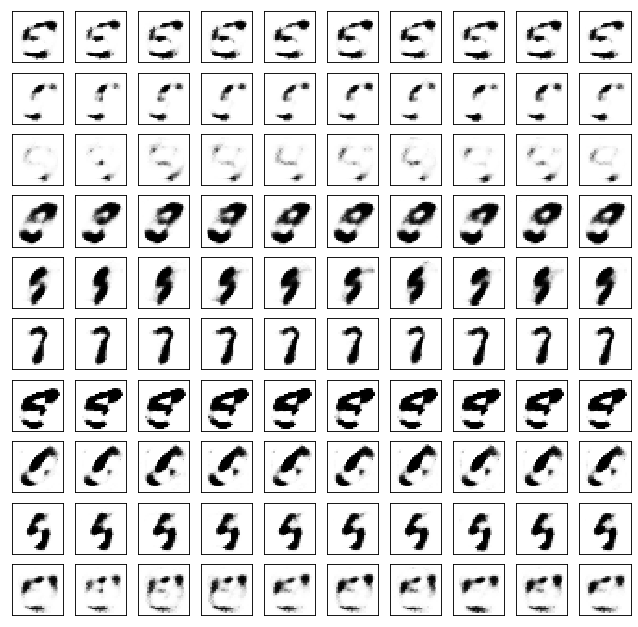

	reconstruction


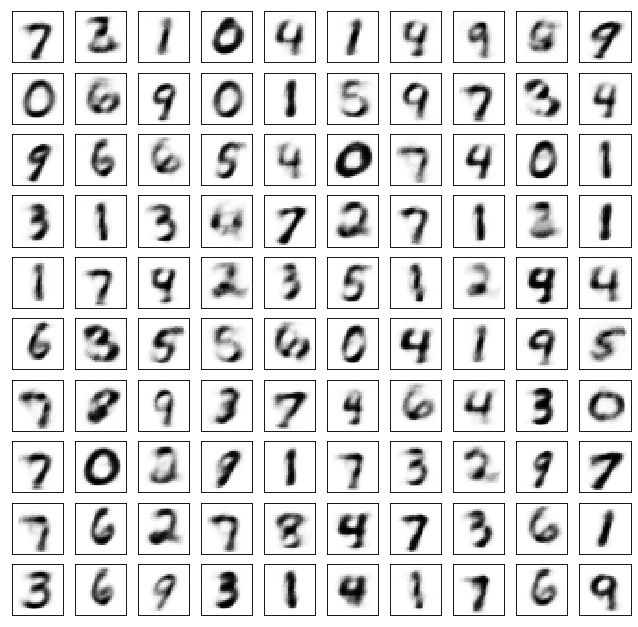

Test losses. E: 0.6797, AE: 0.1279, D: 0.6990
Train Epoch: 20 [0/50000 (0%)]	Losses E: 0.6817, AE: 0.1321, D: 0.7033
Train Epoch: 20 [25000/50000 (50%)]	Losses E: 0.6448, AE: 0.1272, D: 0.7184
Train Epoch: 20 [50000/50000 (100%)]	Losses E: 1.0978, AE: 0.1586, D: 0.6083
	generation


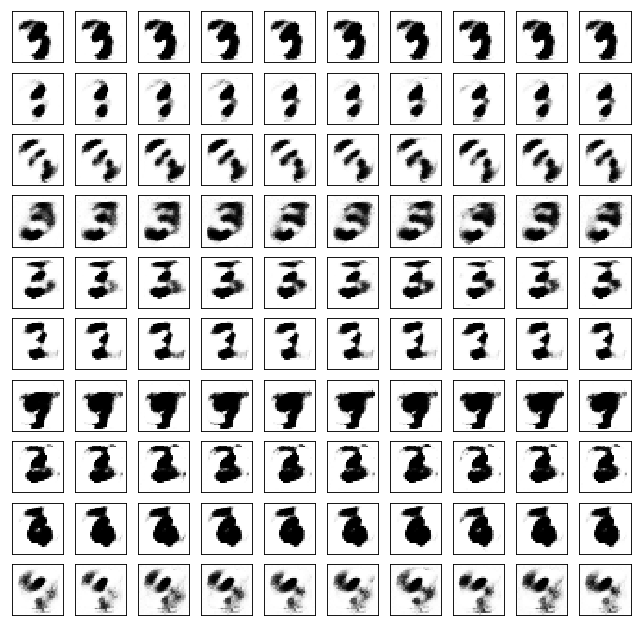

	reconstruction


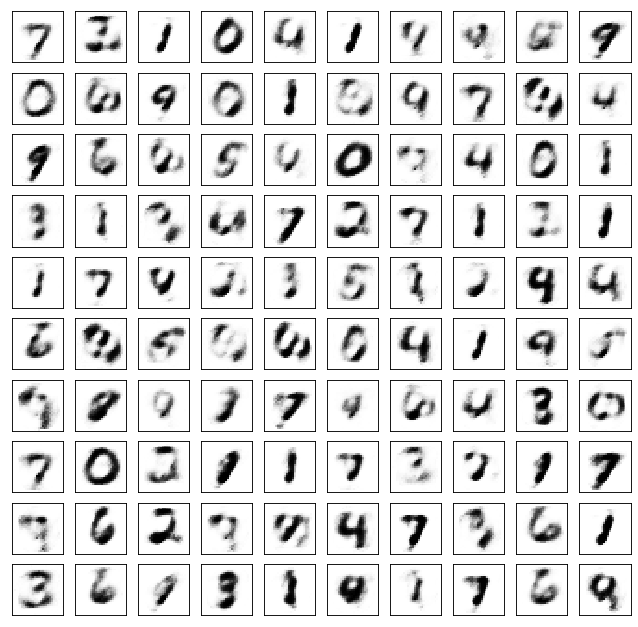

Test losses. E: 0.9715, AE: 0.1623, D: 0.6219
Train Epoch: 21 [0/50000 (0%)]	Losses E: 1.0421, AE: 0.1665, D: 0.6192
Train Epoch: 21 [25000/50000 (50%)]	Losses E: 0.6914, AE: 0.1240, D: 0.7087
Train Epoch: 21 [50000/50000 (100%)]	Losses E: 0.7133, AE: 0.1183, D: 0.6750
	generation


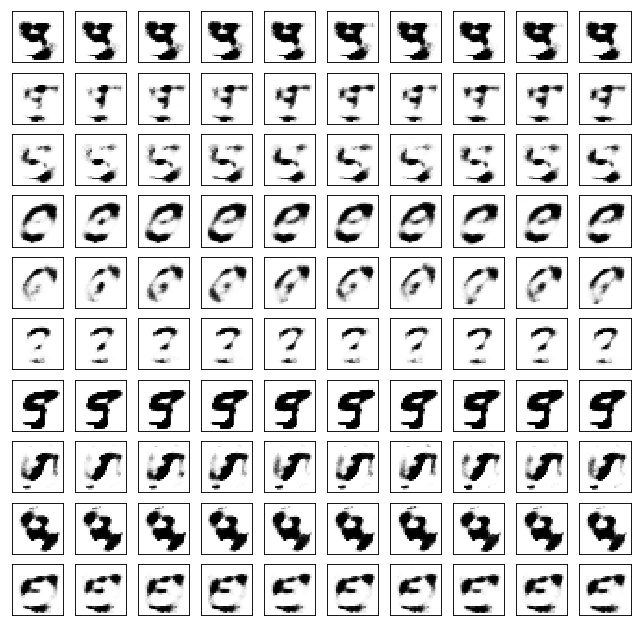

	reconstruction


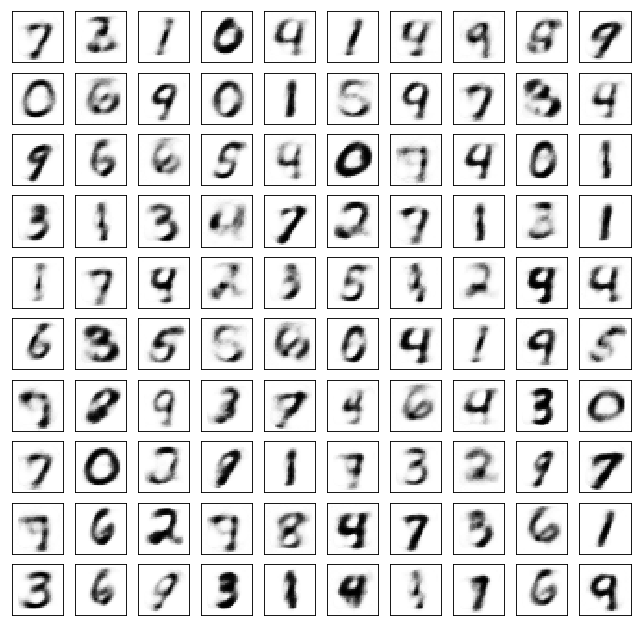

Test losses. E: 0.7104, AE: 0.1234, D: 0.6707
Train Epoch: 22 [0/50000 (0%)]	Losses E: 0.7124, AE: 0.1286, D: 0.6733
Train Epoch: 22 [25000/50000 (50%)]	Losses E: 0.6564, AE: 0.1468, D: 0.7435
Train Epoch: 22 [50000/50000 (100%)]	Losses E: 0.6657, AE: 0.1170, D: 0.6946
	generation


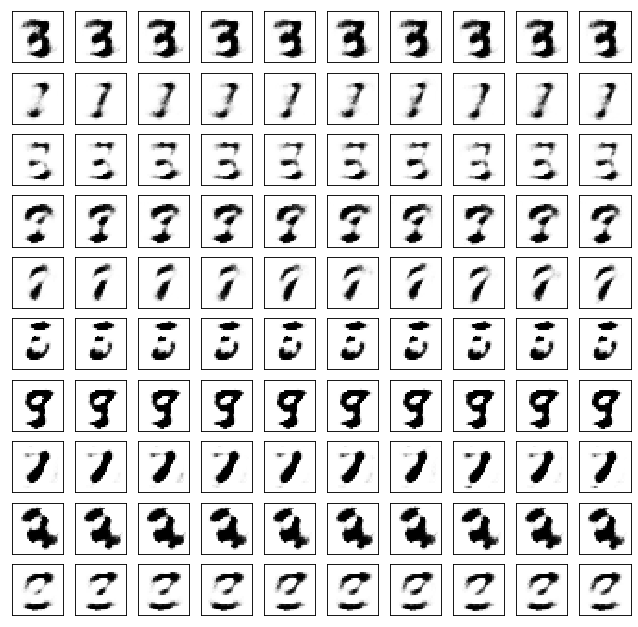

	reconstruction


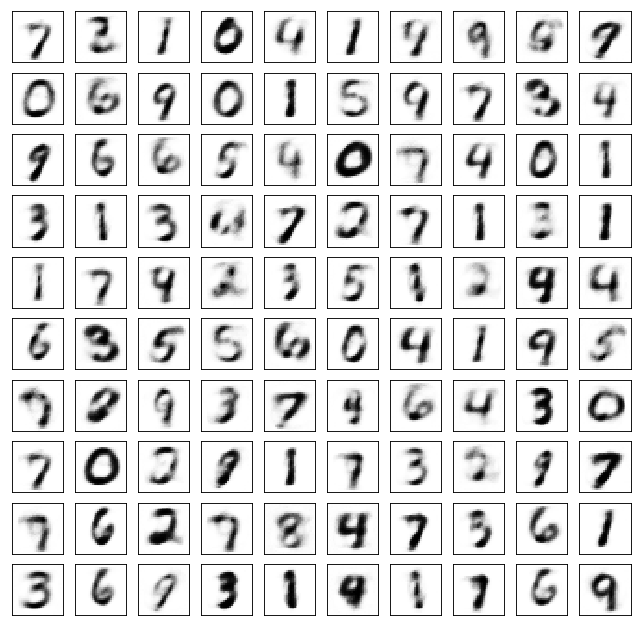

Test losses. E: 0.6634, AE: 0.1219, D: 0.6935
Train Epoch: 23 [0/50000 (0%)]	Losses E: 0.6665, AE: 0.1294, D: 0.6925
Train Epoch: 23 [25000/50000 (50%)]	Losses E: 0.7270, AE: 0.1571, D: 0.7129
Train Epoch: 23 [50000/50000 (100%)]	Losses E: 0.6920, AE: 0.1218, D: 0.6928
	generation


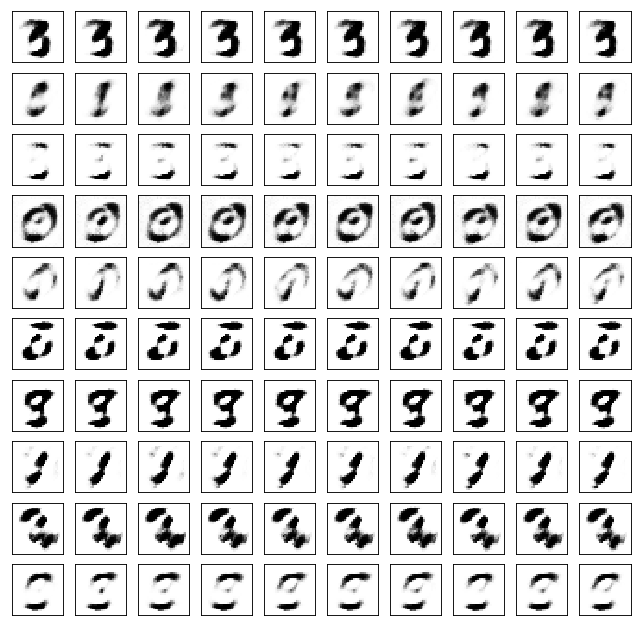

	reconstruction


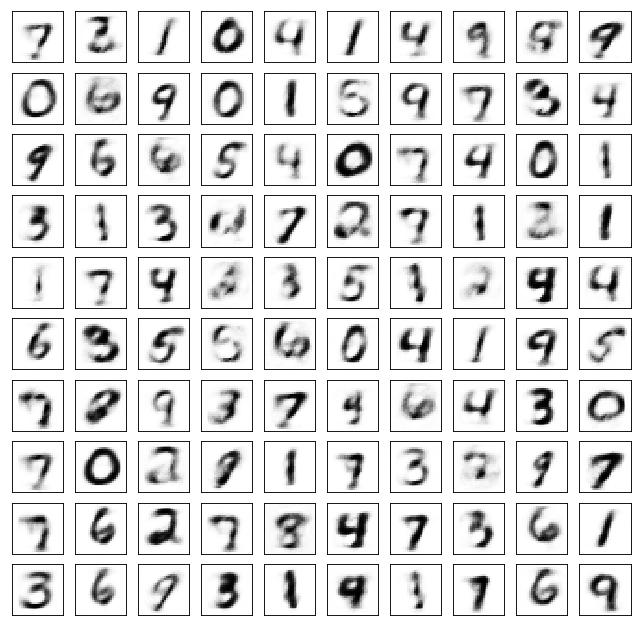

Test losses. E: 0.6909, AE: 0.1223, D: 0.6928
Train Epoch: 24 [0/50000 (0%)]	Losses E: 0.6920, AE: 0.1186, D: 0.6925
Train Epoch: 24 [25000/50000 (50%)]	Losses E: 0.6950, AE: 0.1321, D: 0.7048
Train Epoch: 24 [50000/50000 (100%)]	Losses E: 0.6882, AE: 0.1267, D: 0.6903
	generation


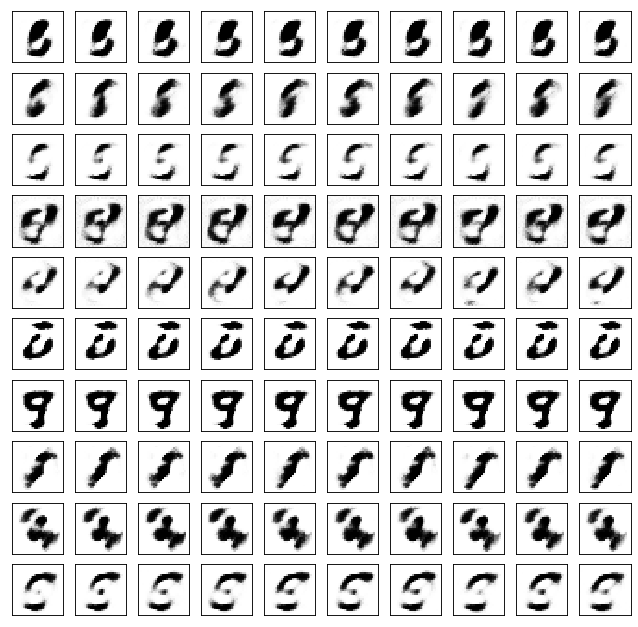

	reconstruction


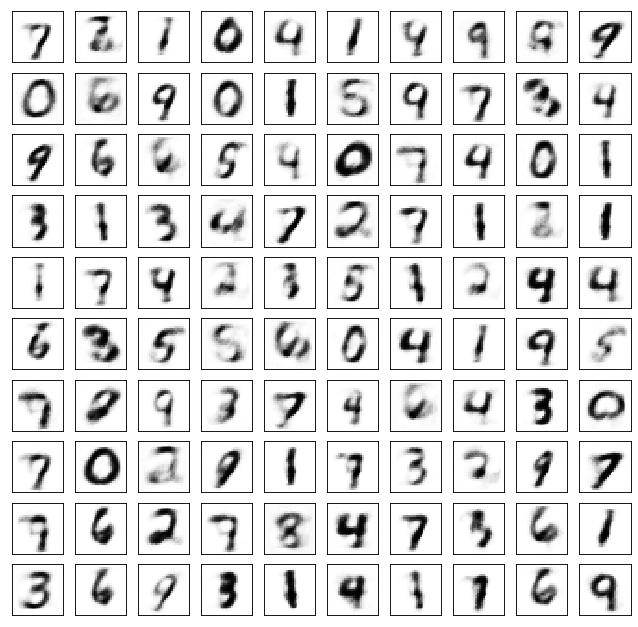

Test losses. E: 0.6834, AE: 0.1254, D: 0.6898
Train Epoch: 25 [0/50000 (0%)]	Losses E: 0.6847, AE: 0.1220, D: 0.6913
Train Epoch: 25 [25000/50000 (50%)]	Losses E: 0.6929, AE: 0.1297, D: 0.7227
Train Epoch: 25 [50000/50000 (100%)]	Losses E: 0.6995, AE: 0.1236, D: 0.7062
	generation


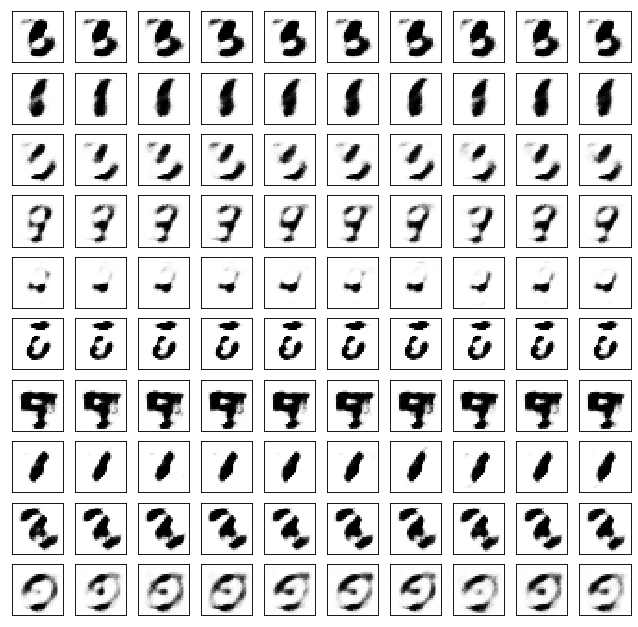

	reconstruction


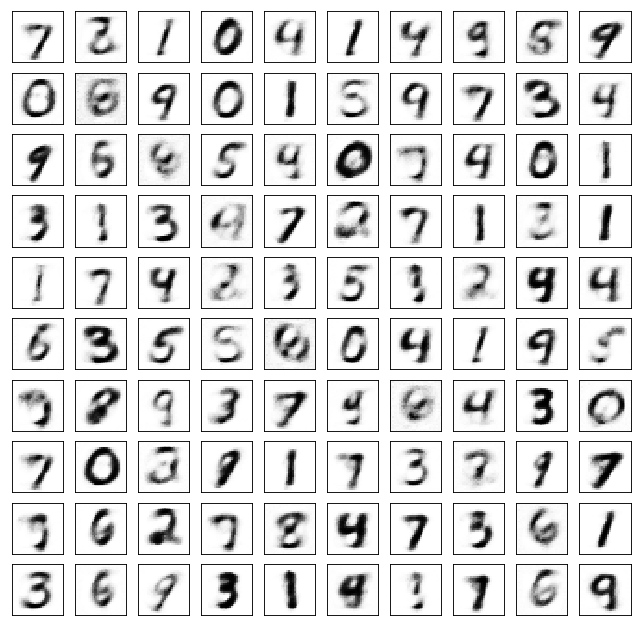

Test losses. E: 0.6930, AE: 0.1238, D: 0.7045
Train Epoch: 26 [0/50000 (0%)]	Losses E: 0.6992, AE: 0.1200, D: 0.7059
Train Epoch: 26 [25000/50000 (50%)]	Losses E: 0.7012, AE: 0.1127, D: 0.6812
Train Epoch: 26 [50000/50000 (100%)]	Losses E: 0.7713, AE: 0.1619, D: 0.6946
	generation


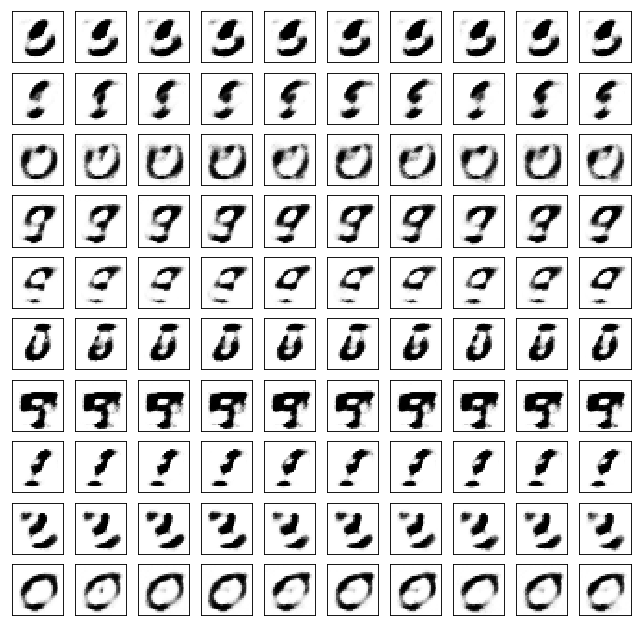

	reconstruction


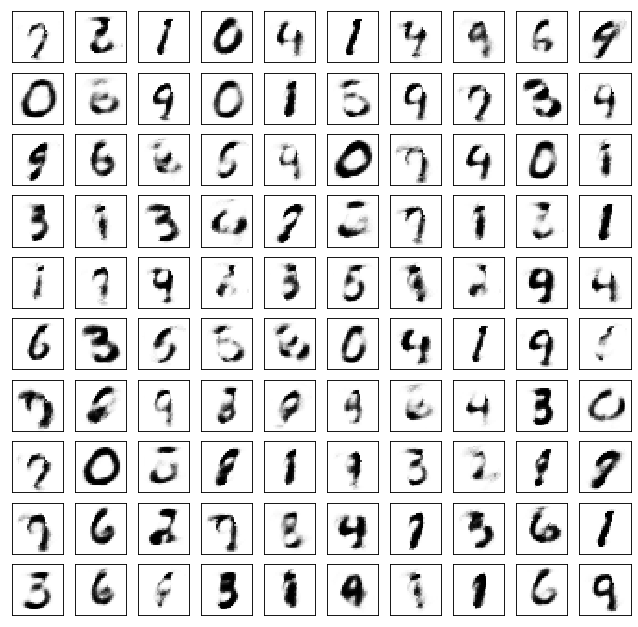

Test losses. E: 0.7561, AE: 0.1632, D: 0.6946
Train Epoch: 27 [0/50000 (0%)]	Losses E: 0.7685, AE: 0.1605, D: 0.6979
Train Epoch: 27 [25000/50000 (50%)]	Losses E: 0.7125, AE: 0.1083, D: 0.6925
Train Epoch: 27 [50000/50000 (100%)]	Losses E: 0.7206, AE: 0.1116, D: 0.6727
	generation


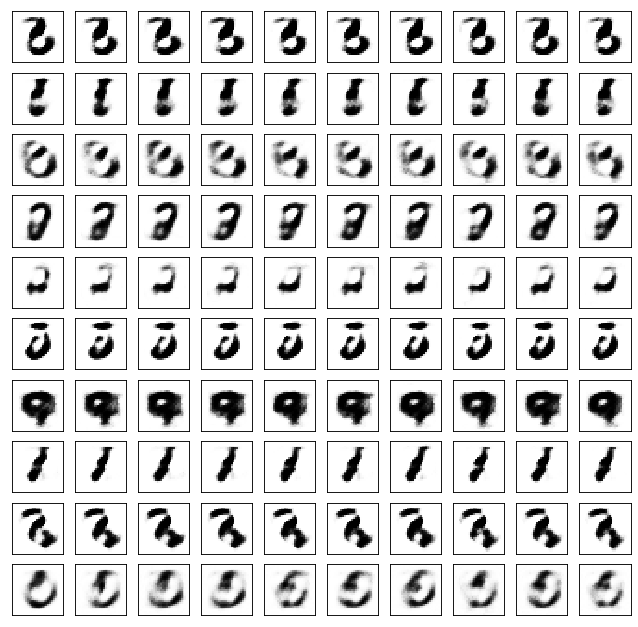

	reconstruction


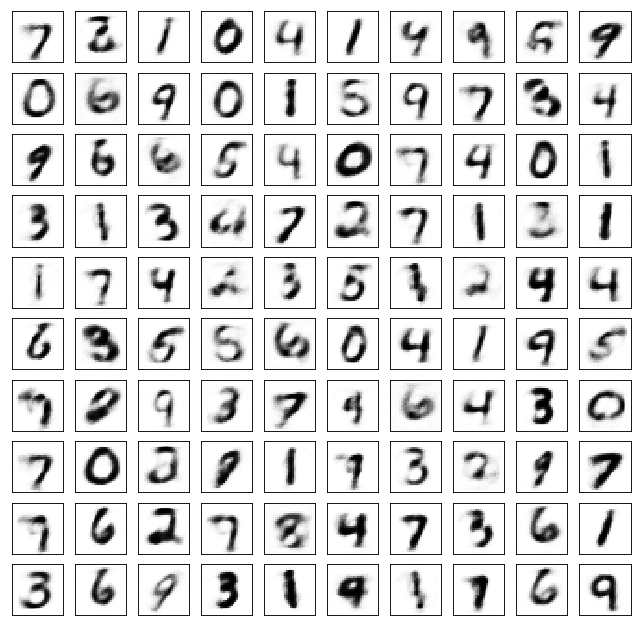

Test losses. E: 0.7157, AE: 0.1098, D: 0.6747
Train Epoch: 28 [0/50000 (0%)]	Losses E: 0.7173, AE: 0.1059, D: 0.6761
Train Epoch: 28 [25000/50000 (50%)]	Losses E: 0.7158, AE: 0.1262, D: 0.7169
Train Epoch: 28 [50000/50000 (100%)]	Losses E: 0.6786, AE: 0.1013, D: 0.6938
	generation


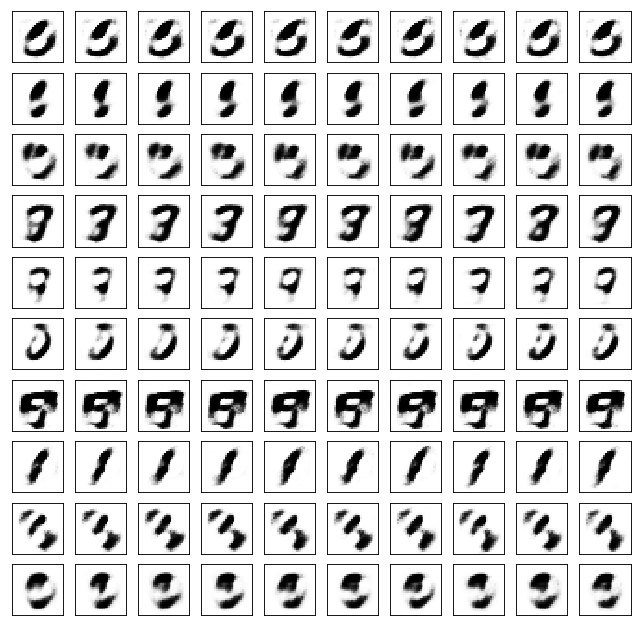

	reconstruction


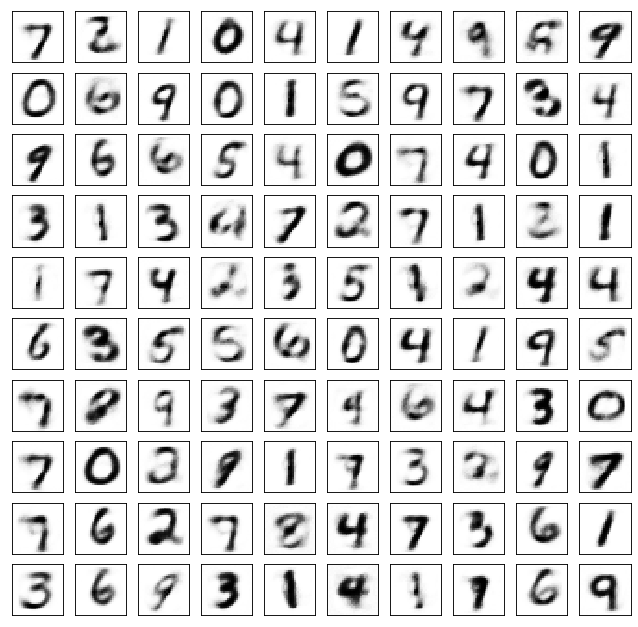

Test losses. E: 0.6785, AE: 0.1040, D: 0.6925
Train Epoch: 29 [0/50000 (0%)]	Losses E: 0.6786, AE: 0.1039, D: 0.6926
Train Epoch: 29 [25000/50000 (50%)]	Losses E: 0.6488, AE: 0.1257, D: 0.7198
Train Epoch: 29 [50000/50000 (100%)]	Losses E: 0.6906, AE: 0.1095, D: 0.7183
	generation


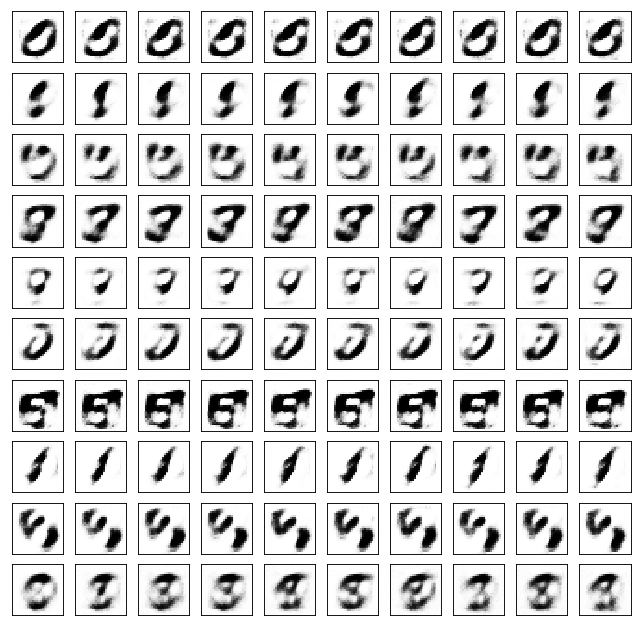

	reconstruction


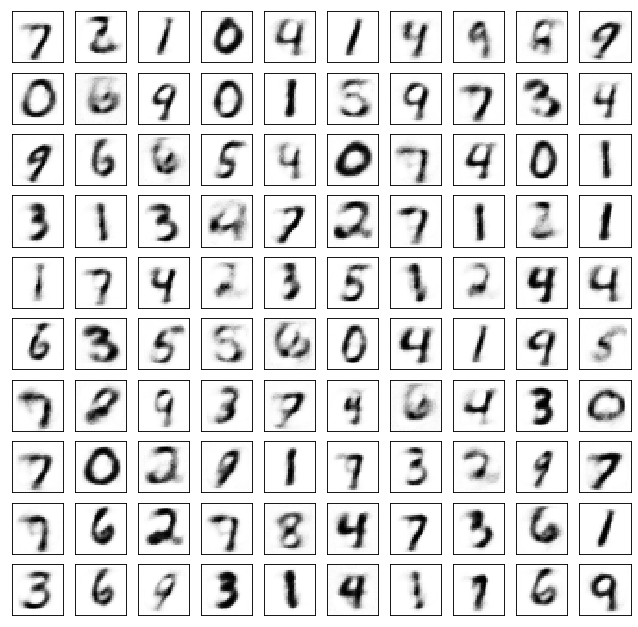

Test losses. E: 0.6897, AE: 0.1115, D: 0.7177
Train Epoch: 30 [0/50000 (0%)]	Losses E: 0.6880, AE: 0.1116, D: 0.7197
Train Epoch: 30 [25000/50000 (50%)]	Losses E: 0.6578, AE: 0.1058, D: 0.6963
Train Epoch: 30 [50000/50000 (100%)]	Losses E: 0.7848, AE: 0.1287, D: 0.6796
	generation


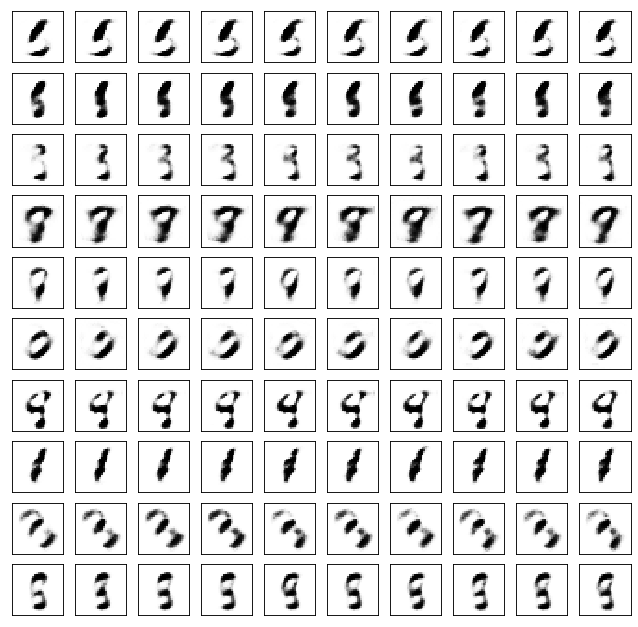

	reconstruction


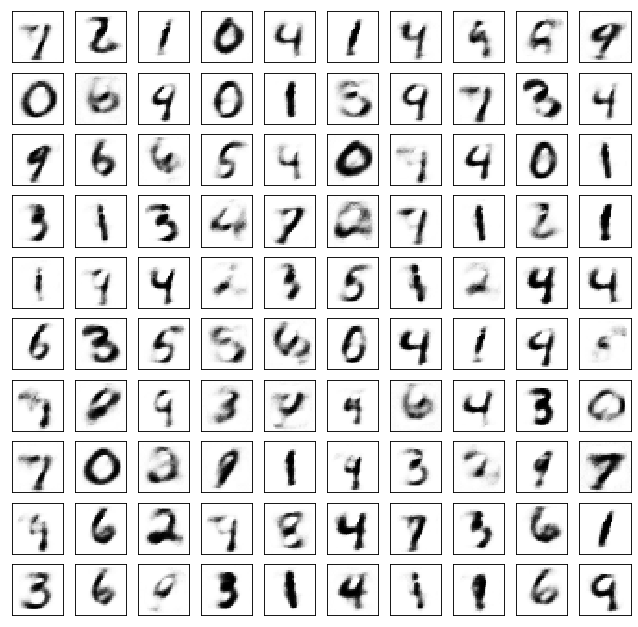

Test losses. E: 0.7692, AE: 0.1269, D: 0.6832
Train Epoch: 31 [0/50000 (0%)]	Losses E: 0.7763, AE: 0.1266, D: 0.6824
Train Epoch: 31 [25000/50000 (50%)]	Losses E: 0.6878, AE: 0.1020, D: 0.6913
Train Epoch: 31 [50000/50000 (100%)]	Losses E: 0.7142, AE: 0.1034, D: 0.6895
	generation


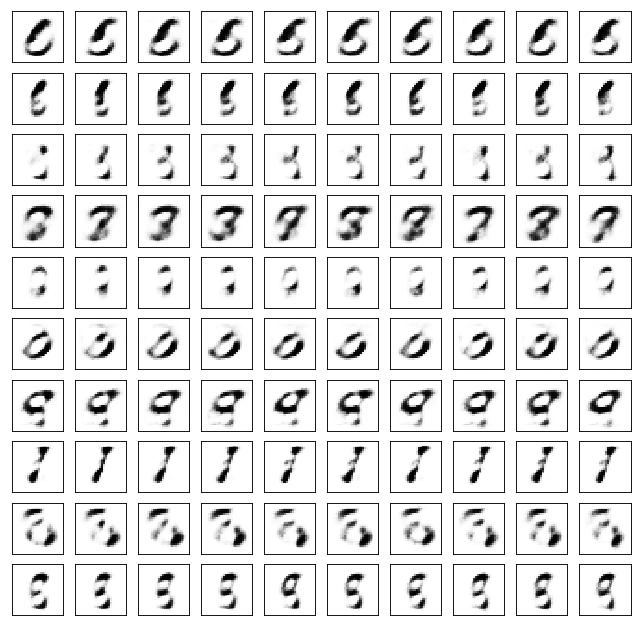

	reconstruction


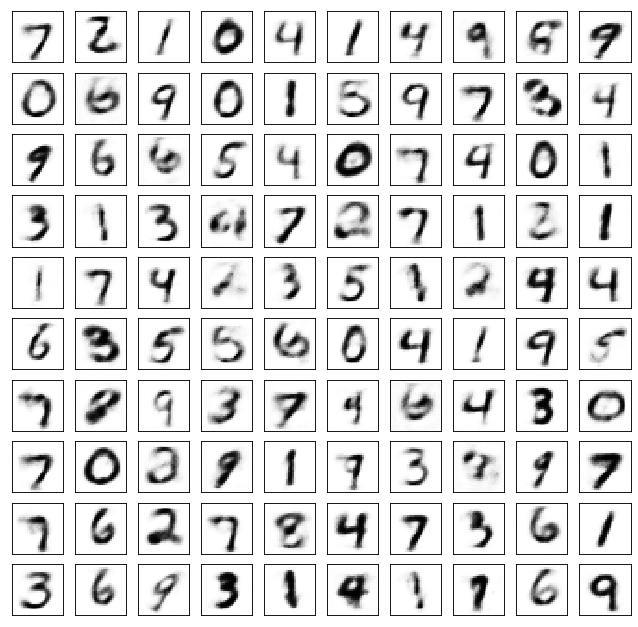

Test losses. E: 0.7173, AE: 0.1026, D: 0.6872
Train Epoch: 32 [0/50000 (0%)]	Losses E: 0.7209, AE: 0.1039, D: 0.6858
Train Epoch: 32 [25000/50000 (50%)]	Losses E: 0.7096, AE: 0.1040, D: 0.6975
Train Epoch: 32 [50000/50000 (100%)]	Losses E: 0.6871, AE: 0.0996, D: 0.6942
	generation


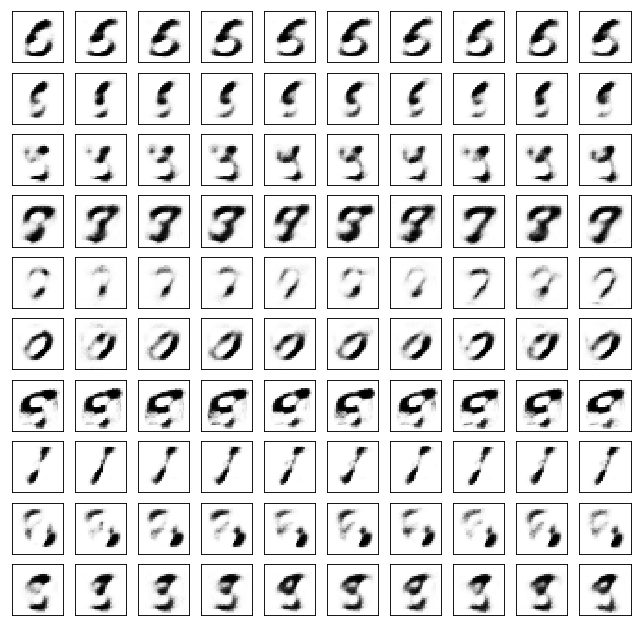

	reconstruction


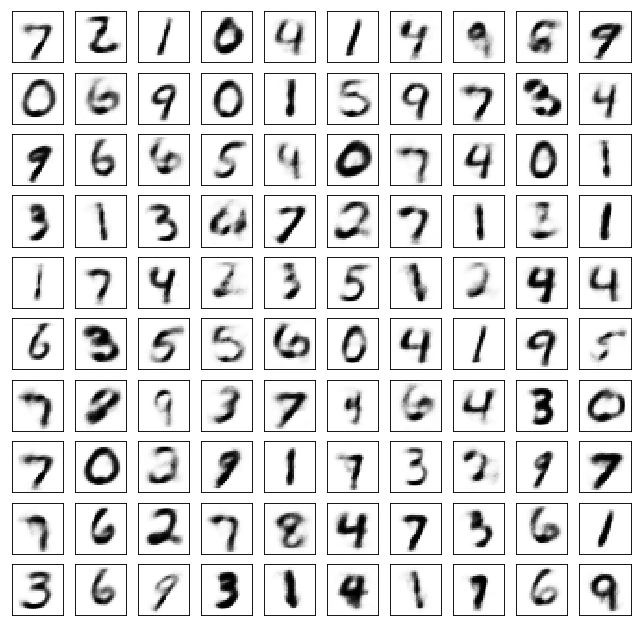

Test losses. E: 0.6835, AE: 0.0995, D: 0.6974
Train Epoch: 33 [0/50000 (0%)]	Losses E: 0.6827, AE: 0.1000, D: 0.6992
Train Epoch: 33 [25000/50000 (50%)]	Losses E: 0.6905, AE: 0.0966, D: 0.6968
Train Epoch: 33 [50000/50000 (100%)]	Losses E: 0.6821, AE: 0.1058, D: 0.6992
	generation


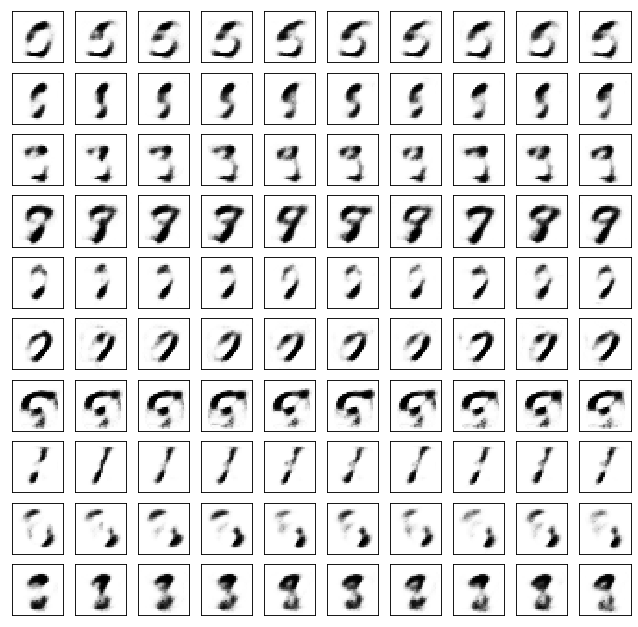

	reconstruction


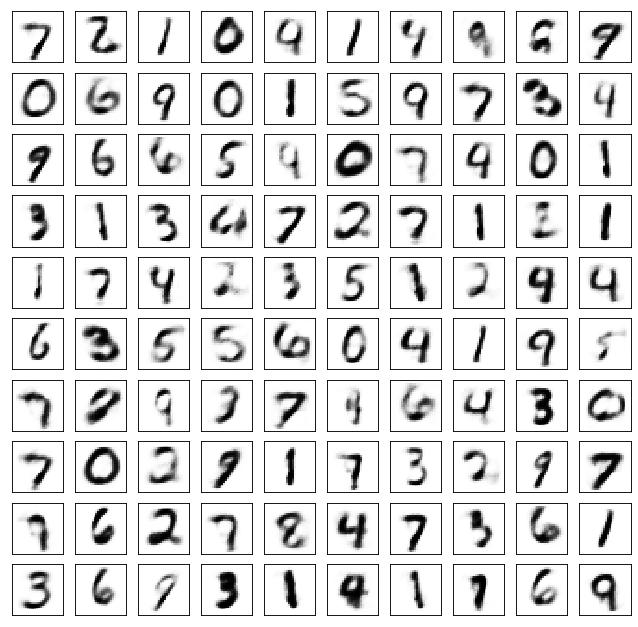

Test losses. E: 0.6773, AE: 0.1026, D: 0.7009
Train Epoch: 34 [0/50000 (0%)]	Losses E: 0.6832, AE: 0.1030, D: 0.7013
Train Epoch: 34 [25000/50000 (50%)]	Losses E: 0.6832, AE: 0.0912, D: 0.6930
Train Epoch: 34 [50000/50000 (100%)]	Losses E: 0.7003, AE: 0.1012, D: 0.7018
	generation


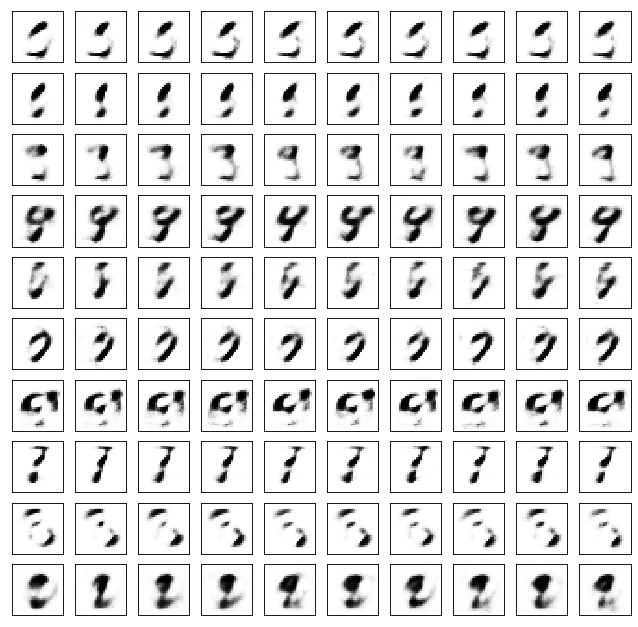

	reconstruction


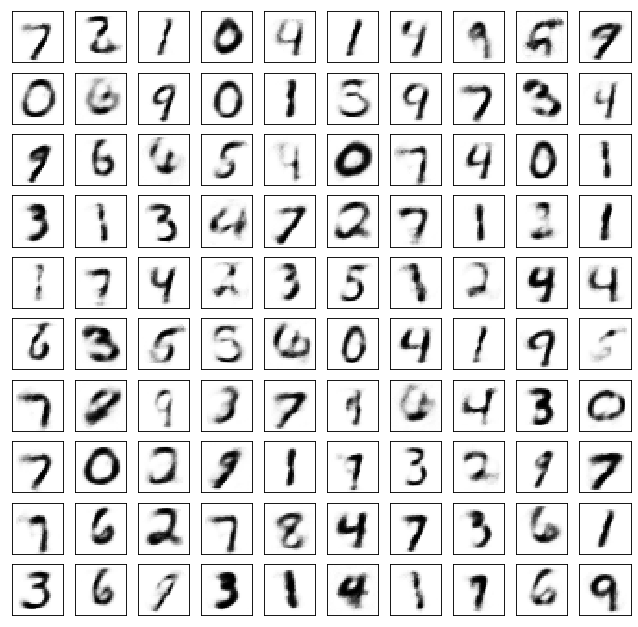

Test losses. E: 0.6945, AE: 0.1020, D: 0.7035
Train Epoch: 35 [0/50000 (0%)]	Losses E: 0.7011, AE: 0.1036, D: 0.7029
Train Epoch: 35 [25000/50000 (50%)]	Losses E: 0.6810, AE: 0.0921, D: 0.6911
Train Epoch: 35 [50000/50000 (100%)]	Losses E: 0.7042, AE: 0.0956, D: 0.6971
	generation


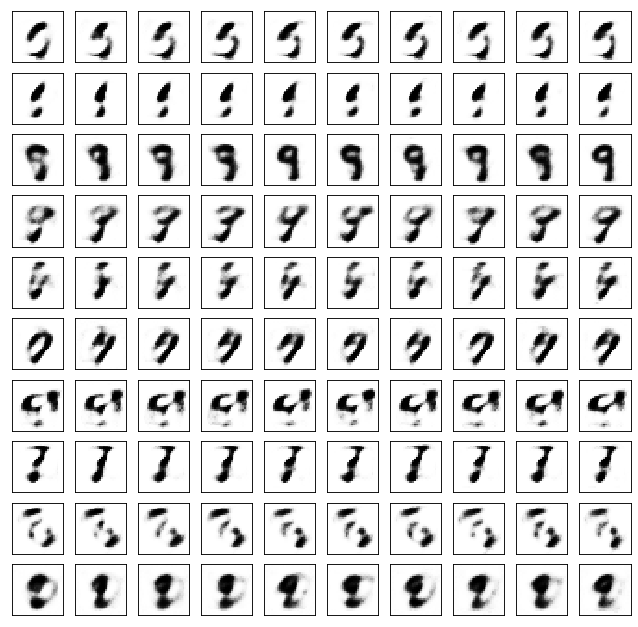

	reconstruction


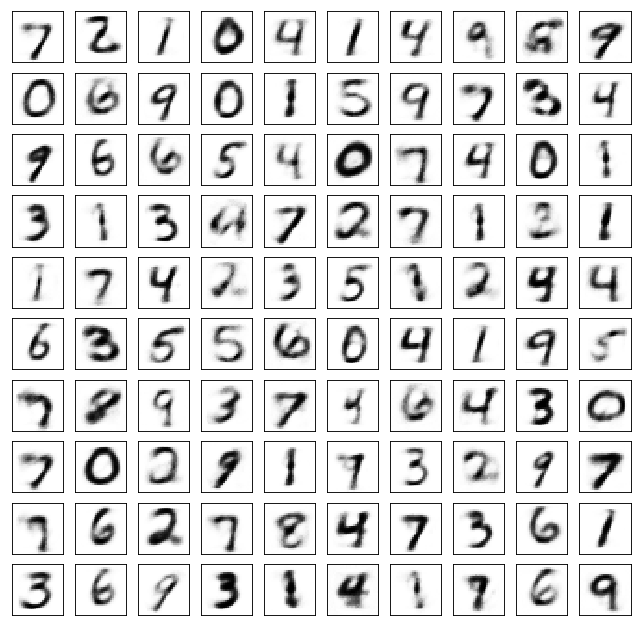

Test losses. E: 0.7017, AE: 0.0962, D: 0.6969
Train Epoch: 36 [0/50000 (0%)]	Losses E: 0.7018, AE: 0.0938, D: 0.6973
Train Epoch: 36 [25000/50000 (50%)]	Losses E: 0.7229, AE: 0.0896, D: 0.6841
Train Epoch: 36 [50000/50000 (100%)]	Losses E: 0.6821, AE: 0.0967, D: 0.6989
	generation


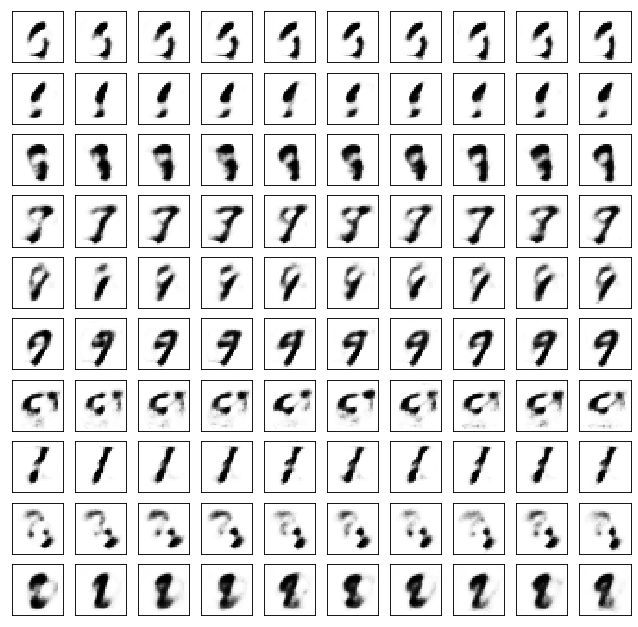

	reconstruction


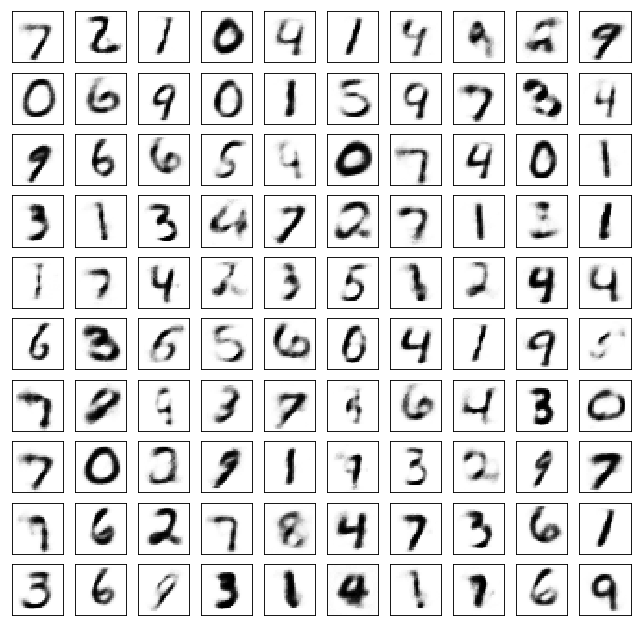

Test losses. E: 0.6823, AE: 0.0967, D: 0.6968
Train Epoch: 37 [0/50000 (0%)]	Losses E: 0.6878, AE: 0.0945, D: 0.6987
Train Epoch: 37 [25000/50000 (50%)]	Losses E: 0.7001, AE: 0.1074, D: 0.6908
Train Epoch: 37 [50000/50000 (100%)]	Losses E: 0.7079, AE: 0.1054, D: 0.6993
	generation


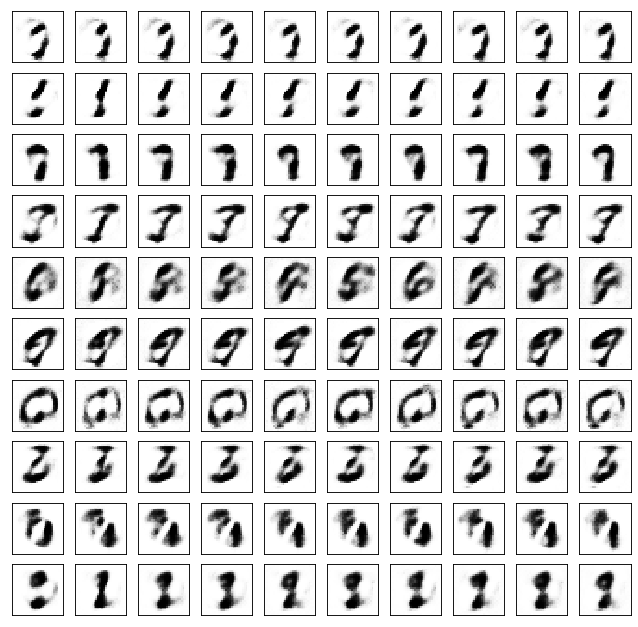

	reconstruction


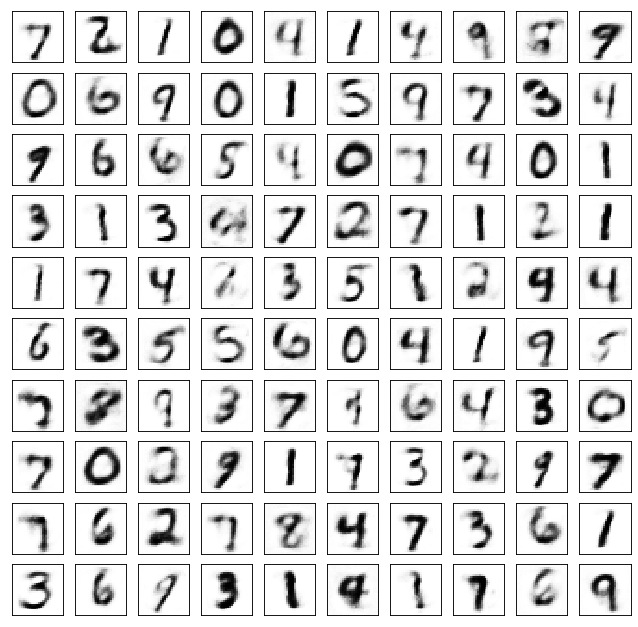

Test losses. E: 0.7036, AE: 0.1057, D: 0.6989
Train Epoch: 38 [0/50000 (0%)]	Losses E: 0.7031, AE: 0.1127, D: 0.6997
Train Epoch: 38 [25000/50000 (50%)]	Losses E: 0.6773, AE: 0.1001, D: 0.6975
Train Epoch: 38 [50000/50000 (100%)]	Losses E: 0.6908, AE: 0.1050, D: 0.7015
	generation


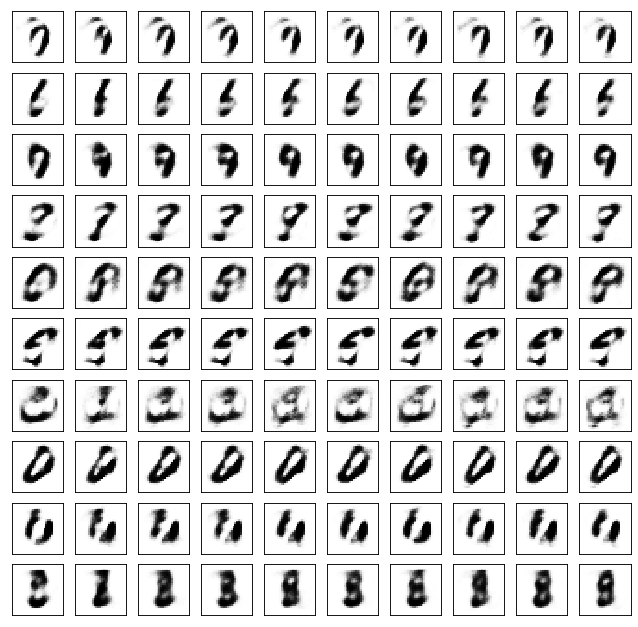

	reconstruction


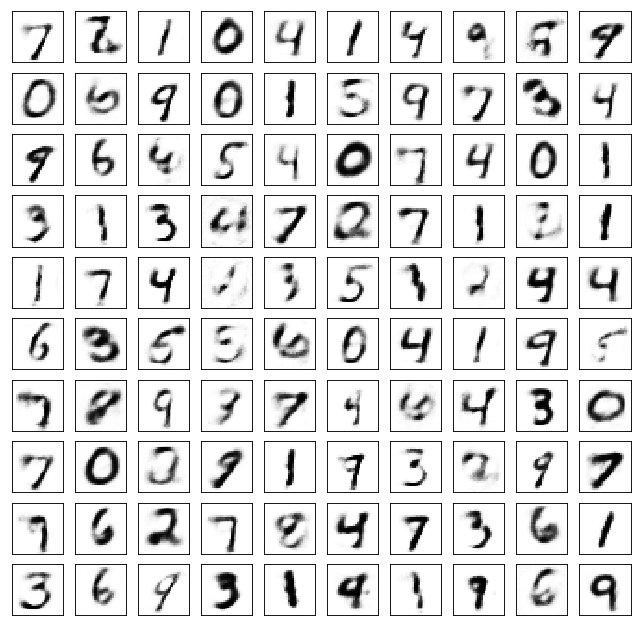

Test losses. E: 0.6917, AE: 0.1061, D: 0.6992
Train Epoch: 39 [0/50000 (0%)]	Losses E: 0.7017, AE: 0.1062, D: 0.6976
Train Epoch: 39 [25000/50000 (50%)]	Losses E: 0.6876, AE: 0.0937, D: 0.6938
Train Epoch: 39 [50000/50000 (100%)]	Losses E: 0.7118, AE: 0.1044, D: 0.6905
	generation


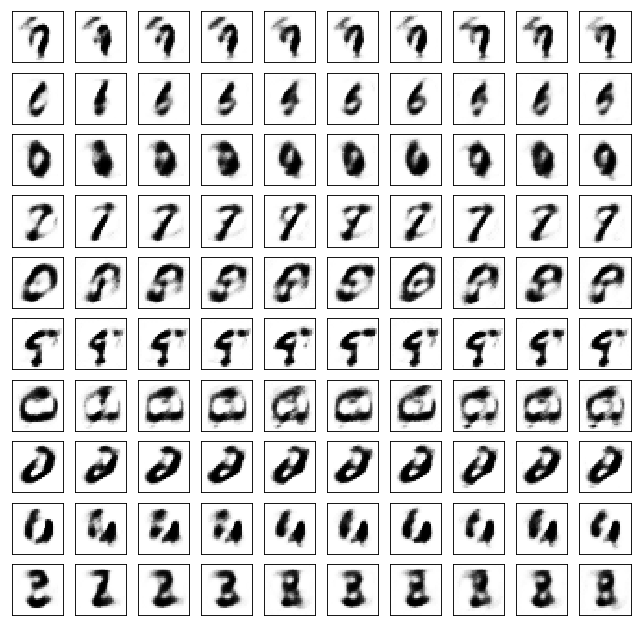

	reconstruction


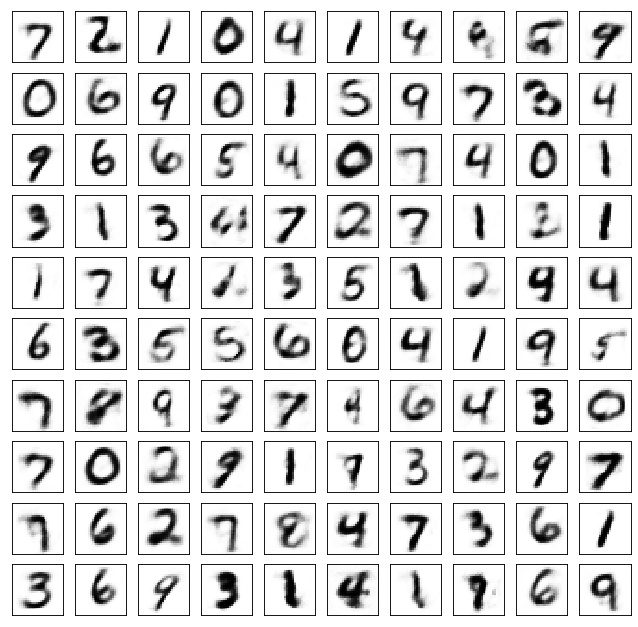

Test losses. E: 0.7112, AE: 0.0995, D: 0.6892
Train Epoch: 40 [0/50000 (0%)]	Losses E: 0.7150, AE: 0.0962, D: 0.6889
Train Epoch: 40 [25000/50000 (50%)]	Losses E: 0.7081, AE: 0.0869, D: 0.6870
Train Epoch: 40 [50000/50000 (100%)]	Losses E: 0.7108, AE: 0.0940, D: 0.6907
	generation


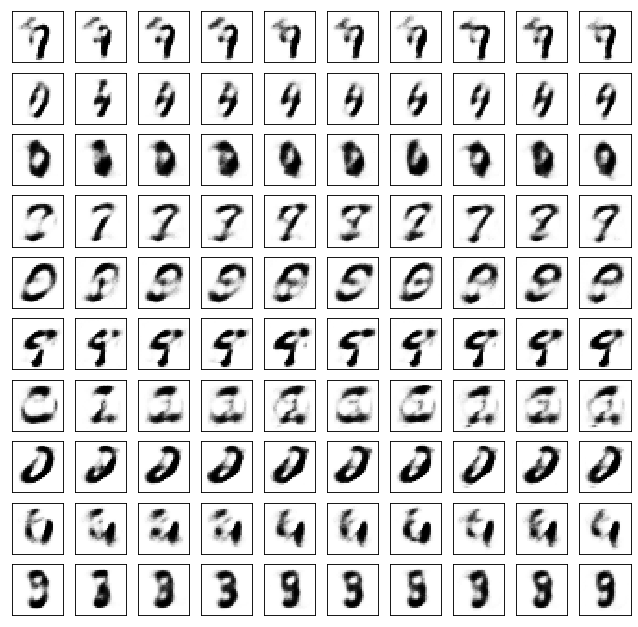

	reconstruction


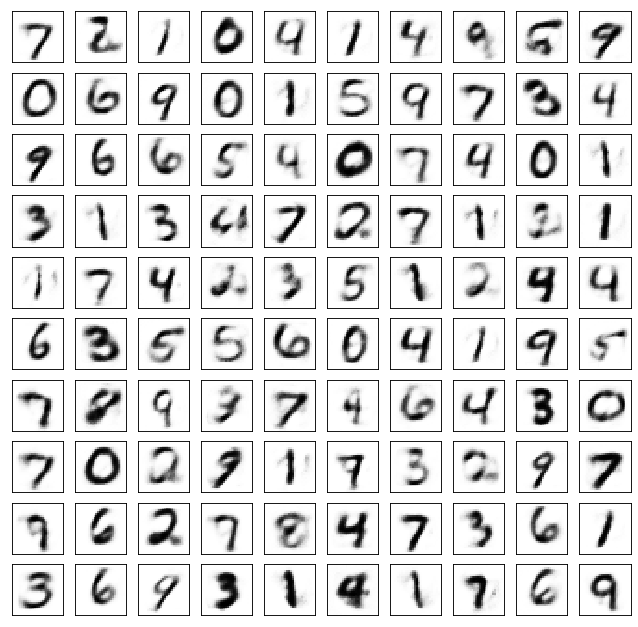

Test losses. E: 0.7073, AE: 0.0960, D: 0.6922
Train Epoch: 41 [0/50000 (0%)]	Losses E: 0.7065, AE: 0.1011, D: 0.6936
Train Epoch: 41 [25000/50000 (50%)]	Losses E: 0.7021, AE: 0.0967, D: 0.6921
Train Epoch: 41 [50000/50000 (100%)]	Losses E: 0.6840, AE: 0.0925, D: 0.6941
	generation


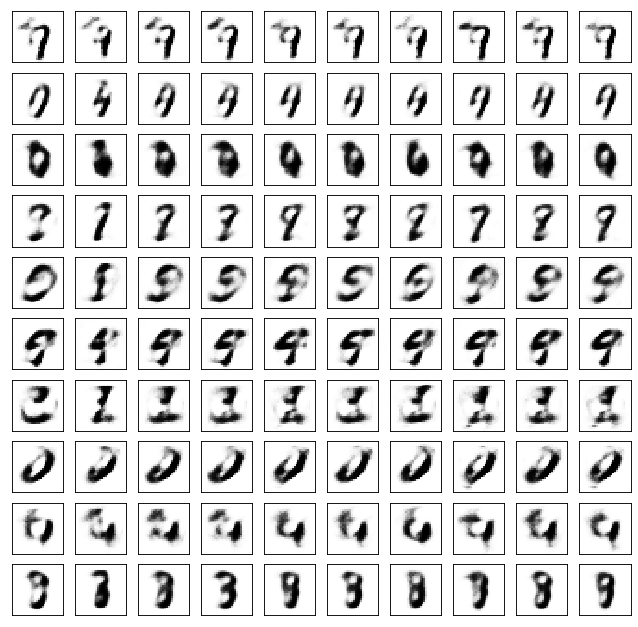

	reconstruction


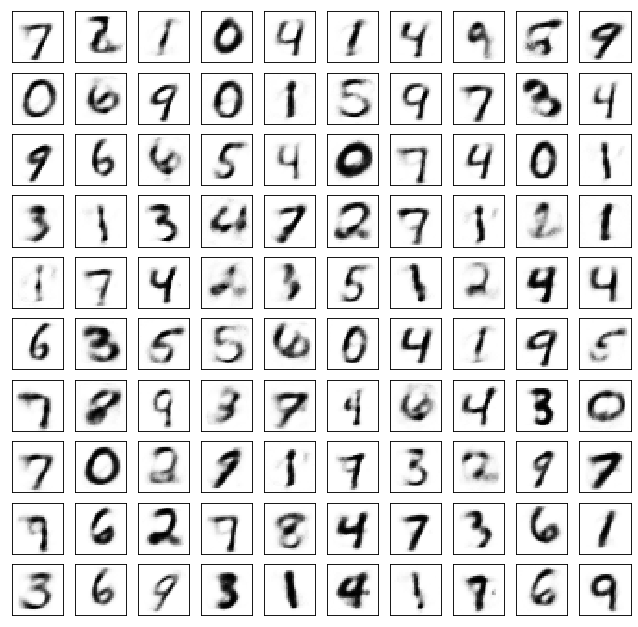

Test losses. E: 0.6820, AE: 0.0960, D: 0.6950
Train Epoch: 42 [0/50000 (0%)]	Losses E: 0.6835, AE: 0.0925, D: 0.6951
Train Epoch: 42 [25000/50000 (50%)]	Losses E: 0.6868, AE: 0.0995, D: 0.7013
Train Epoch: 42 [50000/50000 (100%)]	Losses E: 0.6846, AE: 0.0963, D: 0.6917
	generation


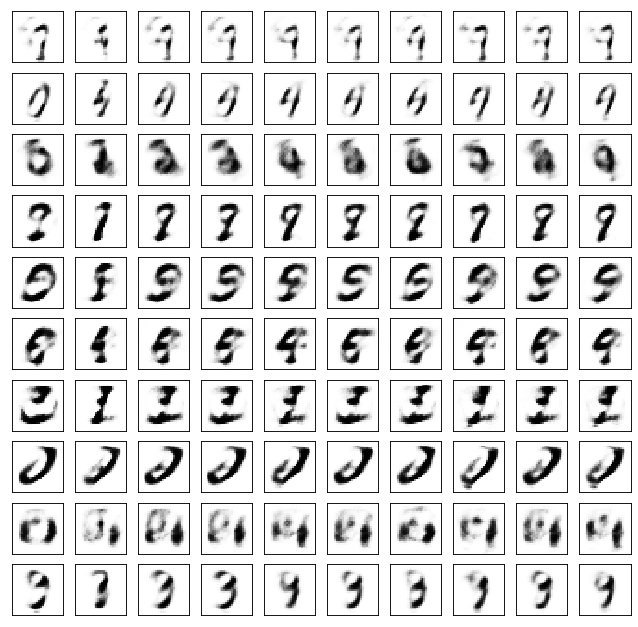

	reconstruction


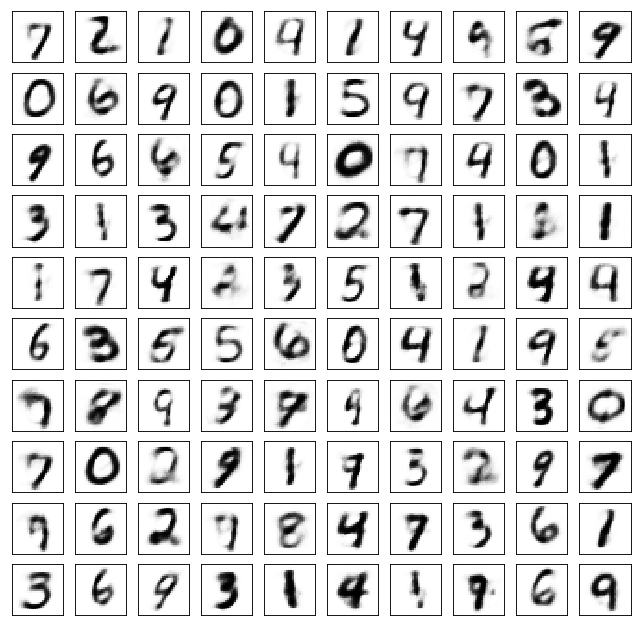

Test losses. E: 0.6822, AE: 0.0963, D: 0.6928
Train Epoch: 43 [0/50000 (0%)]	Losses E: 0.6822, AE: 0.0862, D: 0.6921
Train Epoch: 43 [25000/50000 (50%)]	Losses E: 0.6742, AE: 0.1035, D: 0.6977
Train Epoch: 43 [50000/50000 (100%)]	Losses E: 0.6822, AE: 0.1040, D: 0.6944
	generation


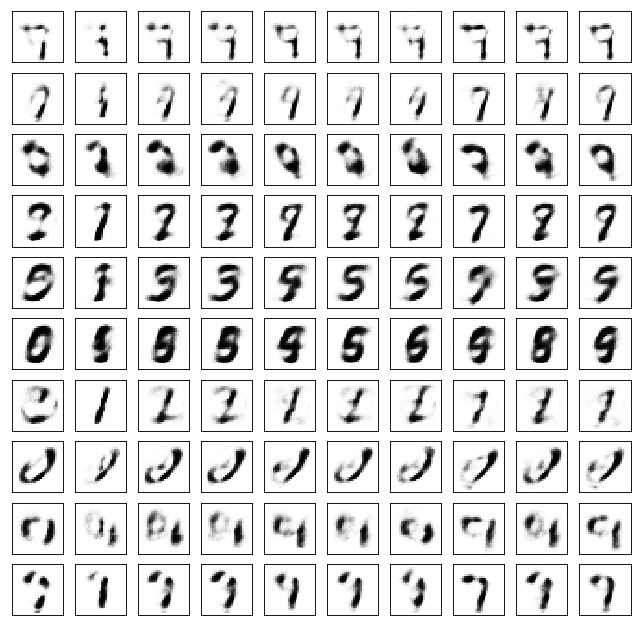

	reconstruction


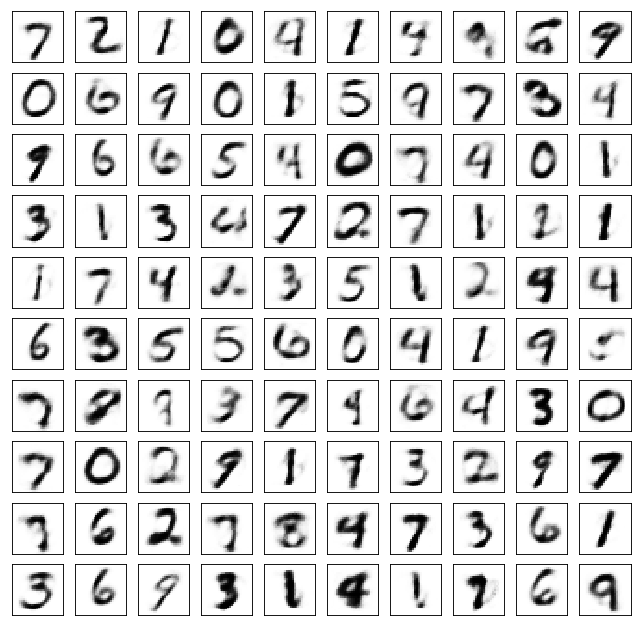

Test losses. E: 0.6797, AE: 0.1052, D: 0.6988
Train Epoch: 44 [0/50000 (0%)]	Losses E: 0.6837, AE: 0.1003, D: 0.6988
Train Epoch: 44 [25000/50000 (50%)]	Losses E: 0.6791, AE: 0.1053, D: 0.6976
Train Epoch: 44 [50000/50000 (100%)]	Losses E: 0.6806, AE: 0.0988, D: 0.6948
	generation


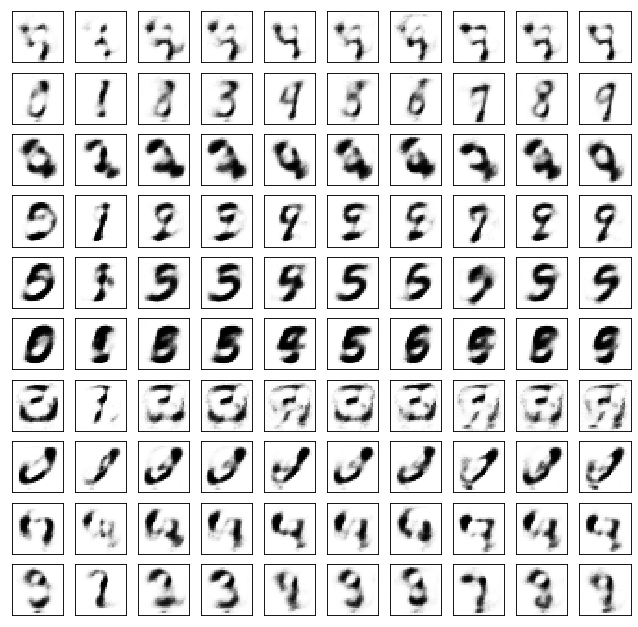

	reconstruction


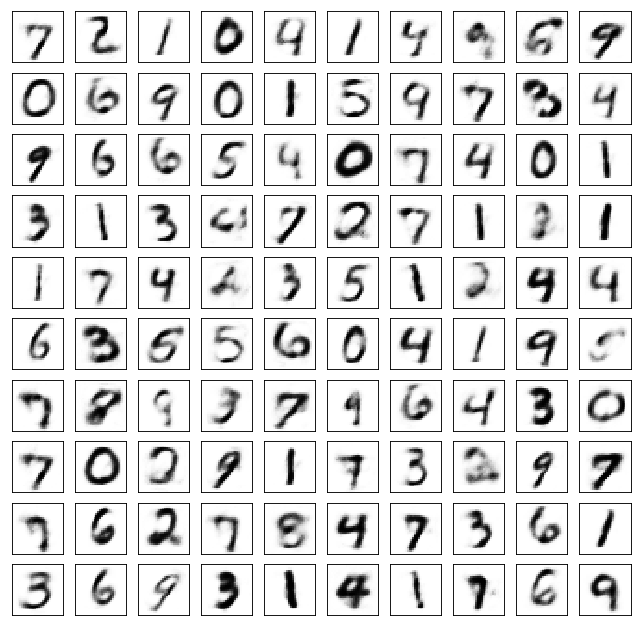

Test losses. E: 0.6780, AE: 0.0991, D: 0.6924
Train Epoch: 45 [0/50000 (0%)]	Losses E: 0.6797, AE: 0.0950, D: 0.6924
Train Epoch: 45 [25000/50000 (50%)]	Losses E: 0.7180, AE: 0.0930, D: 0.6865
Train Epoch: 45 [50000/50000 (100%)]	Losses E: 0.6821, AE: 0.0982, D: 0.6994
	generation


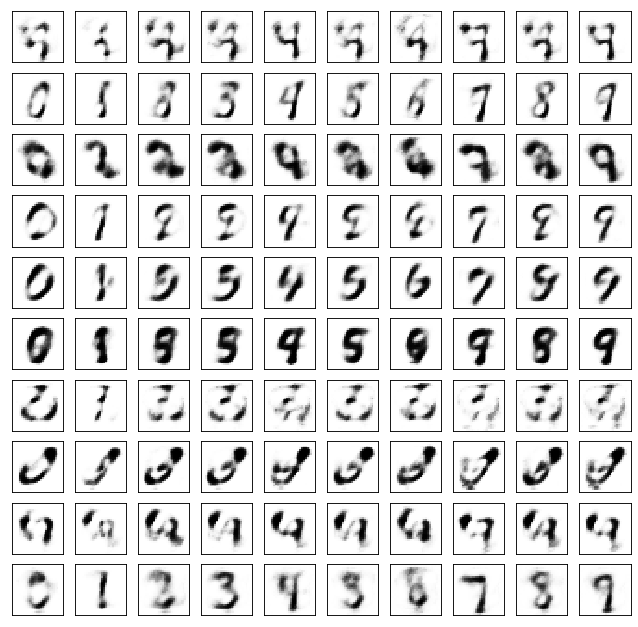

	reconstruction


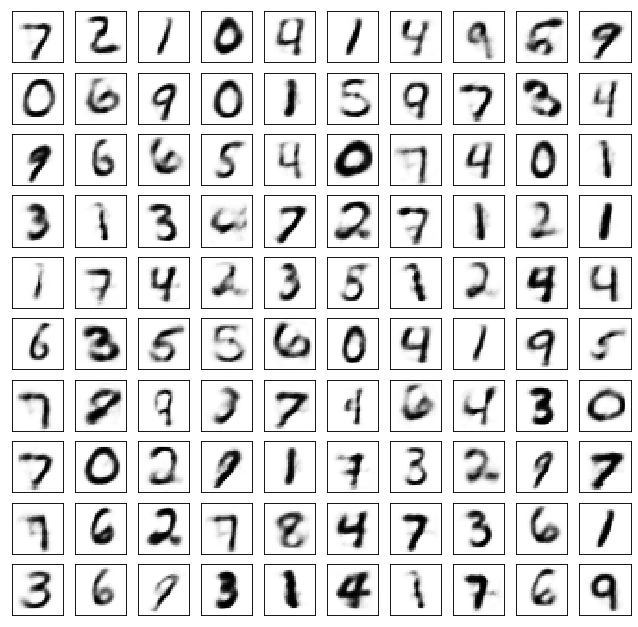

Test losses. E: 0.6784, AE: 0.0965, D: 0.7005
Train Epoch: 46 [0/50000 (0%)]	Losses E: 0.6777, AE: 0.0986, D: 0.7008
Train Epoch: 46 [25000/50000 (50%)]	Losses E: 0.6756, AE: 0.0856, D: 0.6945
Train Epoch: 46 [50000/50000 (100%)]	Losses E: 0.7045, AE: 0.0863, D: 0.6910
	generation


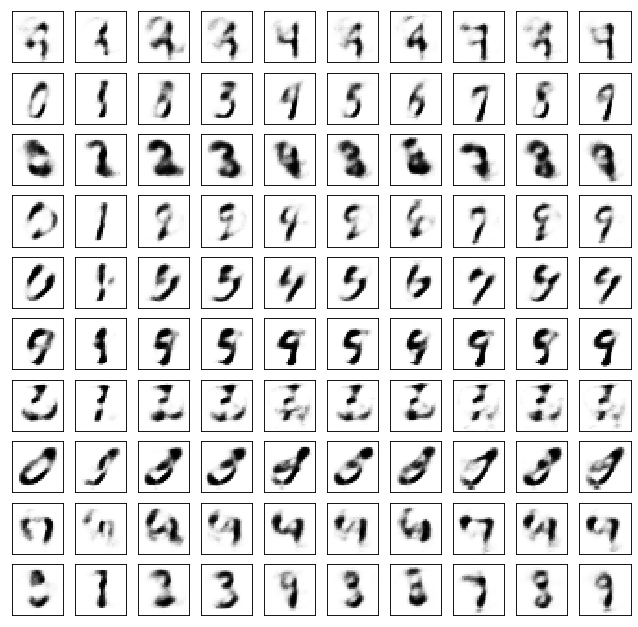

	reconstruction


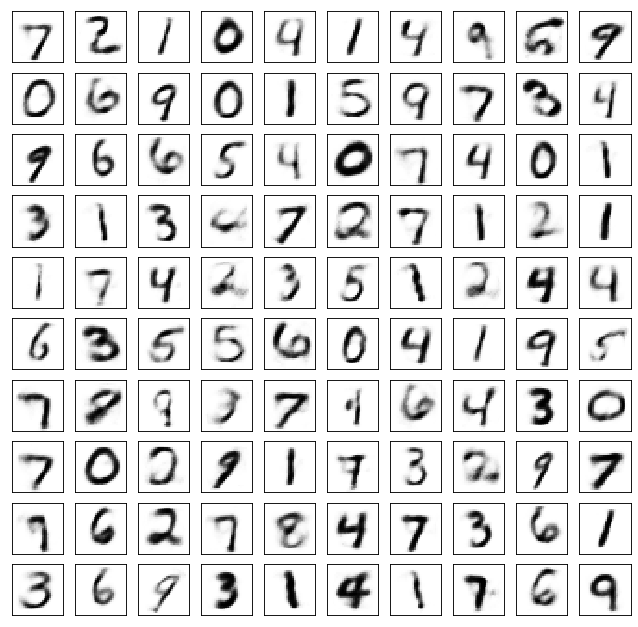

Test losses. E: 0.7015, AE: 0.0877, D: 0.6910
Train Epoch: 47 [0/50000 (0%)]	Losses E: 0.7049, AE: 0.0826, D: 0.6896
Train Epoch: 47 [25000/50000 (50%)]	Losses E: 0.6850, AE: 0.0912, D: 0.6935
Train Epoch: 47 [50000/50000 (100%)]	Losses E: 0.6778, AE: 0.0891, D: 0.6931
	generation


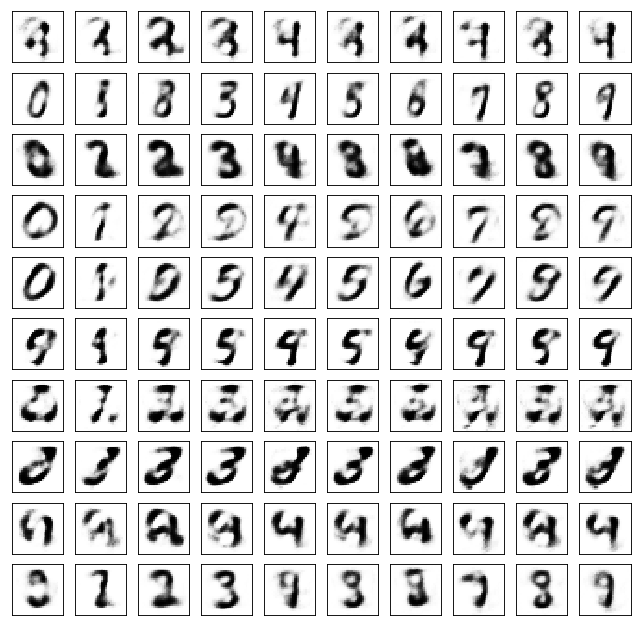

	reconstruction


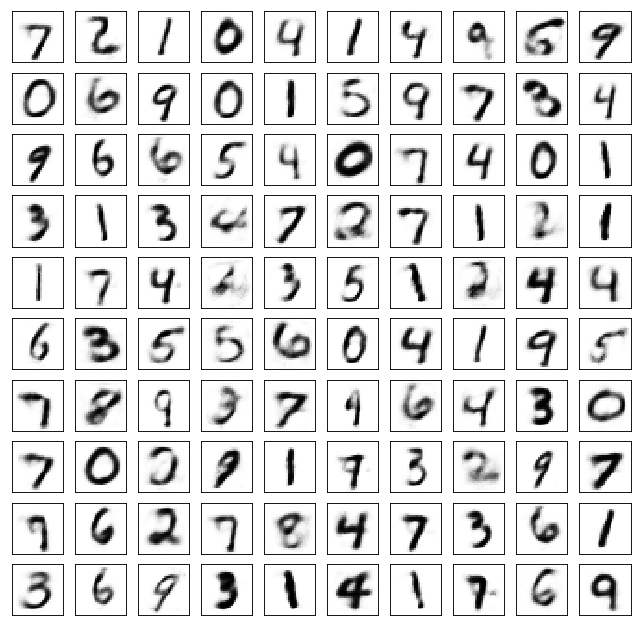

Test losses. E: 0.6762, AE: 0.0860, D: 0.6946
Train Epoch: 48 [0/50000 (0%)]	Losses E: 0.6788, AE: 0.0819, D: 0.6933
Train Epoch: 48 [25000/50000 (50%)]	Losses E: 0.7041, AE: 0.0926, D: 0.6938
Train Epoch: 48 [50000/50000 (100%)]	Losses E: 0.6882, AE: 0.0874, D: 0.6942
	generation


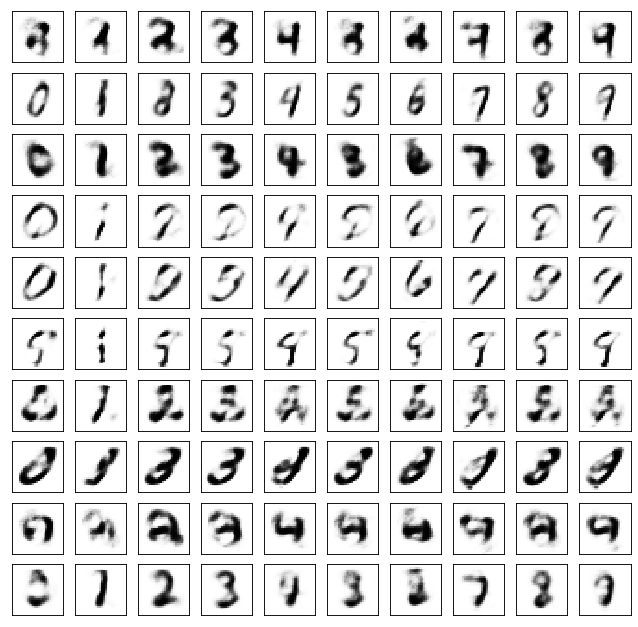

	reconstruction


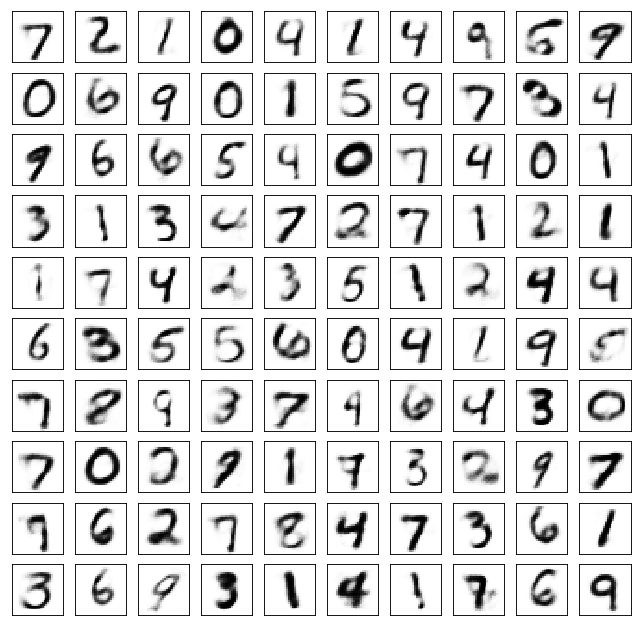

Test losses. E: 0.6901, AE: 0.0877, D: 0.6939
Train Epoch: 49 [0/50000 (0%)]	Losses E: 0.6932, AE: 0.0866, D: 0.6932
Train Epoch: 49 [25000/50000 (50%)]	Losses E: 0.6780, AE: 0.0880, D: 0.6951
Train Epoch: 49 [50000/50000 (100%)]	Losses E: 0.6840, AE: 0.0884, D: 0.6956
	generation


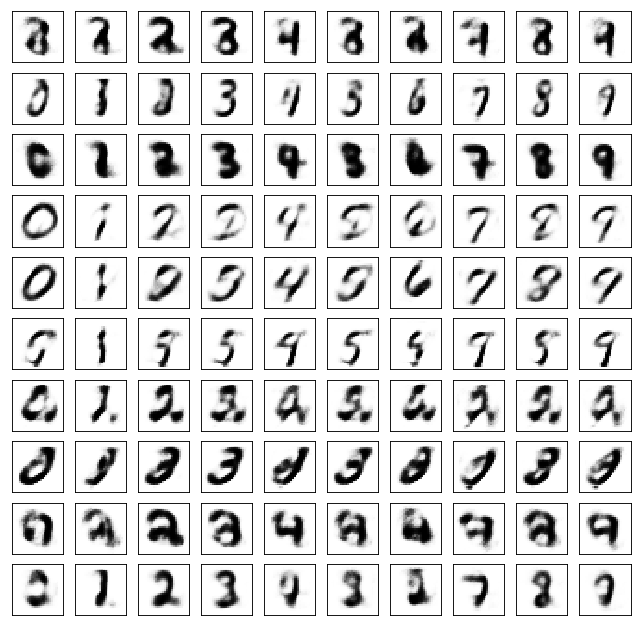

	reconstruction


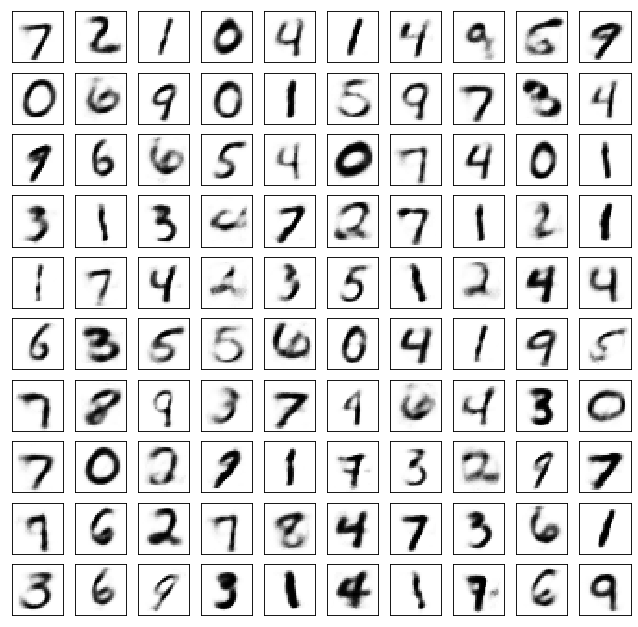

Test losses. E: 0.6842, AE: 0.0876, D: 0.6955
Train Epoch: 50 [0/50000 (0%)]	Losses E: 0.6855, AE: 0.0872, D: 0.6962
Train Epoch: 50 [25000/50000 (50%)]	Losses E: 0.7016, AE: 0.0911, D: 0.6976
Train Epoch: 50 [50000/50000 (100%)]	Losses E: 0.7029, AE: 0.0779, D: 0.6907
	generation


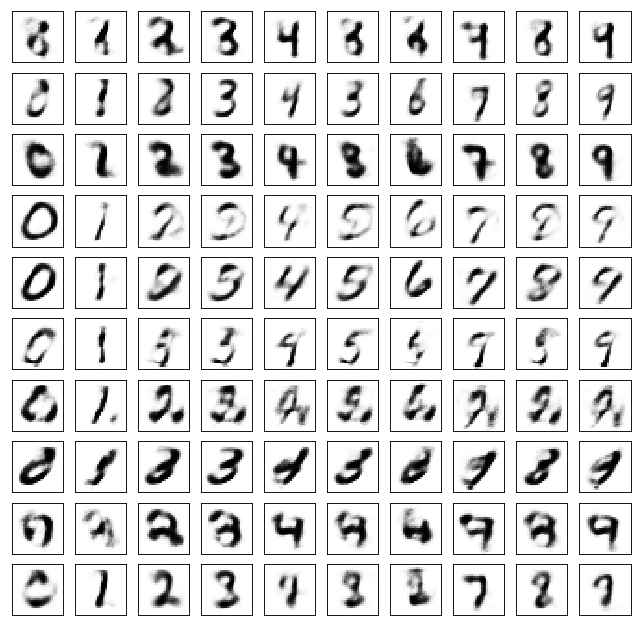

	reconstruction


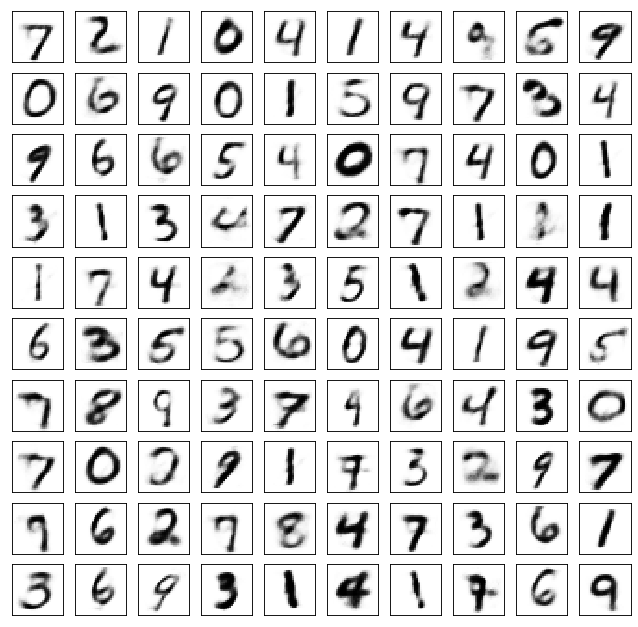

Test losses. E: 0.6958, AE: 0.0846, D: 0.6939
Train Epoch: 51 [0/50000 (0%)]	Losses E: 0.6996, AE: 0.0827, D: 0.6914
Train Epoch: 51 [25000/50000 (50%)]	Losses E: 0.7072, AE: 0.0819, D: 0.6908
Train Epoch: 51 [50000/50000 (100%)]	Losses E: 0.6874, AE: 0.0794, D: 0.6953
	generation


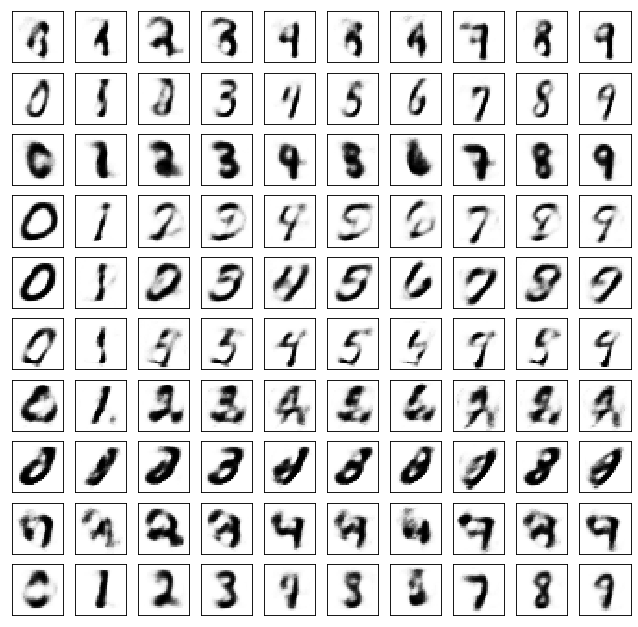

	reconstruction


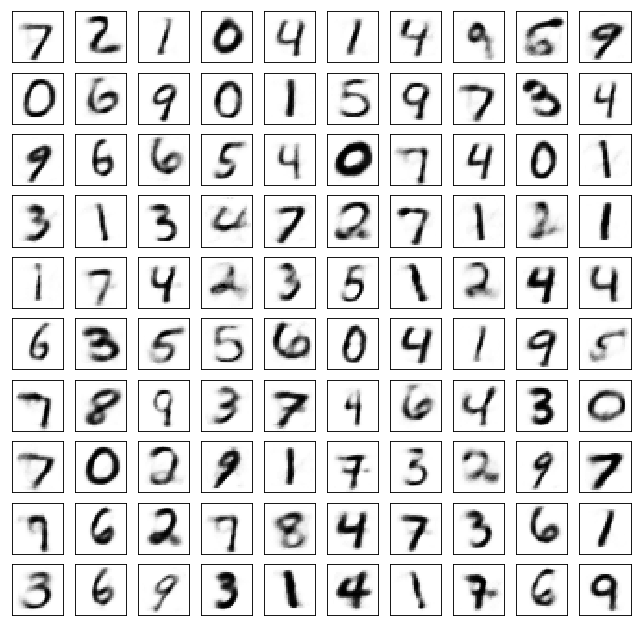

Test losses. E: 0.6858, AE: 0.0805, D: 0.6944
Train Epoch: 52 [0/50000 (0%)]	Losses E: 0.6858, AE: 0.0784, D: 0.6938
Train Epoch: 52 [25000/50000 (50%)]	Losses E: 0.6980, AE: 0.0813, D: 0.6908
Train Epoch: 52 [50000/50000 (100%)]	Losses E: 0.6965, AE: 0.0834, D: 0.6938
	generation


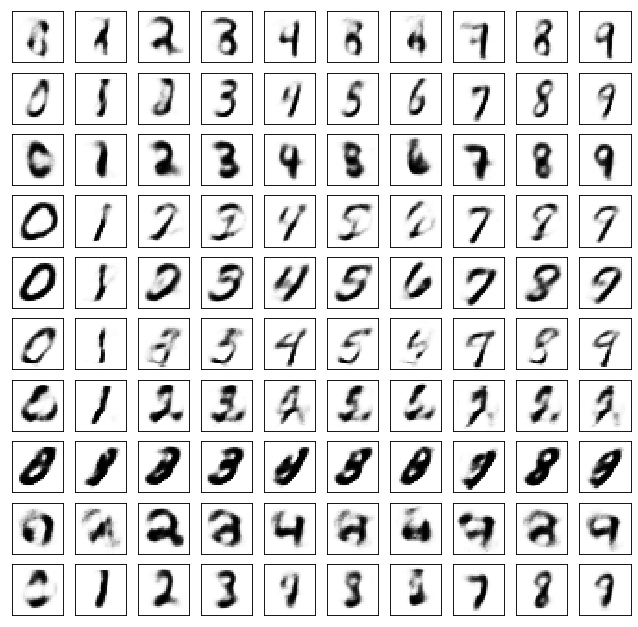

	reconstruction


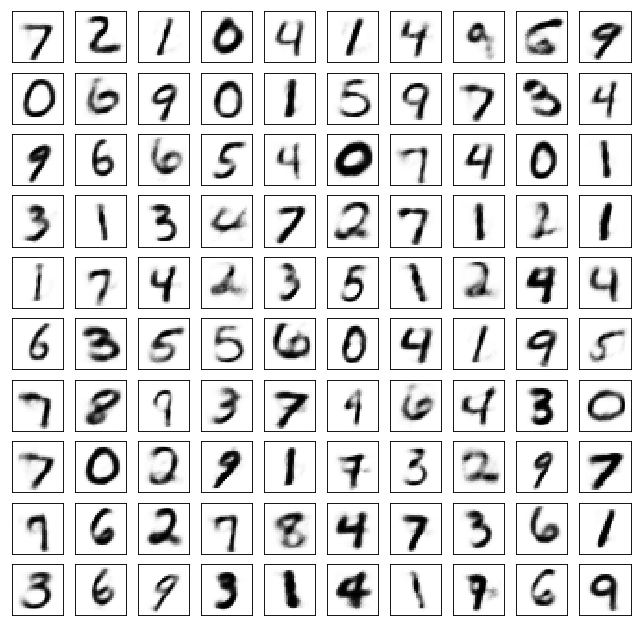

Test losses. E: 0.6970, AE: 0.0789, D: 0.6925
Train Epoch: 53 [0/50000 (0%)]	Losses E: 0.6999, AE: 0.0760, D: 0.6908
Train Epoch: 53 [25000/50000 (50%)]	Losses E: 0.6801, AE: 0.0769, D: 0.6930
Train Epoch: 53 [50000/50000 (100%)]	Losses E: 0.6939, AE: 0.0776, D: 0.6898
	generation


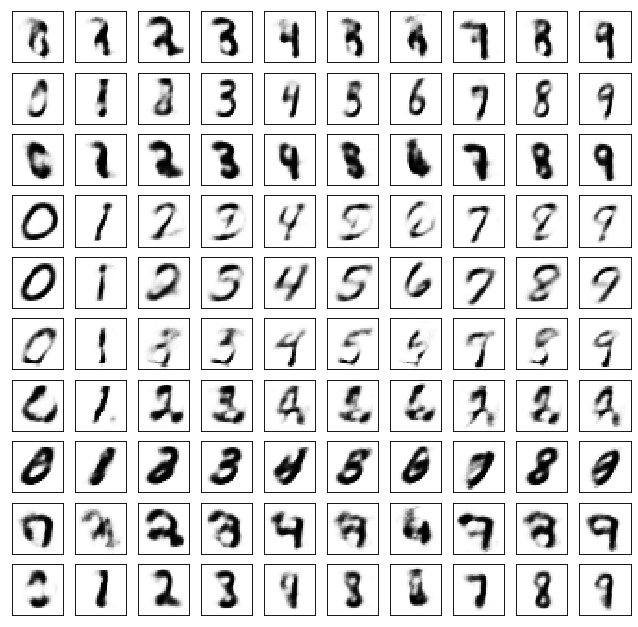

	reconstruction


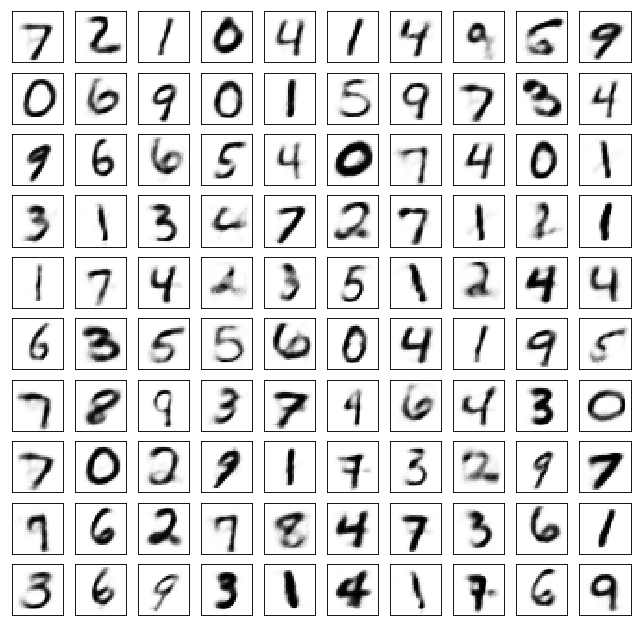

Test losses. E: 0.6906, AE: 0.0772, D: 0.6911
Train Epoch: 54 [0/50000 (0%)]	Losses E: 0.6923, AE: 0.0725, D: 0.6896
Train Epoch: 54 [25000/50000 (50%)]	Losses E: 0.6985, AE: 0.0718, D: 0.6929
Train Epoch: 54 [50000/50000 (100%)]	Losses E: 0.7034, AE: 0.0749, D: 0.6946
	generation


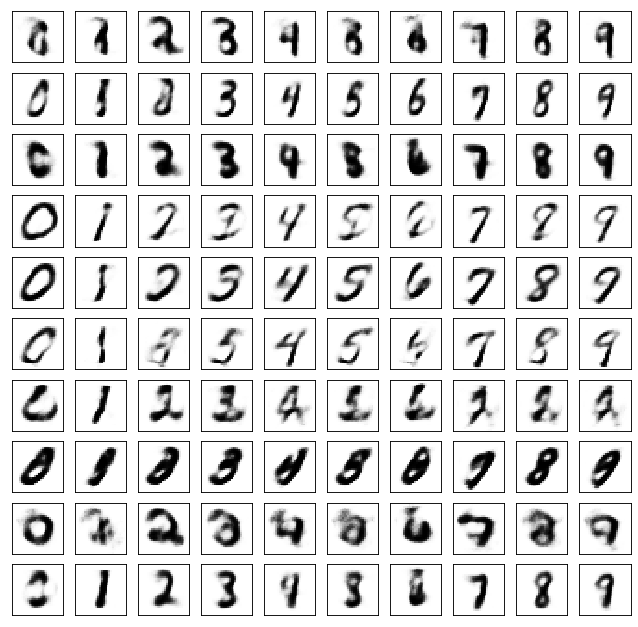

	reconstruction


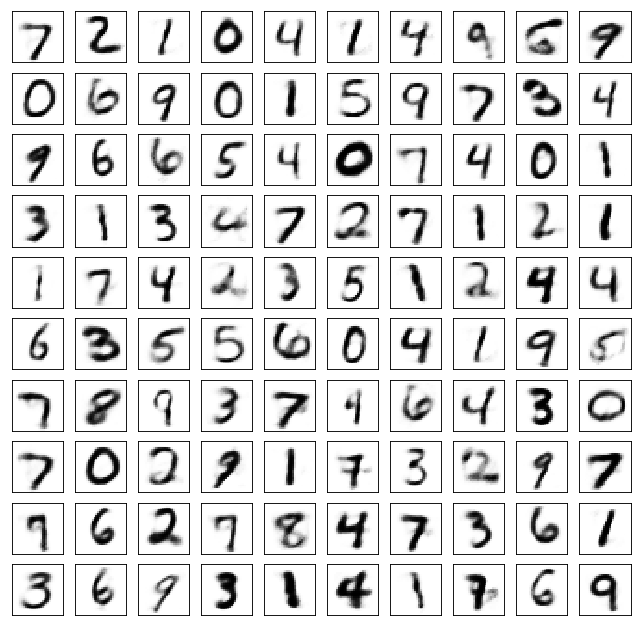

Test losses. E: 0.7034, AE: 0.0776, D: 0.6927
Train Epoch: 55 [0/50000 (0%)]	Losses E: 0.7038, AE: 0.0750, D: 0.6928
Train Epoch: 55 [25000/50000 (50%)]	Losses E: 0.7032, AE: 0.0754, D: 0.6931
Train Epoch: 55 [50000/50000 (100%)]	Losses E: 0.7013, AE: 0.0740, D: 0.6940
	generation


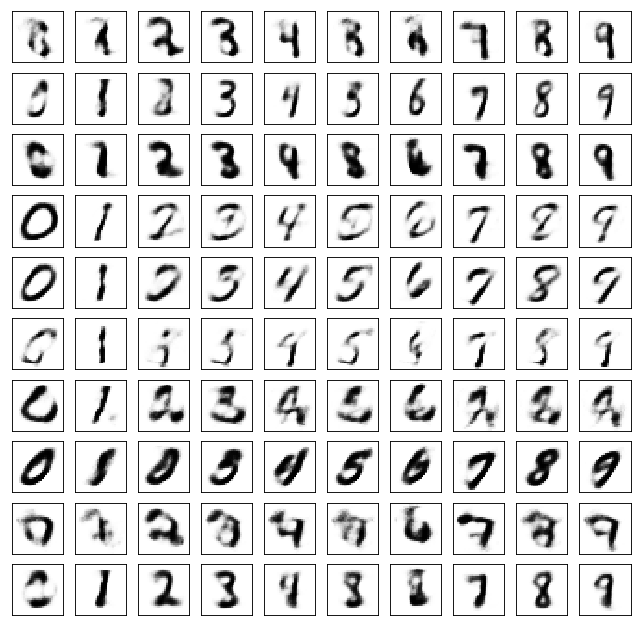

	reconstruction


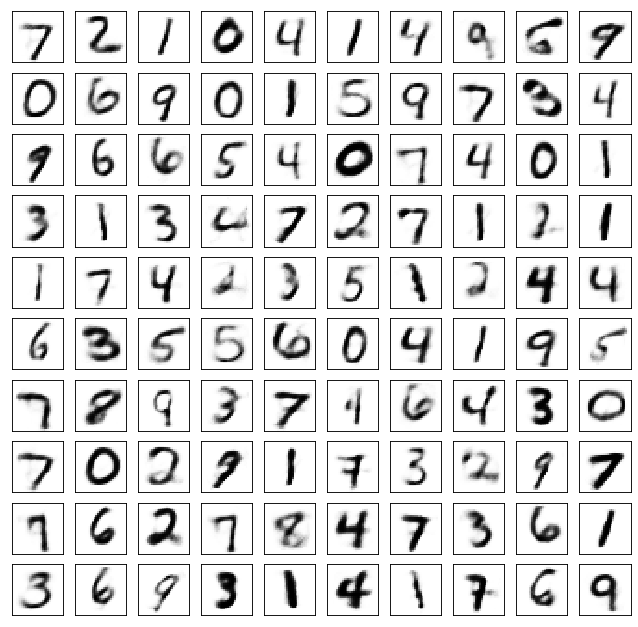

Test losses. E: 0.6976, AE: 0.0797, D: 0.6940
Train Epoch: 56 [0/50000 (0%)]	Losses E: 0.7018, AE: 0.0821, D: 0.6936
Train Epoch: 56 [25000/50000 (50%)]	Losses E: 0.7119, AE: 0.0749, D: 0.6907
Train Epoch: 56 [50000/50000 (100%)]	Losses E: 0.6957, AE: 0.0740, D: 0.6959
	generation


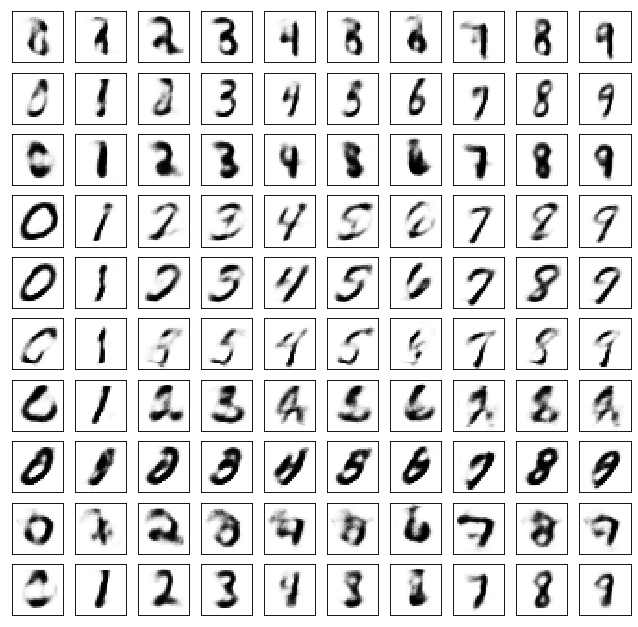

	reconstruction


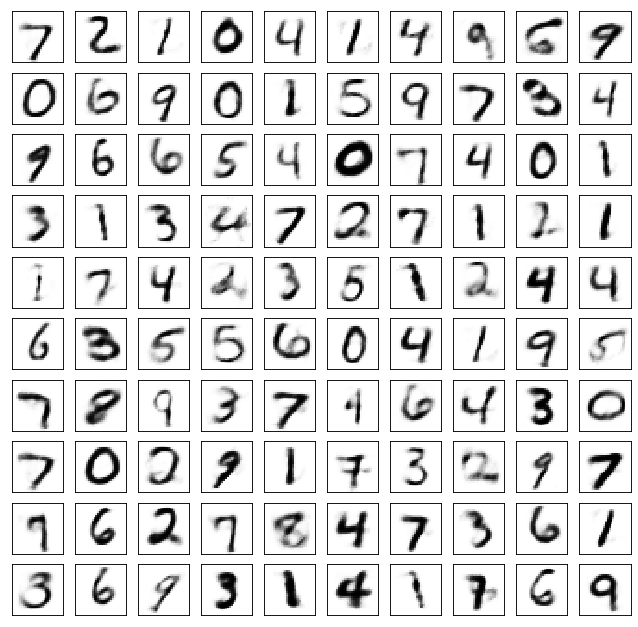

Test losses. E: 0.6958, AE: 0.0761, D: 0.6937
Train Epoch: 57 [0/50000 (0%)]	Losses E: 0.6964, AE: 0.0734, D: 0.6957
Train Epoch: 57 [25000/50000 (50%)]	Losses E: 0.6879, AE: 0.0848, D: 0.6988
Train Epoch: 57 [50000/50000 (100%)]	Losses E: 0.7158, AE: 0.0775, D: 0.6910
	generation


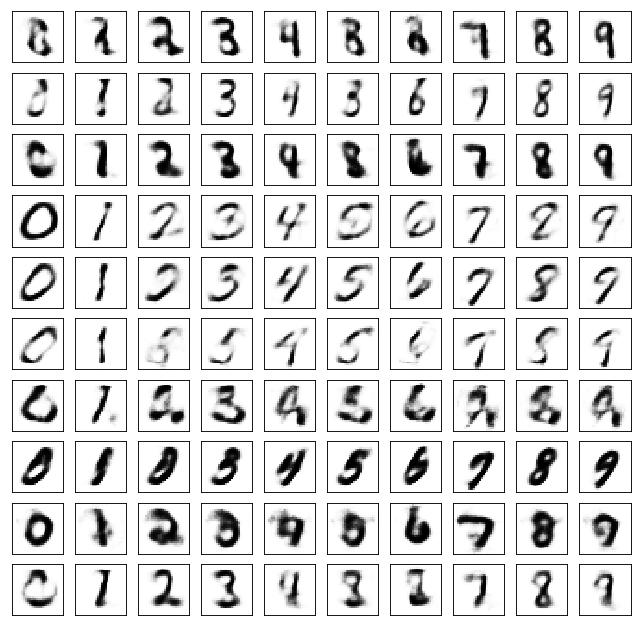

	reconstruction


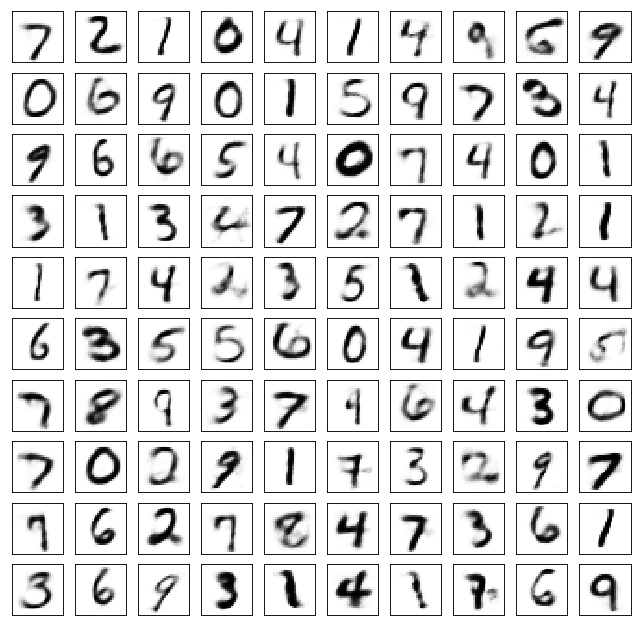

Test losses. E: 0.7136, AE: 0.0783, D: 0.6921
Train Epoch: 58 [0/50000 (0%)]	Losses E: 0.7159, AE: 0.0791, D: 0.6934
Train Epoch: 58 [25000/50000 (50%)]	Losses E: 0.7059, AE: 0.0719, D: 0.6931
Train Epoch: 58 [50000/50000 (100%)]	Losses E: 0.6908, AE: 0.0773, D: 0.6974
	generation


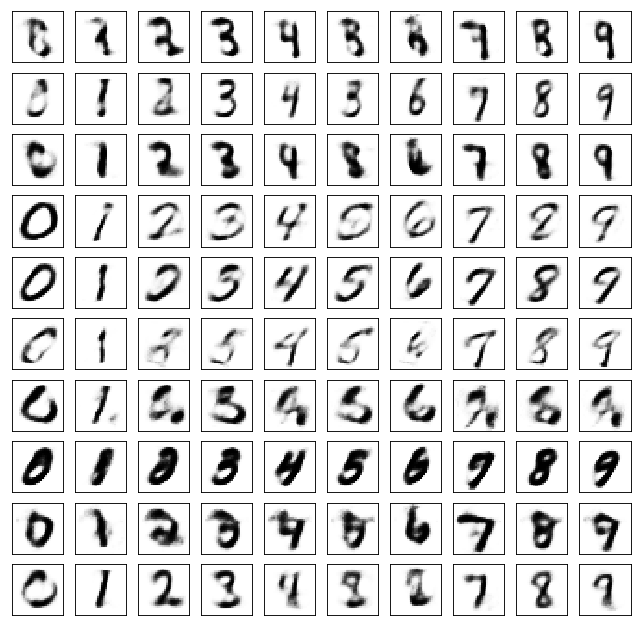

	reconstruction


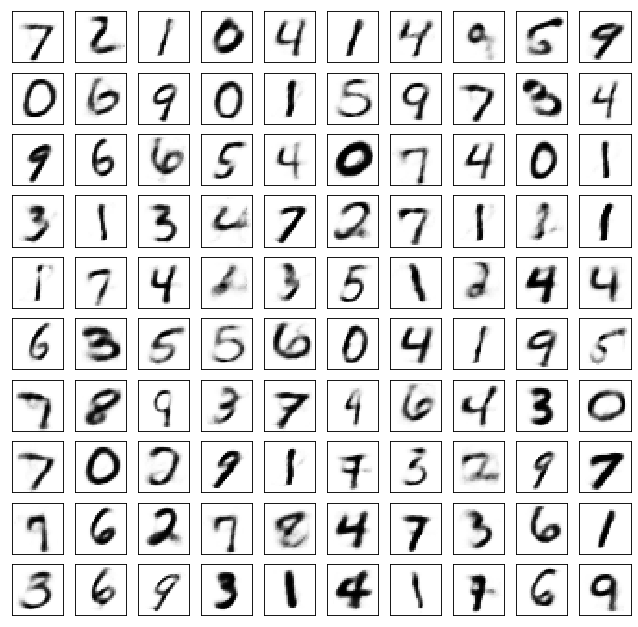

Test losses. E: 0.6896, AE: 0.0802, D: 0.6977
Train Epoch: 59 [0/50000 (0%)]	Losses E: 0.6892, AE: 0.0783, D: 0.6989
Train Epoch: 59 [25000/50000 (50%)]	Losses E: 0.7035, AE: 0.0740, D: 0.6925
Train Epoch: 59 [50000/50000 (100%)]	Losses E: 0.6900, AE: 0.0713, D: 0.6929
	generation


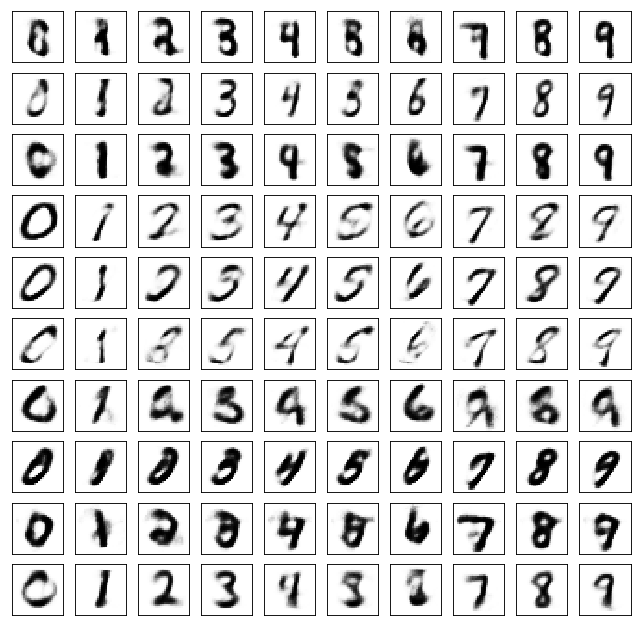

	reconstruction


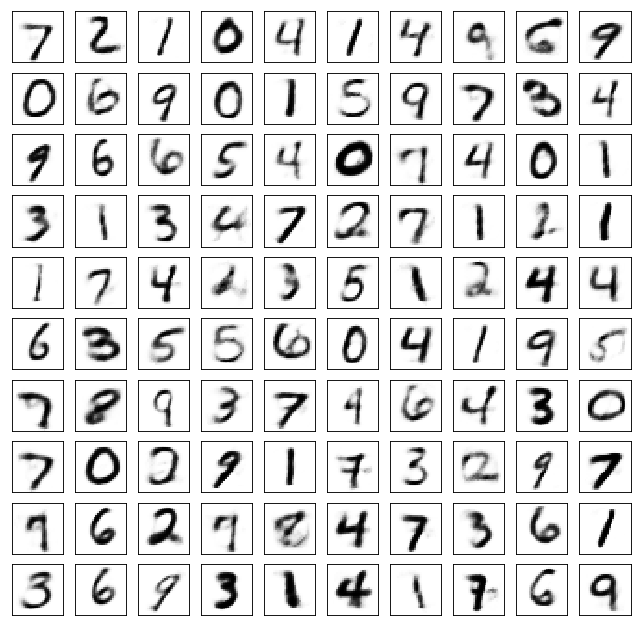

Test losses. E: 0.6833, AE: 0.0759, D: 0.6937
Train Epoch: 60 [0/50000 (0%)]	Losses E: 0.6862, AE: 0.0755, D: 0.6937
Train Epoch: 60 [25000/50000 (50%)]	Losses E: 0.7238, AE: 0.0740, D: 0.6924
Train Epoch: 60 [50000/50000 (100%)]	Losses E: 0.6910, AE: 0.0708, D: 0.6948
	generation


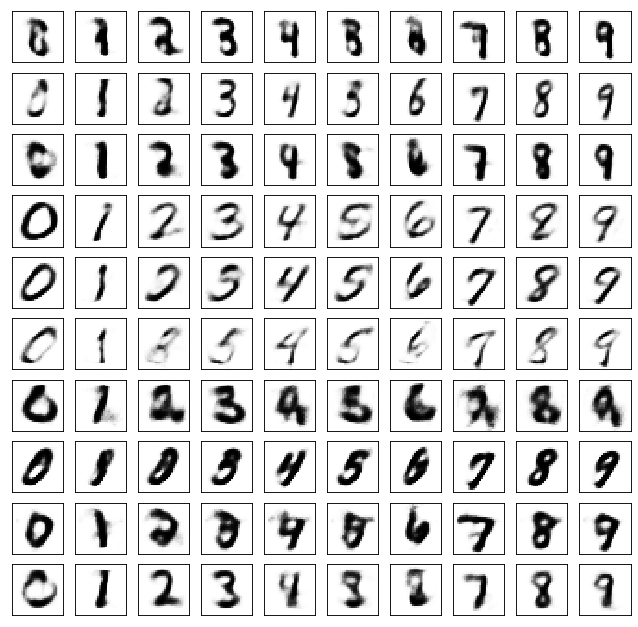

	reconstruction


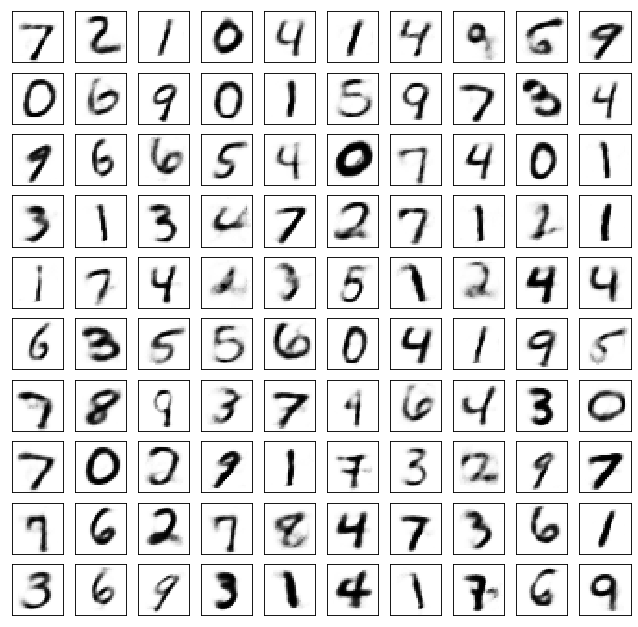

Test losses. E: 0.6887, AE: 0.0757, D: 0.6947
Train Epoch: 61 [0/50000 (0%)]	Losses E: 0.6934, AE: 0.0732, D: 0.6940
Train Epoch: 61 [25000/50000 (50%)]	Losses E: 0.7195, AE: 0.0761, D: 0.6956
Train Epoch: 61 [50000/50000 (100%)]	Losses E: 0.7157, AE: 0.0707, D: 0.6933
	generation


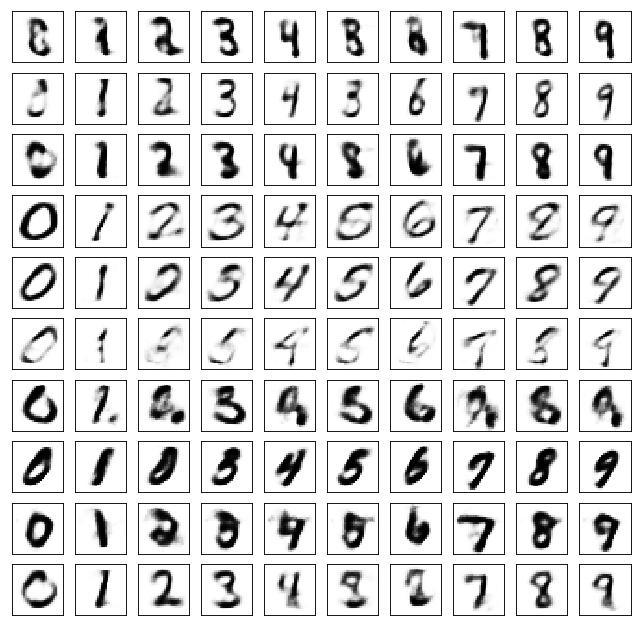

	reconstruction


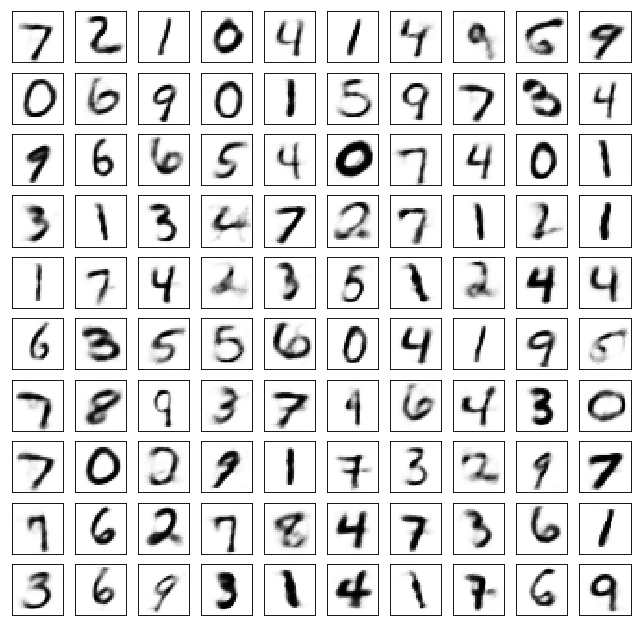

Test losses. E: 0.7159, AE: 0.0729, D: 0.6923
Train Epoch: 62 [0/50000 (0%)]	Losses E: 0.7152, AE: 0.0691, D: 0.6937
Train Epoch: 62 [25000/50000 (50%)]	Losses E: 0.7067, AE: 0.0701, D: 0.6934
Train Epoch: 62 [50000/50000 (100%)]	Losses E: 0.7176, AE: 0.0723, D: 0.6933
	generation


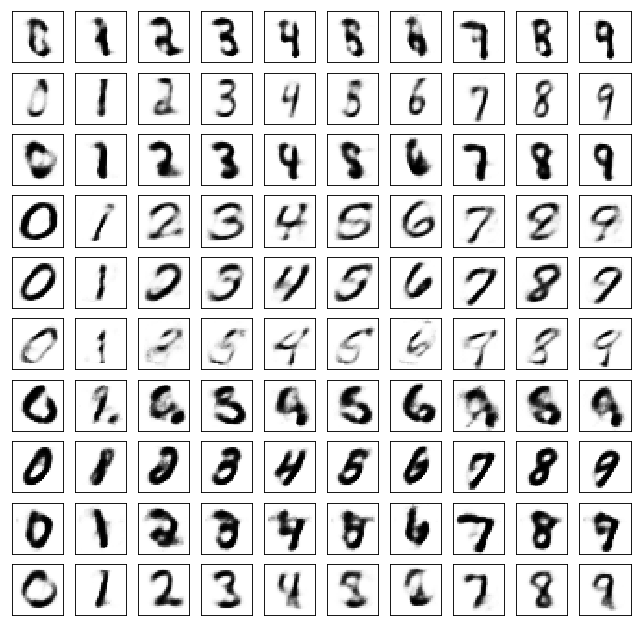

	reconstruction


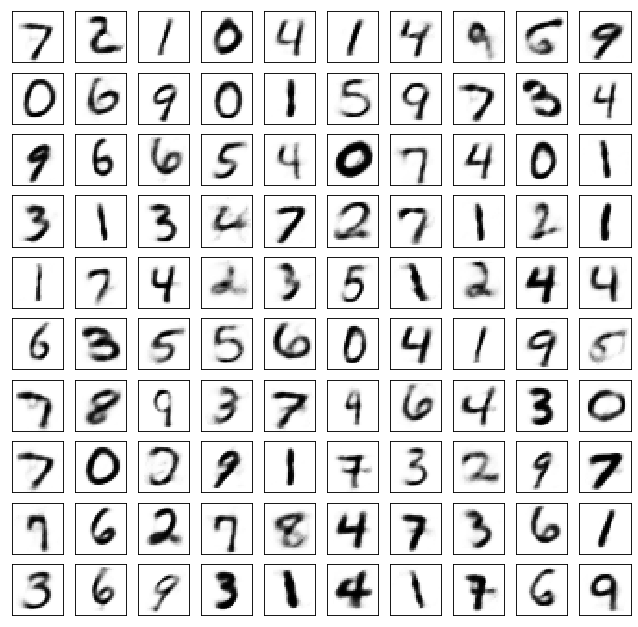

Test losses. E: 0.7174, AE: 0.0717, D: 0.6914
Train Epoch: 63 [0/50000 (0%)]	Losses E: 0.7167, AE: 0.0707, D: 0.6915
Train Epoch: 63 [25000/50000 (50%)]	Losses E: 0.7044, AE: 0.0715, D: 0.6946
Train Epoch: 63 [50000/50000 (100%)]	Losses E: 0.7048, AE: 0.0669, D: 0.6886
	generation


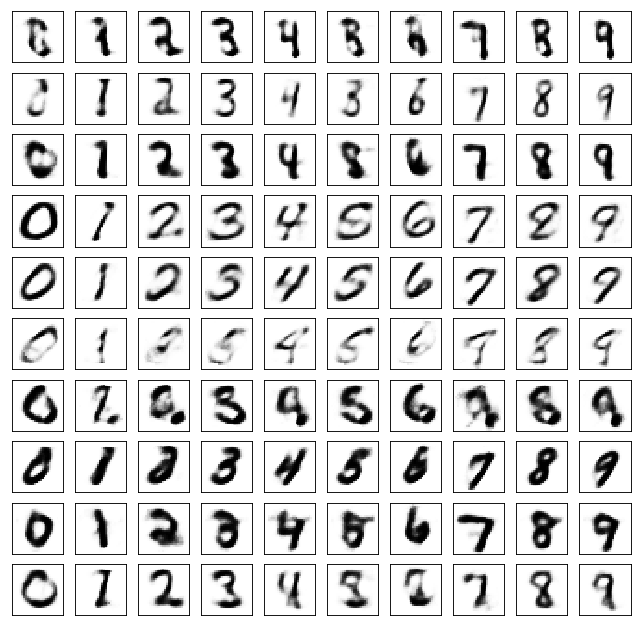

	reconstruction


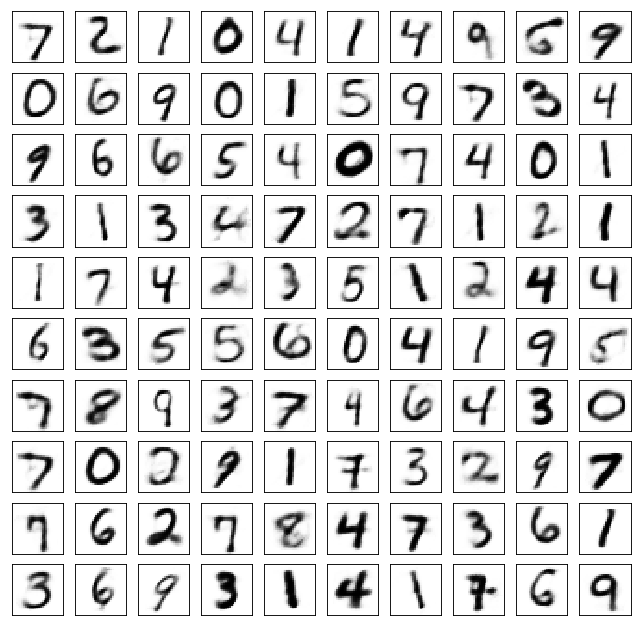

Test losses. E: 0.7027, AE: 0.0701, D: 0.6910
Train Epoch: 64 [0/50000 (0%)]	Losses E: 0.7056, AE: 0.0645, D: 0.6914
Train Epoch: 64 [25000/50000 (50%)]	Losses E: 0.7138, AE: 0.0686, D: 0.6947
Train Epoch: 64 [50000/50000 (100%)]	Losses E: 0.7058, AE: 0.0725, D: 0.6950
	generation


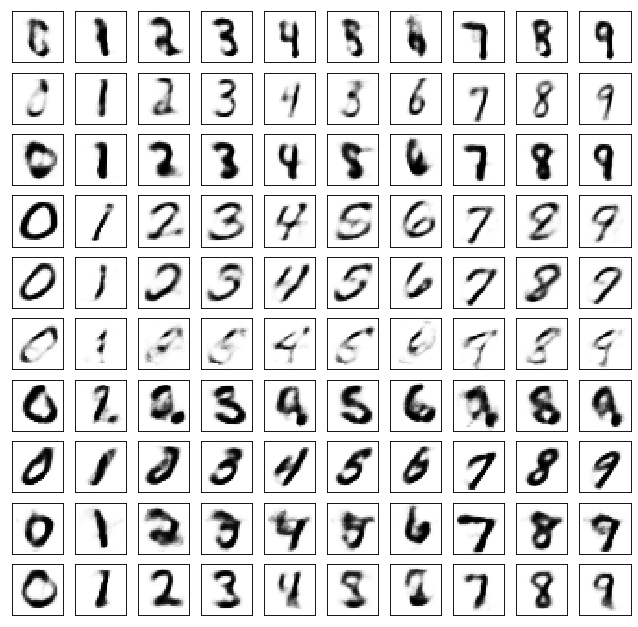

	reconstruction


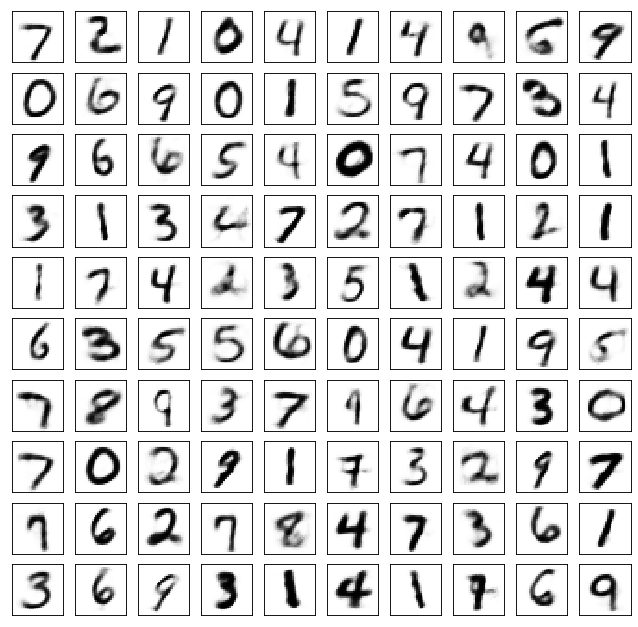

Test losses. E: 0.7019, AE: 0.0731, D: 0.6957
Train Epoch: 65 [0/50000 (0%)]	Losses E: 0.7046, AE: 0.0685, D: 0.6953
Train Epoch: 65 [25000/50000 (50%)]	Losses E: 0.7239, AE: 0.0731, D: 0.6907
Train Epoch: 65 [50000/50000 (100%)]	Losses E: 0.7032, AE: 0.0671, D: 0.6913
	generation


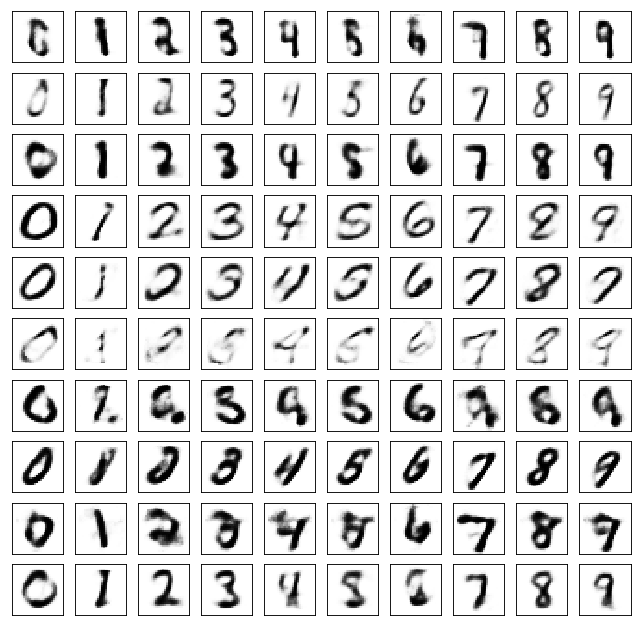

	reconstruction


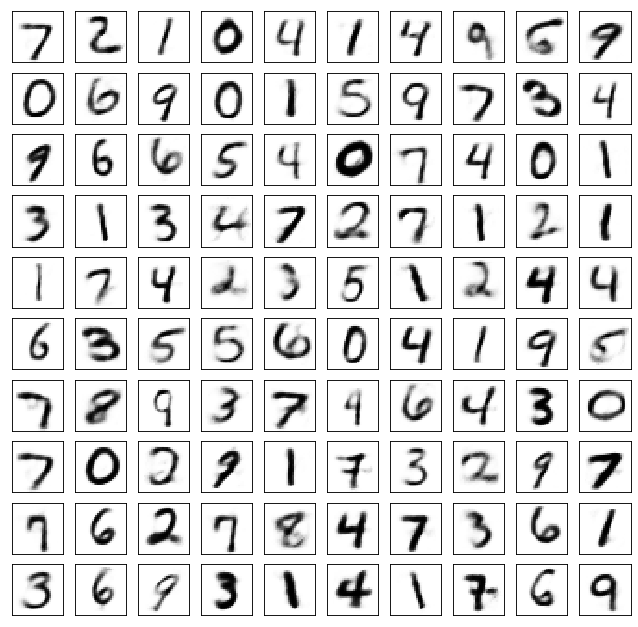

Test losses. E: 0.7040, AE: 0.0699, D: 0.6924
Train Epoch: 66 [0/50000 (0%)]	Losses E: 0.7073, AE: 0.0677, D: 0.6930
Train Epoch: 66 [25000/50000 (50%)]	Losses E: 0.7018, AE: 0.0728, D: 0.6939
Train Epoch: 66 [50000/50000 (100%)]	Losses E: 0.6983, AE: 0.0732, D: 0.6930
	generation


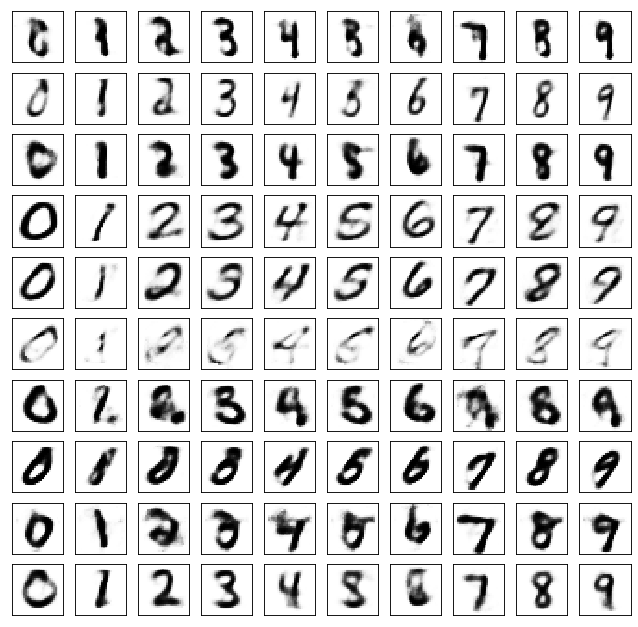

	reconstruction


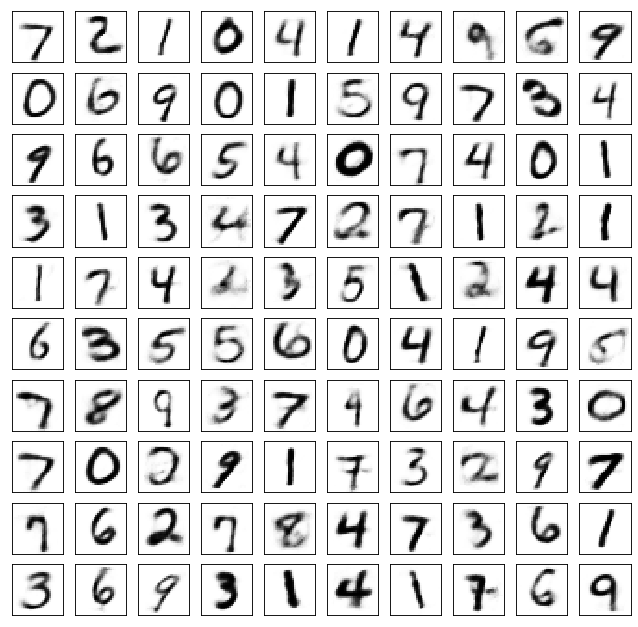

Test losses. E: 0.6942, AE: 0.0719, D: 0.6930
Train Epoch: 67 [0/50000 (0%)]	Losses E: 0.6941, AE: 0.0705, D: 0.6952
Train Epoch: 67 [25000/50000 (50%)]	Losses E: 0.7101, AE: 0.0652, D: 0.6928
Train Epoch: 67 [50000/50000 (100%)]	Losses E: 0.6926, AE: 0.0649, D: 0.6904
	generation


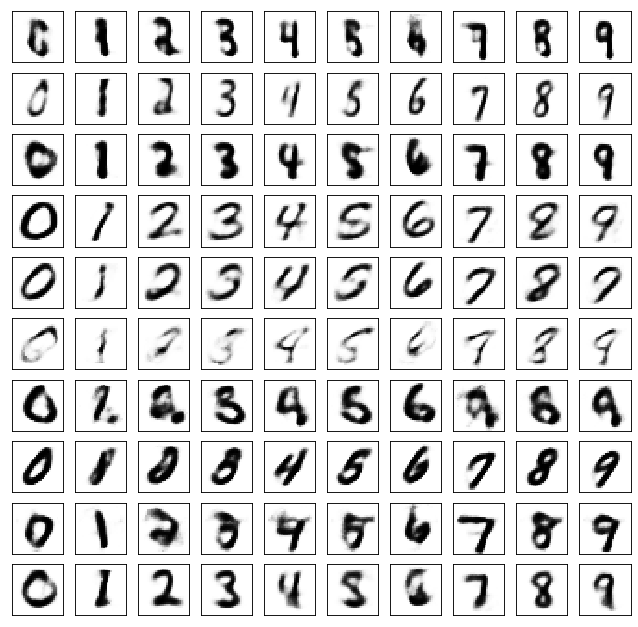

	reconstruction


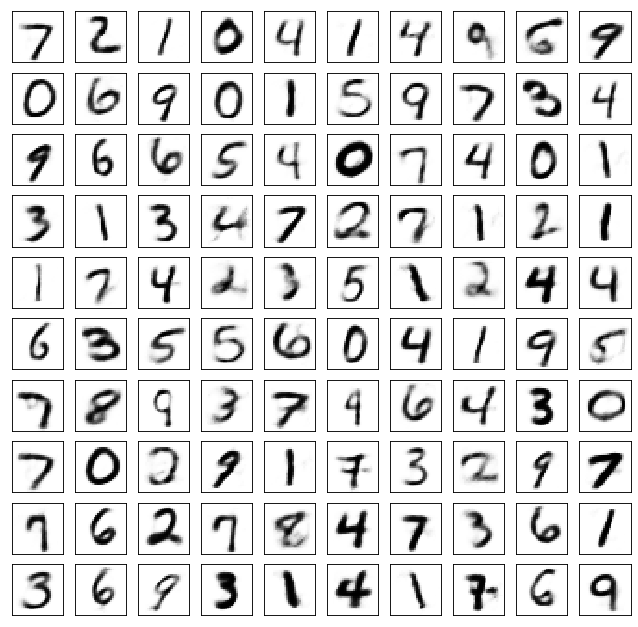

Test losses. E: 0.6889, AE: 0.0684, D: 0.6920
Train Epoch: 68 [0/50000 (0%)]	Losses E: 0.6927, AE: 0.0621, D: 0.6917
Train Epoch: 68 [25000/50000 (50%)]	Losses E: 0.7112, AE: 0.0664, D: 0.6938
Train Epoch: 68 [50000/50000 (100%)]	Losses E: 0.6792, AE: 0.0699, D: 0.6957
	generation


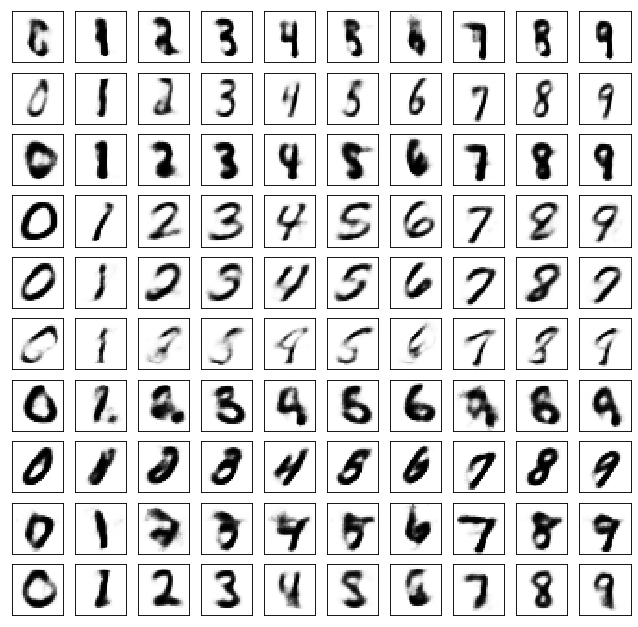

	reconstruction


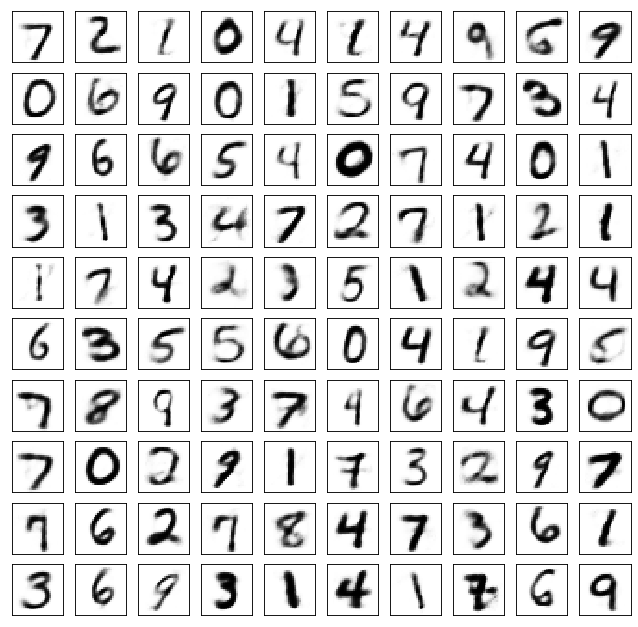

Test losses. E: 0.6760, AE: 0.0736, D: 0.6963
Train Epoch: 69 [0/50000 (0%)]	Losses E: 0.6747, AE: 0.0679, D: 0.6971
Train Epoch: 69 [25000/50000 (50%)]	Losses E: 0.6923, AE: 0.0636, D: 0.6907
Train Epoch: 69 [50000/50000 (100%)]	Losses E: 0.6897, AE: 0.0694, D: 0.6947
	generation


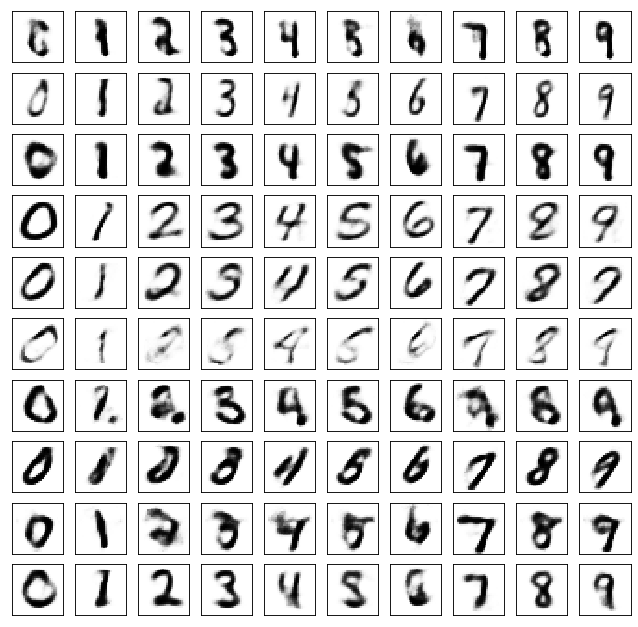

	reconstruction


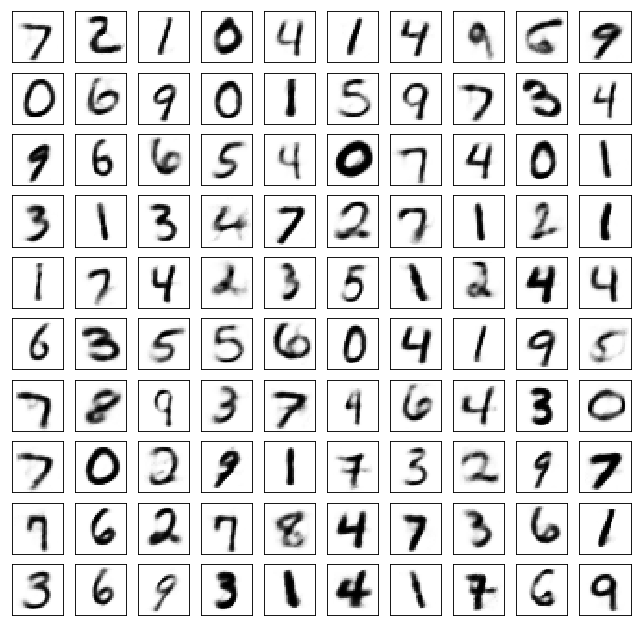

Test losses. E: 0.6908, AE: 0.0697, D: 0.6950
Train Epoch: 70 [0/50000 (0%)]	Losses E: 0.6887, AE: 0.0685, D: 0.6947
Train Epoch: 70 [25000/50000 (50%)]	Losses E: 0.6833, AE: 0.0667, D: 0.6970
Train Epoch: 70 [50000/50000 (100%)]	Losses E: 0.6927, AE: 0.0671, D: 0.6956
	generation


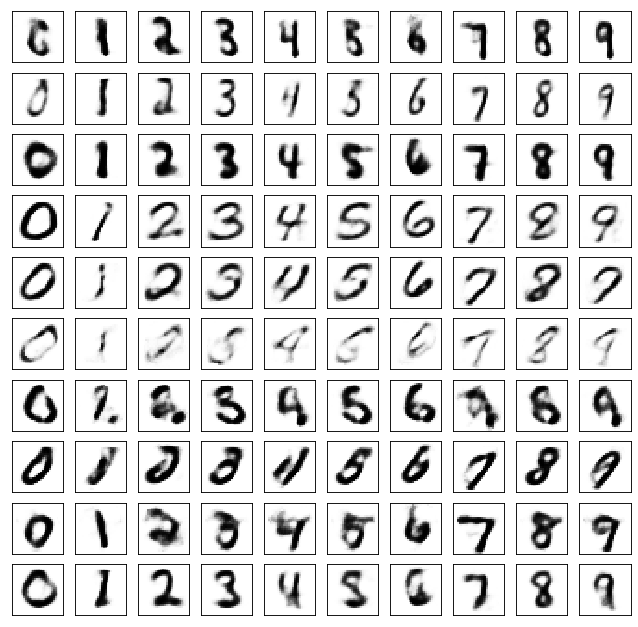

	reconstruction


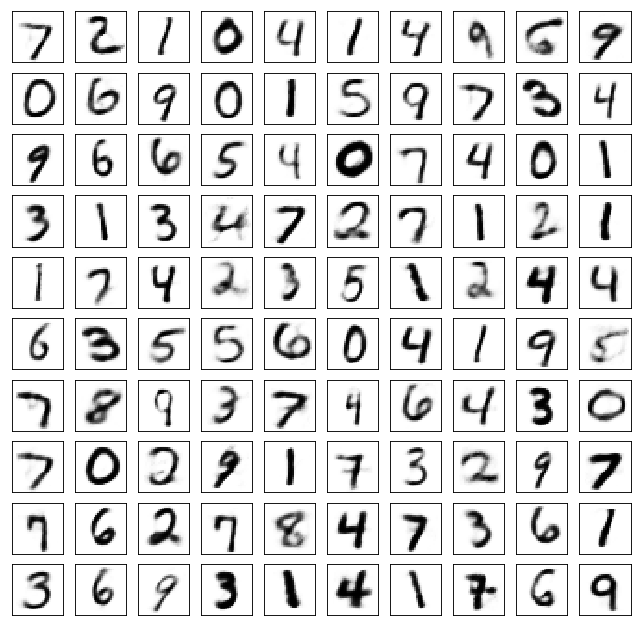

Test losses. E: 0.6947, AE: 0.0697, D: 0.6946
Train Epoch: 71 [0/50000 (0%)]	Losses E: 0.6950, AE: 0.0640, D: 0.6936
Train Epoch: 71 [25000/50000 (50%)]	Losses E: 0.6863, AE: 0.0652, D: 0.6923
Train Epoch: 71 [50000/50000 (100%)]	Losses E: 0.6981, AE: 0.0659, D: 0.6949
	generation


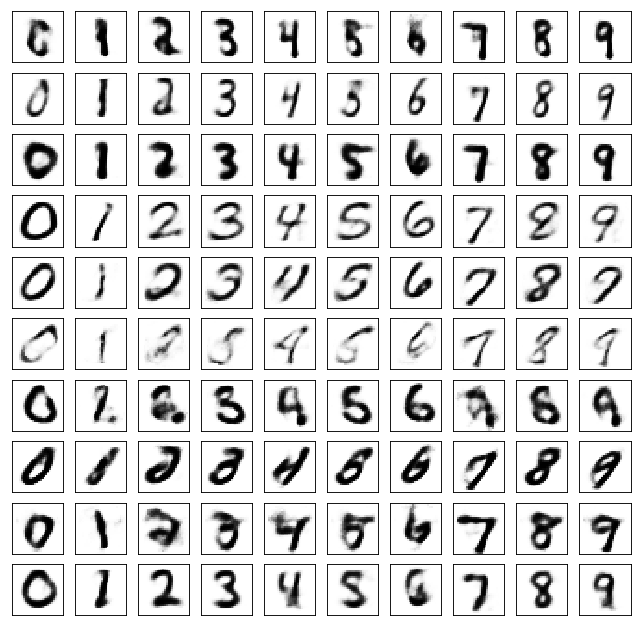

	reconstruction


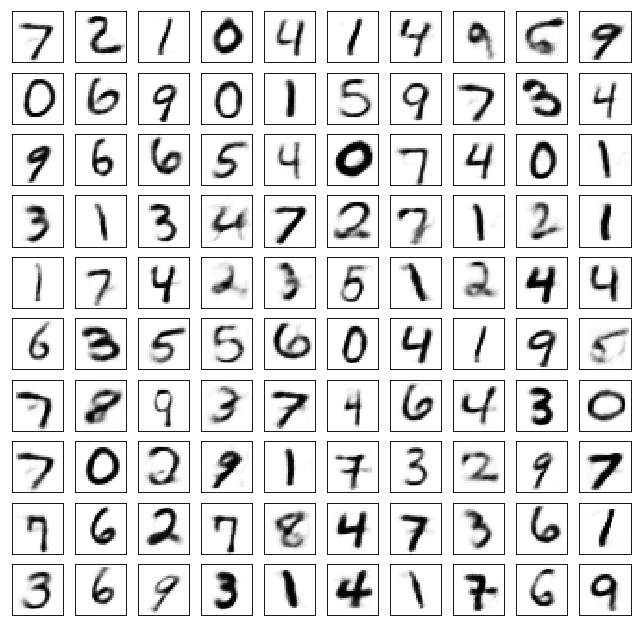

Test losses. E: 0.6959, AE: 0.0706, D: 0.6952
Train Epoch: 72 [0/50000 (0%)]	Losses E: 0.6980, AE: 0.0652, D: 0.6925
Train Epoch: 72 [25000/50000 (50%)]	Losses E: 0.6765, AE: 0.0646, D: 0.6953
Train Epoch: 72 [50000/50000 (100%)]	Losses E: 0.6880, AE: 0.0577, D: 0.6947
	generation


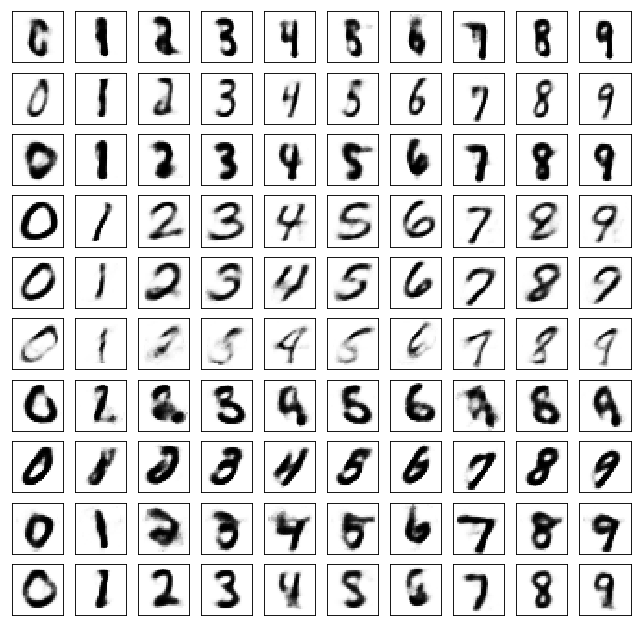

	reconstruction


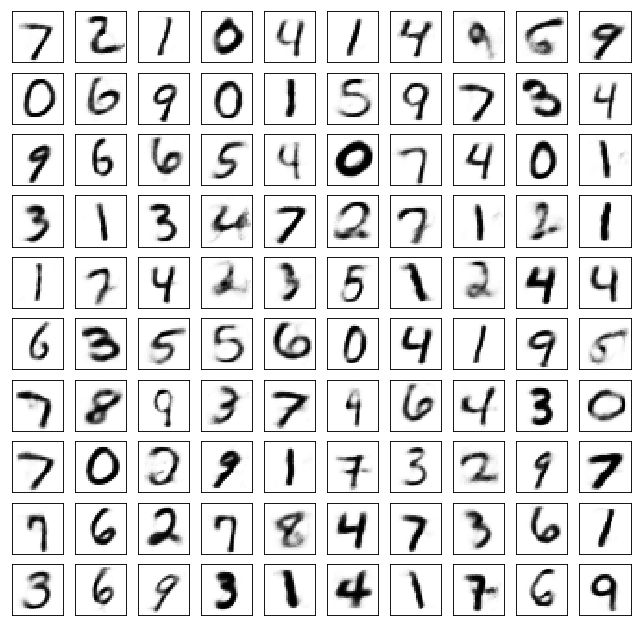

Test losses. E: 0.6867, AE: 0.0667, D: 0.6949
Train Epoch: 73 [0/50000 (0%)]	Losses E: 0.6876, AE: 0.0649, D: 0.6948
Train Epoch: 73 [25000/50000 (50%)]	Losses E: 0.6932, AE: 0.0661, D: 0.6955
Train Epoch: 73 [50000/50000 (100%)]	Losses E: 0.7076, AE: 0.0721, D: 0.6968
	generation


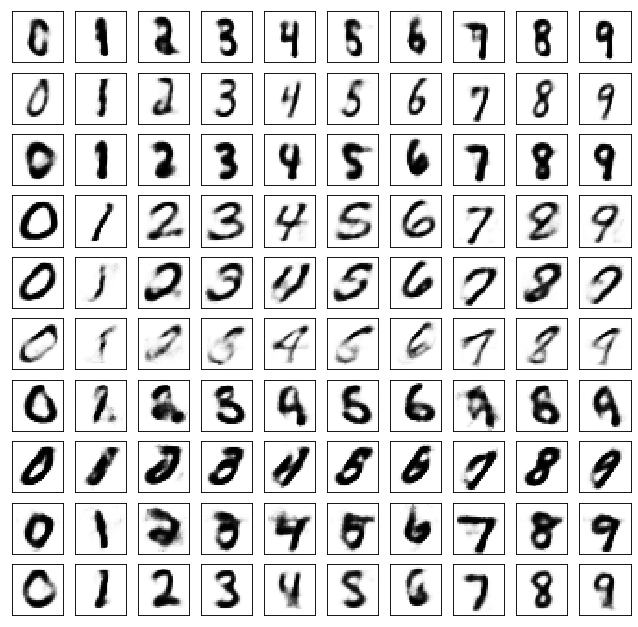

	reconstruction


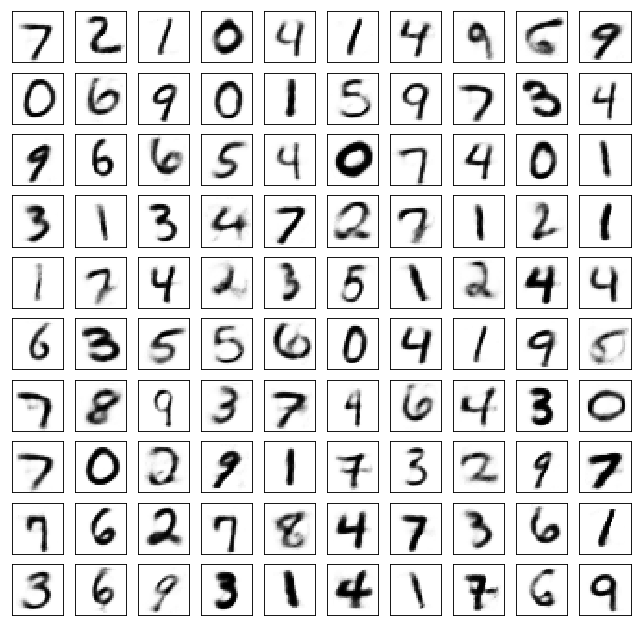

Test losses. E: 0.7057, AE: 0.0686, D: 0.6957
Train Epoch: 74 [0/50000 (0%)]	Losses E: 0.7084, AE: 0.0670, D: 0.6970
Train Epoch: 74 [25000/50000 (50%)]	Losses E: 0.6837, AE: 0.0626, D: 0.6925
Train Epoch: 74 [50000/50000 (100%)]	Losses E: 0.6871, AE: 0.0610, D: 0.6951
	generation


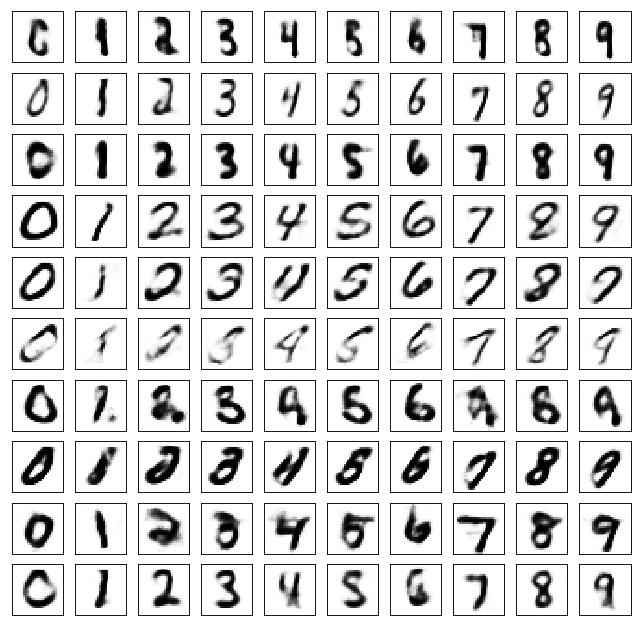

	reconstruction


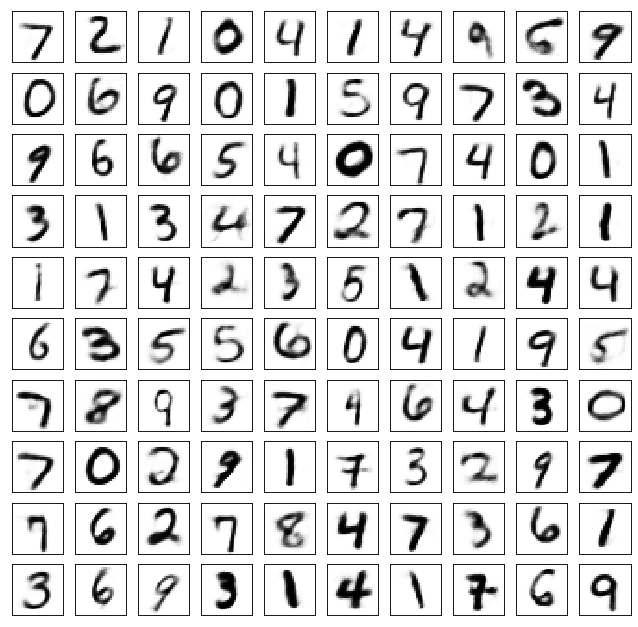

Test losses. E: 0.6870, AE: 0.0637, D: 0.6932
Train Epoch: 75 [0/50000 (0%)]	Losses E: 0.6876, AE: 0.0629, D: 0.6941
Train Epoch: 75 [25000/50000 (50%)]	Losses E: 0.6857, AE: 0.0663, D: 0.6932
Train Epoch: 75 [50000/50000 (100%)]	Losses E: 0.6736, AE: 0.0625, D: 0.6930
	generation


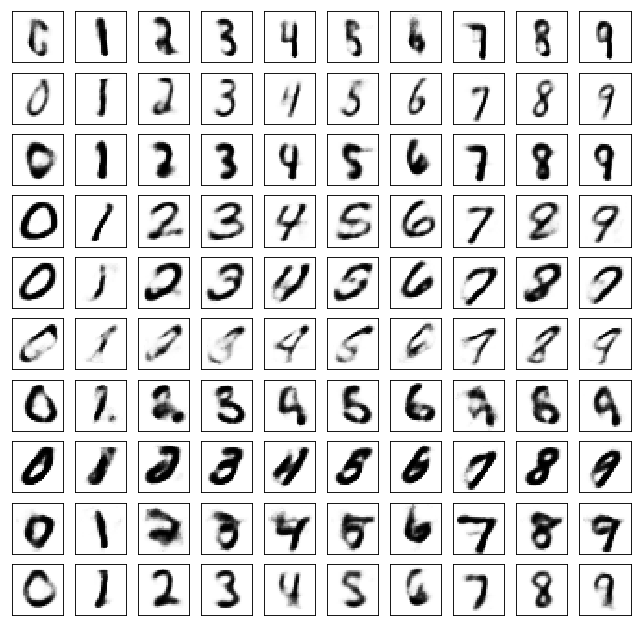

	reconstruction


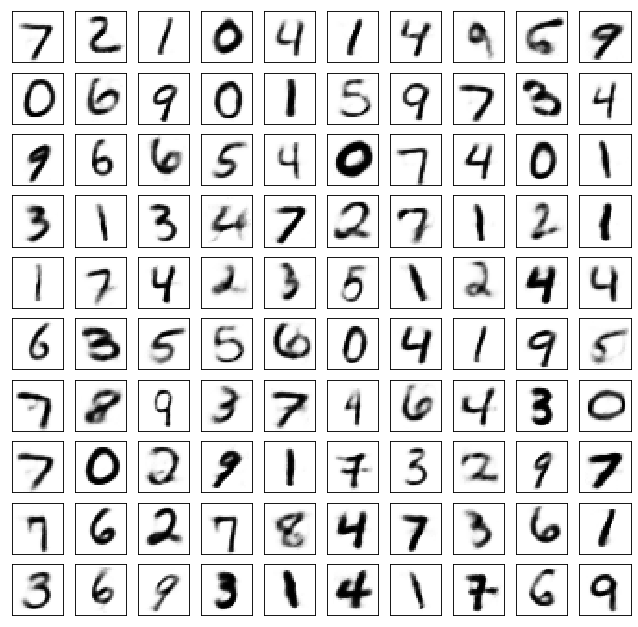

Test losses. E: 0.6756, AE: 0.0647, D: 0.6927
Train Epoch: 76 [0/50000 (0%)]	Losses E: 0.6758, AE: 0.0591, D: 0.6951
Train Epoch: 76 [25000/50000 (50%)]	Losses E: 0.6801, AE: 0.0637, D: 0.6966
Train Epoch: 76 [50000/50000 (100%)]	Losses E: 0.6903, AE: 0.0559, D: 0.6903
	generation


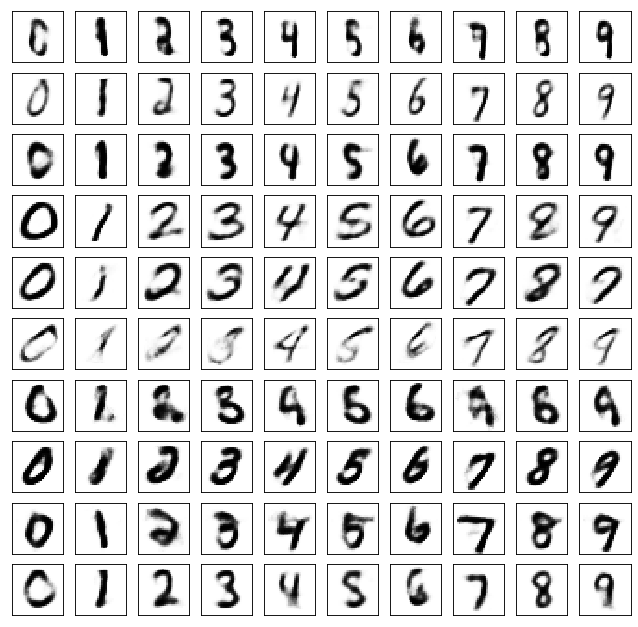

	reconstruction


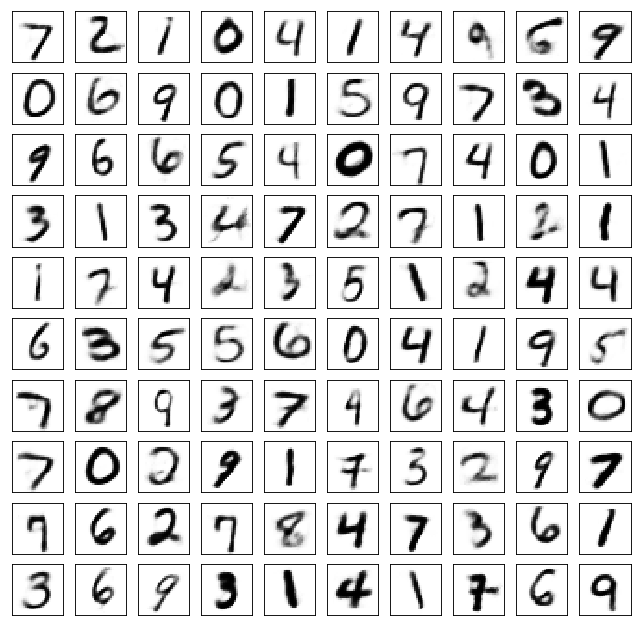

Test losses. E: 0.6858, AE: 0.0630, D: 0.6928
Train Epoch: 77 [0/50000 (0%)]	Losses E: 0.6897, AE: 0.0572, D: 0.6933
Train Epoch: 77 [25000/50000 (50%)]	Losses E: 0.6857, AE: 0.0589, D: 0.6941
Train Epoch: 77 [50000/50000 (100%)]	Losses E: 0.7020, AE: 0.0632, D: 0.6972
	generation


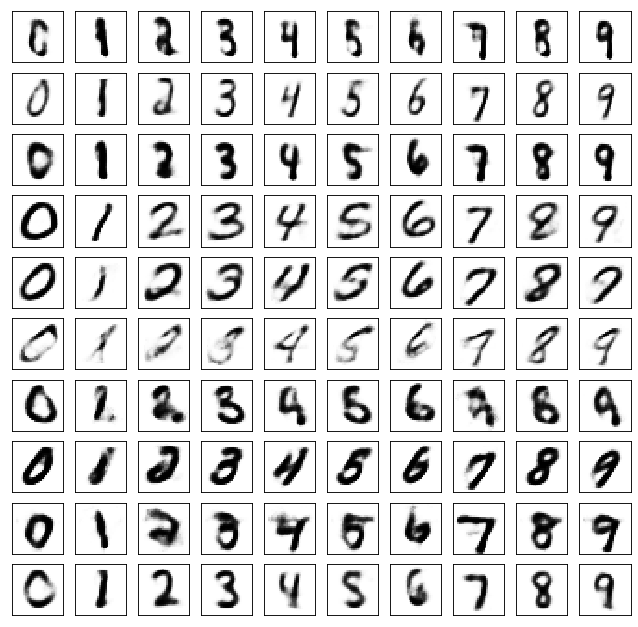

	reconstruction


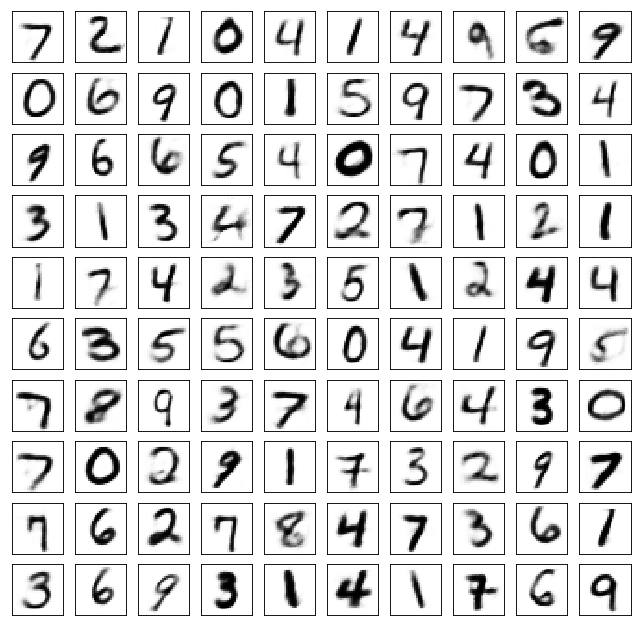

Test losses. E: 0.7046, AE: 0.0645, D: 0.6945
Train Epoch: 78 [0/50000 (0%)]	Losses E: 0.7041, AE: 0.0613, D: 0.6958
Train Epoch: 78 [25000/50000 (50%)]	Losses E: 0.6820, AE: 0.0628, D: 0.6949
Train Epoch: 78 [50000/50000 (100%)]	Losses E: 0.6983, AE: 0.0633, D: 0.6946
	generation


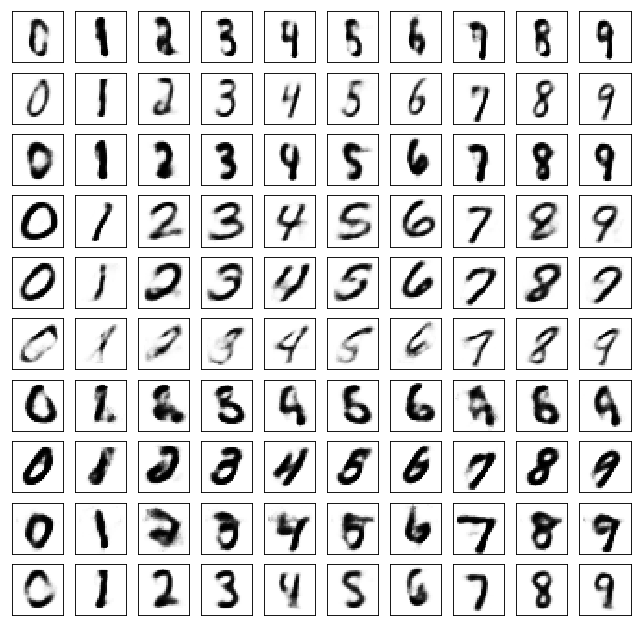

	reconstruction


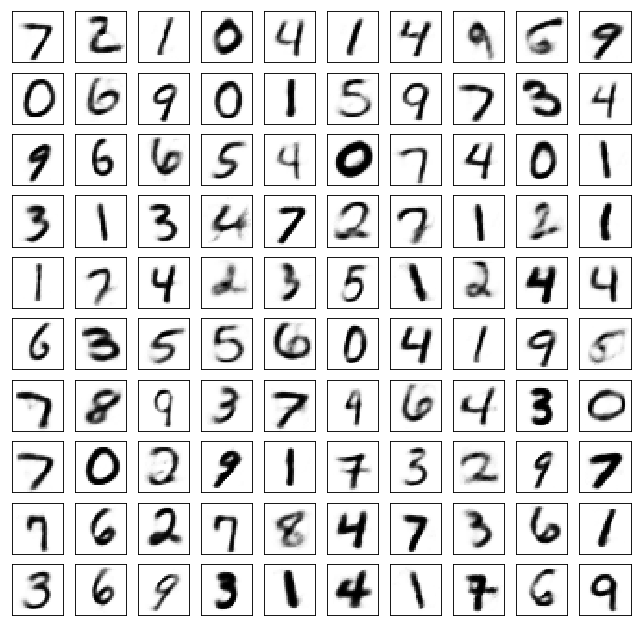

Test losses. E: 0.6962, AE: 0.0644, D: 0.6934
Train Epoch: 79 [0/50000 (0%)]	Losses E: 0.6990, AE: 0.0621, D: 0.6923
Train Epoch: 79 [25000/50000 (50%)]	Losses E: 0.6859, AE: 0.0599, D: 0.6947
Train Epoch: 79 [50000/50000 (100%)]	Losses E: 0.7143, AE: 0.0548, D: 0.6904
	generation


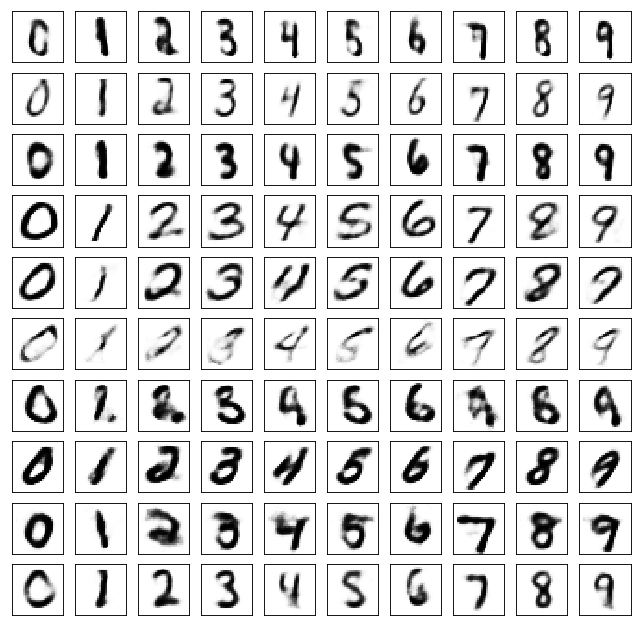

	reconstruction


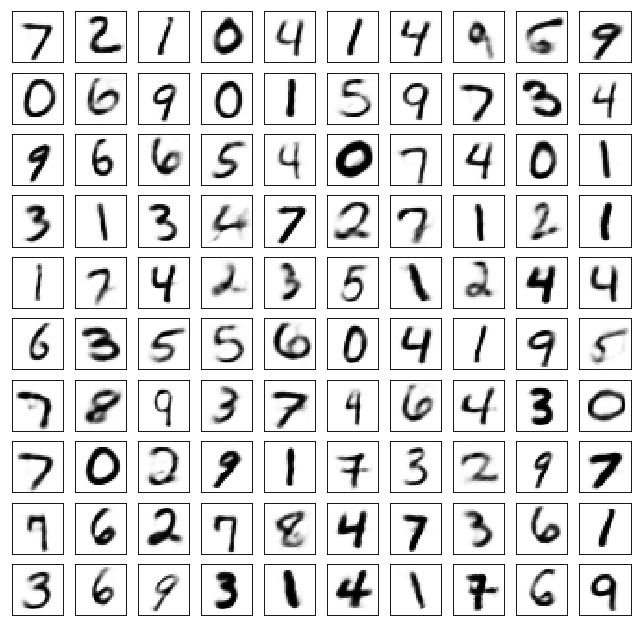

Test losses. E: 0.7094, AE: 0.0623, D: 0.6929
Train Epoch: 80 [0/50000 (0%)]	Losses E: 0.7118, AE: 0.0599, D: 0.6918
Train Epoch: 80 [25000/50000 (50%)]	Losses E: 0.6933, AE: 0.0609, D: 0.6943
Train Epoch: 80 [50000/50000 (100%)]	Losses E: 0.6974, AE: 0.0604, D: 0.6939
	generation


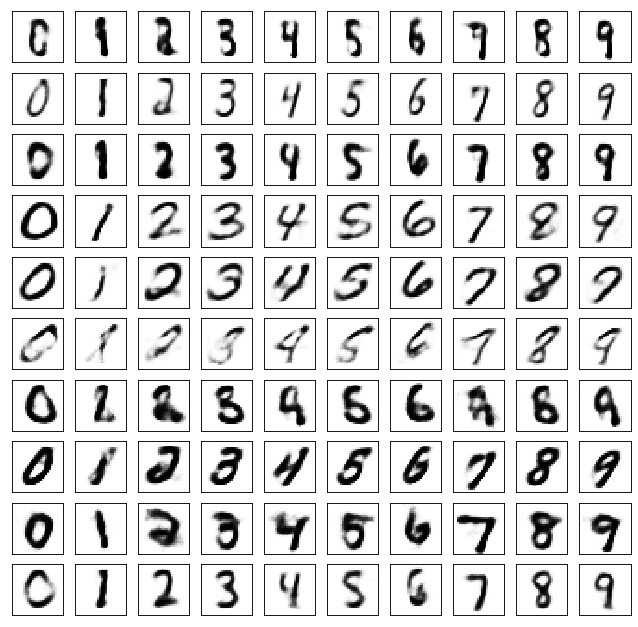

	reconstruction


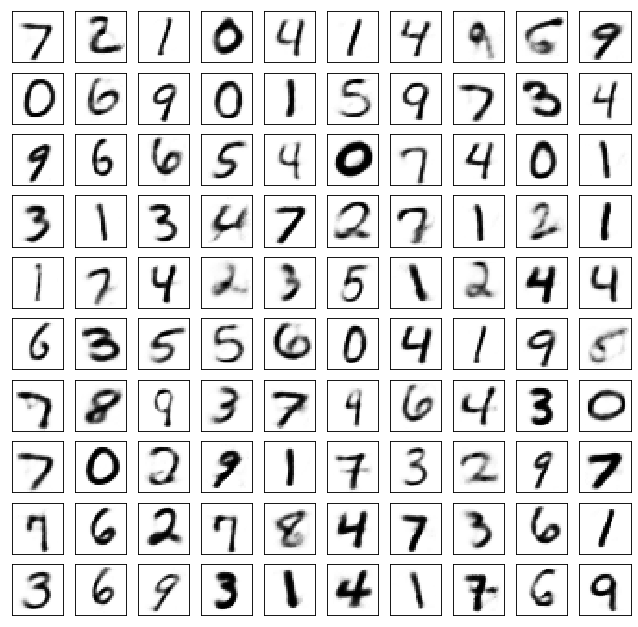

Test losses. E: 0.6959, AE: 0.0650, D: 0.6947
Train Epoch: 81 [0/50000 (0%)]	Losses E: 0.6937, AE: 0.0626, D: 0.6951
Train Epoch: 81 [25000/50000 (50%)]	Losses E: 0.6932, AE: 0.0618, D: 0.6911
Train Epoch: 81 [50000/50000 (100%)]	Losses E: 0.6915, AE: 0.0607, D: 0.6926
	generation


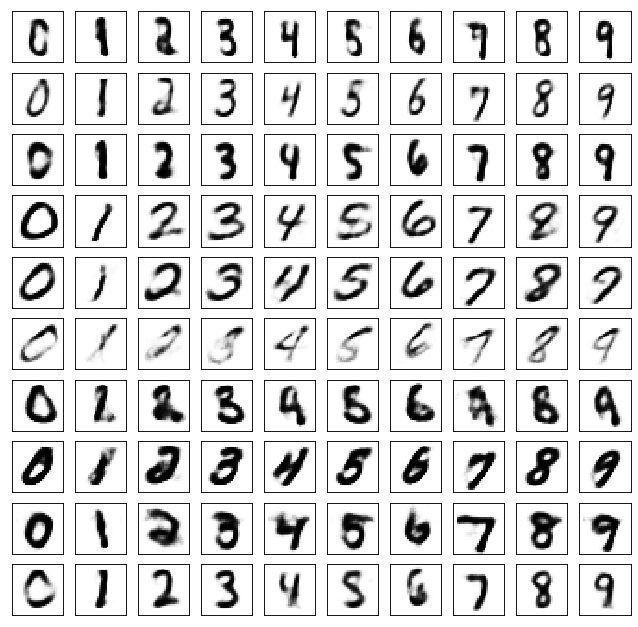

	reconstruction


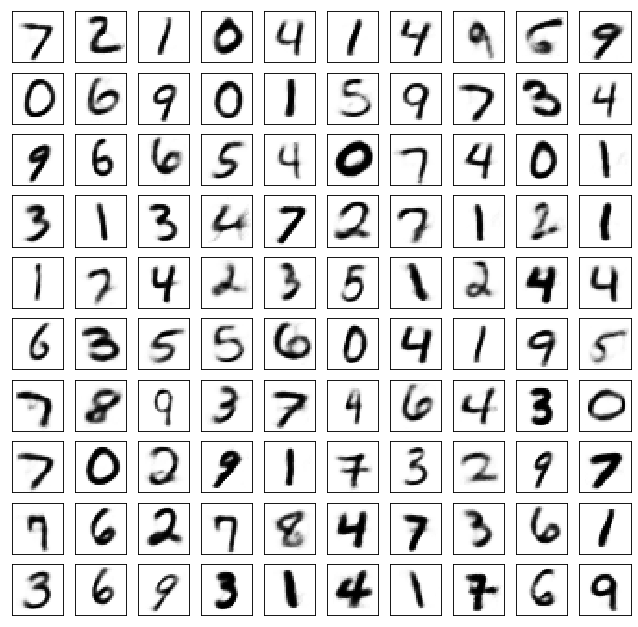

Test losses. E: 0.6919, AE: 0.0640, D: 0.6924
Train Epoch: 82 [0/50000 (0%)]	Losses E: 0.6889, AE: 0.0605, D: 0.6923
Train Epoch: 82 [25000/50000 (50%)]	Losses E: 0.6915, AE: 0.0596, D: 0.6963
Train Epoch: 82 [50000/50000 (100%)]	Losses E: 0.7177, AE: 0.0647, D: 0.6962
	generation


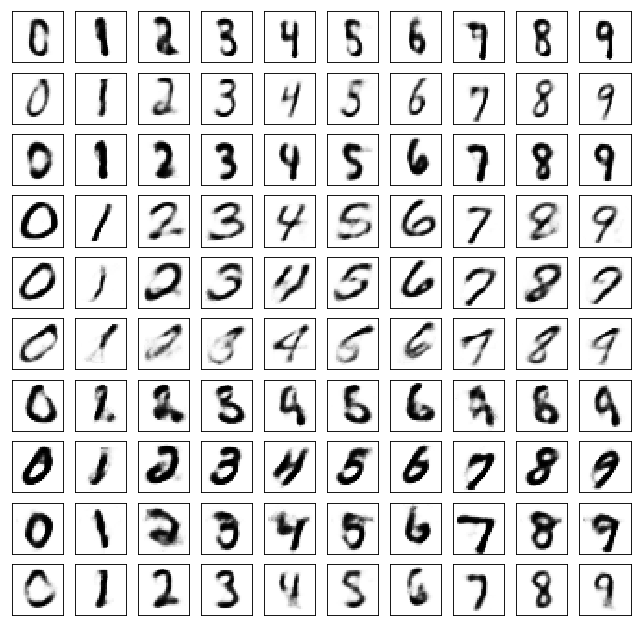

	reconstruction


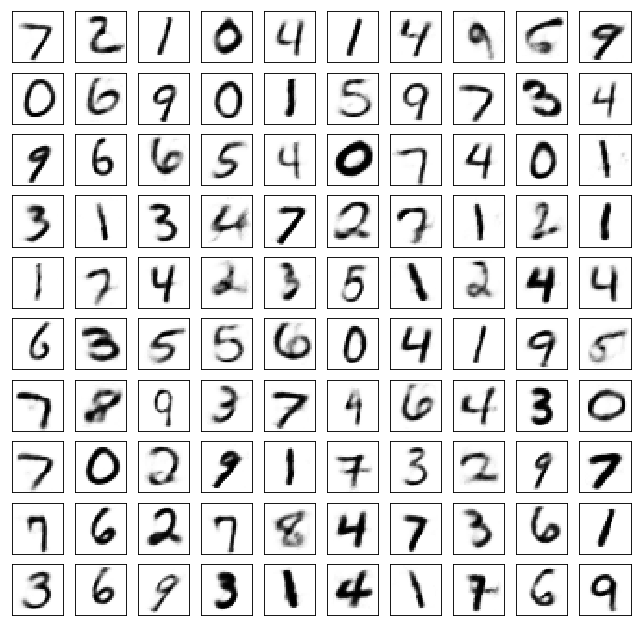

Test losses. E: 0.7199, AE: 0.0645, D: 0.6933
Train Epoch: 83 [0/50000 (0%)]	Losses E: 0.7228, AE: 0.0640, D: 0.6943
Train Epoch: 83 [25000/50000 (50%)]	Losses E: 0.7012, AE: 0.0532, D: 0.6939
Train Epoch: 83 [50000/50000 (100%)]	Losses E: 0.6989, AE: 0.0589, D: 0.6929
	generation


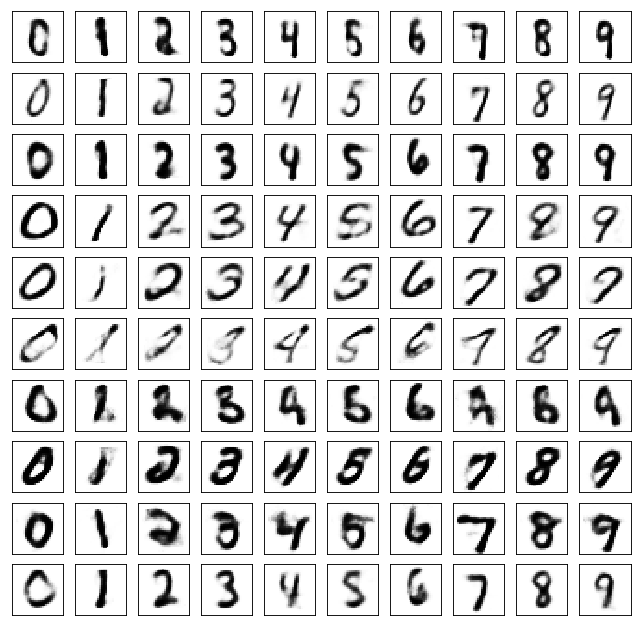

	reconstruction


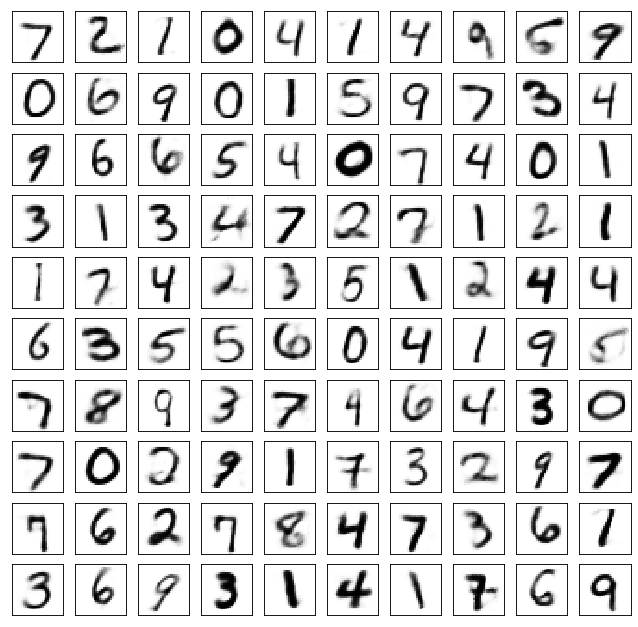

Test losses. E: 0.6973, AE: 0.0617, D: 0.6937
Train Epoch: 84 [0/50000 (0%)]	Losses E: 0.6972, AE: 0.0573, D: 0.6952
Train Epoch: 84 [25000/50000 (50%)]	Losses E: 0.6815, AE: 0.0618, D: 0.6975
Train Epoch: 84 [50000/50000 (100%)]	Losses E: 0.6960, AE: 0.0612, D: 0.6942
	generation


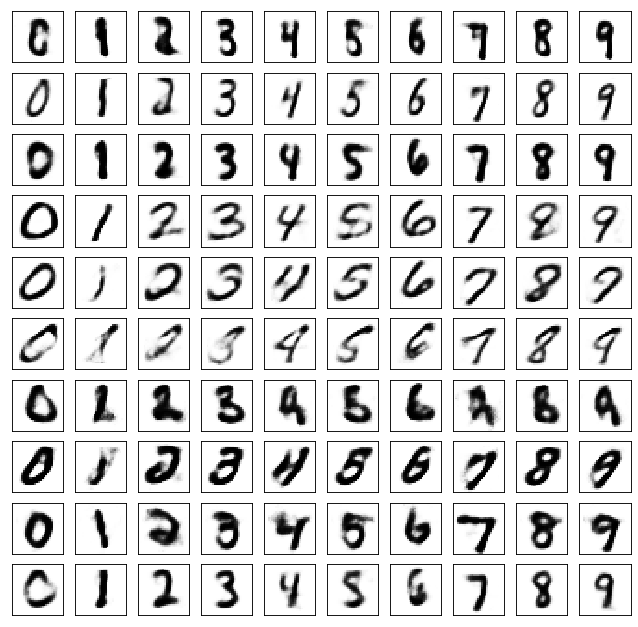

	reconstruction


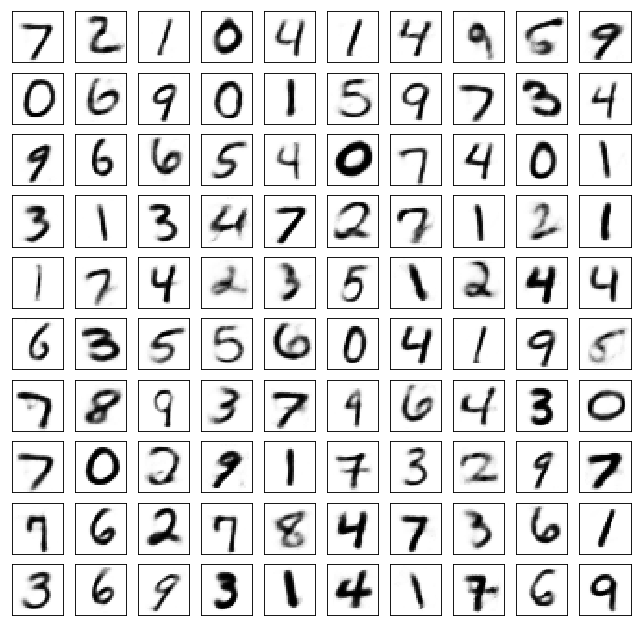

Test losses. E: 0.6948, AE: 0.0636, D: 0.6939
Train Epoch: 85 [0/50000 (0%)]	Losses E: 0.6947, AE: 0.0614, D: 0.6946
Train Epoch: 85 [25000/50000 (50%)]	Losses E: 0.6712, AE: 0.0626, D: 0.6959
Train Epoch: 85 [50000/50000 (100%)]	Losses E: 0.6731, AE: 0.0662, D: 0.6972
	generation


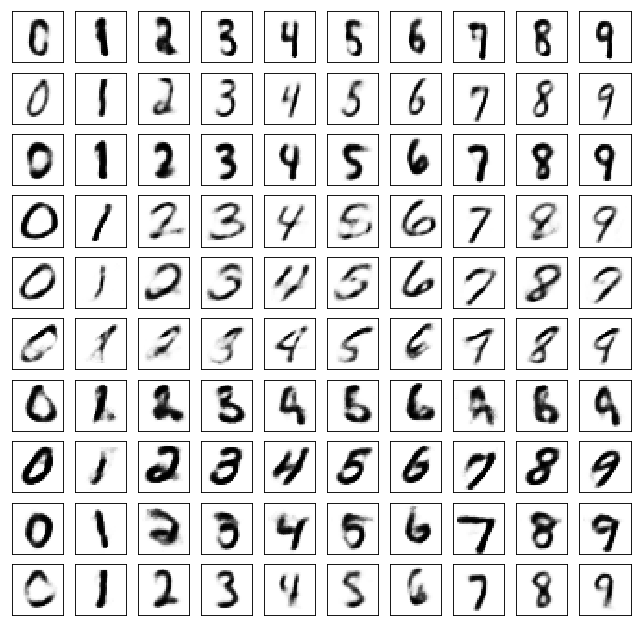

	reconstruction


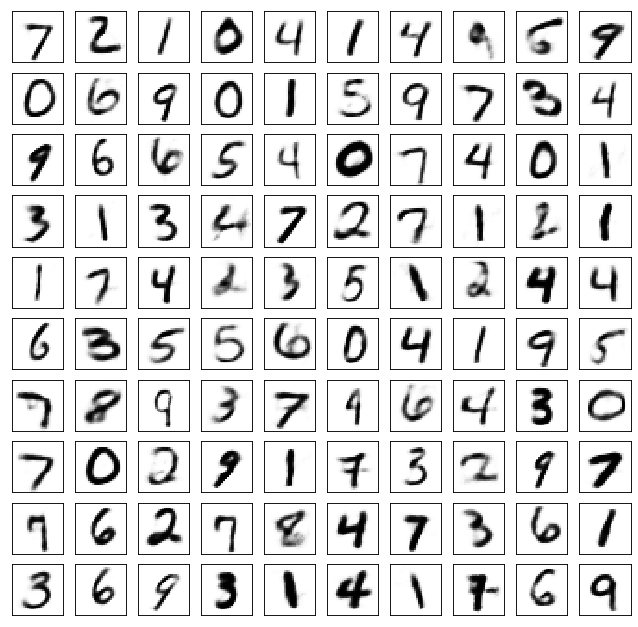

Test losses. E: 0.6758, AE: 0.0656, D: 0.6958
Train Epoch: 86 [0/50000 (0%)]	Losses E: 0.6786, AE: 0.0590, D: 0.6972
Train Epoch: 86 [25000/50000 (50%)]	Losses E: 0.7019, AE: 0.0578, D: 0.6924
Train Epoch: 86 [50000/50000 (100%)]	Losses E: 0.7017, AE: 0.0563, D: 0.6925
	generation


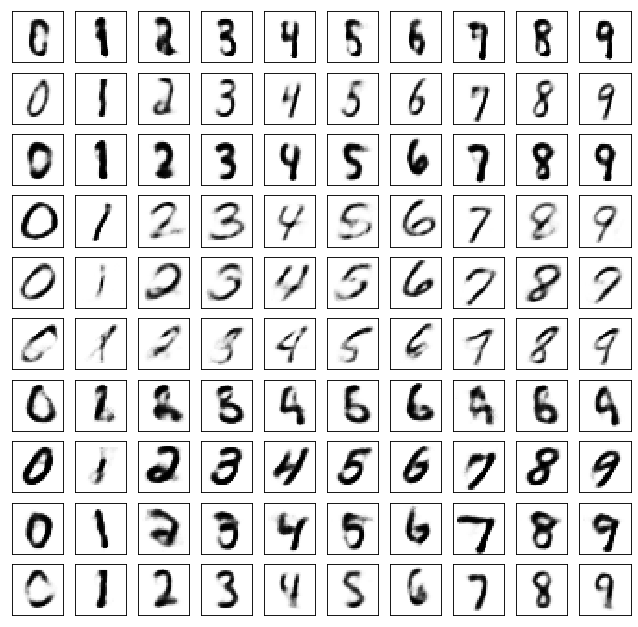

	reconstruction


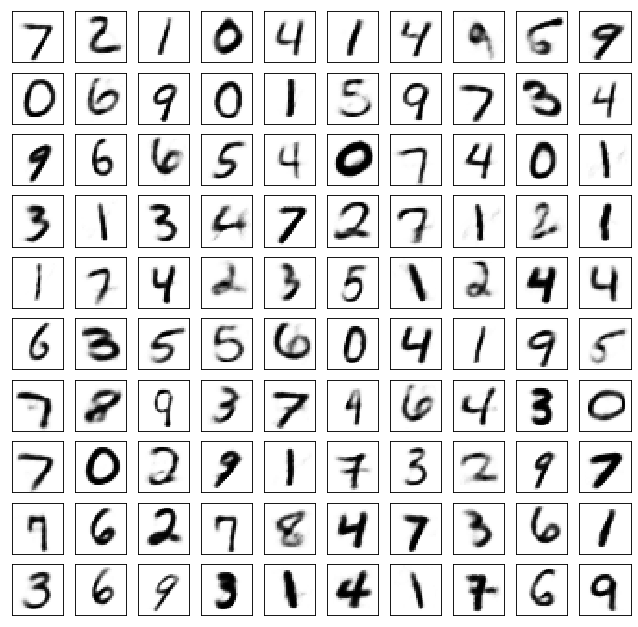

Test losses. E: 0.7000, AE: 0.0609, D: 0.6936
Train Epoch: 87 [0/50000 (0%)]	Losses E: 0.6994, AE: 0.0595, D: 0.6932
Train Epoch: 87 [25000/50000 (50%)]	Losses E: 0.6828, AE: 0.0560, D: 0.6957
Train Epoch: 87 [50000/50000 (100%)]	Losses E: 0.6918, AE: 0.0598, D: 0.6921
	generation


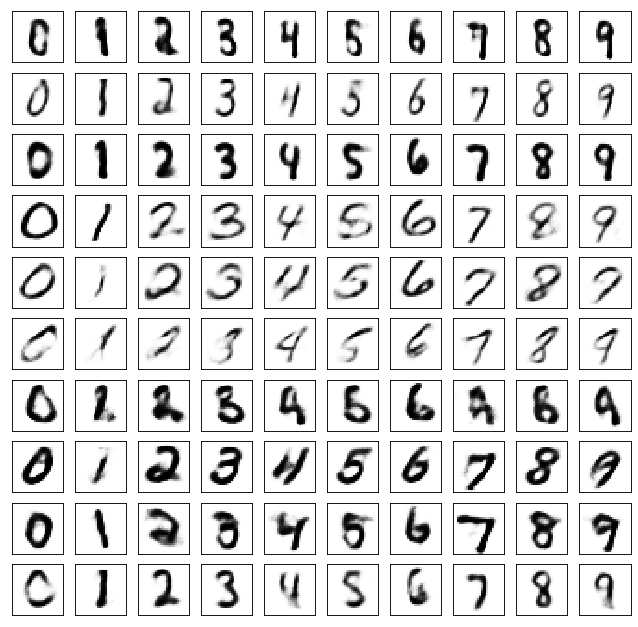

	reconstruction


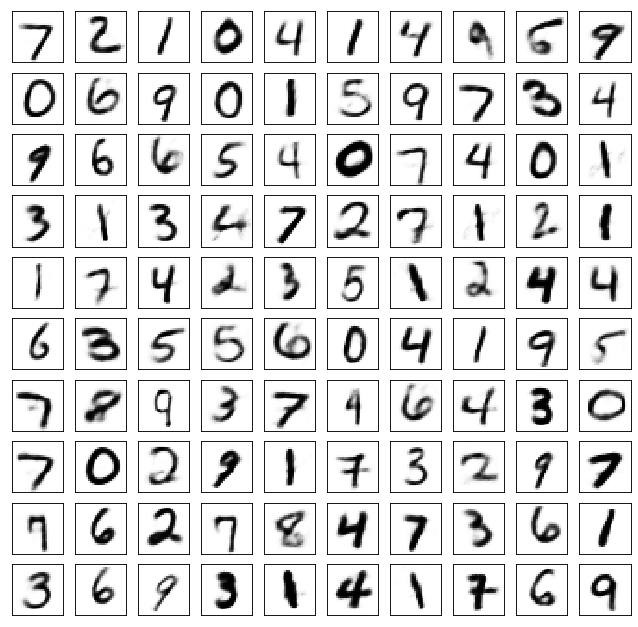

Test losses. E: 0.6903, AE: 0.0627, D: 0.6941
Train Epoch: 88 [0/50000 (0%)]	Losses E: 0.6931, AE: 0.0572, D: 0.6940
Train Epoch: 88 [25000/50000 (50%)]	Losses E: 0.7084, AE: 0.0565, D: 0.6937
Train Epoch: 88 [50000/50000 (100%)]	Losses E: 0.6936, AE: 0.0518, D: 0.6949
	generation


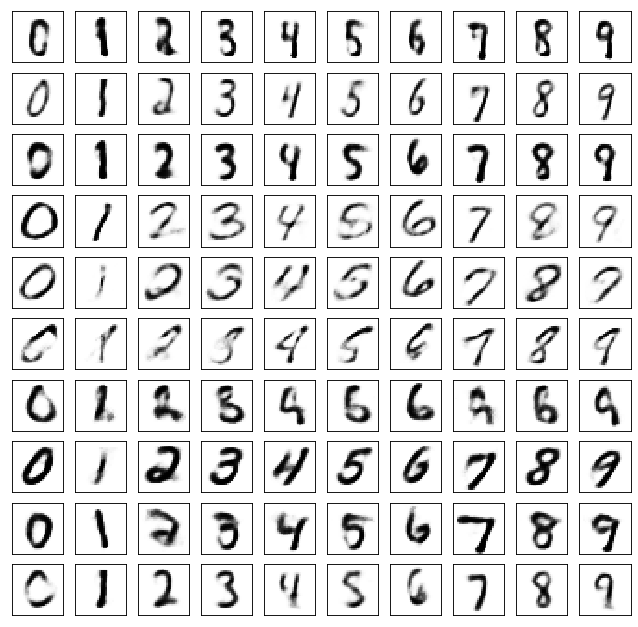

	reconstruction


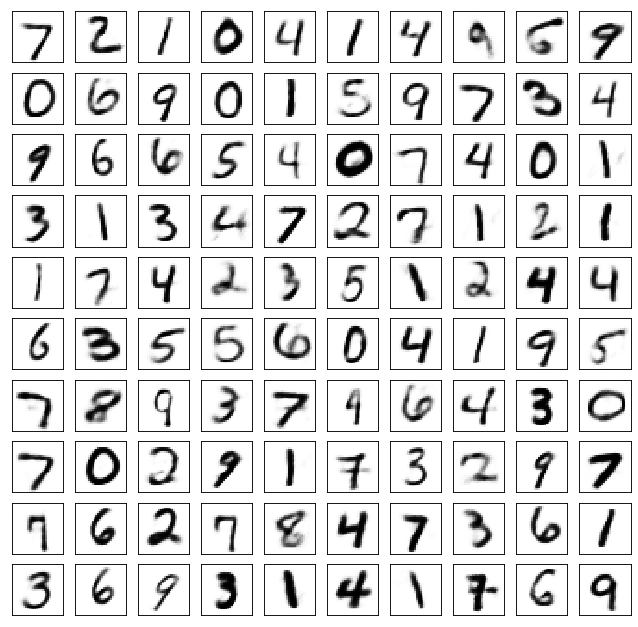

Test losses. E: 0.6972, AE: 0.0596, D: 0.6912
Train Epoch: 89 [0/50000 (0%)]	Losses E: 0.6970, AE: 0.0566, D: 0.6921
Train Epoch: 89 [25000/50000 (50%)]	Losses E: 0.6798, AE: 0.0633, D: 0.6947
Train Epoch: 89 [50000/50000 (100%)]	Losses E: 0.6971, AE: 0.0547, D: 0.6926
	generation


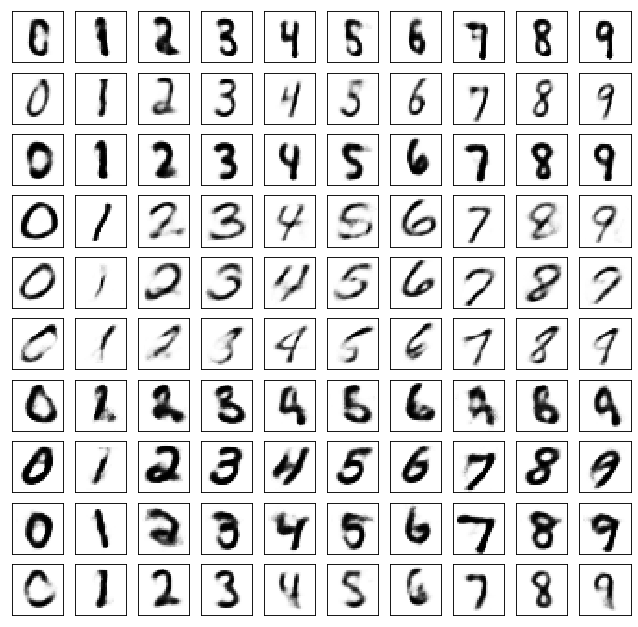

	reconstruction


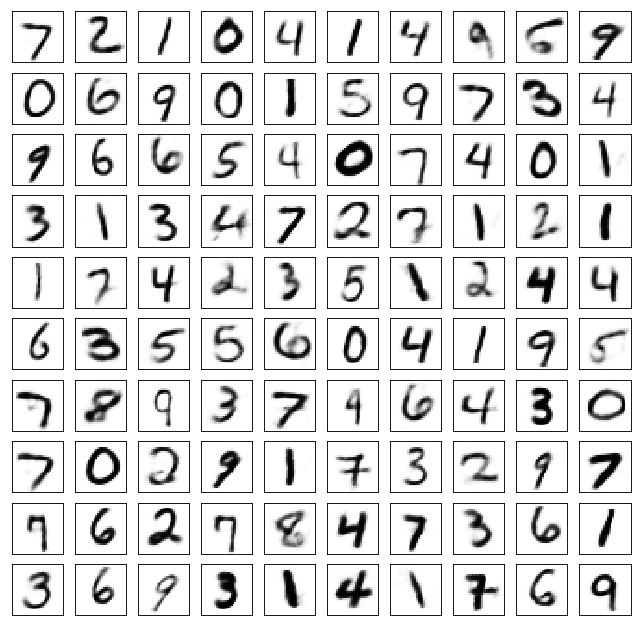

Test losses. E: 0.6972, AE: 0.0609, D: 0.6927
Train Epoch: 90 [0/50000 (0%)]	Losses E: 0.6974, AE: 0.0589, D: 0.6926
Train Epoch: 90 [25000/50000 (50%)]	Losses E: 0.7164, AE: 0.0529, D: 0.6928
Train Epoch: 90 [50000/50000 (100%)]	Losses E: 0.6914, AE: 0.0577, D: 0.6962
	generation


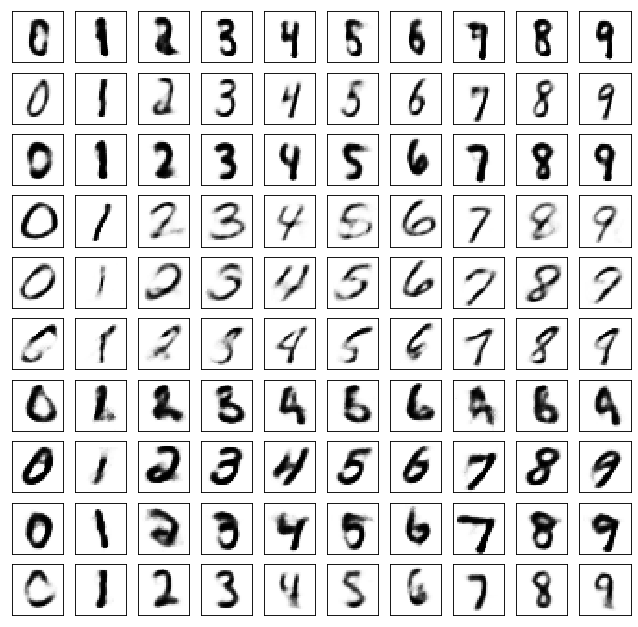

	reconstruction


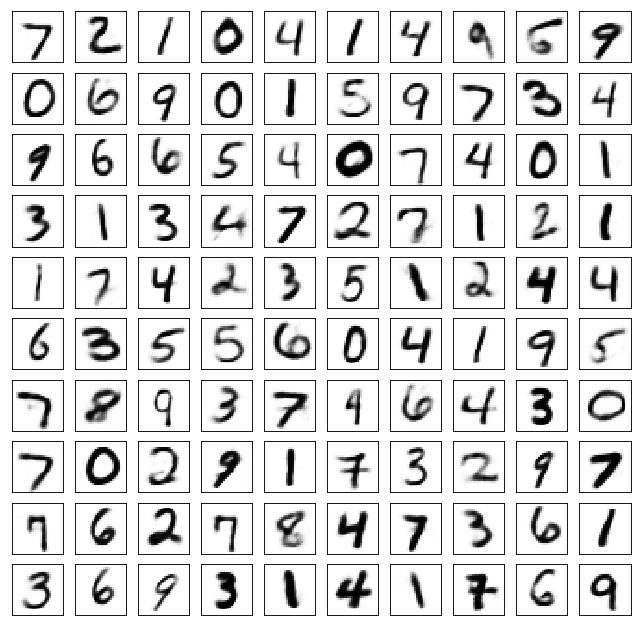

Test losses. E: 0.6921, AE: 0.0606, D: 0.6948
Train Epoch: 91 [0/50000 (0%)]	Losses E: 0.6908, AE: 0.0537, D: 0.6967
Train Epoch: 91 [25000/50000 (50%)]	Losses E: 0.6758, AE: 0.0542, D: 0.6938
Train Epoch: 91 [50000/50000 (100%)]	Losses E: 0.6846, AE: 0.0588, D: 0.6956
	generation


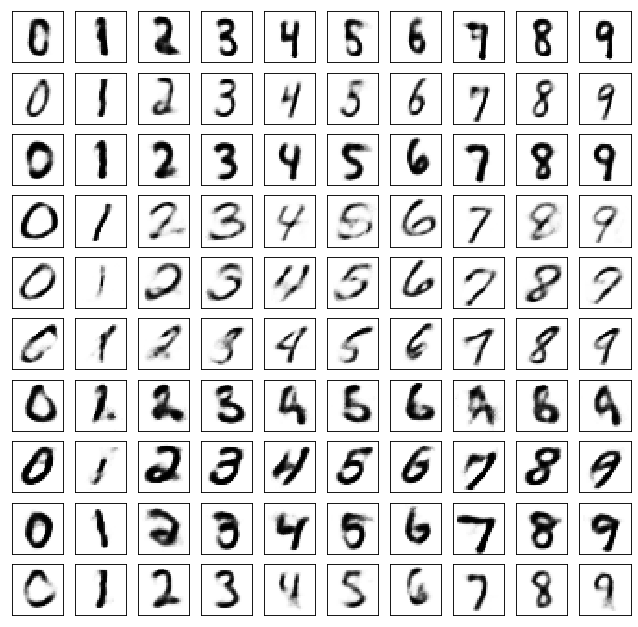

	reconstruction


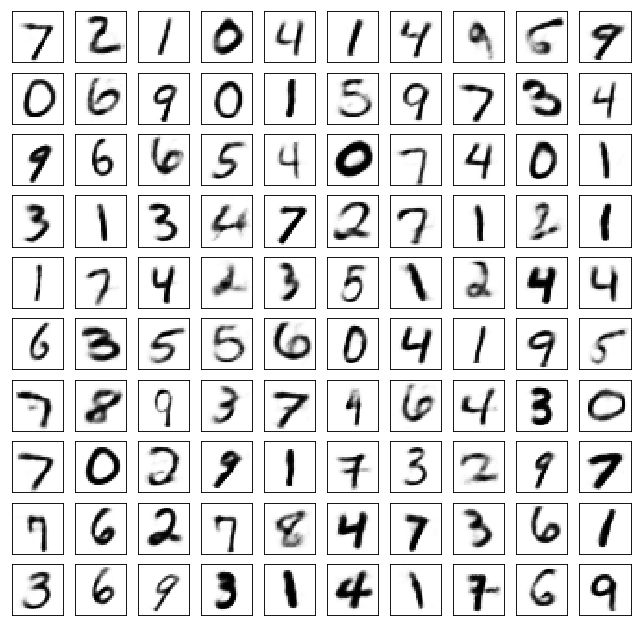

Test losses. E: 0.6855, AE: 0.0614, D: 0.6946
Train Epoch: 92 [0/50000 (0%)]	Losses E: 0.6877, AE: 0.0590, D: 0.6933
Train Epoch: 92 [25000/50000 (50%)]	Losses E: 0.7057, AE: 0.0550, D: 0.6948
Train Epoch: 92 [50000/50000 (100%)]	Losses E: 0.7162, AE: 0.0579, D: 0.6945
	generation


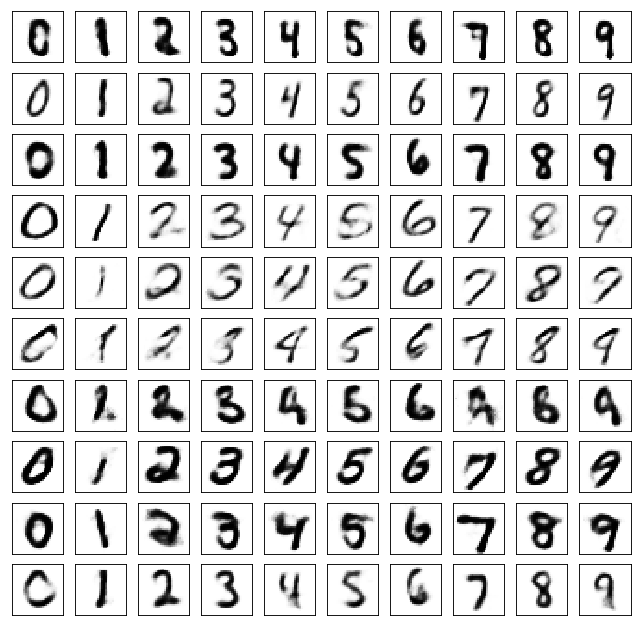

	reconstruction


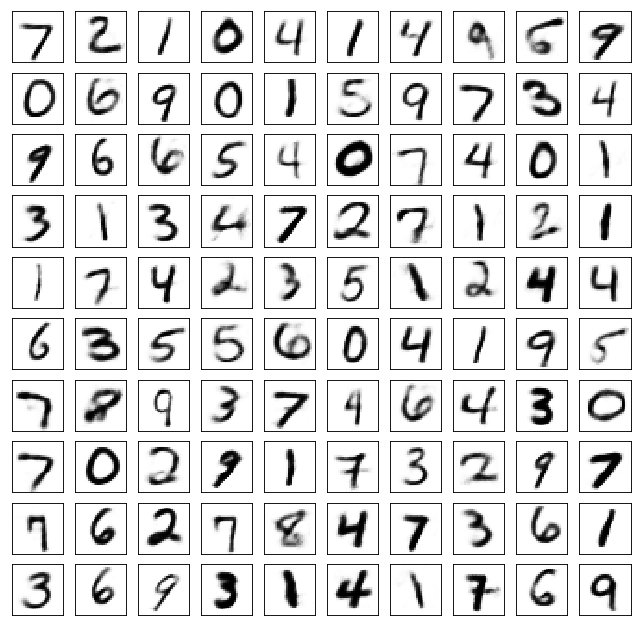

Test losses. E: 0.7139, AE: 0.0618, D: 0.6953
Train Epoch: 93 [0/50000 (0%)]	Losses E: 0.7146, AE: 0.0550, D: 0.6975
Train Epoch: 93 [25000/50000 (50%)]	Losses E: 0.6912, AE: 0.0517, D: 0.6951
Train Epoch: 93 [50000/50000 (100%)]	Losses E: 0.6989, AE: 0.0538, D: 0.6936
	generation


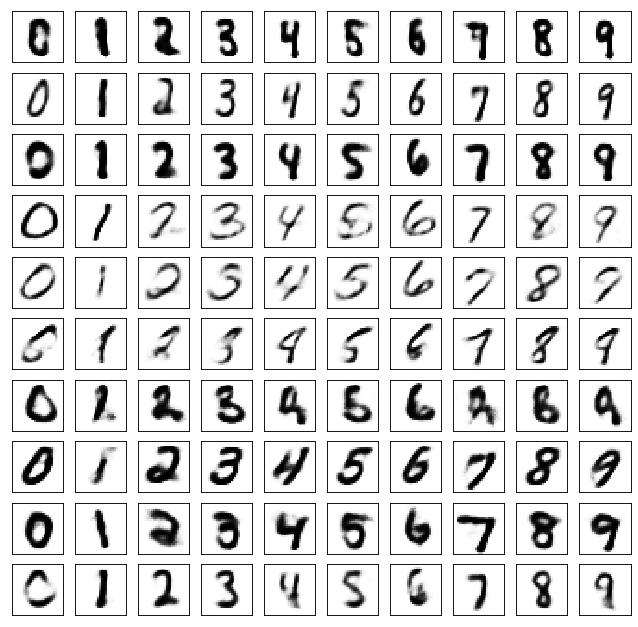

	reconstruction


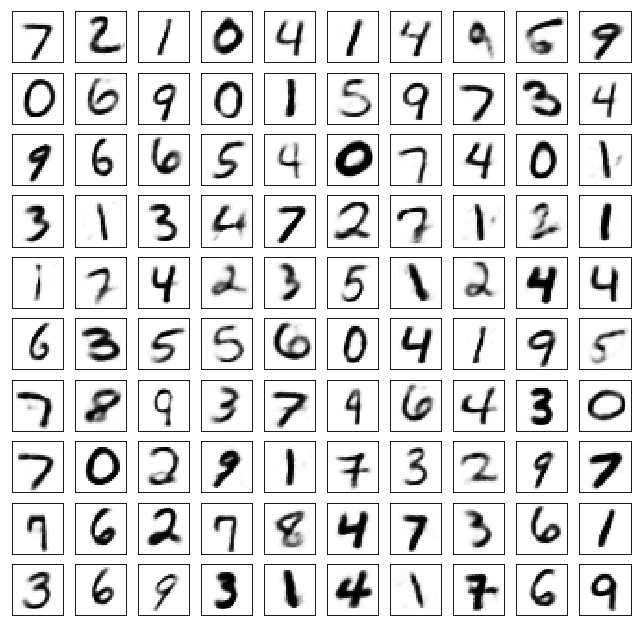

Test losses. E: 0.6962, AE: 0.0609, D: 0.6945
Train Epoch: 94 [0/50000 (0%)]	Losses E: 0.6932, AE: 0.0586, D: 0.6949
Train Epoch: 94 [25000/50000 (50%)]	Losses E: 0.6790, AE: 0.0572, D: 0.6960
Train Epoch: 94 [50000/50000 (100%)]	Losses E: 0.6734, AE: 0.0561, D: 0.6923
	generation


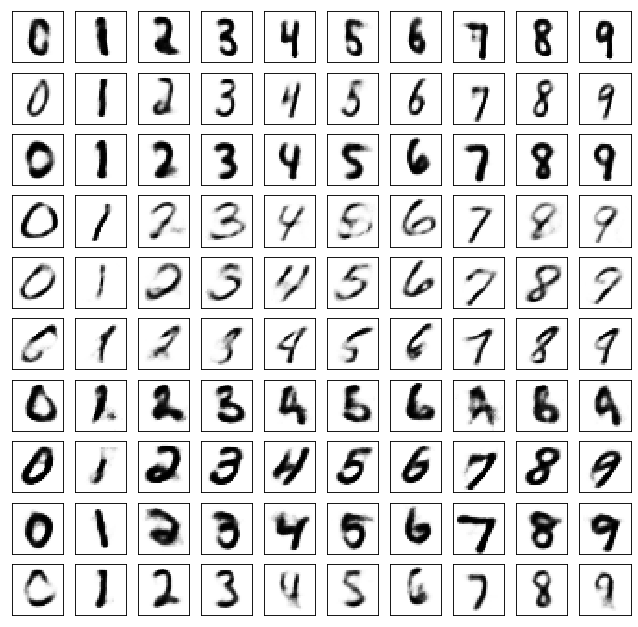

	reconstruction


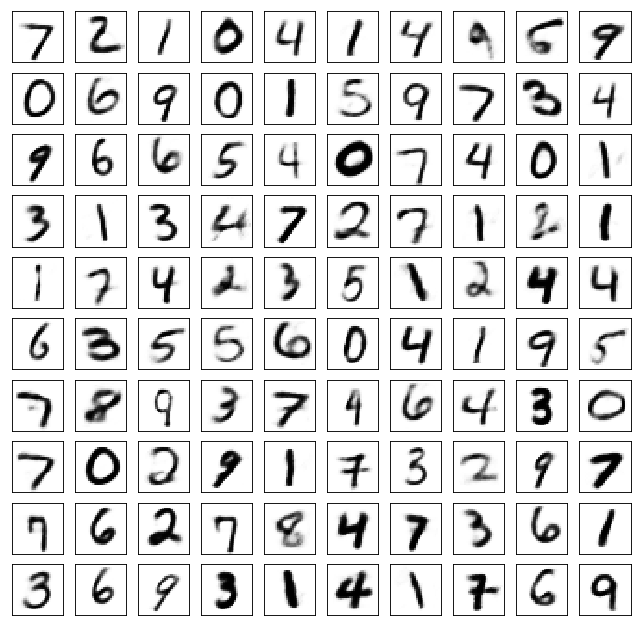

Test losses. E: 0.6727, AE: 0.0606, D: 0.6942
Train Epoch: 95 [0/50000 (0%)]	Losses E: 0.6727, AE: 0.0550, D: 0.6931
Train Epoch: 95 [25000/50000 (50%)]	Losses E: 0.7096, AE: 0.0544, D: 0.6938
Train Epoch: 95 [50000/50000 (100%)]	Losses E: 0.6995, AE: 0.0549, D: 0.6924
	generation


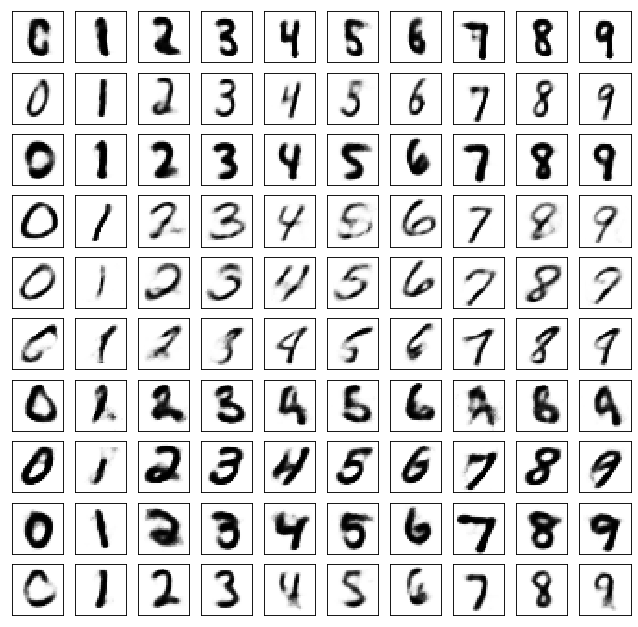

	reconstruction


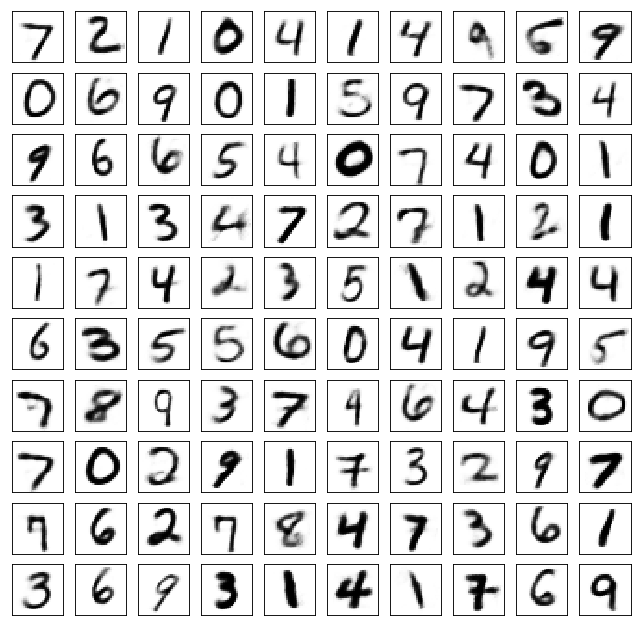

Test losses. E: 0.6977, AE: 0.0582, D: 0.6925
Train Epoch: 96 [0/50000 (0%)]	Losses E: 0.6959, AE: 0.0510, D: 0.6926
Train Epoch: 96 [25000/50000 (50%)]	Losses E: 0.7024, AE: 0.0531, D: 0.6898
Train Epoch: 96 [50000/50000 (100%)]	Losses E: 0.6967, AE: 0.0559, D: 0.6903
	generation


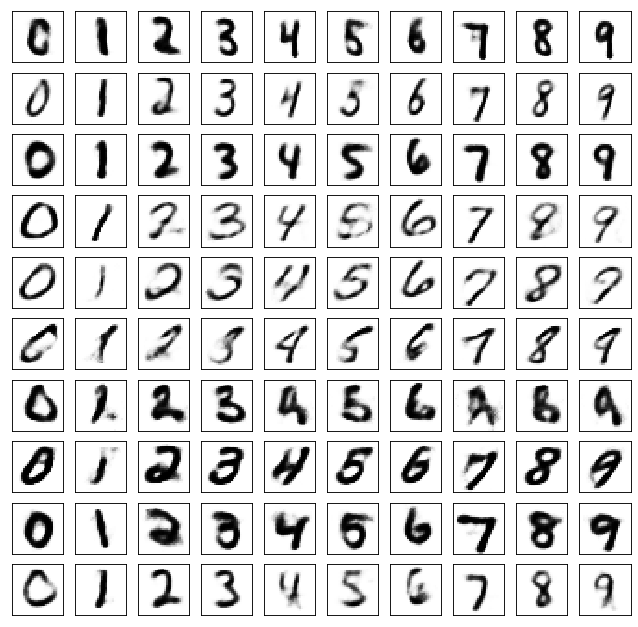

	reconstruction


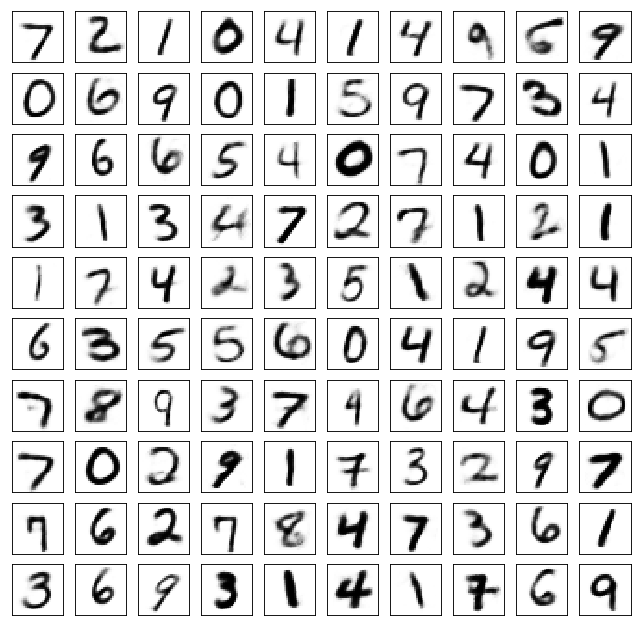

Test losses. E: 0.6940, AE: 0.0583, D: 0.6910
Train Epoch: 97 [0/50000 (0%)]	Losses E: 0.6942, AE: 0.0505, D: 0.6900
Train Epoch: 97 [25000/50000 (50%)]	Losses E: 0.6962, AE: 0.0553, D: 0.6916
Train Epoch: 97 [50000/50000 (100%)]	Losses E: 0.6941, AE: 0.0535, D: 0.6942
	generation


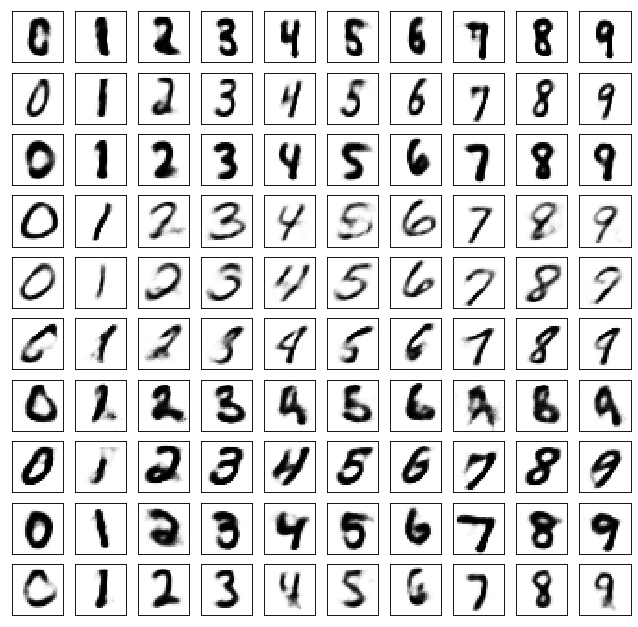

	reconstruction


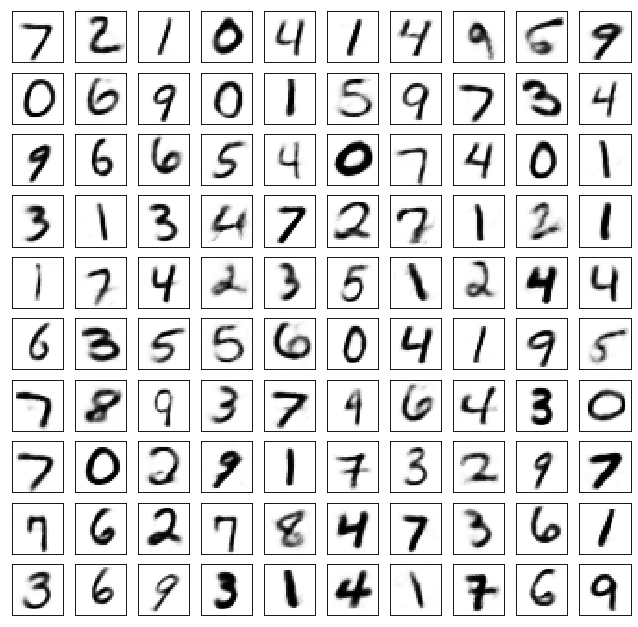

Test losses. E: 0.6951, AE: 0.0590, D: 0.6937
Train Epoch: 98 [0/50000 (0%)]	Losses E: 0.6970, AE: 0.0557, D: 0.6930
Train Epoch: 98 [25000/50000 (50%)]	Losses E: 0.6927, AE: 0.0589, D: 0.6949
Train Epoch: 98 [50000/50000 (100%)]	Losses E: 0.6766, AE: 0.0544, D: 0.6930
	generation


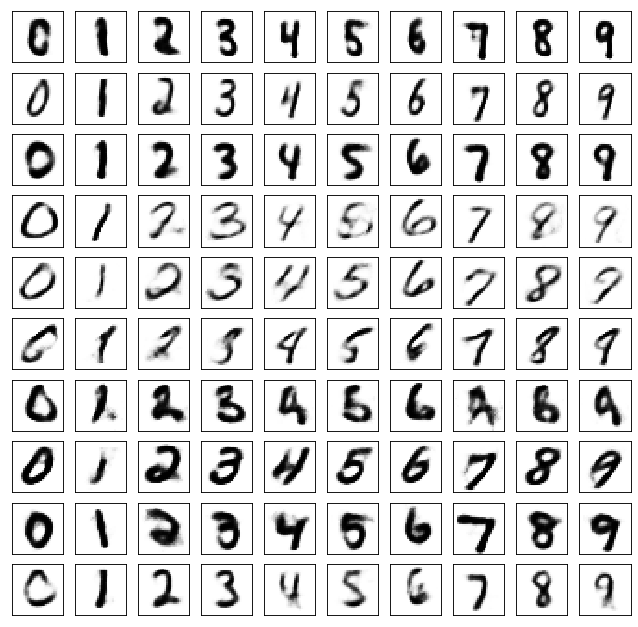

	reconstruction


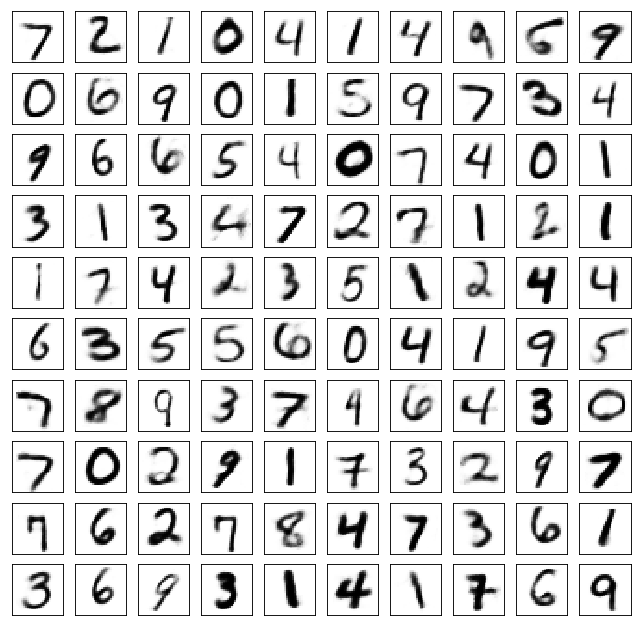

Test losses. E: 0.6746, AE: 0.0581, D: 0.6933
Train Epoch: 99 [0/50000 (0%)]	Losses E: 0.6797, AE: 0.0498, D: 0.6916
Train Epoch: 99 [25000/50000 (50%)]	Losses E: 0.6950, AE: 0.0517, D: 0.6909
Train Epoch: 99 [50000/50000 (100%)]	Losses E: 0.6926, AE: 0.0545, D: 0.6906
	generation


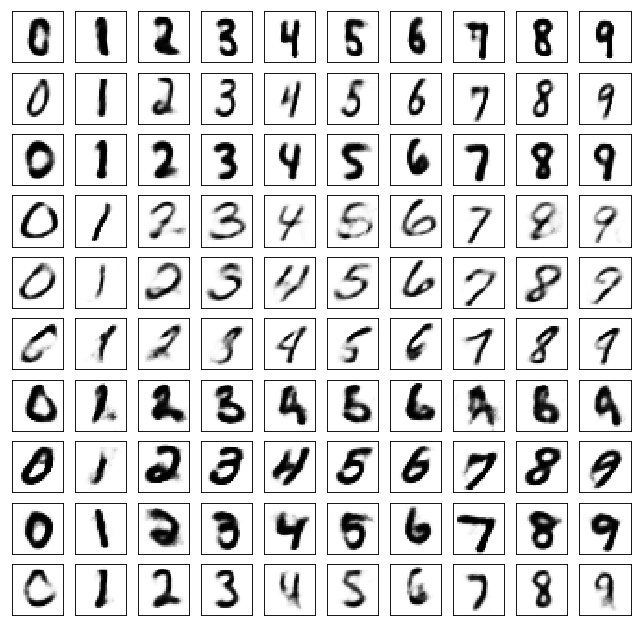

	reconstruction


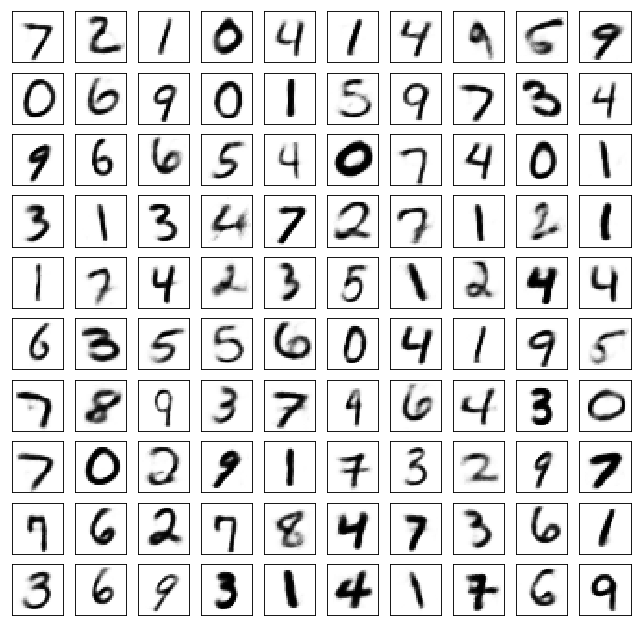

Test losses. E: 0.6897, AE: 0.0588, D: 0.6936
Train Epoch: 100 [0/50000 (0%)]	Losses E: 0.6874, AE: 0.0571, D: 0.6954
Train Epoch: 100 [25000/50000 (50%)]	Losses E: 0.6778, AE: 0.0507, D: 0.6940
Train Epoch: 100 [50000/50000 (100%)]	Losses E: 0.7078, AE: 0.0533, D: 0.6958
	generation


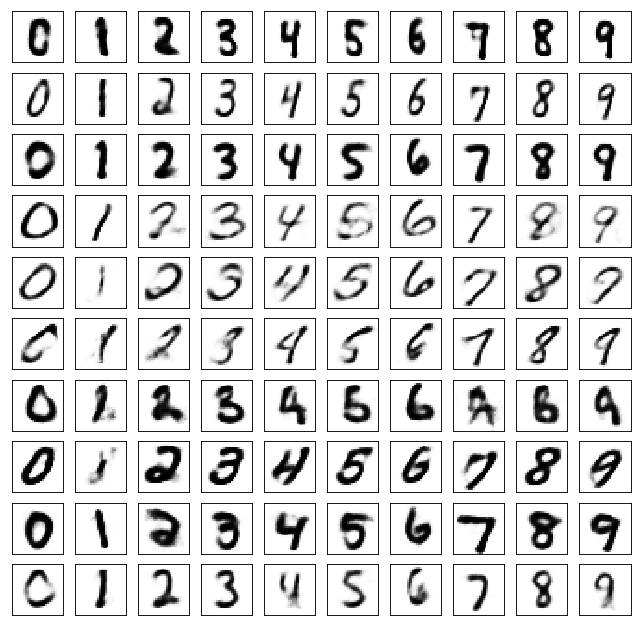

	reconstruction


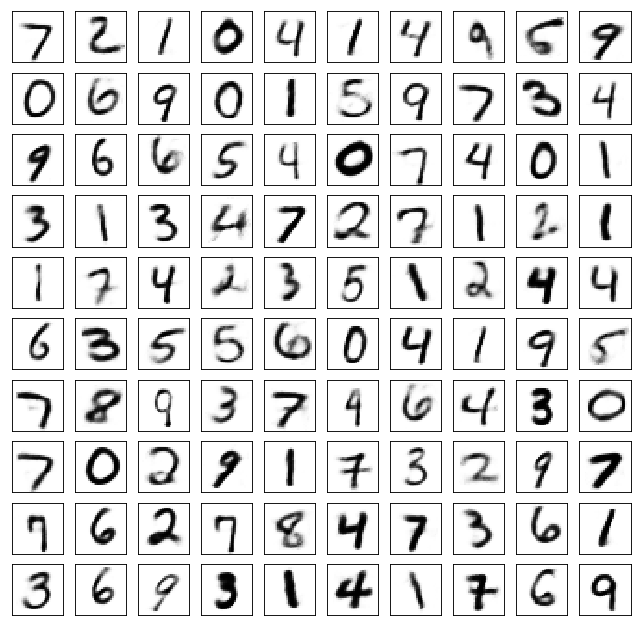

Test losses. E: 0.7067, AE: 0.0590, D: 0.6948
CPU times: user 48min 35s, sys: 2min 9s, total: 50min 44s
Wall time: 50min 51s


In [28]:
%%time

for epoch in range(1, train_epoch + 1):
    coders[variant]["Enc"].train()
    coders[variant]["Dec"].train()
    coders[variant]["Disc"].train()
    train(epoch, 
          coders[variant]["Enc"],
          coders[variant]["Dec"],
          coders[variant]["Disc"], 
          logs[variant]["train"])
    coders[variant]["Enc"].eval()
    coders[variant]["Dec"].eval()
    coders[variant]["Disc"].eval()
    test(coders[variant]["Enc"],
         coders[variant]["Dec"],
         coders[variant]["Disc"], 
         valid_loader, epoch, variant, logs[variant]["test"])

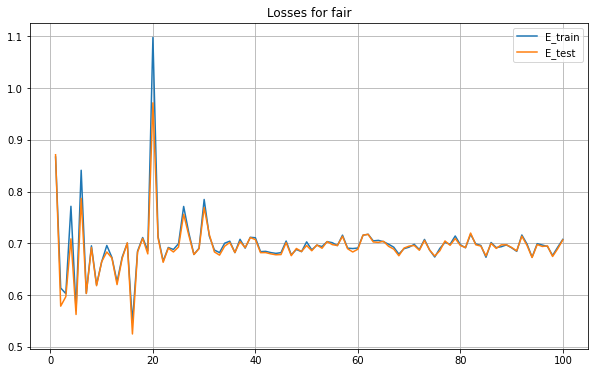

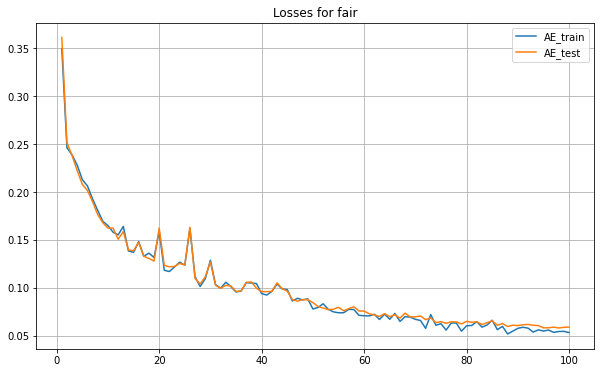

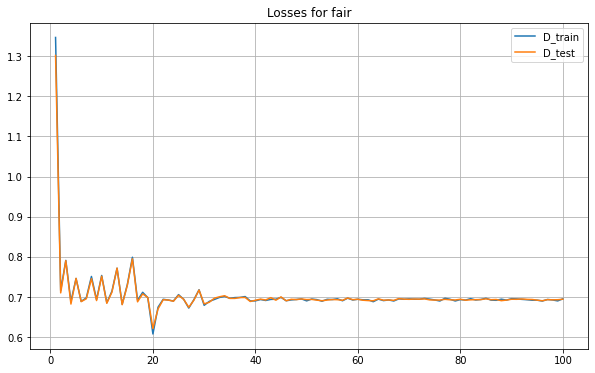

In [29]:
for item in logs[variant]["train"]:
    plt.figure(figsize=(10, 6))
    for mode in logs[variant]:
        plt.plot(range(1, len(logs[variant][mode][item]) + 1), logs[variant][mode][item], 
                 label=f"{item}_{mode}")
    plt.title(f"Losses for {variant}")
    plt.legend()
    plt.grid()
    plt.show()

## Классификатор

In [30]:
init_class = FullyConnected([28*28, 1024, 1024, 10], dropout=0.3, 
                            activation_fn=nn.LeakyReLU(0.2), device=device)
unfair_class = FullyConnected([prior_size, 1024, 1024, 10], dropout=0.3, 
                            activation_fn=nn.LeakyReLU(0.2), device=device)
fair_class = FullyConnected([prior_size, 1024, 1024, 10], dropout=0.3, 
                            activation_fn=nn.LeakyReLU(0.2), device=device)
classifiers = {
    'init': init_class,
    'unfair': unfair_class, 
    'fair': fair_class
}

data_processors = {
    'init': lambda x: x * 1.,
    'unfair': lambda x: coders['unfair']["Enc"](x), 
    'fair': lambda x: coders['fair']["Enc"](x)
}

train_epoch = 10

In [31]:
 def train_class(epoch, model, criterion, data_loader, data_processor):
    data_size = len(data_loader.sampler)
    correct = 0
    total = 0
    for batch_idx, (data, target) in enumerate(data_loader):
        target = target.to(device)
        data = data.view(data.shape[0], -1)
        data = data_processor(data)
        optimizer.zero_grad()
        output = model(data)
        loss = criterion(output, target)
        loss.backward()
        optimizer.step()
            
        if batch_idx % 10 == 0:
            line = 'Train Epoch: {} [{}/{} ({:.0f}%)]\t\t'.format(
                epoch, batch_idx * len(data), data_size, 100. * batch_idx / len(data_loader))
            pred = output.data.max(1, keepdim=True)[1] # get the index of the max log-probability
            correct += pred.eq(target.data.view_as(pred)).cpu().sum().item()
            total += target.size(0)
            correct_pct = 100. * correct / total
            print(line + f"Loss: {loss.item():.6f} Accuracy: {correct_pct:.2f}%")
            
    else:
        batch_idx += 1
        line = 'Train Epoch: {} [{}/{} ({:.0f}%)]\t\t'.format(
            epoch, batch_idx * len(data), data_size, 100. * batch_idx / len(data_loader))
        pred = output.data.max(1, keepdim=True)[1] # get the index of the max log-probability
        correct += pred.eq(target.data.view_as(pred)).cpu().sum().item()
        total += target.size(0)
        correct_pct = 100. * correct / total
        print(line + f"Loss: {loss.item():.6f} Accuracy: {correct_pct:.2f}%")

In [32]:
%%time
variant = 'init'

criterion = nn.CrossEntropyLoss()
classifier = classifiers[variant]
optimizer = optim.Adam(classifier.parameters(), lr=lr)

print(variant)
for epoch in range(1, train_epoch + 1):
    classifier.train()
    train_class(epoch, classifier, criterion, valid_loader, data_processors[variant])
    print("\n")

init
Train Epoch: 1 [0/10000 (0%)]		Loss: 2.319733 Accuracy: 9.60%
Train Epoch: 1 [2500/10000 (25%)]		Loss: 1.959849 Accuracy: 33.80%
Train Epoch: 1 [5000/10000 (50%)]		Loss: 1.575078 Accuracy: 45.47%
Train Epoch: 1 [7500/10000 (75%)]		Loss: 1.098785 Accuracy: 53.40%
Train Epoch: 1 [10000/10000 (100%)]		Loss: 0.864339 Accuracy: 58.00%


Train Epoch: 2 [0/10000 (0%)]		Loss: 0.833943 Accuracy: 76.80%
Train Epoch: 2 [2500/10000 (25%)]		Loss: 0.732428 Accuracy: 78.20%
Train Epoch: 2 [5000/10000 (50%)]		Loss: 0.591775 Accuracy: 80.67%
Train Epoch: 2 [7500/10000 (75%)]		Loss: 0.486612 Accuracy: 82.70%
Train Epoch: 2 [10000/10000 (100%)]		Loss: 0.568317 Accuracy: 82.64%


Train Epoch: 3 [0/10000 (0%)]		Loss: 0.452031 Accuracy: 88.00%
Train Epoch: 3 [2500/10000 (25%)]		Loss: 0.558124 Accuracy: 85.40%
Train Epoch: 3 [5000/10000 (50%)]		Loss: 0.461771 Accuracy: 86.53%
Train Epoch: 3 [7500/10000 (75%)]		Loss: 0.390514 Accuracy: 87.00%
Train Epoch: 3 [10000/10000 (100%)]		Loss: 0.442356 Accuracy: 

In [33]:
%%time
variant = 'unfair'

criterion = nn.CrossEntropyLoss()
classifier = classifiers[variant]
optimizer = optim.Adam(classifier.parameters(), lr=lr)

print(variant)
for epoch in range(1, train_epoch + 1):
    classifier.train()
    train_class(epoch, classifier, criterion, valid_loader, data_processors[variant])
    print("\n")

unfair
Train Epoch: 1 [0/10000 (0%)]		Loss: 2.346403 Accuracy: 11.60%
Train Epoch: 1 [2500/10000 (25%)]		Loss: 1.979816 Accuracy: 24.00%
Train Epoch: 1 [5000/10000 (50%)]		Loss: 1.726294 Accuracy: 34.93%
Train Epoch: 1 [7500/10000 (75%)]		Loss: 1.490425 Accuracy: 41.60%
Train Epoch: 1 [10000/10000 (100%)]		Loss: 1.279237 Accuracy: 45.92%


Train Epoch: 2 [0/10000 (0%)]		Loss: 1.380397 Accuracy: 58.40%
Train Epoch: 2 [2500/10000 (25%)]		Loss: 1.244439 Accuracy: 60.60%
Train Epoch: 2 [5000/10000 (50%)]		Loss: 1.125553 Accuracy: 60.53%
Train Epoch: 2 [7500/10000 (75%)]		Loss: 1.089468 Accuracy: 61.10%
Train Epoch: 2 [10000/10000 (100%)]		Loss: 1.069970 Accuracy: 62.32%


Train Epoch: 3 [0/10000 (0%)]		Loss: 1.183960 Accuracy: 61.20%
Train Epoch: 3 [2500/10000 (25%)]		Loss: 1.016114 Accuracy: 63.00%
Train Epoch: 3 [5000/10000 (50%)]		Loss: 1.096133 Accuracy: 62.40%
Train Epoch: 3 [7500/10000 (75%)]		Loss: 1.057006 Accuracy: 61.70%
Train Epoch: 3 [10000/10000 (100%)]		Loss: 1.088023 Accurac

In [34]:
%%time
variant = 'fair'

criterion = nn.CrossEntropyLoss()
classifier = classifiers[variant]
optimizer = optim.Adam(classifier.parameters(), lr=lr)

print(variant)
for epoch in range(1, train_epoch + 1):
    classifier.train()
    train_class(epoch, classifier, criterion, valid_loader, data_processors[variant])
    print("\n")

fair
Train Epoch: 1 [0/10000 (0%)]		Loss: 2.305161 Accuracy: 10.80%
Train Epoch: 1 [2500/10000 (25%)]		Loss: 2.220753 Accuracy: 16.00%
Train Epoch: 1 [5000/10000 (50%)]		Loss: 2.209282 Accuracy: 17.47%
Train Epoch: 1 [7500/10000 (75%)]		Loss: 2.212953 Accuracy: 18.00%
Train Epoch: 1 [10000/10000 (100%)]		Loss: 2.220596 Accuracy: 18.48%


Train Epoch: 2 [0/10000 (0%)]		Loss: 2.182686 Accuracy: 22.40%
Train Epoch: 2 [2500/10000 (25%)]		Loss: 2.211385 Accuracy: 20.00%
Train Epoch: 2 [5000/10000 (50%)]		Loss: 2.190989 Accuracy: 20.13%
Train Epoch: 2 [7500/10000 (75%)]		Loss: 2.149844 Accuracy: 21.30%
Train Epoch: 2 [10000/10000 (100%)]		Loss: 2.144384 Accuracy: 22.00%


Train Epoch: 3 [0/10000 (0%)]		Loss: 2.169271 Accuracy: 19.20%
Train Epoch: 3 [2500/10000 (25%)]		Loss: 2.138536 Accuracy: 23.00%
Train Epoch: 3 [5000/10000 (50%)]		Loss: 2.144070 Accuracy: 21.87%
Train Epoch: 3 [7500/10000 (75%)]		Loss: 2.178319 Accuracy: 21.90%
Train Epoch: 3 [10000/10000 (100%)]		Loss: 2.123859 Accuracy:

#### Комментарий
выводы см. в ноутбуке с обучением на 500 эпохах